In [1]:
import numpy as np
import matplotlib.pyplot as plt
import astropy.io.fits as pf
import os
from astropy.modeling import models
from astropy import units as u
from scipy.optimize import curve_fit
from astropy.timeseries import LombScargle
from scipy.special import voigt_profile

## Moving to the folder with the files

In [2]:
location = '/Users/samsonmercier/Desktop/UNIGE/Winter_Semester_2022-2023/APLII/Solar-data/2023-01-21'
os.chdir(location)

# Studying solar spectrum of one day at one time

## Opening file

In [19]:
test_filename = 'r.NIRPS.2023-01-21T12:03:01.888_S2D_BLAZE_A_CORR.fits'
test = pf.open('Corr-data/'+test_filename)

test.info()
test[0].header['MJD-OBS']

Filename: Corr-data/r.NIRPS.2023-01-21T12:03:01.888_S2D_BLAZE_A_CORR.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU    1045   ()      
  1  SCIDATA       1 ImageHDU        10   (4084, 71)   float32   
  2  ERRDATA       1 ImageHDU        10   (4084, 71)   float32   
  3  QUALDATA      1 ImageHDU        12   (4084, 71)   int16 (rescales to uint16)   
  4  WAVEDATA_VAC_BARY    1 ImageHDU        10   (4084, 71)   float64   
  5  WAVEDATA_AIR_BARY    1 ImageHDU        10   (4084, 71)   float64   
  6  DLLDATA_VAC_BARY    1 ImageHDU        10   (4084, 71)   float64   
  7  DLLDATA_AIR_BARY    1 ImageHDU        10   (4084, 71)   float64   
  8  SCIDATA_CORR    1 ImageHDU         8   (4084, 71)   float64   
  9  SCIDATA_CORR    1 ImageHDU         8   (4084, 71)   float64   
 10  ERRDATA_CORR    1 ImageHDU         8   (4084, 71)   float64   
 11  TELLURIC      1 ImageHDU         8   (4084, 71)   float64   


59965.502105186

In [4]:
test_RV_filename = 'r.NIRPS.2023-01-21T12:03:01.888_CCF_A.fits'
test_RV = pf.open('CCF_RV-data/'+test_RV_filename)


test_RV.info()

Filename: CCF_RV-data/r.NIRPS.2023-01-21T12:03:01.888_CCF_A.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU    1073   ()      
  1  SCIDATA       1 ImageHDU        10   (41, 72)   float32   
  2  ERRDATA       1 ImageHDU        10   (41, 72)   float32   
  3  QUALDATA      1 ImageHDU        10   (41, 72)   int32   


## Sun's Black Body spectrum

Text(0.5, 1.0, 'Black Body of the Sun')

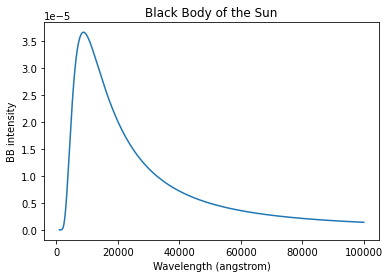

In [5]:
Sun_BB = models.BlackBody(temperature = 5778*u.K)
wav = np.linspace(1000, 100000, 10000)*u.AA
plt.plot(wav, Sun_BB(wav))
plt.xlabel('Wavelength (angstrom)')
plt.ylabel('BB intensity')
plt.title('Black Body of the Sun')

# Studying solar spectrum of one day (looking at all times)

In [6]:
total_lamda = np.zeros((len(os.listdir('Corr-data')), 4084))
total_spctr = np.zeros((len(os.listdir('Corr-data')), 4084))
total_err = np.zeros((len(os.listdir('Corr-data')), 4084))
total_SNR = np.zeros((len(os.listdir('Corr-data'))))
mode = np.zeros((len(os.listdir('Corr-data'))), dtype=str)
date = np.zeros((len(os.listdir('Corr-data'))))
total_RV = np.zeros((len(os.listdir('Corr-data'))))
total_RV_err = np.zeros((len(os.listdir('Corr-data'))))
total_FWHM = np.zeros((len(os.listdir('Corr-data'))))
total_BIS_SPAN = np.zeros((len(os.listdir('Corr-data'))))
total_H2O = np.zeros((len(os.listdir('Corr-data'))))
total_O2 = np.zeros((len(os.listdir('Corr-data'))))
total_CO2 = np.zeros((len(os.listdir('Corr-data'))))
total_AIRM = np.zeros((len(os.listdir('Corr-data'))))

In [20]:
blaze_HA = pf.open('Blaze-data/r.NIRPS.2023-01-21T09:44:20.700_BLAZE_A.fits')
blaze_HE = pf.open('Blaze-data/r.NIRPS.2023-01-21T09:25:46.002_BLAZE_A.fits')

blaze_spctr_HA = blaze_HA[1].data
blaze_spctr_HE = blaze_HE[1].data


for i in range(len(os.listdir('Corr-data'))):
    file = pf.open('Corr-data/'+os.listdir('Corr-data')[i])
    file_CCF = pf.open('CCF_RV-data/'+os.listdir('CCF_RV-data')[i])
    file_lamda = file[4].data[14]
    file_spctr = file[8].data[14]
    file_DLL = file[6].data[14]
    file_err = file[10].data[14]
    file_date = file[0].header['MJD-OBS']
    
    #Getting the time of spectrum 
    date[i] = file_date
    
    #Getting the RV from the spectra directly and from the CCF files
    total_RV[i] = file_CCF[0].header['HIERARCH ESO QC CCF RV']
    total_RV_err[i] = file_CCF[0].header['HIERARCH ESO QC CCF RV ERROR']
    
    #Getting the FWHM
    total_FWHM[i] = file[0].header['HIERARCH ESO QC CCF FWHM']
    
    #Getting the Bis Span
    total_BIS_SPAN[i] = file[0].header['HIERARCH ESO QC CCF BIS SPAN']
    
    #Getting the airmass 
    total_AIRM[i] = (file[0].header['HIERARCH ESO TEL AIRM START'] + file[0].header['HIERARCH ESO TEL AIRM END'])/2
    
    #Getting the abundances for H2O, O2, CO2(?)
    total_H2O[i] = file[0].header['HIERARCH ESO QC TELL H2O IWV']
    
    total_O2[i] = file[0].header['HIERARCH ESO QC TELL O2 IWV']
    
    total_CO2[i] = file[0].header['HIERARCH ESO QC TELL CO2 IWV']
    
    #Getting the wavelength and error on the flux
    total_lamda[i] = file_lamda
    
    #Performing Blaze correction
    if file[0].header['HIERARCH ESO INS MODE'] == 'HA':
        A = file_spctr/blaze_spctr_HA[14]
        A_e = file_err/blaze_spctr_HA[14]
    else: 
        A = file_spctr/blaze_spctr_HE[14]
        A_e = file_err/blaze_spctr_HE[14]
    
    #Performing DLL and Sun BB correction
    B = A/file_DLL
    B_e = A_e/file_DLL
    
    total_spctr[i] = B / Sun_BB(file_lamda*u.AA).value
    
    total_err[i] = B_e / Sun_BB(file_lamda*u.AA).value
    
    #Retrieving the SNR of each spectra at the order of interest
    total_SNR[i] = file[0].header['HIERARCH ESO QC ORDER14 SNR']
    
    #Retrieving the observation mode
    mode[i] = file[0].header['HIERARCH ESO INS MODE'][1]
    

In [11]:
def segment_and_reduce(modes, SNR, L):
    #We separate the spectra based on their observing mode
    if np.sum(modes=='A') != len(modes):
        L_HA = L[modes=='A']
        L_HE = L[modes=='E']
    
        #We cutoff spectra with SNR lower than 300. 
        #We notice that this is only the case for spectra obtained
        #with the HA observing method.
        SNR_HA = SNR[modes=='A']
        SNR_HE = SNR[modes=='E']
    
        L_HA = L_HA[SNR_HA>300]
        
        return L_HA, L_HE
    
    else:
        print('Only one mode is used')
        return L
    
total_spctr_HA, total_spctr_HE = segment_and_reduce(mode, total_SNR, total_spctr)

total_lamda_HA, total_lamda_HE = segment_and_reduce(mode, total_SNR, total_lamda)

total_err_HA, total_err_HE = segment_and_reduce(mode, total_SNR, total_err)

date_HA, date_HE = segment_and_reduce(mode, total_SNR, date)

total_RV_HA, total_RV_HE = segment_and_reduce(mode, total_SNR, total_RV)

total_RV_err_HA, total_RV_err_HE = segment_and_reduce(mode, total_SNR, total_RV_err)

total_FWHM_HA, total_FWHM_HE = segment_and_reduce(mode, total_SNR, total_FWHM)

total_BIS_SPAN_HA, total_BIS_SPAN_HE = segment_and_reduce(mode, total_SNR, total_BIS_SPAN)

total_H2O_HA, total_H2O_HE = segment_and_reduce(mode, total_SNR, total_H2O)

total_O2_HA, total_O2_HE = segment_and_reduce(mode, total_SNR, total_O2)

total_CO2_HA, total_CO2_HE = segment_and_reduce(mode, total_SNR, total_CO2)

total_AIRM_HA, total_AIRM_HE = segment_and_reduce(mode, total_SNR, total_AIRM)

#total_SNR_HA = total_SNR[mode=='A']
#total_SNR_HE = total_SNR[mode=='E']

## Removing the outlier spectra with low SNR

In [15]:
'''fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[14, 6])
ax1.hist(total_SNR_HA)
ax2.hist(total_SNR_HE)
ax1.set_xlabel('SNR')
ax2.set_xlabel('SNR')
ax1.set_ylabel('Counts')
ax2.set_ylabel('Counts')
ax1.set_title('Histogram of the SNR distribution for HA')
ax2.set_title('Histogram of the SNR distribution for HE')
plt.show()'''

"fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[14, 6])\nax1.hist(total_SNR_HA)\nax2.hist(total_SNR_HE)\nax1.set_xlabel('SNR')\nax2.set_xlabel('SNR')\nax1.set_ylabel('Counts')\nax2.set_ylabel('Counts')\nax1.set_title('Histogram of the SNR distribution for HA')\nax2.set_title('Histogram of the SNR distribution for HE')\nplt.show()"

### We plot the spectra according to increasing SNR to check at what point they can be removed

In [16]:
'''sorted_spctr = total_spctr[np.argsort(total_SNR)]
sorted_lamda = total_lamda[np.argsort(total_SNR)]

for i in range(len(sorted_spctr)):
    plt.figure(figsize=[8, 5])
    plt.plot(sorted_lamda[i], sorted_spctr[i])
    plt.xlabel('Wavelength (angstrom)')
    plt.ylabel('Flux')
    plt.show()
    print('Spectrum SNR:', total_SNR[np.argsort(total_SNR)][i])'''

"sorted_spctr = total_spctr[np.argsort(total_SNR)]\nsorted_lamda = total_lamda[np.argsort(total_SNR)]\n\nfor i in range(len(sorted_spctr)):\n    plt.figure(figsize=[8, 5])\n    plt.plot(sorted_lamda[i], sorted_spctr[i])\n    plt.xlabel('Wavelength (angstrom)')\n    plt.ylabel('Flux')\n    plt.show()\n    print('Spectrum SNR:', total_SNR[np.argsort(total_SNR)][i])"

<ErrorbarContainer object of 3 artists>

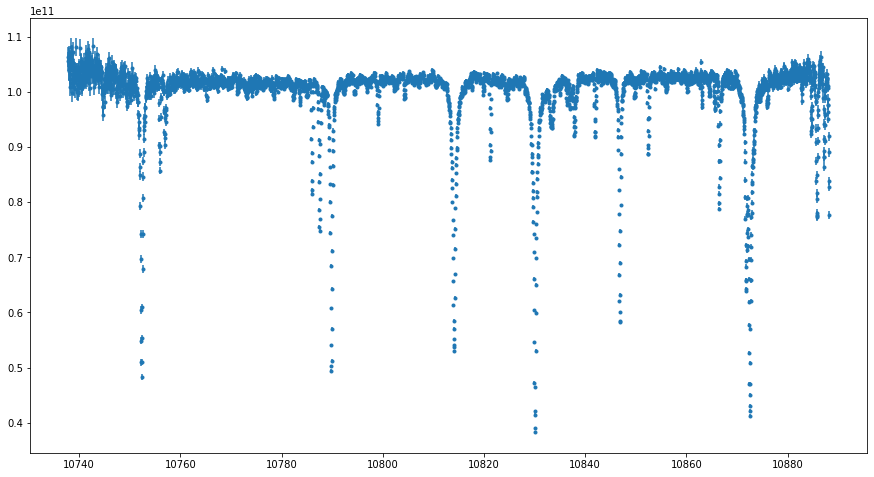

In [17]:
plt.figure(figsize=[15, 8])
plt.errorbar(total_lamda_HA[0], total_spctr_HA[0], yerr=total_err_HA[0], fmt='.')

In [18]:
total_err_HA

array([[1.79185428e+09, 1.78279228e+09, 1.75677749e+09, ...,
        7.81095133e+08, 7.80260889e+08, 7.52110711e+08],
       [1.75704600e+09, 1.77269656e+09, 1.74926080e+09, ...,
        7.72193085e+08, 7.59862801e+08, 7.35136451e+08],
       [1.74481887e+09, 1.76400952e+09, 1.75408641e+09, ...,
        7.66320708e+08, 7.55895009e+08, 7.35784324e+08],
       ...,
       [1.73572787e+09, 1.78916916e+09, 1.72407894e+09, ...,
        7.68849615e+08, 7.63606130e+08, 7.33350665e+08],
       [1.72641915e+09, 1.76327877e+09, 1.73334549e+09, ...,
        7.69116182e+08, 7.61089105e+08, 7.32069801e+08],
       [1.77193117e+09, 1.76827611e+09, 1.76419041e+09, ...,
        7.84432741e+08, 7.63432371e+08, 7.46440004e+08]])

## Plotting the He triplet for all the spectra of the day

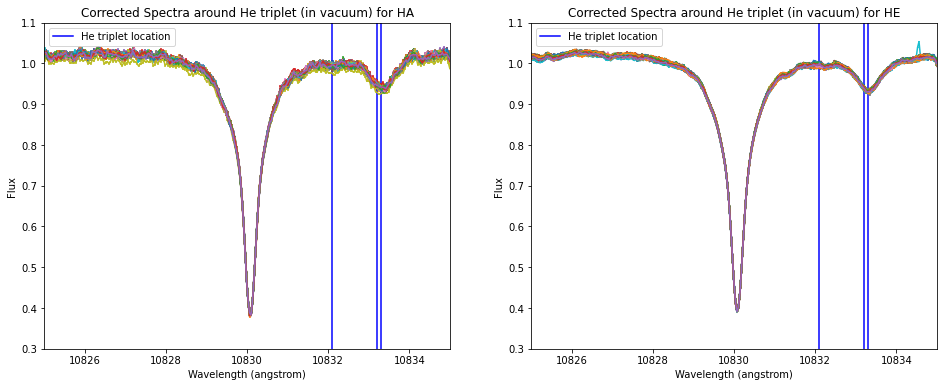

In [26]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[16, 6])

for i in range(len(total_spctr_HA)):
    ax1.errorbar(total_lamda_HA[i], total_spctr_HA[i]/np.mean(total_spctr_HA[i]), yerr=total_err_HA[i]/np.mean(total_spctr_HA[i]))
    ax1.set_xlabel('Wavelength (angstrom)')
    ax1.set_ylabel('Flux')
    ax1.set_title('Corrected Spectra around He triplet (in vacuum) for HA')
    ax1.set_xlim([10825, 10835])
    ax1.set_ylim([0.3, 1.1])
    
for i in range(len(total_spctr_HE)):
    ax2.errorbar(total_lamda_HE[i], total_spctr_HE[i]/np.mean(total_spctr_HE[i]), yerr=total_err_HE[i]/np.mean(total_spctr_HE[i]))
    ax2.set_xlabel('Wavelength (angstrom)')
    ax2.set_ylabel('Flux')
    ax2.set_title('Corrected Spectra around He triplet (in vacuum) for HE')
    ax2.set_xlim([10825, 10835])
    ax2.set_ylim([0.3, 1.1])

ax1.axvline(10833.2, color='b', label='He triplet location')
ax1.axvline(10833.3, color='b')
ax1.axvline(10832.1, color='b')

ax2.axvline(10833.2, color='b', label='He triplet location')
ax2.axvline(10833.3, color='b')
ax2.axvline(10832.1, color='b')

ax1.legend()
ax2.legend()

## Perform air-to-vacuum correction

In [18]:
def vac2air(wavelength):
# Transform wavelength in vacuum to air

# See VALD website here

# http://www.astro.uu.se/valdwiki/Air-to-vacuum%20conversion

# The formula comes from Birch and Downs (1994, Metrologia, 31, 315)

    s = 1e4 / wavelength # s = 10^4 / lamda_vac, lamda_vac is in Angstrom

    n_air = 1 + 0.0000834254 + 0.02406147 / (130 - s**2) + 0.00015998 / (38.9 - s**2)

    return wavelength / n_air

def air2vac(wavelength):
# Transform wavelength in vacuum to air

# See VALD website here

# http://www.astro.uu.se/valdwiki/Air-to-vacuum%20conversion

# The formula comes from Birch and Downs (1994, Metrologia, 31, 315)

    s = 1e4 / wavelength # s = 10^4 / lamda_air, lamda_air is in Angstrom

    n_vac = 1 + 0.00008336624212083 + 0.02408926869968 / (130.1065924522 - s**2) + 0.0001599740894897 / (38.92568793293 - s**2)

    return wavelength * n_vac


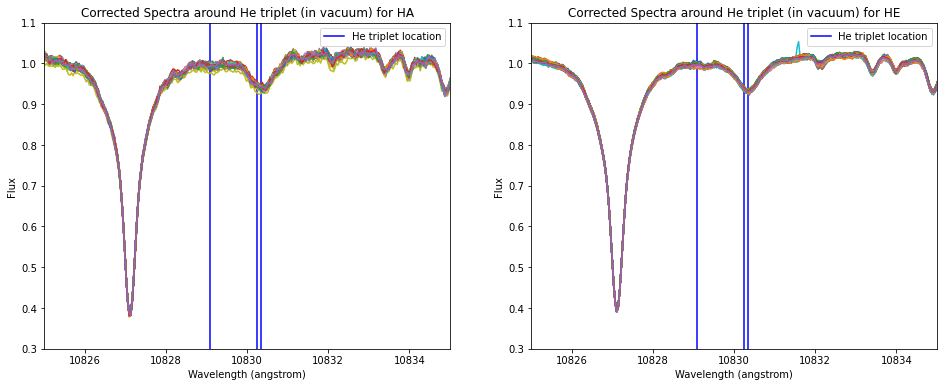

In [19]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[16, 6])

for i in range(len(total_spctr_HA)):
    ax1.errorbar(vac2air(total_lamda_HA[i]), total_spctr_HA[i]/np.mean(total_spctr_HA[i]), yerr=total_err_HA[i]/np.mean(total_spctr_HA[i]))
    ax1.set_xlabel('Wavelength (angstrom)')
    ax1.set_ylabel('Flux')
    ax1.set_title('Corrected Spectra around He triplet (in vacuum) for HA')
    ax1.set_xlim([10825, 10835])
    ax1.set_ylim([0.3, 1.1])
    
for i in range(len(total_spctr_HE)):
    ax2.errorbar(vac2air(total_lamda_HE[i]), total_spctr_HE[i]/np.mean(total_spctr_HE[i]), yerr=total_err_HE[i]/np.mean(total_spctr_HE[i]))
    ax2.set_xlabel('Wavelength (angstrom)')
    ax2.set_ylabel('Flux')
    ax2.set_title('Corrected Spectra around He triplet (in vacuum) for HE')
    ax2.set_xlim([10825, 10835])
    ax2.set_ylim([0.3, 1.1])

ax1.axvline(10829.09, color='b', label='He triplet location')
ax1.axvline(10830.34, color='b')
ax1.axvline(10830.25, color='b')

ax2.axvline(10829.09, color='b', label='He triplet location')
ax2.axvline(10830.34, color='b')
ax2.axvline(10830.25, color='b')

ax1.legend()
ax2.legend()

## Calculating the systematics

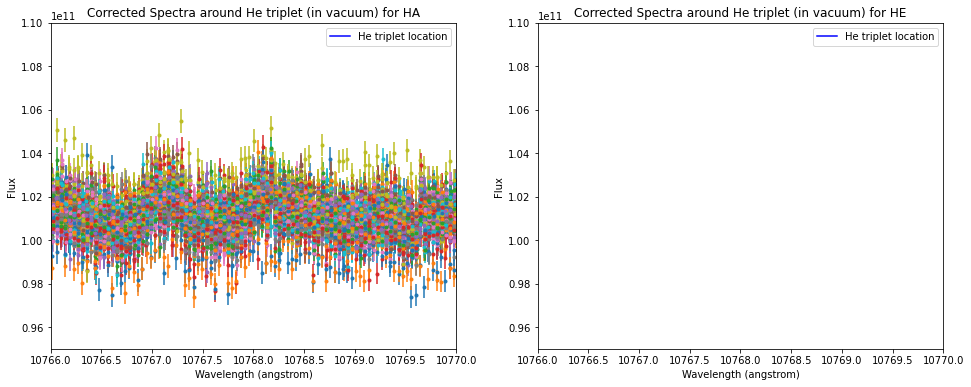

In [29]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[16, 6])

for i in range(len(total_spctr_HA)):
    ax1.errorbar(total_lamda_HA[i], total_spctr_HA[i], yerr=total_err_HA[i], fmt='.')
    ax1.set_xlabel('Wavelength (angstrom)')
    ax1.set_ylabel('Flux')
    ax1.set_title('Corrected Spectra around He triplet (in vacuum) for HA')
    ax1.set_xlim([10766, 10770])
    ax1.set_ylim([0.95e11, 1.1e11])
    
for i in range(len(total_spctr_HE)):
    ax2.errorbar(total_lamda_HE[i], total_spctr_HE[i], yerr=total_err_HE[i], fmt='.')
    ax2.set_xlabel('Wavelength (angstrom)')
    ax2.set_ylabel('Flux')
    ax2.set_title('Corrected Spectra around He triplet (in vacuum) for HE')
    ax2.set_xlim([10766, 10770])
    ax2.set_ylim([0.95e11, 1.1e11])

ax1.axvline(10833.2, color='b', label='He triplet location')
ax1.axvline(10833.3, color='b')
ax1.axvline(10832.1, color='b')

ax2.axvline(10833.2, color='b', label='He triplet location')
ax2.axvline(10833.3, color='b')
ax2.axvline(10832.1, color='b')

ax1.legend()
ax2.legend()

In [115]:
low = 10767
up = 10770

index = 1

std_A = np.zeros(index)
std_E = np.zeros(index)

photon_A = np.zeros(index)
photon_E = np.zeros(index)

for i in range(index):
    
    t_1_A = total_lamda_HA[i][low<total_lamda_HA[i]]
    t_2_A = total_spctr_HA[i][low<total_lamda_HA[i]]
    t_3_A = total_err_HA
    focus_s_A = t_2_A[t_1_A < up]
    std_A[i] = np.average(focus_s_A, weight = )
    print(total_err_HA[i])
    photon_A[i] = np.sqrt(np.mean(focus_s_A))

for i in range(index):
    t_1_E = total_lamda_HE[i][low<total_lamda_HE[i]]
    t_2_E = total_spctr_HE[i][low<total_lamda_HE[i]]
    focus_s_E = t_2_E[t_1_E < up]
    std_E[i] = tstd(focus_s_E)
    photon_E[i] = np.sqrt(np.mean(focus_s_E))


[ 77.41643966  79.21242457  78.29527745 ... 128.7995525  128.4332328
 124.32194006]


In [118]:
print(np.mean(std_A), np.mean(std_E))
print(np.mean(photon_A), np.mean(photon_E))

##Noise is 
print(np.sqrt(np.mean(std_A)**2 - np.mean(photon_A)**2), np.sqrt(np.mean(std_E)**2 - np.mean(photon_E)**2))

702390647.3409624 1583274273.155798
319061.6949968875 613795.0285919964
702390574.8739024 1583274154.1794596


In [ ]:
print(total_SNR[0])

## Building a master spectrum

In [23]:
master_lamda_HA = np.mean(total_lamda_HA, axis=0)
master_spctr_HA = np.mean(total_spctr_HA, axis=0)

master_lamda_HE = np.mean(total_lamda_HE, axis=0)
master_spctr_HE = np.mean(total_spctr_HE, axis=0)

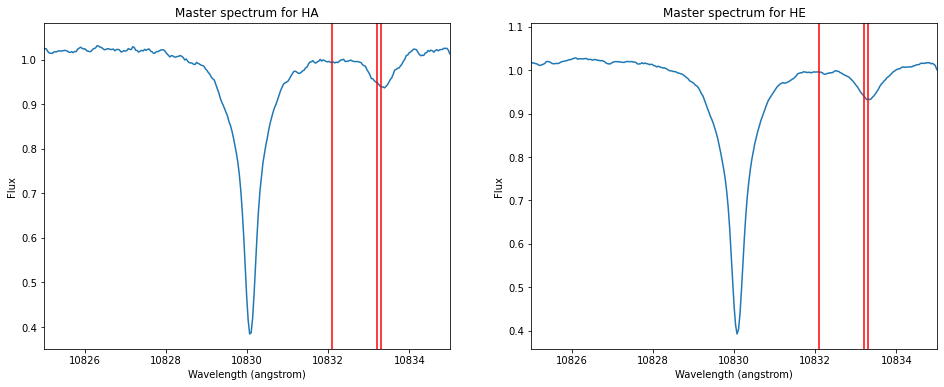

In [24]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[16, 6])

ax1.plot(master_lamda_HA, master_spctr_HA/np.mean(master_spctr_HA))
ax2.plot(master_lamda_HE, master_spctr_HE/np.mean(master_spctr_HE))
ax1.set_xlabel('Wavelength (angstrom)')
ax2.set_xlabel('Wavelength (angstrom)')
ax1.set_ylabel('Flux')
ax2.set_ylabel('Flux')
ax1.set_title('Master spectrum for HA')
ax2.set_title('Master spectrum for HE')
ax1.set_xlim([10825, 10835])
ax2.set_xlim([10825, 10835])
ax1.axvline(10833.2, color='red')
ax1.axvline(10833.3, color='red')
ax1.axvline(10832.1, color='red')
ax2.axvline(10833.2, color='red')
ax2.axvline(10833.3, color='red')
ax2.axvline(10832.1, color='red')

## Making residuals 

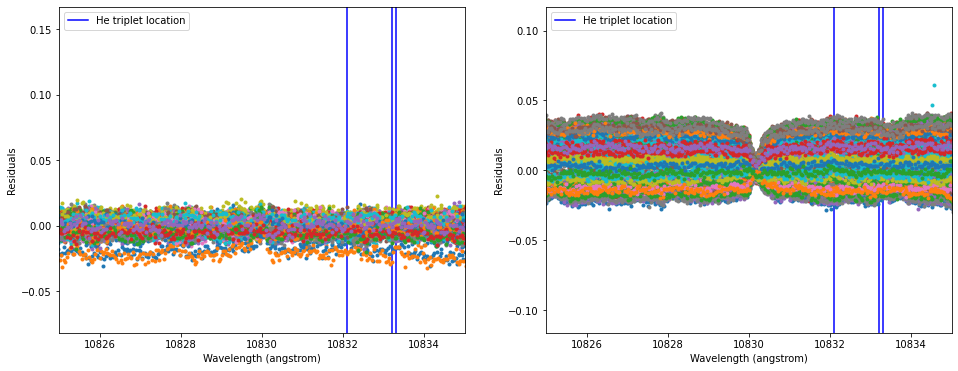

In [25]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[16, 6])
for i in range(len(total_spctr_HA)):
    ax1.errorbar(master_lamda_HA, (total_spctr_HA[i]/np.mean(total_spctr_HA)) - (master_spctr_HA/np.mean(master_spctr_HA)), yerr=total_err_HA[i]/np.mean(total_spctr_HA[i]), fmt='.')
    ax1.set_xlabel('Wavelength (angstrom)')
    ax1.set_ylabel('Residuals')
    ax1.set_xlim([10825, 10835])

for i in range(len(total_spctr_HE)):
    ax2.errorbar(master_lamda_HE, (total_spctr_HE[i]/np.mean(total_spctr_HE)) - (master_spctr_HE/np.mean(master_spctr_HE)), yerr=total_err_HE[i]/np.mean(total_spctr_HE[i]), fmt='.')
    ax2.set_xlabel('Wavelength (angstrom)')
    ax2.set_ylabel('Residuals')
    ax2.set_xlim([10825, 10835])

ax1.axvline(10833.2, color='b', label='He triplet location')
ax1.axvline(10833.3, color='b')
ax1.axvline(10832.1, color='b')

ax2.axvline(10833.2, color='b', label='He triplet location')
ax2.axvline(10833.3, color='b')
ax2.axvline(10832.1, color='b')

ax1.legend()
ax2.legend()

plt.savefig('/Users/samsonmercier/Desktop/residuals.pdf')

## Fitting a gaussian to the He triplet line and comparing the widths and depths

[-1.08379121e+02  7.10230193e-02  1.34684317e+00  2.91816832e-01
  1.00076064e-02  9.69736742e-01]


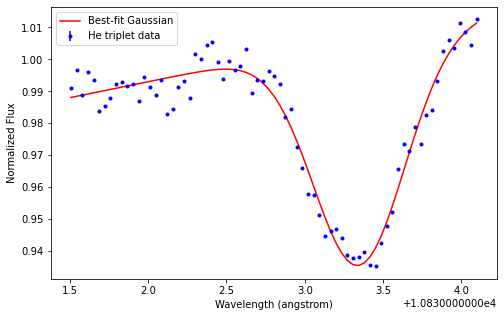

[-1.23399083e+02  6.98974237e-02  1.35540045e+00  3.09553669e-01
  1.13946236e-02  9.69044102e-01]


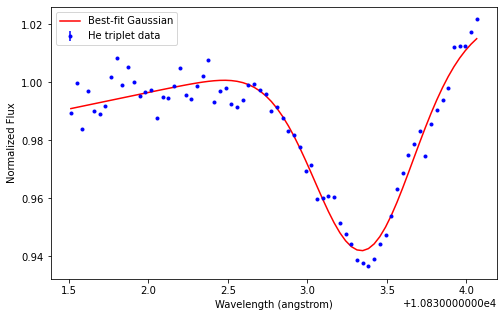

[-1.75628182e+02  7.75505228e-02  1.37244685e+00  3.20254002e-01
  1.62161674e-02  9.69774618e-01]


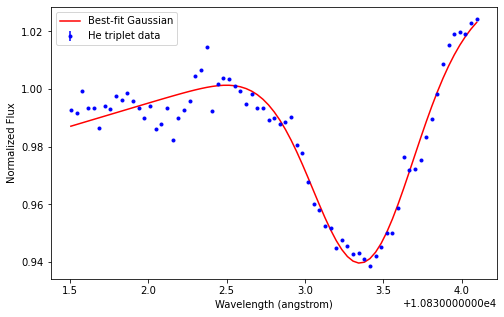

[-1.00841913e+02  6.88786510e-02  1.33985271e+00  2.83747492e-01
  9.31259046e-03  9.63133977e-01]


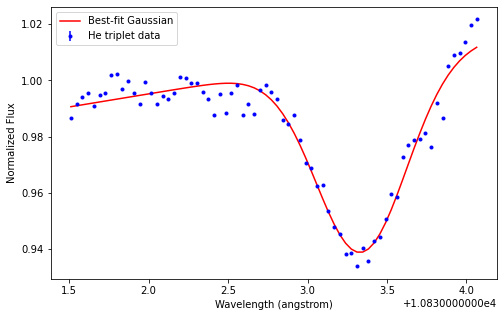

[-1.15699515e+02  7.36498557e-02  1.34707204e+00  2.95193602e-01
  1.06837763e-02  9.68968281e-01]


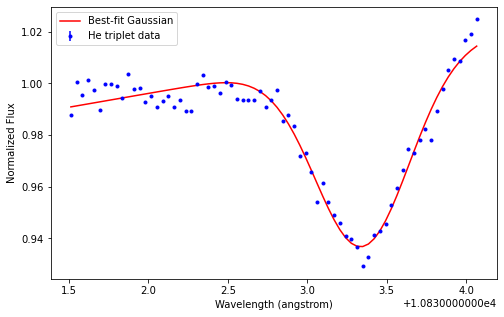

[-8.42435909e+01  6.78813499e-02  1.32235952e+00  2.74445873e-01
  7.77967498e-03  9.69203631e-01]


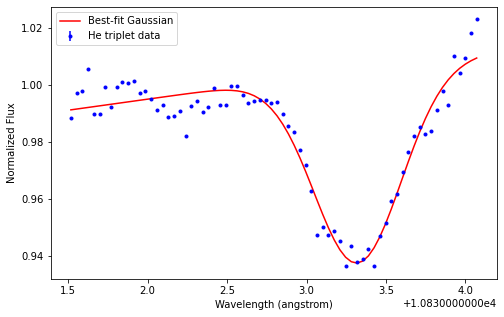

[-1.18000702e+02  6.96627900e-02  1.33759025e+00  2.93448479e-01
  1.08962400e-02  9.68938693e-01]


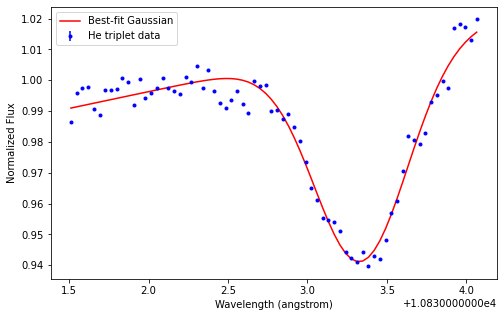

[-1.16322181e+02  7.42695632e-02  1.35568019e+00  2.99569031e-01
  1.07411640e-02  9.68529655e-01]


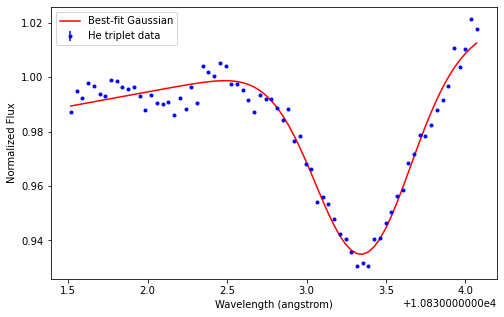

[-9.48371215e+01  6.91168384e-02  1.34172377e+00  2.87461266e-01
  8.75769936e-03  9.69450242e-01]


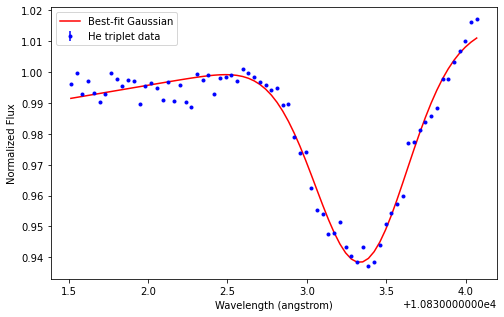

[-9.82138306e+01  6.92427535e-02  1.34130176e+00  2.92949435e-01
  9.06988928e-03  9.65721405e-01]


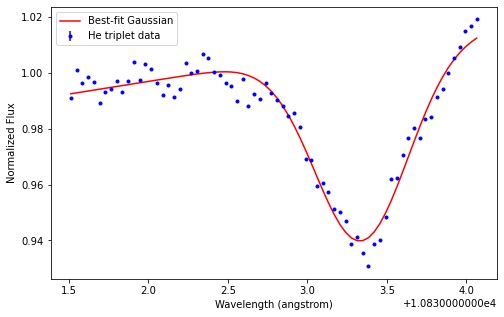

[-1.19199348e+02  6.94673881e-02  1.33410711e+00  2.96922803e-01
  1.10071560e-02  9.66181387e-01]


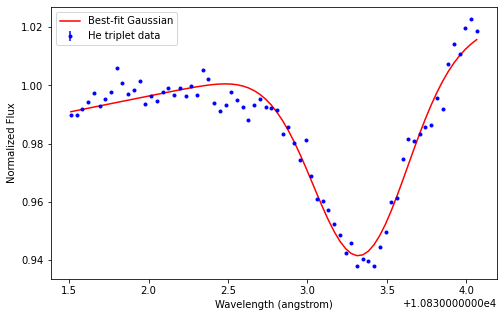

[-1.15646829e+02  7.61225192e-02  1.33020078e+00  3.05077384e-01
  1.06789236e-02  9.69585139e-01]


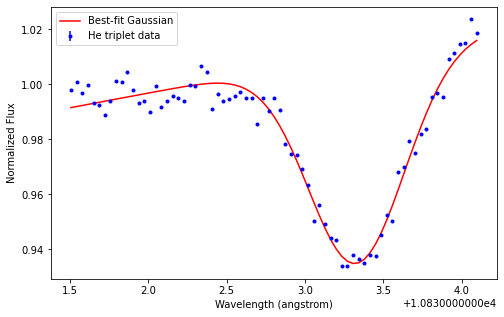

[-1.26122280e+02  7.48029986e-02  1.36339716e+00  2.93589108e-01
  1.16471789e-02  9.55861265e-01]


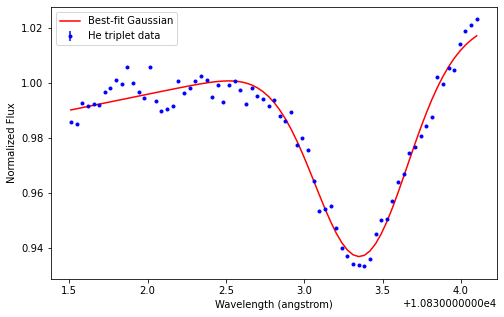

[-9.99324245e+01  6.88098243e-02  1.33707402e+00  2.85545693e-01
  9.22815558e-03  9.69413094e-01]


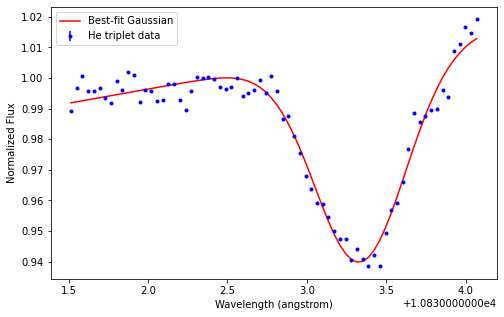

[-1.20229696e+02  7.16861479e-02  1.34521153e+00  2.79697327e-01
  1.11019323e-02  9.68021570e-01]


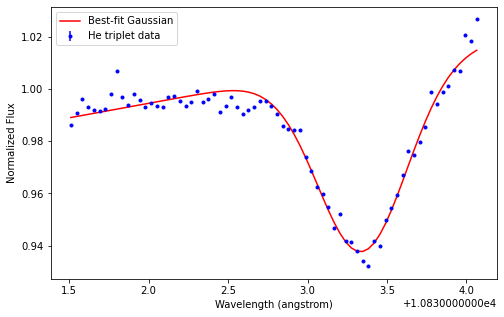

[-9.81199871e+01  6.71529273e-02  1.33435971e+00  2.98317897e-01
  9.06087284e-03  9.69479983e-01]


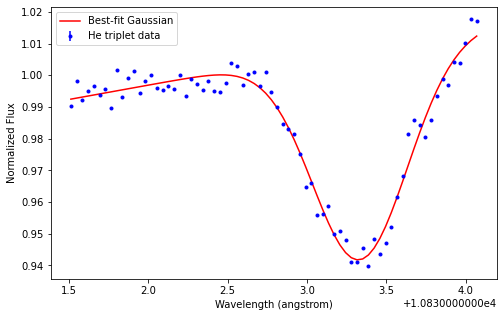

[-1.15031071e+02  7.07666018e-02  1.34536745e+00  2.97835074e-01
  1.06221896e-02  9.67792124e-01]


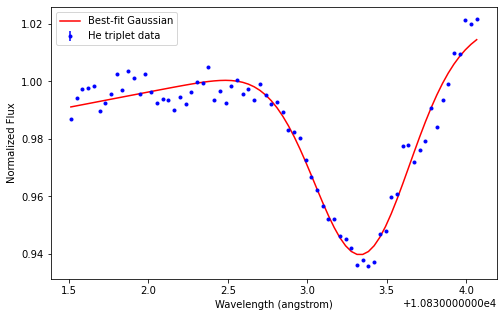

[-8.16669072e+01  6.90479834e-02  1.33115983e+00  2.74452515e-01
  7.54185692e-03  9.69384230e-01]


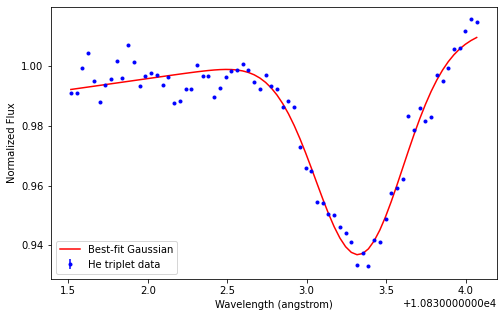

[-1.35929368e+02  7.10154548e-02  1.34519399e+00  3.17941768e-01
  1.25514090e-02  9.68642402e-01]


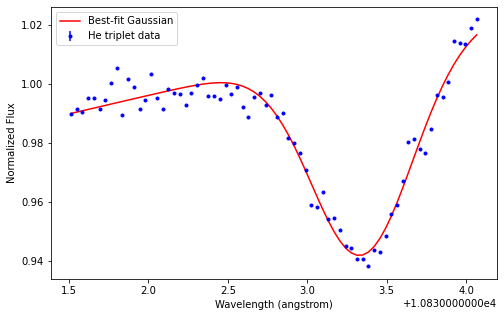

[-1.10736549e+02  7.25728009e-02  1.33480603e+00  2.80948999e-01
  1.02254902e-02  9.68357223e-01]


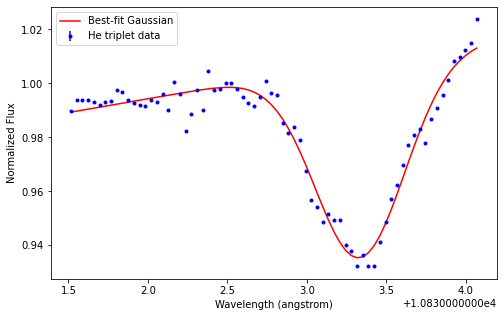

[-1.11177064e+02  7.03430479e-02  1.36322728e+00  2.87345890e-01
  1.02663153e-02  9.68186642e-01]


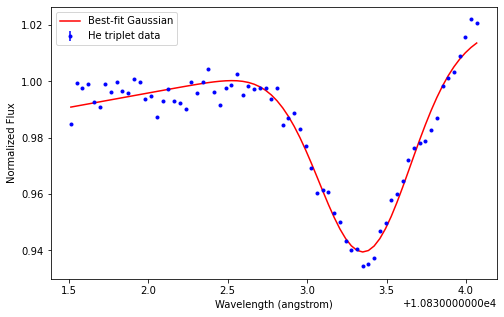

[-1.02629598e+02  6.96399394e-02  1.34237619e+00  2.97146849e-01
  9.47704966e-03  9.69455970e-01]


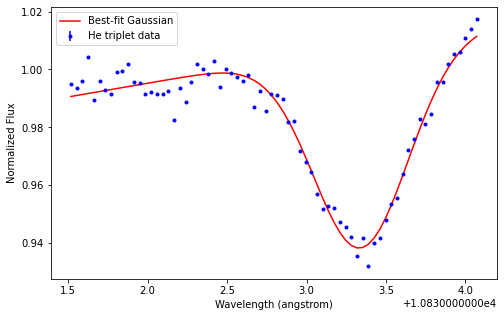

[-7.56711721e+01  7.02452703e-02  1.33202690e+00  2.71603039e-01
  6.98834300e-03  9.69354004e-01]


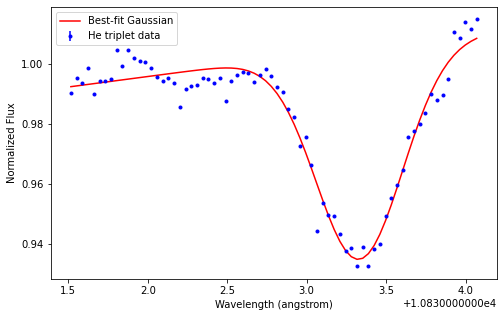

[-1.20388776e+02  7.16777406e-02  1.34493139e+00  3.01663683e-01
  1.11169349e-02  9.67084302e-01]


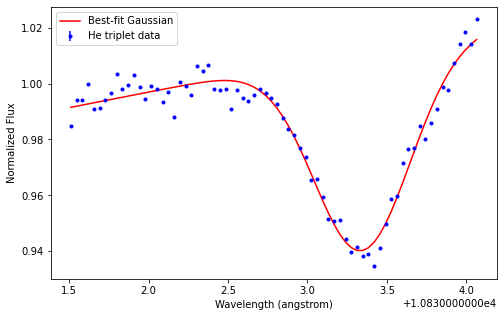

[-1.24256085e+02  7.39068823e-02  1.34590953e+00  2.84014022e-01
  1.14737770e-02  9.67462973e-01]


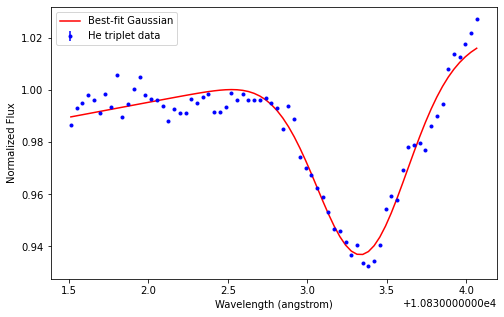

[-1.04968357e+02  7.10858836e-02  1.34331092e+00  2.91373855e-01
  9.69313979e-03  9.69347700e-01]


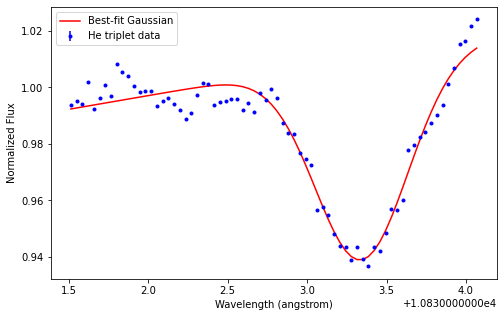

[-1.23507379e+02  7.06939717e-02  1.35244691e+00  2.93134573e-01
  1.14044964e-02  9.67761781e-01]


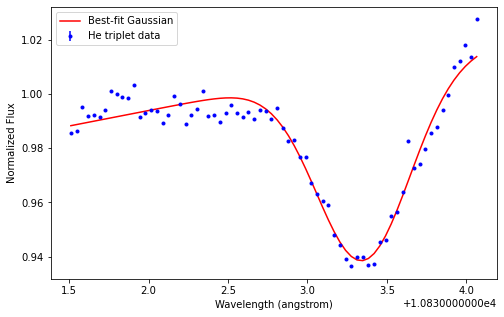

[-9.70947616e+01  6.90828800e-02  1.33033549e+00  2.77898167e-01
  8.96606273e-03  9.68998458e-01]


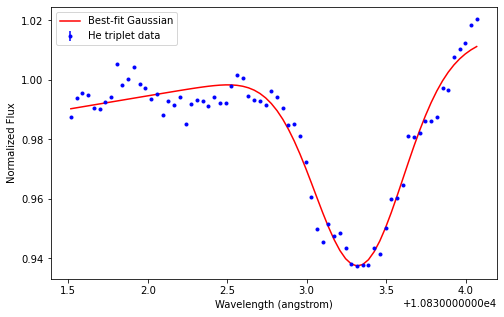

[-8.73688357e+01  6.73289254e-02  1.33637887e+00  2.80456104e-01
  8.06820370e-03  9.69403747e-01]


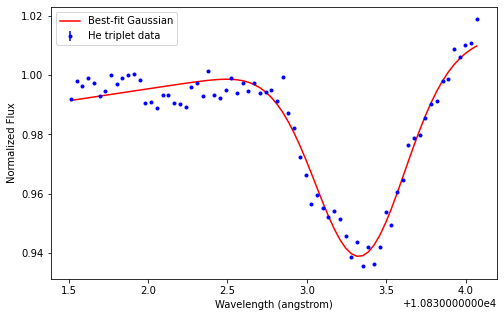

[-9.46914558e+01  7.04562446e-02  1.35337272e+00  2.81511439e-01
  8.74411121e-03  9.69529397e-01]


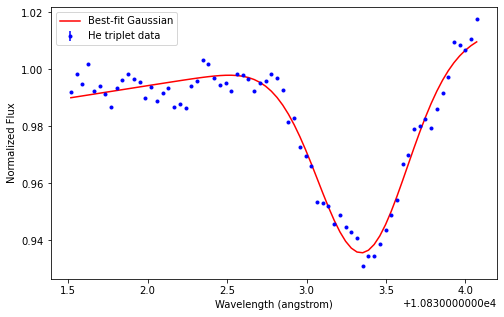

[-9.60861174e+01  6.80493006e-02  1.33922200e+00  2.89022620e-01
  8.87295294e-03  9.69355471e-01]


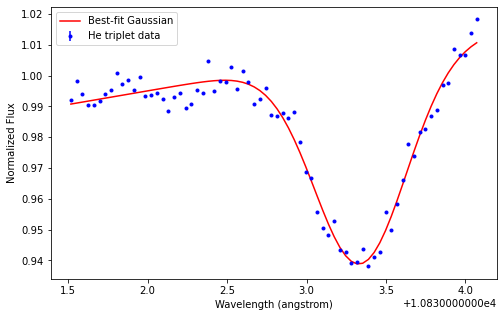

[-8.57690349e+01  6.90214060e-02  1.33504519e+00  2.68774485e-01
  7.92241413e-03  9.50000003e-01]


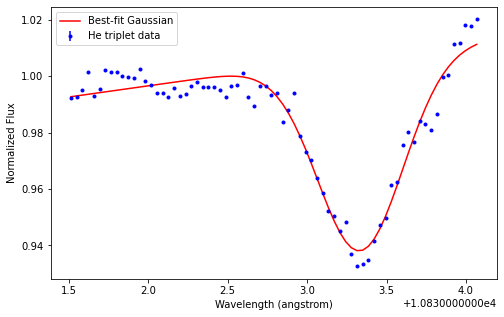

[-1.39083890e+02  7.35250958e-02  1.34445114e+00  3.05415547e-01
  1.28425292e-02  9.69836014e-01]


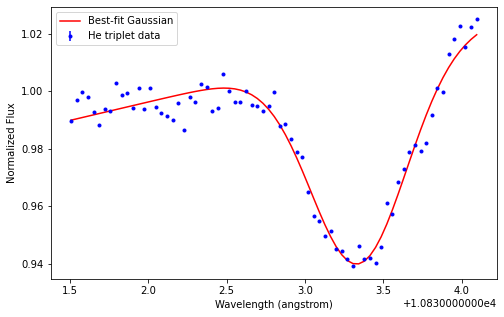

[-1.05110715e+02  7.02808500e-02  1.33409671e+00  2.81588003e-01
  9.70614541e-03  9.68559617e-01]


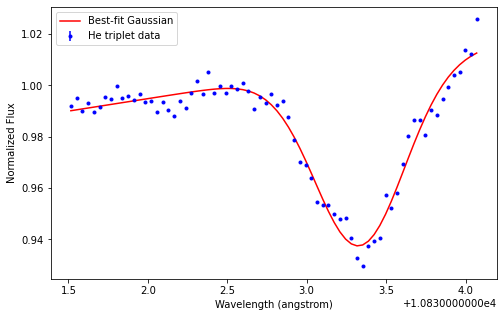

[-1.26465199e+02  7.19064026e-02  1.35748345e+00  3.02865590e-01
  1.16776938e-02  9.69075666e-01]


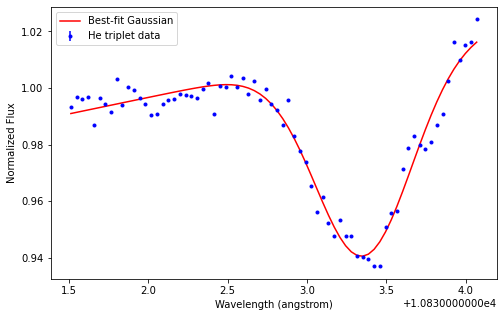

[-1.23417077e+02  7.44973387e-02  1.34296429e+00  3.02342746e-01
  1.13963897e-02  9.68767735e-01]


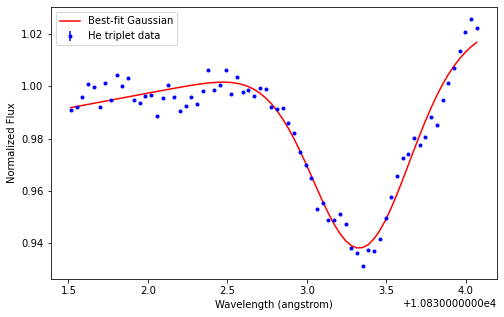

[-1.19376759e+02  7.03083226e-02  1.34588112e+00  2.91685975e-01
  1.10234067e-02  9.67650564e-01]


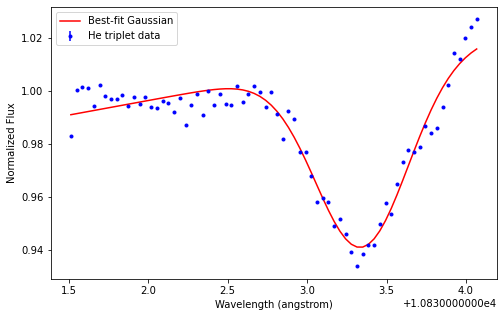

[-1.16360832e+02  7.13022604e-02  1.35988808e+00  2.99544344e-01
  1.07446808e-02  9.69824274e-01]


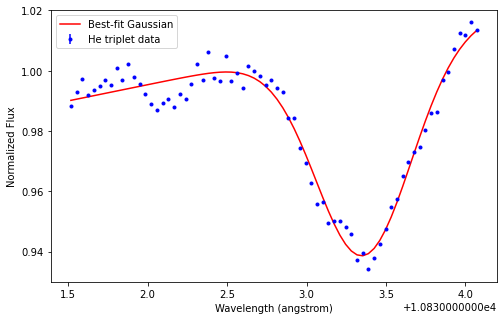

[-1.07112451e+02  7.05956059e-02  1.35344132e+00  3.05503252e-01
  9.89111822e-03  9.69691252e-01]


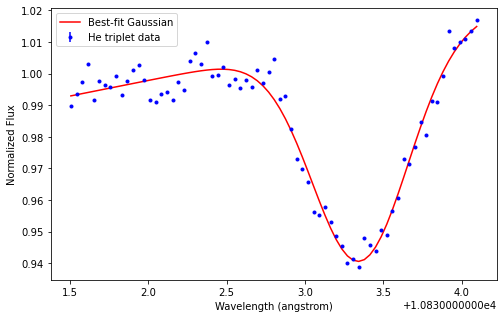

[-1.15245692e+02  7.24850403e-02  1.34143085e+00  3.00875569e-01
  1.06419135e-02  9.68500123e-01]


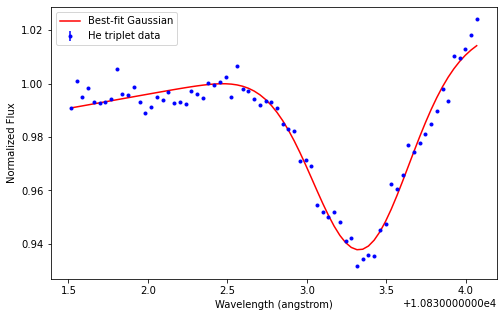

[-1.16731149e+02  6.95110992e-02  1.33346958e+00  3.01966690e-01
  1.07790336e-02  9.68993410e-01]


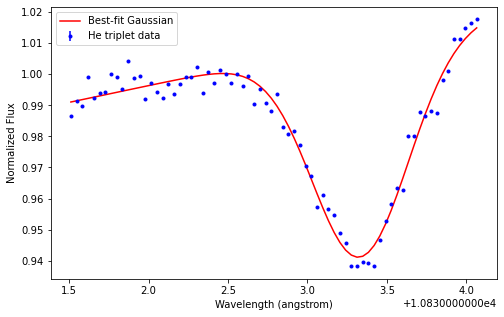

[-1.02814373e+02  6.95056766e-02  1.32955359e+00  2.84131784e-01
  9.49421508e-03  9.68808559e-01]


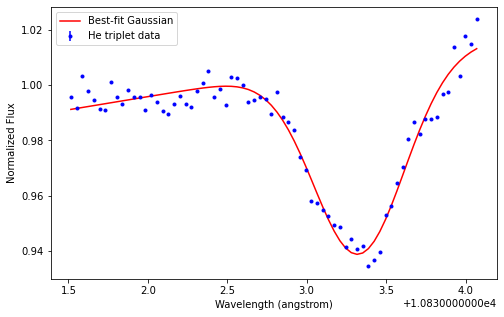

[-1.08134495e+02  6.97487399e-02  1.34101785e+00  2.94961759e-01
  9.98545987e-03  9.68238352e-01]


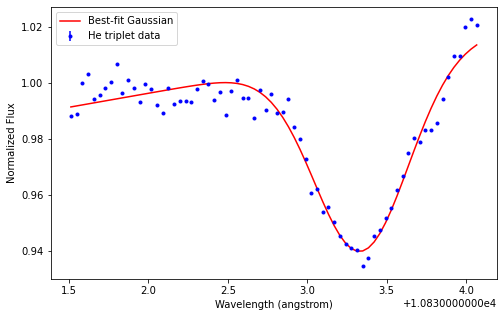

[-1.12295314e+02  7.10062413e-02  1.34858278e+00  2.83974048e-01
  1.03695207e-02  9.68126292e-01]


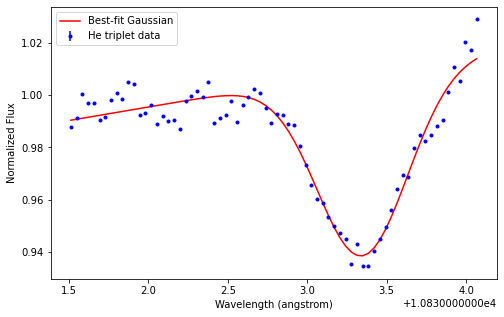

[-9.86775899e+01  6.83987977e-02  1.33922439e+00  2.95921672e-01
  9.11230872e-03  9.69303244e-01]


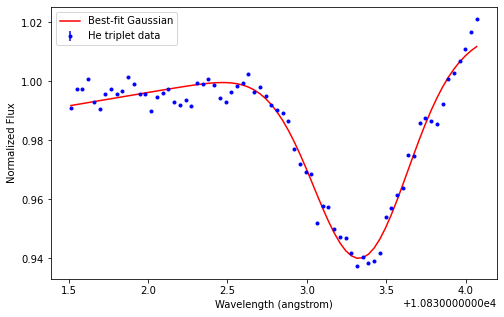

[-9.32656820e+01  6.85652325e-02  1.35006103e+00  2.87605852e-01
  8.61284747e-03  9.69068369e-01]


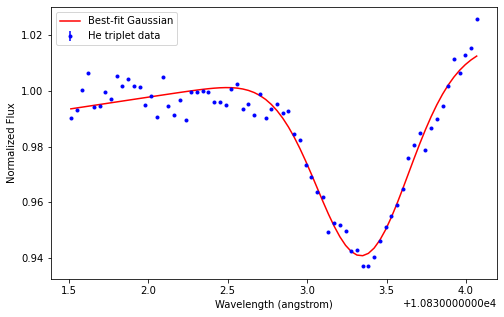

[-1.20718343e+02  7.09810610e-02  1.37281292e+00  2.98428486e-01
  1.11471737e-02  9.69212239e-01]


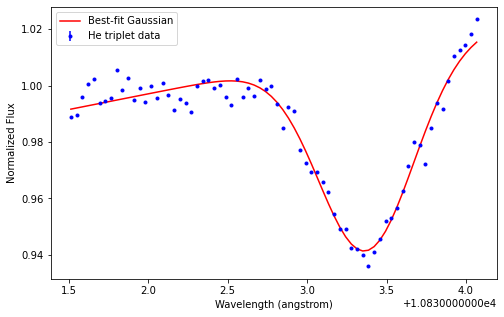

[-1.24686411e+02  7.24010748e-02  1.32747207e+00  3.18286208e-01
  1.15134102e-02  9.71519852e-01]


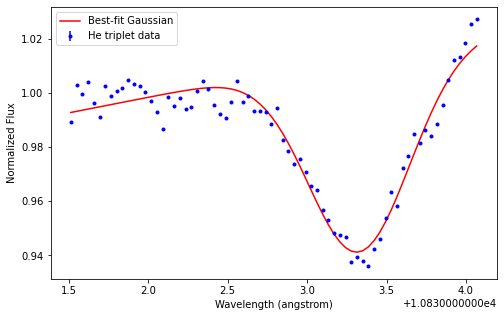

[-1.13745124e+02  6.98434238e-02  1.33332631e+00  2.89431033e-01
  1.05017975e-02  9.69900330e-01]


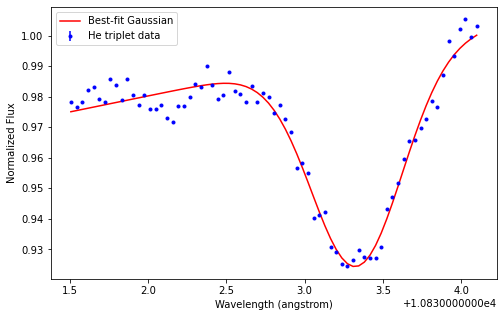

[-1.30216457e+02  7.40744123e-02  1.35631890e+00  2.93939461e-01
  1.20239398e-02  9.68748072e-01]


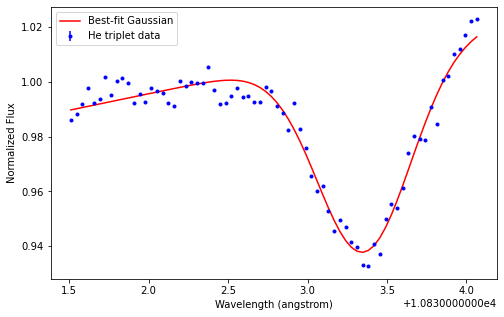

[-1.04236362e+02  6.79996778e-02  1.34546243e+00  2.75027607e-01
  9.62537538e-03  9.68636549e-01]


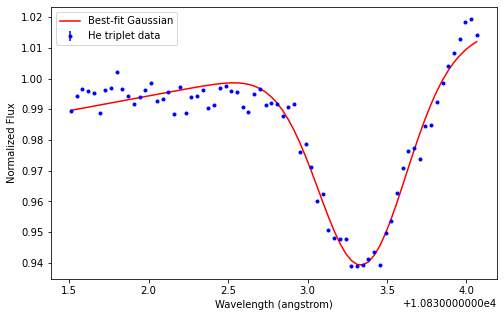

[-1.05817019e+02  6.96172790e-02  1.34702143e+00  2.93852625e-01
  9.77137483e-03  9.69319516e-01]


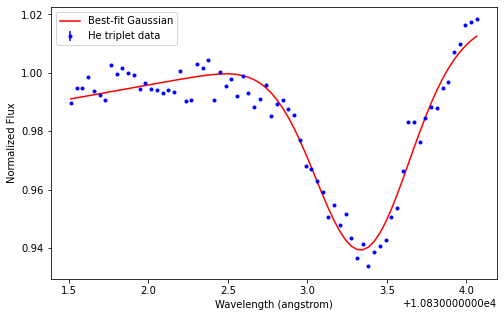

[-1.07541992e+02  6.83385943e-02  1.34557308e+00  2.89274246e-01
  9.93071839e-03  9.68953613e-01]


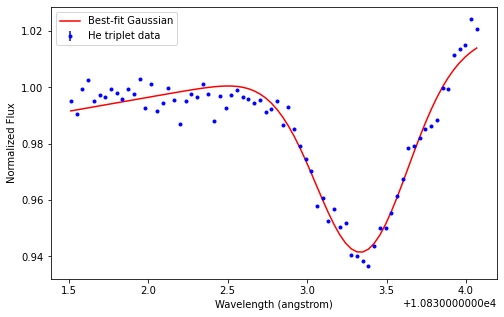

[-1.16087959e+02  7.32489661e-02  1.34614626e+00  2.97173214e-01
  1.07197797e-02  9.67618169e-01]


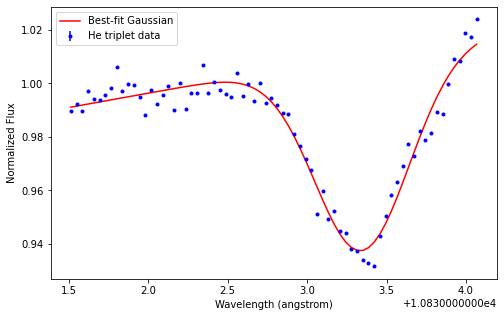

[-9.55110704e+01  7.03652961e-02  1.33946747e+00  2.82431943e-01
  8.81991328e-03  9.69369023e-01]


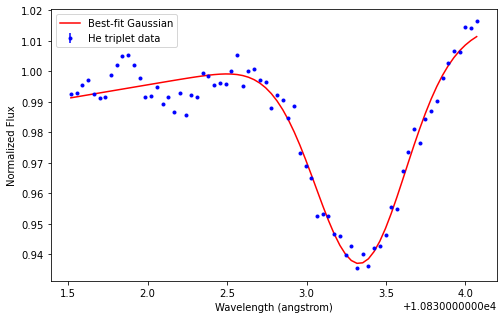

[-1.10941669e+02  6.92698402e-02  1.33816863e+00  2.79603510e-01
  1.02444109e-02  9.68870645e-01]


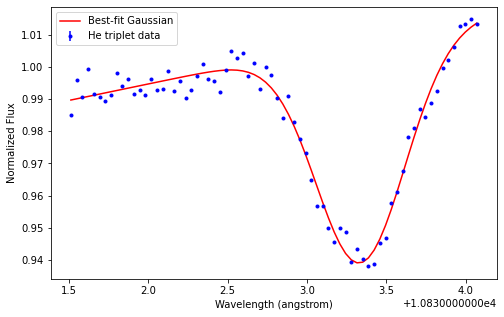

[-1.08544141e+02  6.96564062e-02  1.35461033e+00  2.97424317e-01
  1.00232381e-02  9.68226766e-01]


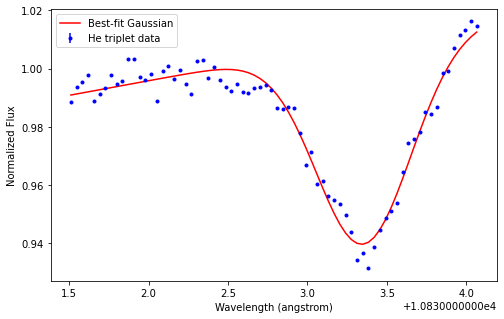

[-9.76326511e+01  7.18750632e-02  1.34155369e+00  2.78598840e-01
  9.01596679e-03  9.67933594e-01]


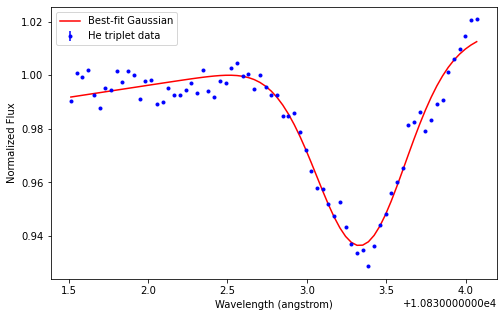

[-1.06111494e+02  7.31640585e-02  1.33450481e+00  2.86790207e-01
  9.79865513e-03  9.68367979e-01]


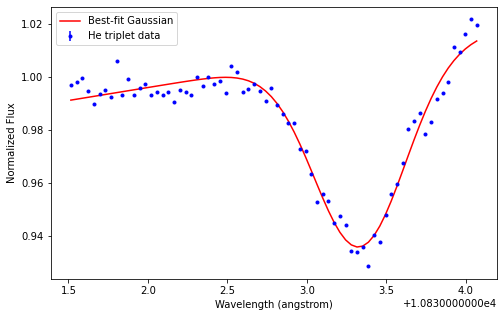

[-1.34853681e+02  7.10774957e-02  1.34608298e+00  3.17567006e-01
  1.24520970e-02  9.68772264e-01]


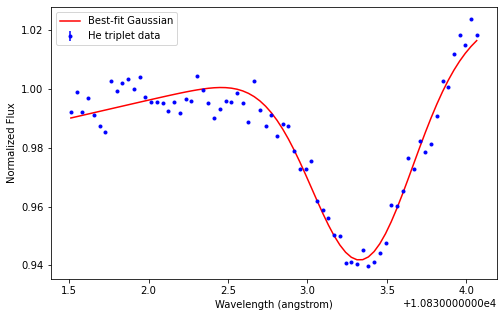

[-1.31088180e+02  7.42688084e-02  1.35078790e+00  2.94917637e-01
  1.21041400e-02  9.69860798e-01]


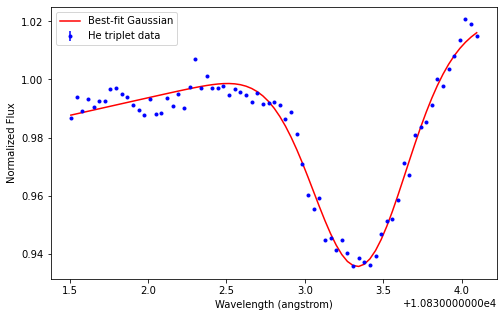

[-1.02834686e+02  6.66664071e-02  1.34660855e+00  2.92706703e-01
  9.49650554e-03  9.63928377e-01]


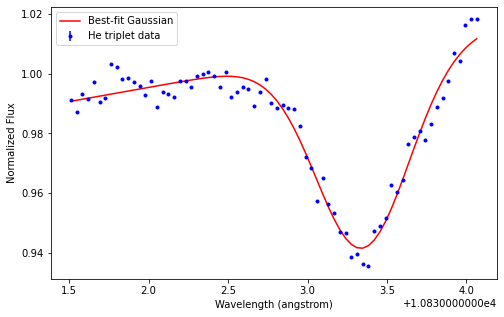

[-1.23963635e+02  7.39878411e-02  1.34929833e+00  3.06875005e-01
  1.14470565e-02  9.65620492e-01]


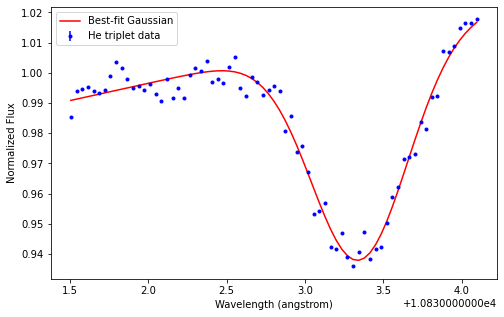

[-1.26913927e+02  7.19946002e-02  1.33934761e+00  2.83755873e-01
  1.17189093e-02  9.69873448e-01]


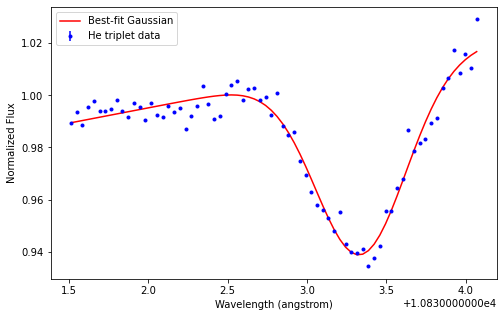

[-1.34139307e+02  7.07797436e-02  1.35014196e+00  3.03388944e-01
  1.23859229e-02  9.69899718e-01]


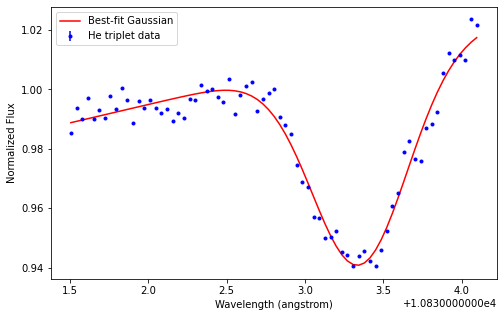

[-8.75548603e+01  6.88546193e-02  1.33086308e+00  2.78540192e-01
  8.08521692e-03  9.69166289e-01]


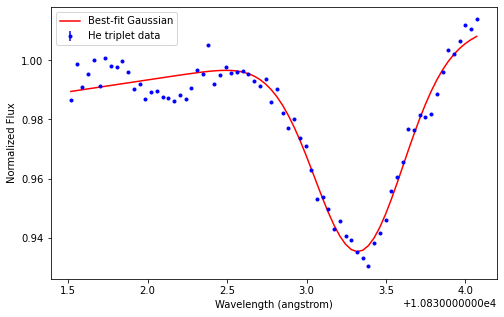

[-1.04840505e+02  6.97219303e-02  1.34885108e+00  3.01548762e-01
  9.68117709e-03  9.70085406e-01]


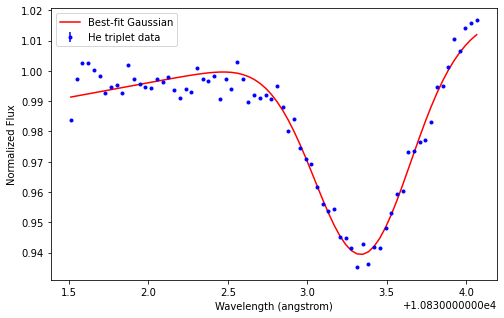

[-1.16695979e+02  7.09103575e-02  1.34312378e+00  2.99510311e-01
  1.07755789e-02  9.68721519e-01]


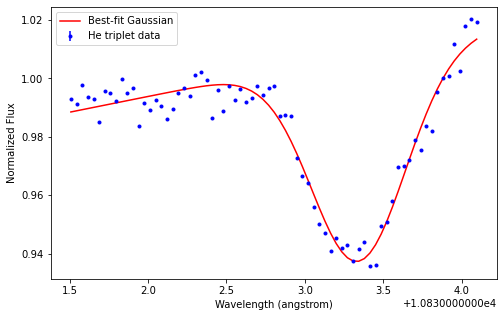

[-1.14331450e+02  7.27136496e-02  1.34631855e+00  2.99518307e-01
  1.05580403e-02  9.64301697e-01]


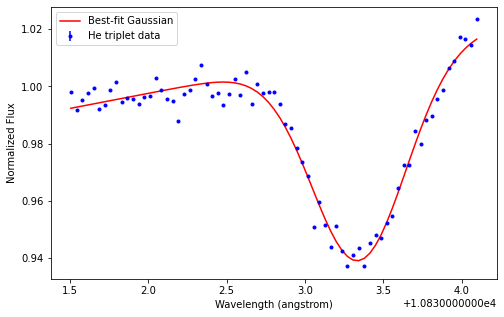

[-1.12582121e+02  6.97184084e-02  1.34565780e+00  2.86313036e-01
  1.03959603e-02  9.68501021e-01]


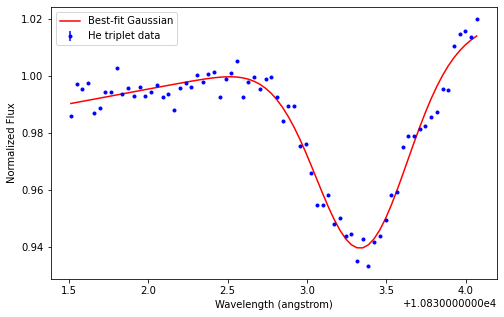

[-1.13129814e+02  7.22569100e-02  1.34097854e+00  2.97875665e-01
  1.04469521e-02  9.65041961e-01]


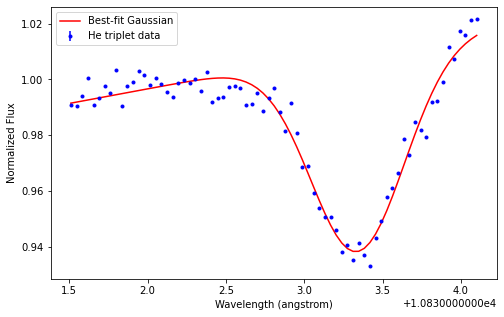

[-1.26145506e+02  7.33325358e-02  1.34845962e+00  3.05587780e-01
  1.16478487e-02  9.69645577e-01]


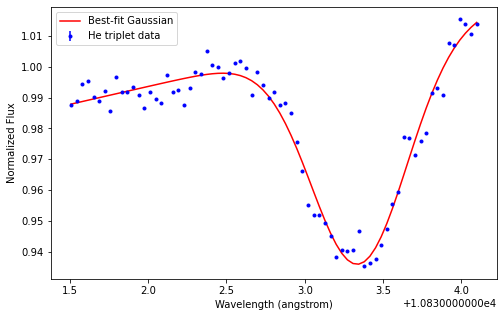

[-1.02554536e+02  7.12545270e-02  1.34049716e+00  2.88918846e-01
  9.47047086e-03  9.68077837e-01]


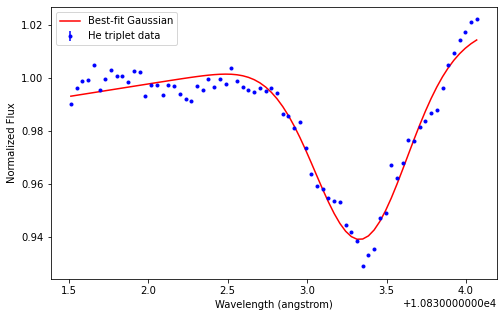

[-1.70033547e+02  7.55756820e-02  1.37334307e+00  3.10713464e-01
  1.57000853e-02  9.69644403e-01]


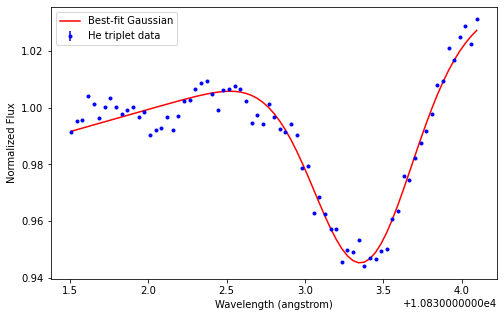

[-1.27800839e+02  7.08767168e-02  1.34189551e+00  3.09851641e-01
  1.18009856e-02  9.68866188e-01]


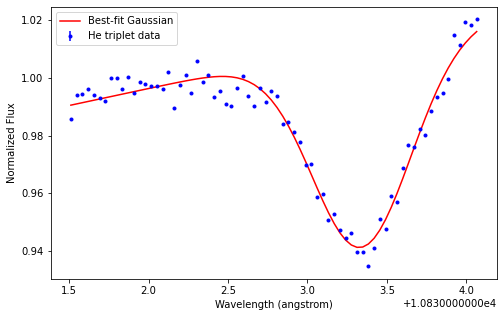

[-1.03437859e+02  7.03325422e-02  1.34168631e+00  2.86572927e-01
  9.55228264e-03  9.63940104e-01]


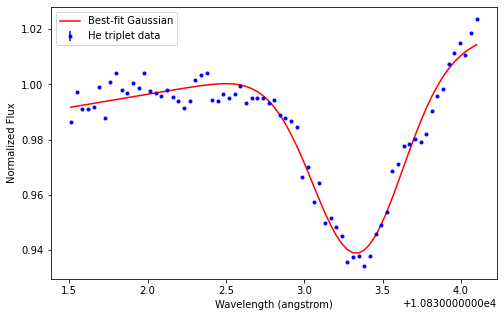

[-1.10433889e+02  7.12765518e-02  1.33739539e+00  2.89383173e-01
  1.01977899e-02  9.67975336e-01]


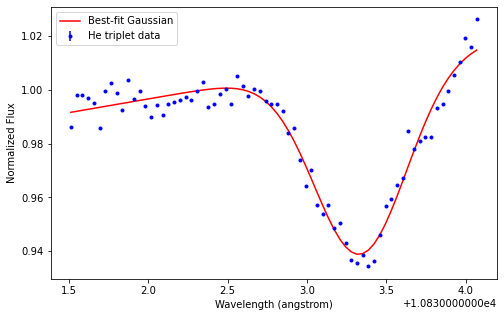

[-1.01295489e+02  6.94842683e-02  1.34010627e+00  2.89440803e-01
  9.35412573e-03  9.68090945e-01]


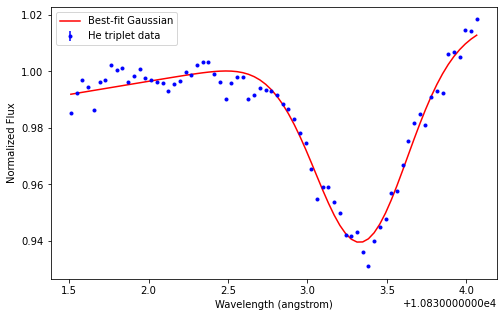

[-8.82475382e+01  7.04998516e-02  1.31899331e+00  2.69623371e-01
  8.14947562e-03  9.68311659e-01]


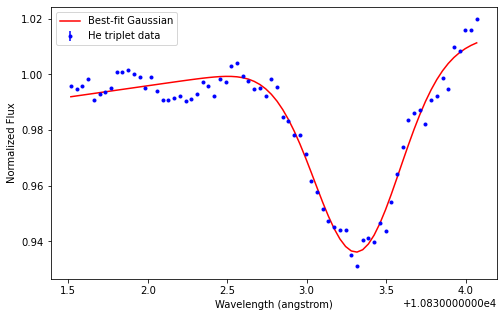

[-1.04063903e+02  7.22281090e-02  1.33588415e+00  3.10561286e-01
  9.60984264e-03  9.69189069e-01]


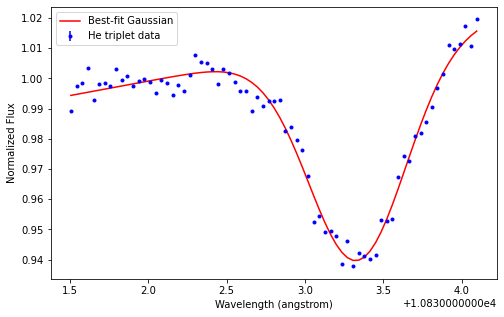

[-1.10725255e+02  7.13886212e-02  1.34380323e+00  3.29305341e-01
  1.02249874e-02  9.66419835e-01]


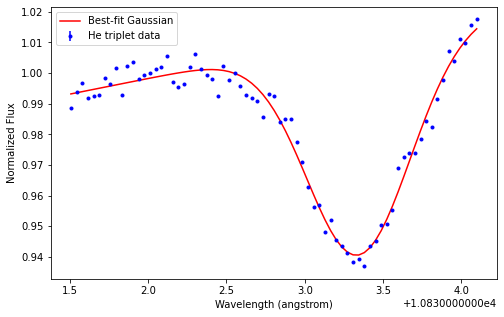

[-1.10764940e+02  7.26819987e-02  1.33537341e+00  3.03578495e-01
  1.02282787e-02  9.69275475e-01]


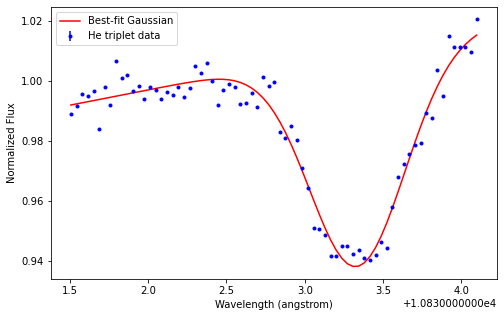

[-1.38988713e+02  7.39975012e-02  1.36362520e+00  3.05942991e-01
  1.28338150e-02  9.69032634e-01]


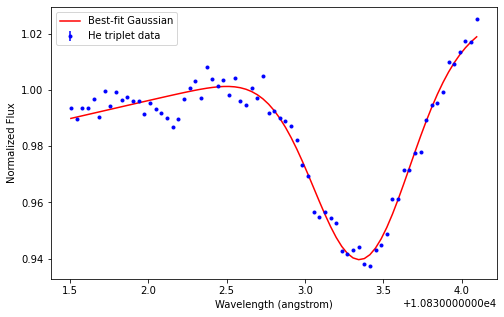

[-1.29291791e+02  7.10081700e-02  1.34701391e+00  3.11338219e-01
  1.19386459e-02  9.68250161e-01]


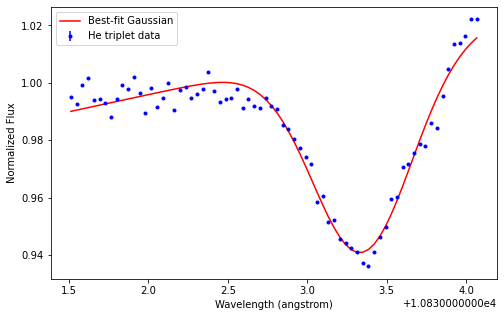

[-1.27255130e+02  7.28687946e-02  1.34820762e+00  2.93383548e-01
  1.17507602e-02  9.67195608e-01]


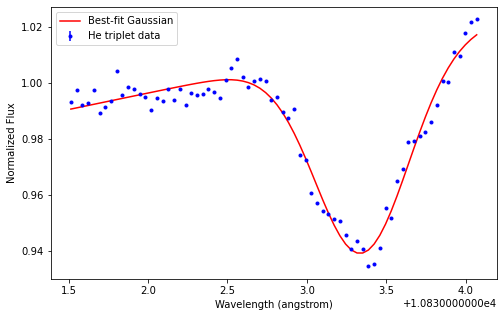

[-1.10505820e+02  7.00078916e-02  1.33669103e+00  2.92586773e-01
  1.02045700e-02  9.68065167e-01]


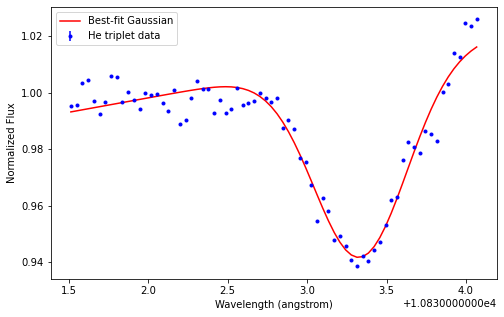

[-1.16890733e+02  7.12364873e-02  1.35124053e+00  2.96832433e-01
  1.07937767e-02  9.68964863e-01]


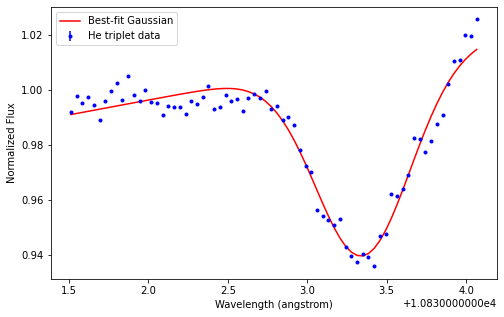

[-1.13834737e+02  6.91672762e-02  1.35811073e+00  2.86612948e-01
  1.05117278e-02  9.66915406e-01]


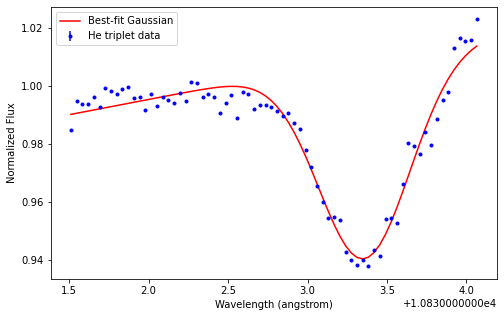

[-9.62164070e+01  7.10832339e-02  1.33990632e+00  2.77382580e-01
  8.88581735e-03  9.61573557e-01]


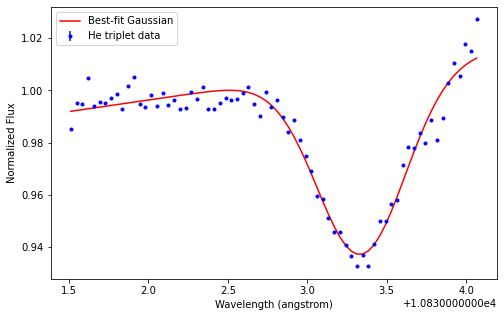

[-1.08852911e+02  7.06662204e-02  1.34294646e+00  2.86747237e-01
  1.00513575e-02  9.71435220e-01]


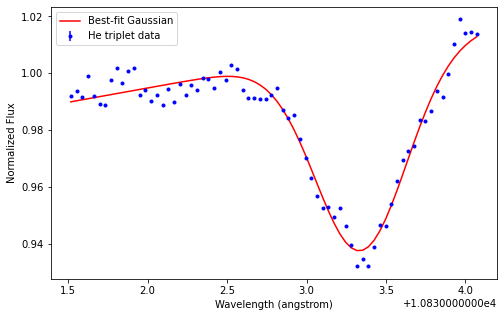

[-8.51468002e+01  6.92526128e-02  1.33174661e+00  2.90330295e-01
  7.86314801e-03  9.69211716e-01]


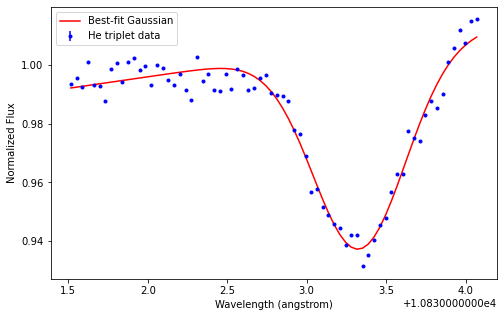

[-1.07733049e+02  6.93277534e-02  1.36239780e+00  3.02699270e-01
  9.94815397e-03  9.69456043e-01]


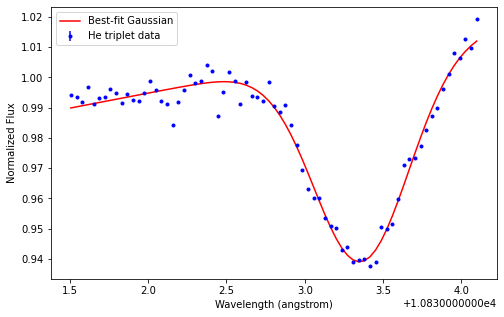

[-1.06280669e+02  7.16457477e-02  1.33004033e+00  2.83693025e-01
  9.81419562e-03  9.68831000e-01]


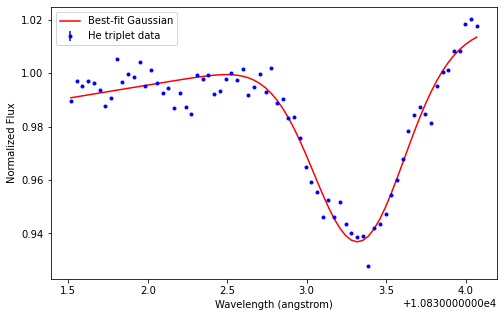

[-1.05833733e+02  7.14322476e-02  1.34358377e+00  2.87218850e-01
  9.77297201e-03  9.69243576e-01]


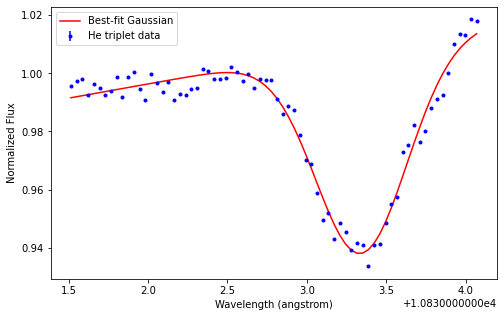

[-1.24373499e+02  7.15555159e-02  1.33999153e+00  2.90046387e-01
  1.14851684e-02  9.61372833e-01]


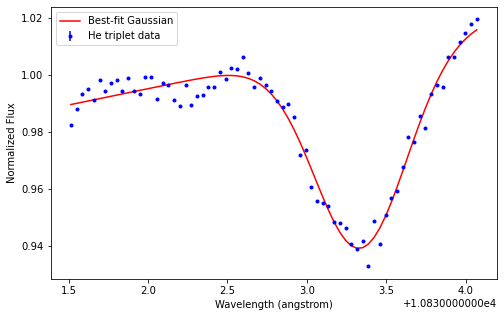

[-1.36817006e+02  7.38145237e-02  1.34012668e+00  3.06204893e-01
  1.26336452e-02  9.66540120e-01]


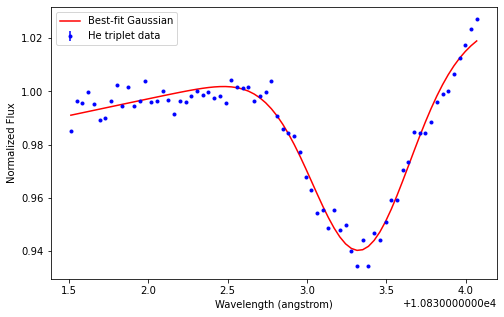

[-1.48978877e+02  7.44497312e-02  1.36005242e+00  3.17540401e-01
  1.37561636e-02  9.66864913e-01]


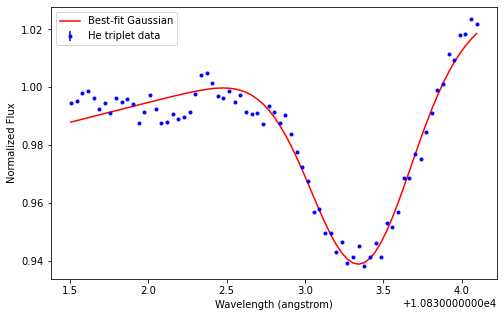

[-1.15272749e+02  6.91812110e-02  1.34204748e+00  2.97475769e-01
  1.06441563e-02  9.67103385e-01]


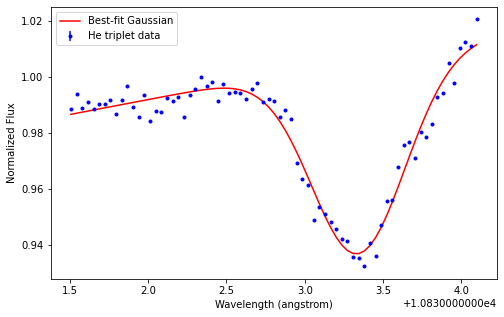

[-1.06205172e+02  6.96874356e-02  1.33428893e+00  2.92724941e-01
  9.80662577e-03  9.68922400e-01]


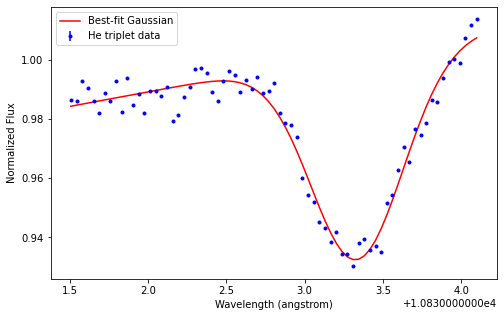

[-1.05962990e+02  7.11257131e-02  1.33443543e+00  2.83696953e-01
  9.78494110e-03  9.68661922e-01]


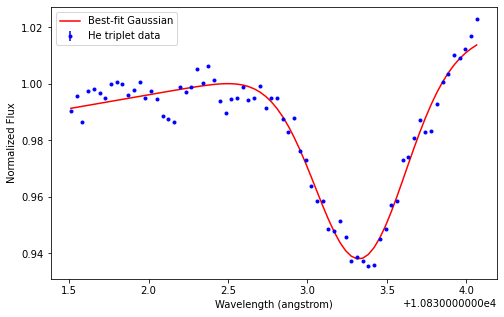

[-1.14476741e+02  6.94521227e-02  1.34495782e+00  2.86613190e-01
  1.05708691e-02  9.68283957e-01]


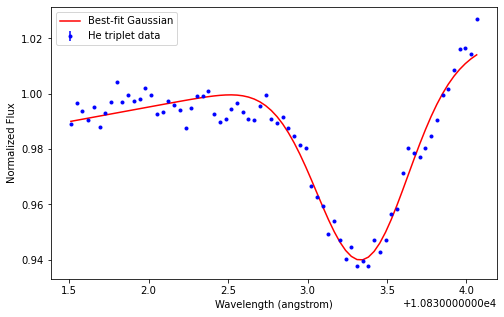

[-9.85356990e+01  7.26492460e-02  1.32623973e+00  2.81697571e-01
  9.09935279e-03  9.68566611e-01]


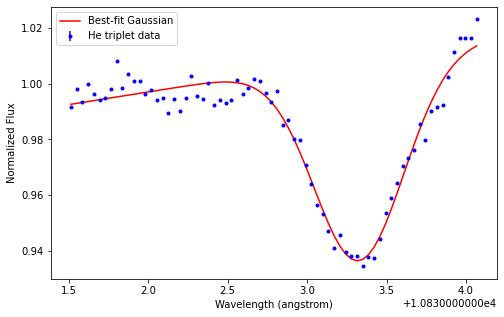

[-9.99132631e+01  6.91904766e-02  1.34729922e+00  2.94886609e-01
  9.22635569e-03  9.69647269e-01]


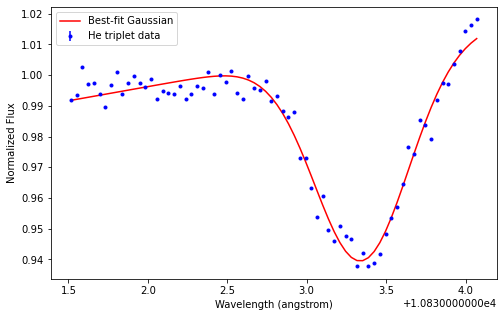

[-1.08393545e+02  7.24106189e-02  1.34758030e+00  2.90585354e-01
  1.00092918e-02  9.68946589e-01]


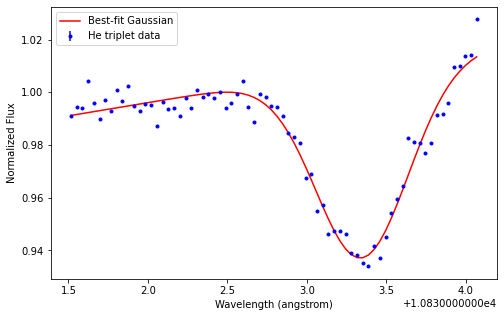

[-8.76145017e+01  6.86367522e-02  1.33715308e+00  2.74257788e-01
  8.09103377e-03  9.69262244e-01]


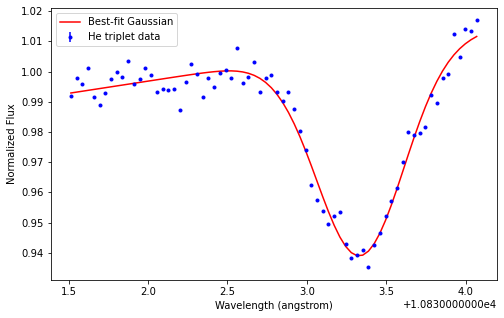

[-1.28489794e+02  7.24359679e-02  1.34335429e+00  2.96459780e-01
  1.18647799e-02  9.66757750e-01]


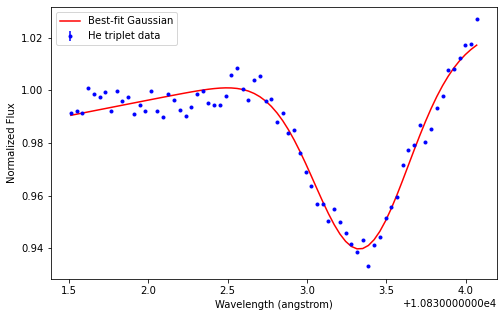

[-1.10462128e+02  7.24926406e-02  1.34391772e+00  2.86216567e-01
  1.02000085e-02  9.68989781e-01]


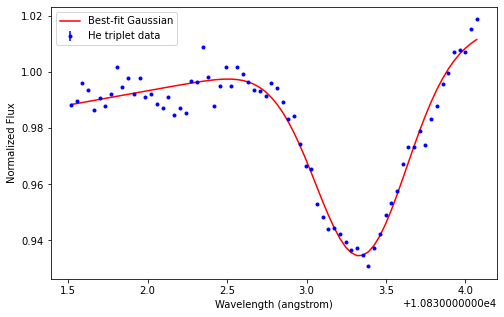

[-1.22095123e+02  7.02380725e-02  1.34662139e+00  2.81918365e-01
  1.12739177e-02  9.70525917e-01]


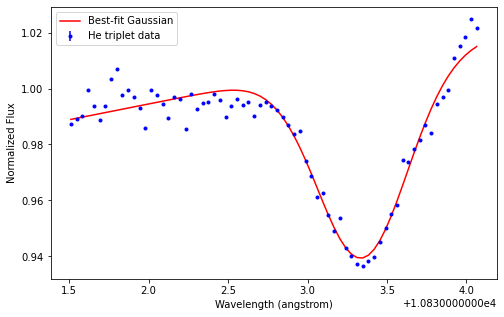

[-1.13922078e+02  7.08735138e-02  1.33306151e+00  2.98409549e-01
  1.05196941e-02  9.69258000e-01]


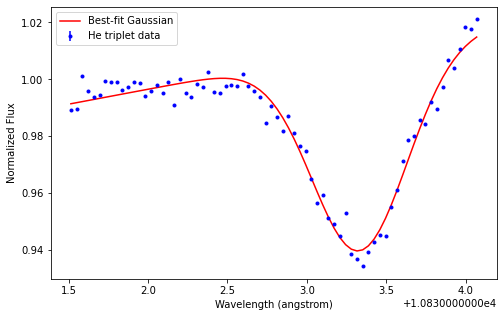

[-1.03563972e+02  6.98922938e-02  1.34368313e+00  2.88167929e-01
  9.56335755e-03  9.68314035e-01]


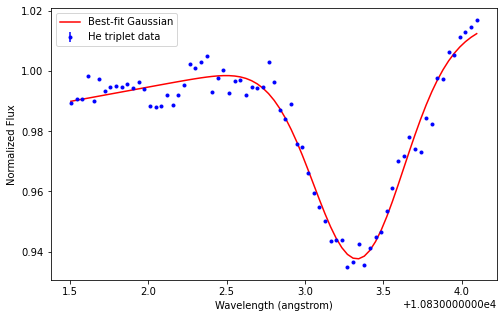

[-1.15410510e+02  7.01653333e-02  1.34266224e+00  2.85324081e-01
  1.06573308e-02  9.65247260e-01]


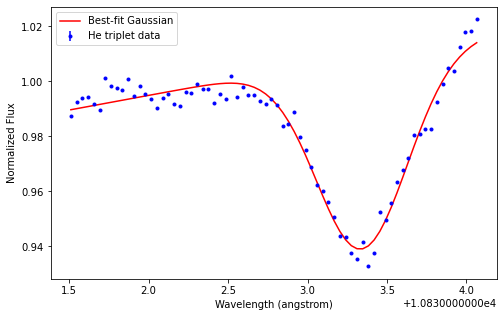

[-8.74930850e+01  6.93711324e-02  1.34154294e+00  2.76140676e-01
  8.07966760e-03  9.69465609e-01]


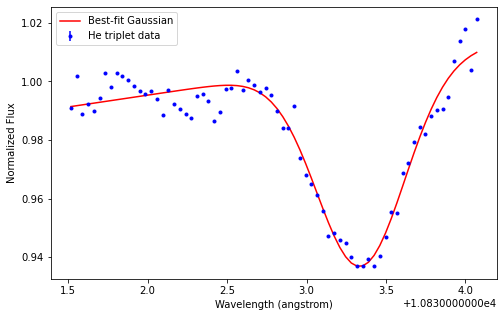

[-1.15643007e+02  7.01745277e-02  1.34373111e+00  3.10437115e-01
  1.06783657e-02  9.69253442e-01]


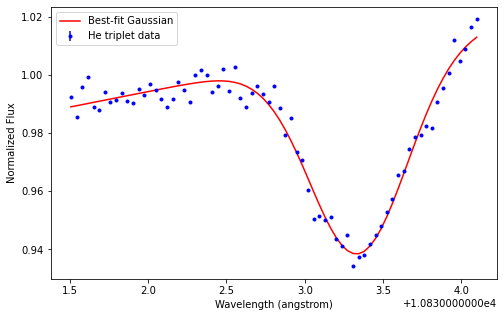

[-1.34832802e+02  7.36089521e-02  1.35769236e+00  3.07077319e-01
  1.24502222e-02  9.68938814e-01]


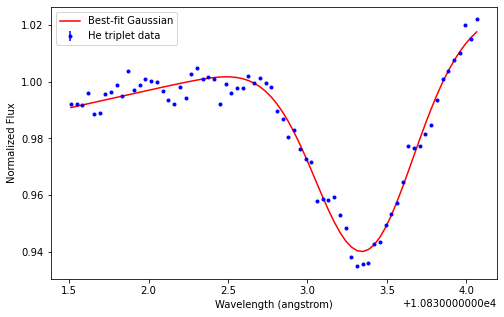

[-1.11060345e+02  7.27903743e-02  1.34513995e+00  2.94799752e-01
  1.02556147e-02  9.68882298e-01]


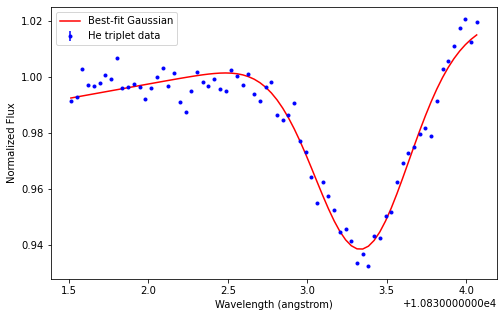

[-1.28418472e+02  7.20963095e-02  1.34340026e+00  2.98088748e-01
  1.18580394e-02  9.68440416e-01]


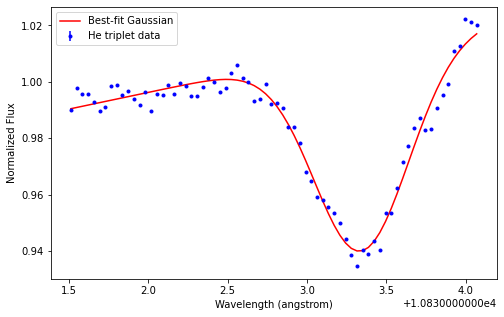

[-1.29290834e+02  7.26335935e-02  1.33376087e+00  2.94649615e-01
  1.19393529e-02  9.59854619e-01]


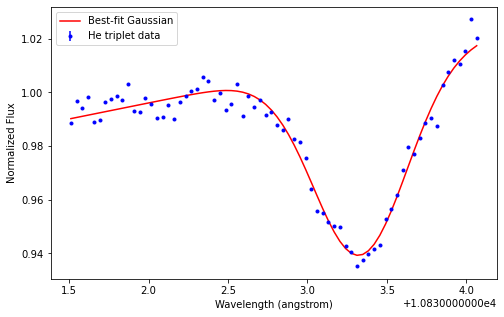

[-1.08793627e+02  7.28958464e-02  1.34742781e+00  2.96496607e-01
  1.00465828e-02  9.66223809e-01]


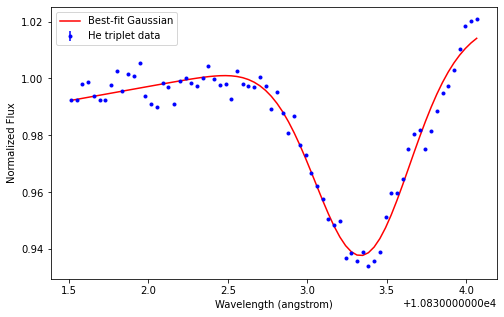

[-1.18233817e+02  7.08975857e-02  1.36397401e+00  2.92397217e-01
  1.09177495e-02  9.69286273e-01]


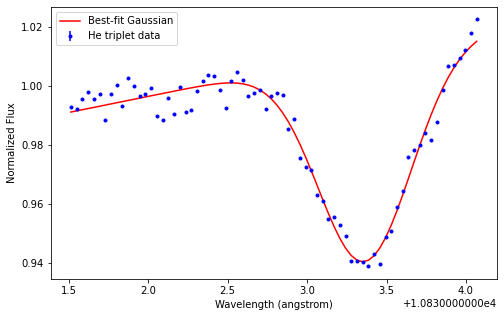

[-1.38792451e+02  7.26555918e-02  1.34609503e+00  3.01325768e-01
  1.28156143e-02  9.68471333e-01]


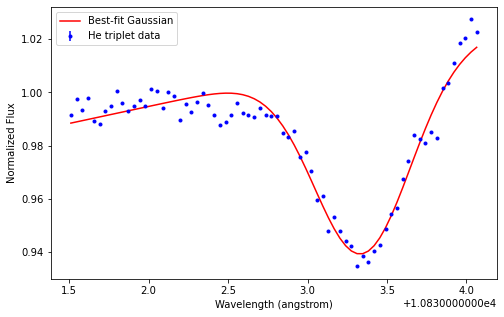

[-1.19013132e+02  7.07254240e-02  1.34960729e+00  3.01090578e-01
  1.09896575e-02  9.68856332e-01]


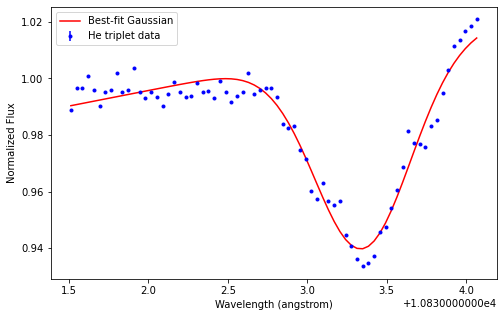

[-1.66244961e+02  7.75134855e-02  1.35935709e+00  3.07191179e-01
  1.53498622e-02  9.69856579e-01]


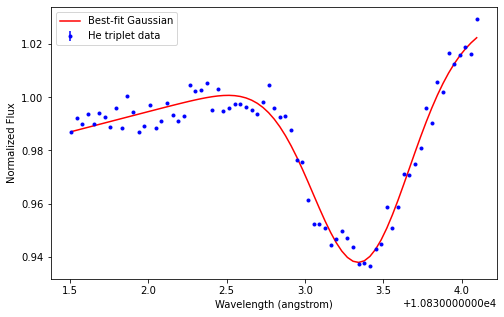

[-1.03511344e+02  6.91635294e-02  1.33998630e+00  2.84899659e-01
  9.55850767e-03  9.69237081e-01]


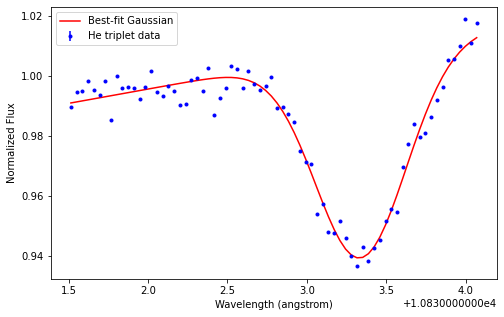

[-1.08880069e+02  7.14802153e-02  1.33743146e+00  2.95966320e-01
  1.00541267e-02  9.68884234e-01]


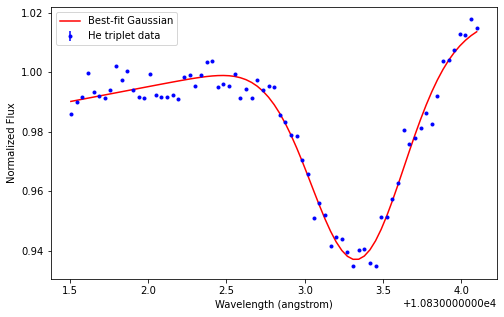

[-1.07915842e+02  7.20754353e-02  1.35198103e+00  2.86462480e-01
  9.96523521e-03  9.69223593e-01]


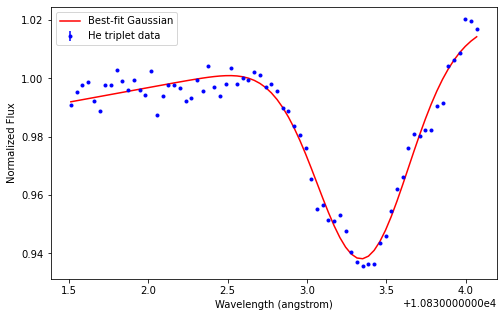

[-1.21093707e+02  7.01050119e-02  1.33908385e+00  3.00298866e-01
  1.11816925e-02  9.69034444e-01]


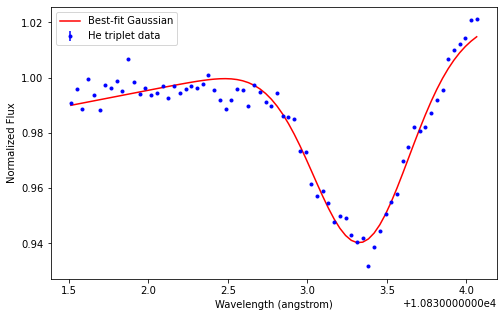

[-1.22928757e+02  7.14040911e-02  1.34703483e+00  2.96625601e-01
  1.13511216e-02  9.68718019e-01]


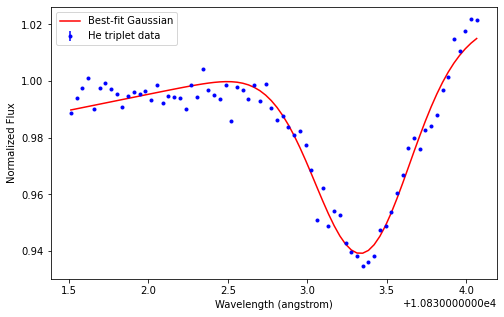

[-1.09532396e+02  7.12904599e-02  1.34832018e+00  2.81671747e-01
  1.01145242e-02  9.66327694e-01]


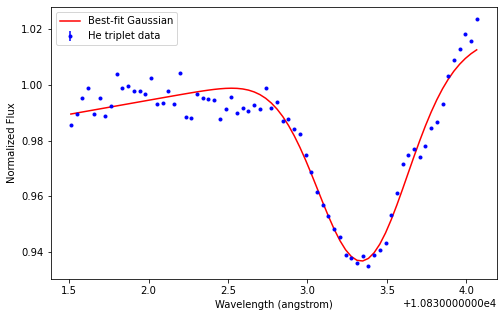

[-1.33795603e+02  7.31564106e-02  1.34392468e+00  3.09085913e-01
  1.23544133e-02  9.68911172e-01]


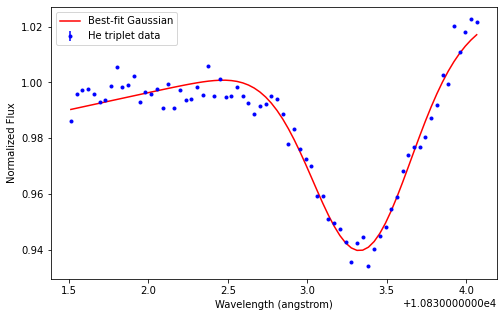

[-1.11757495e+02  7.24799714e-02  1.35025941e+00  3.09249358e-01
  1.03199741e-02  9.69361588e-01]


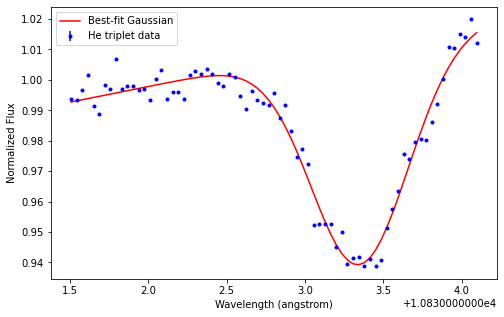

[-1.07561127e+02  6.95197735e-02  1.34047789e+00  2.74297508e-01
  9.93255108e-03  9.67687174e-01]


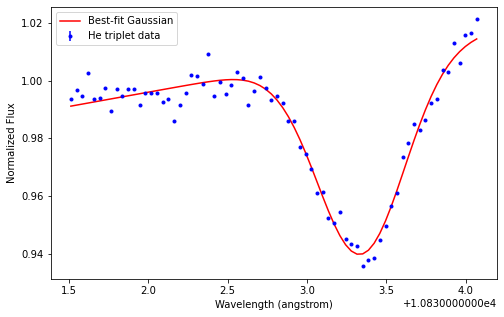

[-1.21523666e+02  7.23584198e-02  1.34834061e+00  2.99839084e-01
  1.12214260e-02  9.69099664e-01]


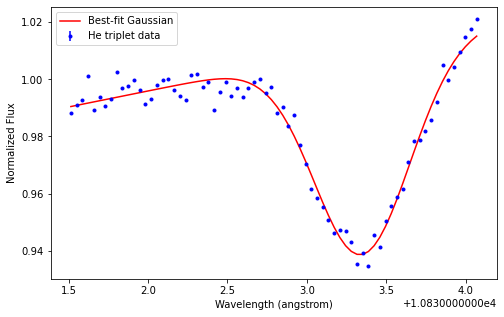

[-1.87940390e+02  7.75569865e-02  1.37209604e+00  3.12177323e-01
  1.73544795e-02  9.50038796e-01]


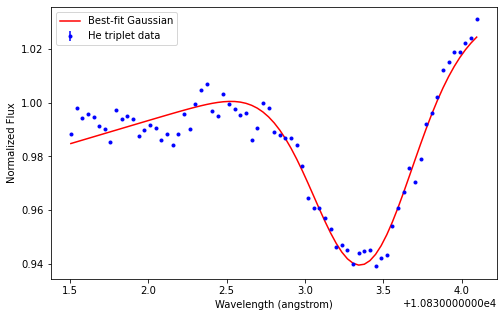

[-1.32718211e+02  7.29824650e-02  1.35535674e+00  2.93287778e-01
  1.22557483e-02  9.60521160e-01]


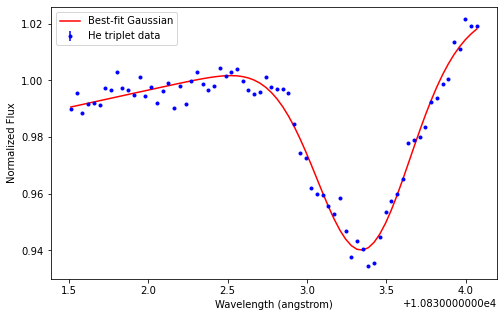

[-1.14680198e+02  7.11852115e-02  1.35896666e+00  2.78918828e-01
  1.05911456e-02  9.52975011e-01]


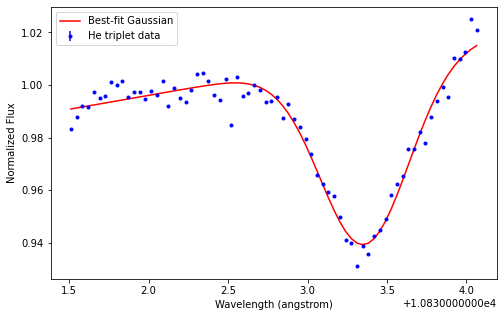

[-9.46741312e+01  6.96779558e-02  1.35066121e+00  2.86974458e-01
  8.74254403e-03  9.69448845e-01]


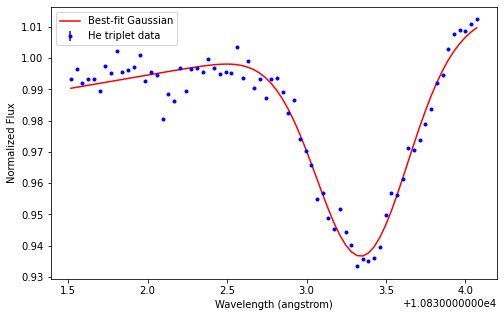

[-1.29187750e+02  7.51618851e-02  1.33896596e+00  2.98879319e-01
  1.19292473e-02  9.65734615e-01]


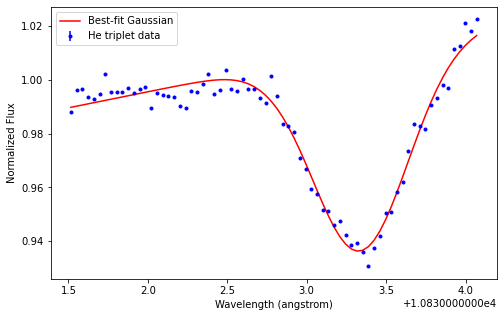

[-1.13709432e+02  7.03211690e-02  1.34625896e+00  2.94771410e-01
  1.05000645e-02  9.68460685e-01]


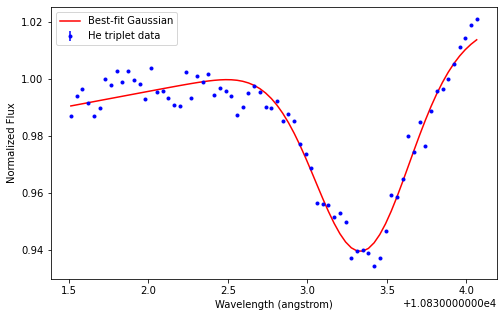

[-9.50994356e+01  6.93647228e-02  1.33127129e+00  2.72557257e-01
  8.78210620e-03  9.68322203e-01]


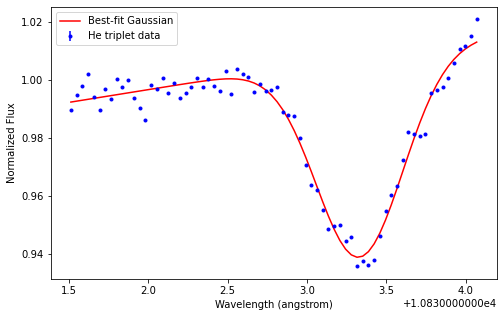

[-1.03771072e+02  7.00377928e-02  1.33918899e+00  2.87105204e-01
  9.58263871e-03  9.68712132e-01]


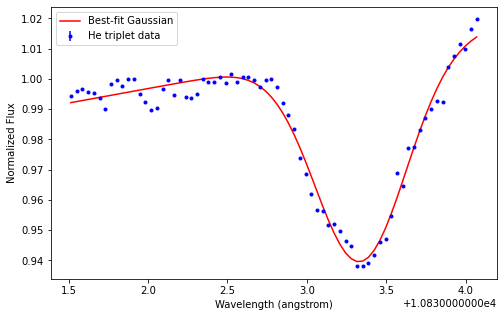

[-9.24111410e+01  6.89094387e-02  1.33178581e+00  2.78045962e-01
  8.53367343e-03  9.69103184e-01]


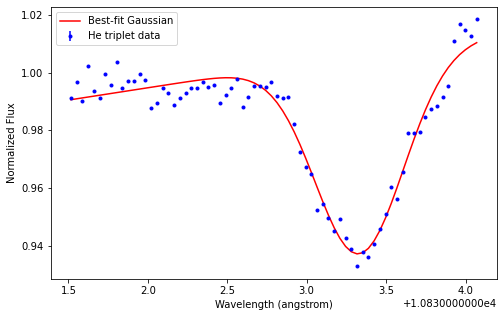

[-1.17318588e+02  7.14729243e-02  1.35368768e+00  2.79579839e-01
  1.08332907e-02  9.68052339e-01]


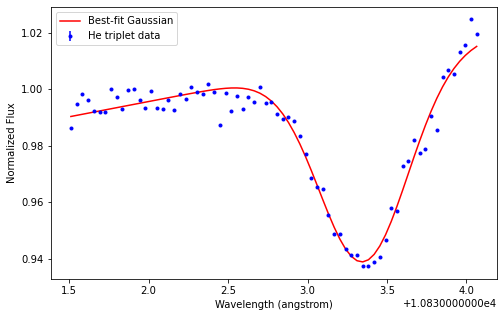

[-1.01299367e+02  7.03016208e-02  1.34647996e+00  2.82843551e-01
  9.35427556e-03  9.69081256e-01]


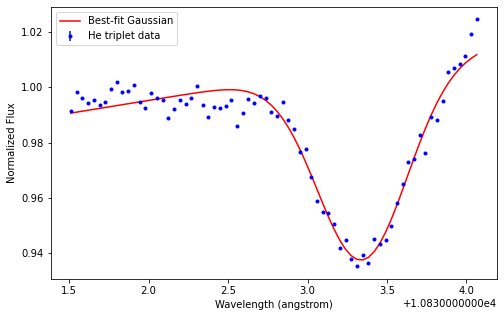

[-1.20067357e+02  7.25424457e-02  1.34313871e+00  3.01578053e-01
  1.10869694e-02  9.70556922e-01]


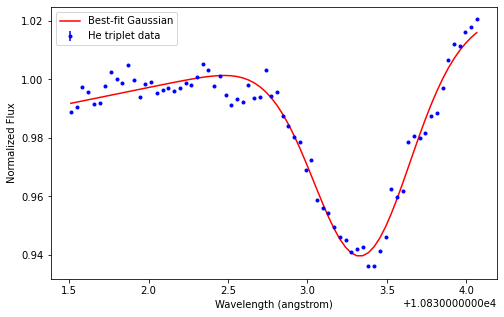

[-1.22324527e+02  7.25297726e-02  1.34152972e+00  3.05958020e-01
  1.12960262e-02  9.62495273e-01]


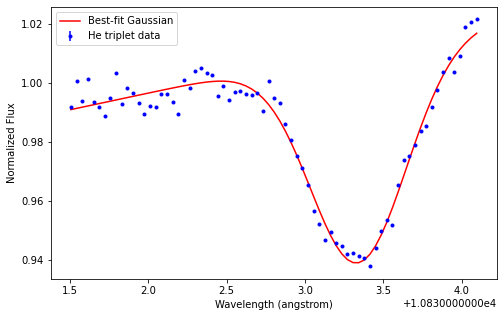

[-4.61518653e+01  6.59327384e-02  1.32628449e+00  2.69917490e-01
  4.26279928e-03  9.69610570e-01]


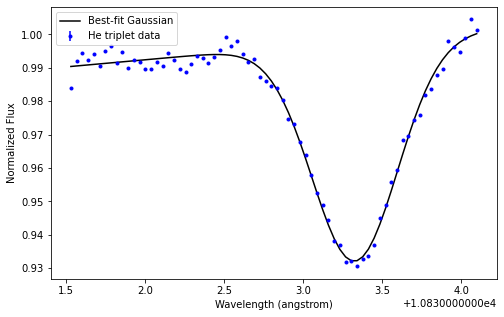

[-2.82618719e+01  6.41139929e-02  1.31660477e+00  2.63464715e-01
  2.61145609e-03  9.69932620e-01]


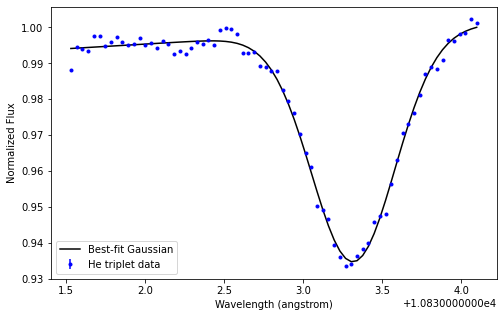

[-4.54018893e+01  6.59366307e-02  1.32004149e+00  2.76822575e-01
  4.19382441e-03  9.69483065e-01]


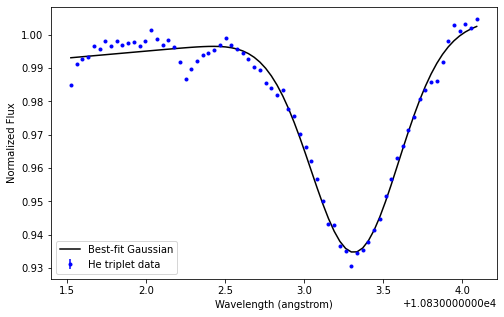

[-5.52516824e+01  6.78247205e-02  1.33002774e+00  2.77895481e-01
  5.10306804e-03  9.69309151e-01]


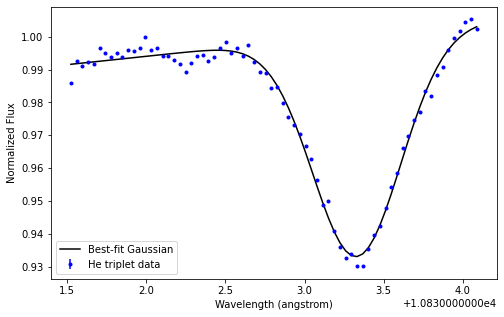

[-3.58690354e+01  6.39903449e-02  1.31736901e+00  2.72432508e-01
  3.31415322e-03  9.65462505e-01]


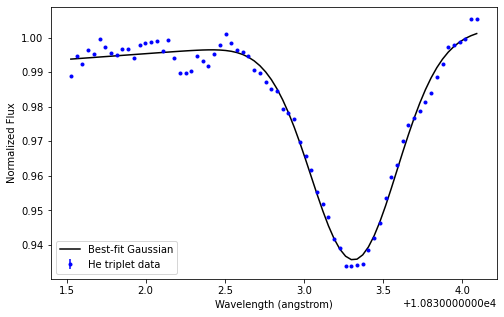

[-4.48550007e+01  6.71576625e-02  1.32400410e+00  2.60502284e-01
  4.14290493e-03  9.69661516e-01]


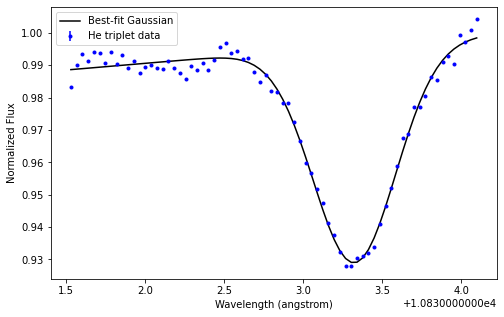

[-6.45578516e+01  6.80522402e-02  1.32597045e+00  2.80874902e-01
  5.96231043e-03  9.68951578e-01]


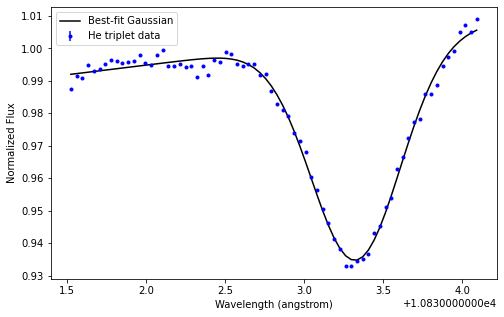

[-4.94634264e+01  6.54776532e-02  1.31925559e+00  2.69799101e-01
  4.56833203e-03  9.69891605e-01]


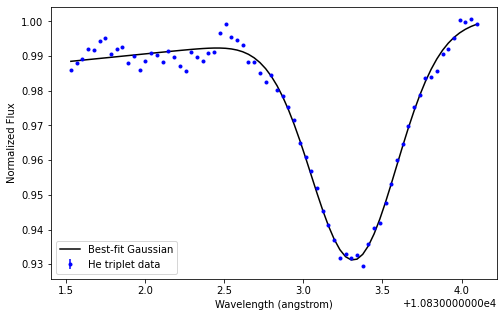

[-4.60099666e+01  6.57506592e-02  1.32576576e+00  2.69920168e-01
  4.24962001e-03  9.69477279e-01]


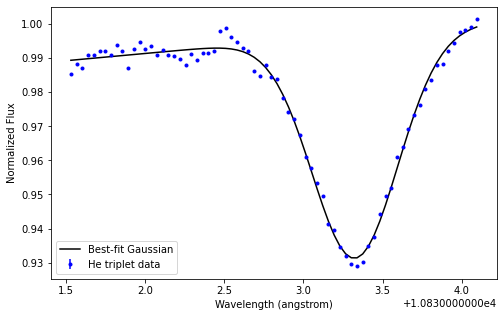

[-2.49925979e+01  6.44454406e-02  1.32122497e+00  2.59552861e-01
  2.30938322e-03  9.69557168e-01]


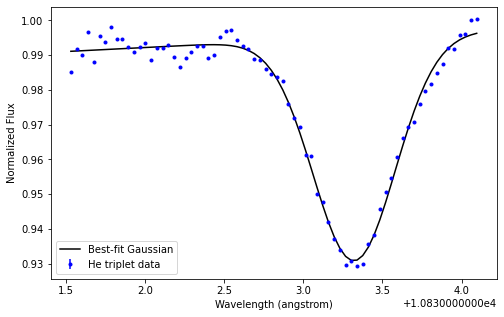

[-3.78752076e+01  6.44988168e-02  1.31556686e+00  2.76936085e-01
  3.49899418e-03  9.65109609e-01]


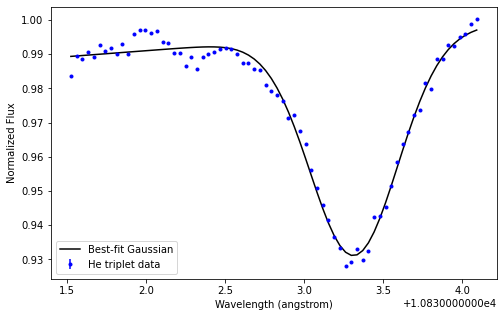

[-5.03468577e+01  6.70314548e-02  1.31979567e+00  2.78320231e-01
  4.65032553e-03  9.69309455e-01]


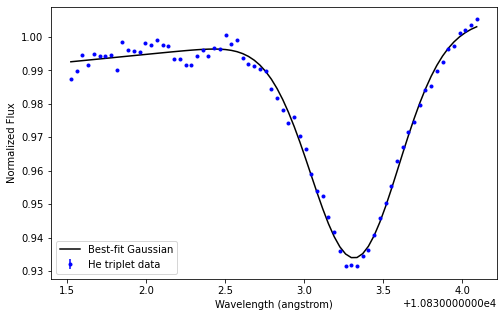

[-4.83877026e+01  6.74219760e-02  1.30752472e+00  2.73121463e-01
  4.46960127e-03  9.69612166e-01]


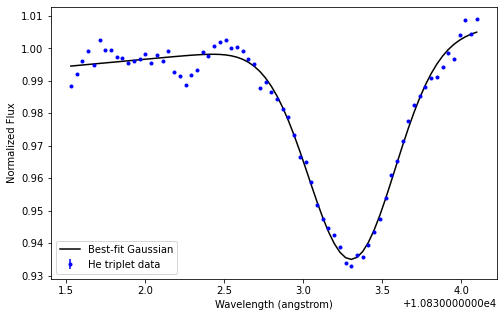

[-3.84059988e+01  6.49834757e-02  1.32334317e+00  2.71774534e-01
  3.54808996e-03  9.67246312e-01]


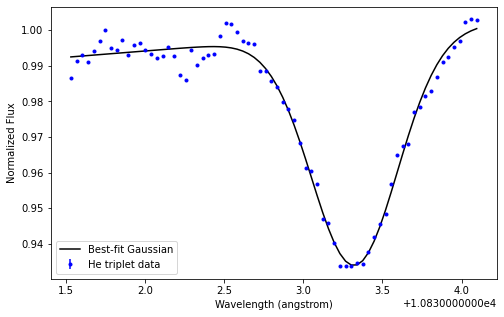

[-3.90458454e+01  6.61000823e-02  1.32418520e+00  2.77608641e-01
  3.60791470e-03  9.62756925e-01]


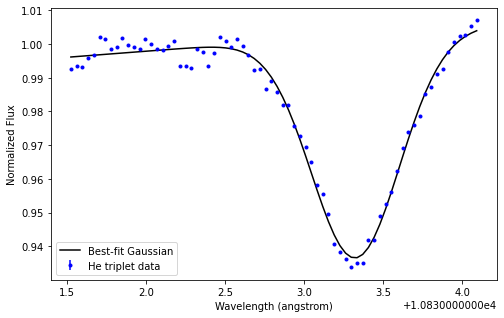

[-4.49295186e+01  6.60717873e-02  1.30921447e+00  2.65483075e-01
  4.15019018e-03  9.69516308e-01]


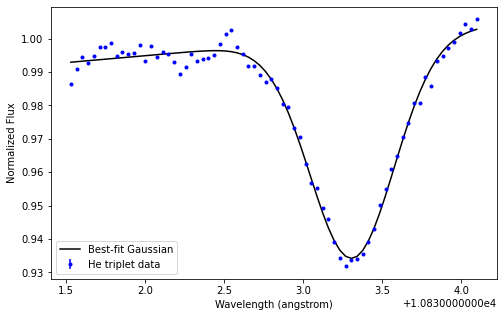

[-4.51037099e+01  6.57177108e-02  1.32313943e+00  2.69136227e-01
  4.16597202e-03  9.69464591e-01]


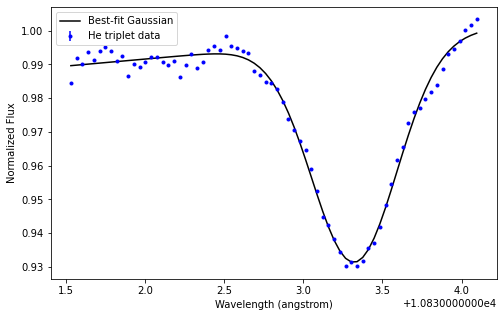

[-3.89228364e+01  6.44421532e-02  1.32051537e+00  2.73533772e-01
  3.59613751e-03  9.63934240e-01]


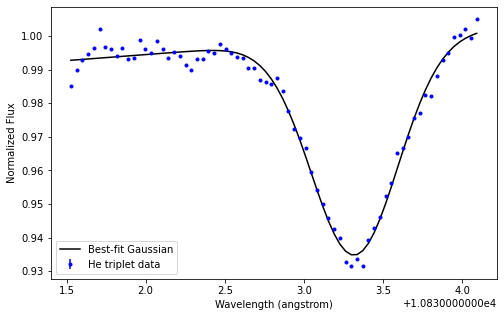

[-4.73285566e+01  6.49825519e-02  1.32445827e+00  2.78980343e-01
  4.37203492e-03  9.61959909e-01]


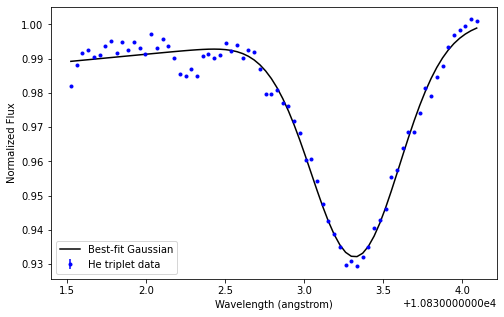

[-4.24579495e+01  6.59368924e-02  1.32454263e+00  2.65234392e-01
  3.92196455e-03  9.69932078e-01]


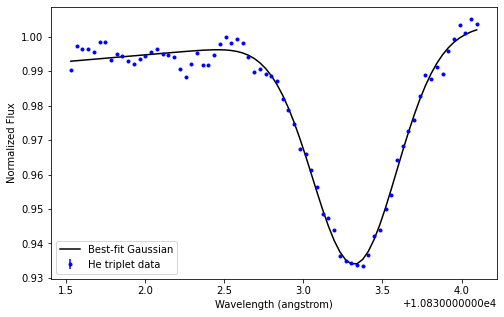

[-3.27915945e+01  6.58384261e-02  1.31711841e+00  2.61655692e-01
  3.02959632e-03  9.70055456e-01]


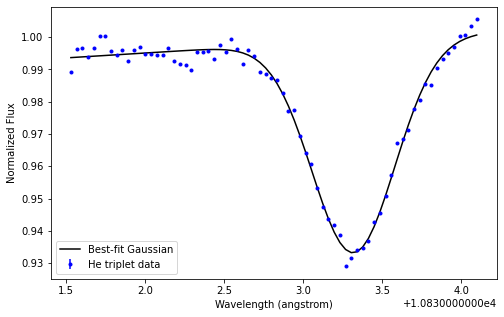

[-3.85732095e+01  6.40277886e-02  1.31528728e+00  2.68226081e-01
  3.56476344e-03  9.54824638e-01]


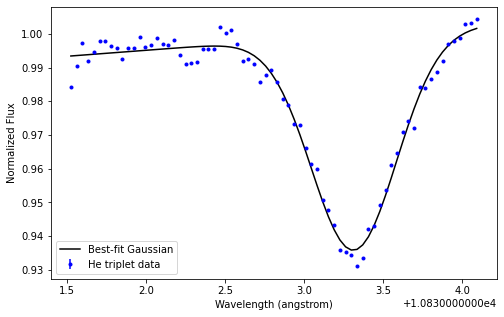

[-4.52313476e+01  6.61263544e-02  1.31774809e+00  2.67770701e-01
  4.17803114e-03  9.69909146e-01]


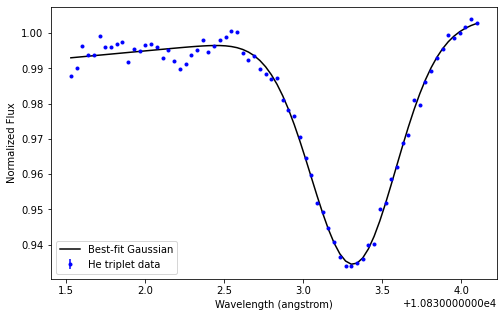

[-4.42175140e+01  6.51311122e-02  1.32228736e+00  2.81362672e-01
  4.08511177e-03  9.61880293e-01]


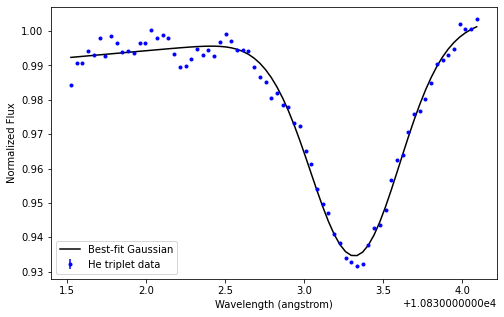

[-3.99337281e+01  6.64003761e-02  1.32037432e+00  2.70199955e-01
  3.68929456e-03  9.66167430e-01]


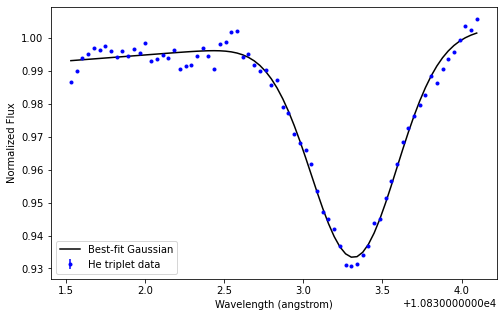

[-4.55869549e+01  6.69807567e-02  1.32071010e+00  2.73194586e-01
  4.21082436e-03  9.70336505e-01]


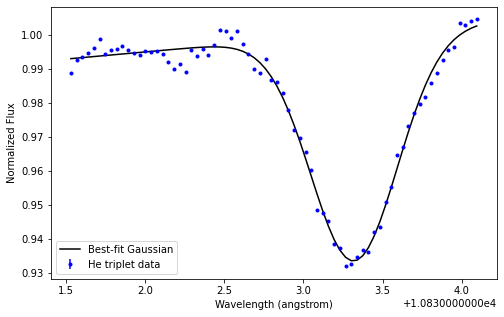

[-6.60275535e+01  6.93649223e-02  1.33134645e+00  2.87329328e-01
  6.09783246e-03  9.68447835e-01]


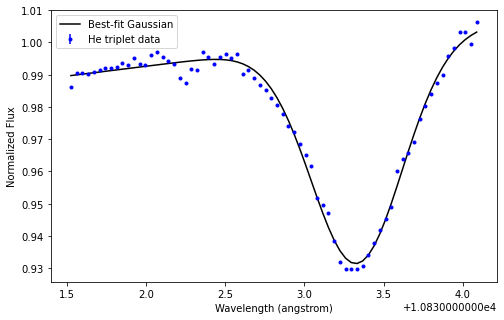

[-6.09228034e+01  6.77251434e-02  1.32607633e+00  2.83369558e-01
  5.62655352e-03  9.68591824e-01]


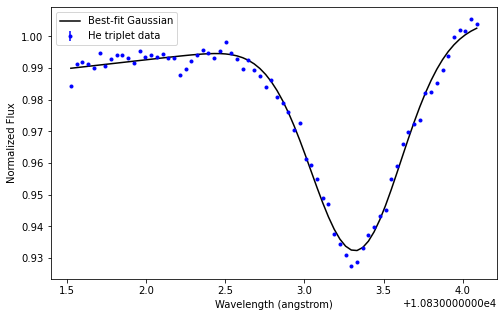

[-3.85969055e+01  6.63008281e-02  1.32243302e+00  2.63512597e-01
  3.56541993e-03  9.70203891e-01]


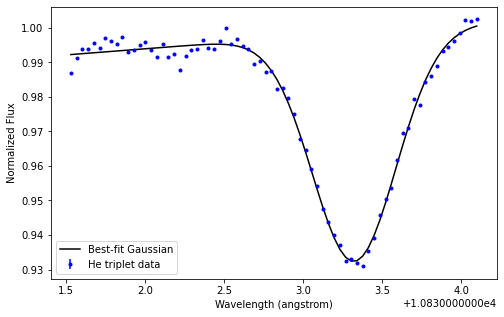

[-5.96041296e+01  6.71517591e-02  1.32246559e+00  2.81825225e-01
  5.50439510e-03  9.69261940e-01]


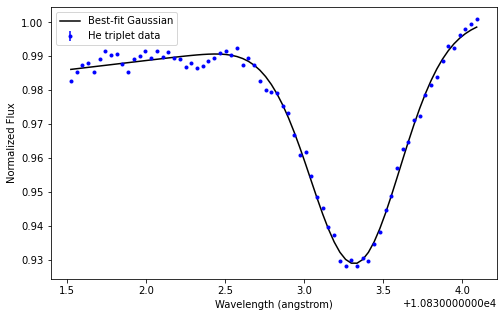

[-4.06613432e+01  6.60102585e-02  1.32111878e+00  2.85339111e-01
  3.75711398e-03  9.63651687e-01]


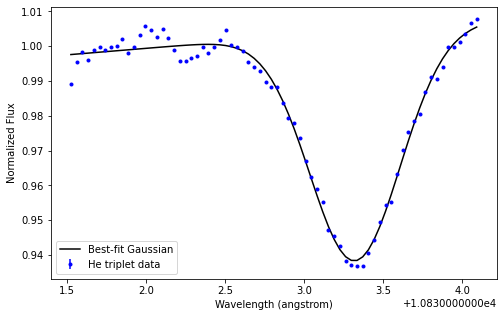

[-4.23731209e+01  6.43040436e-02  1.31713347e+00  2.80590984e-01
  3.91479679e-03  9.62081725e-01]


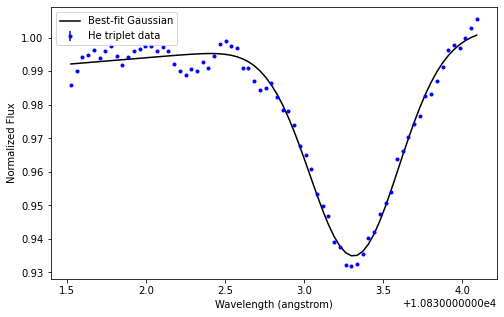

[-4.61983587e+01  6.53752126e-02  1.32229270e+00  2.74807465e-01
  4.26709749e-03  9.69924108e-01]


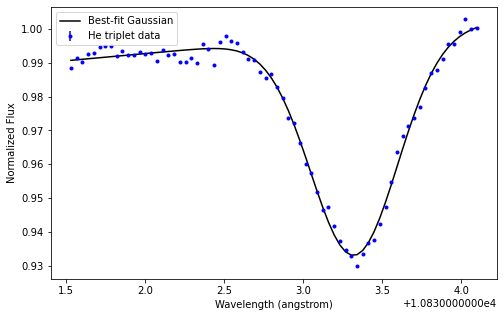

[-4.53584971e+01  6.56380775e-02  1.32238856e+00  2.69511520e-01
  4.18977861e-03  9.69607947e-01]


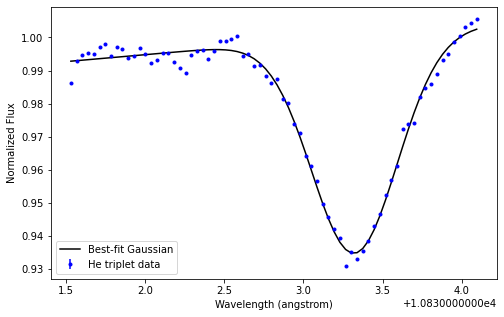

[-6.97648460e+01  6.89292810e-02  1.33728527e+00  2.91905578e-01
  6.44280452e-03  9.66771359e-01]


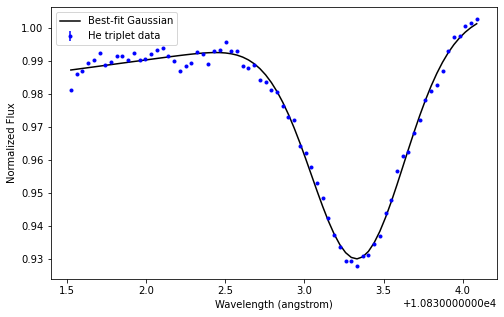

[-4.58678354e+01  6.50961476e-02  1.32543644e+00  2.73879865e-01
  4.23635391e-03  9.70240834e-01]


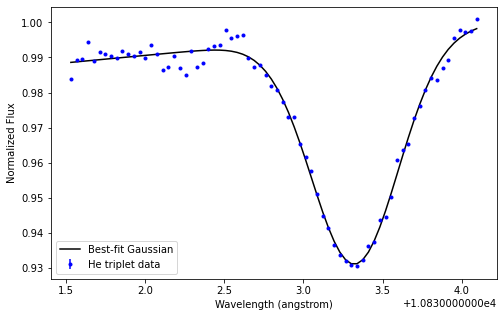

[-3.41524985e+01  6.54141556e-02  1.32135131e+00  2.63817708e-01
  3.15506184e-03  9.67944841e-01]


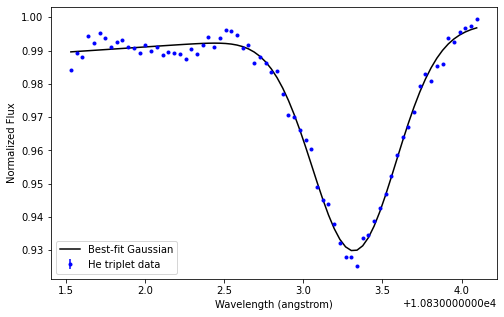

[-5.82717329e+01  6.78913611e-02  1.32886726e+00  2.80346819e-01
  5.38157585e-03  9.69180902e-01]


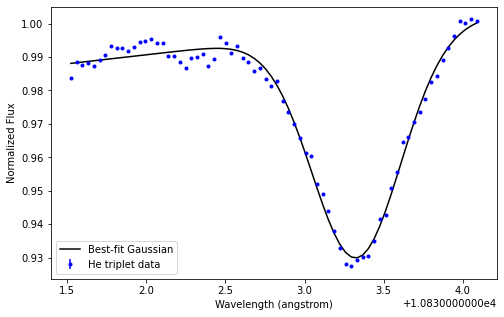

[-4.79327543e+01  6.51641102e-02  1.32007917e+00  2.79708736e-01
  4.42790808e-03  9.62034304e-01]


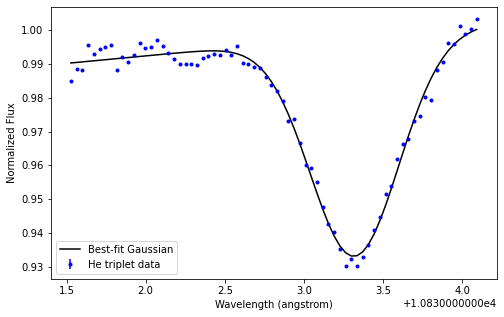

[-4.18639169e+01  6.59401833e-02  1.31839796e+00  2.73680294e-01
  3.86718937e-03  9.69314219e-01]


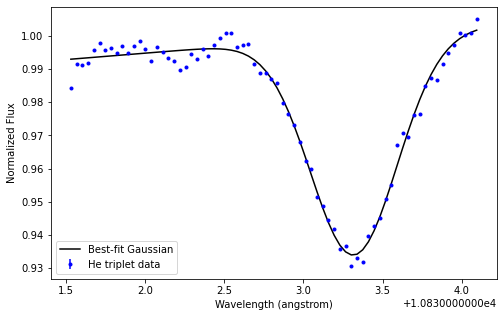

[-4.08448226e+01  6.52142704e-02  1.31758197e+00  2.71042490e-01
  3.77312844e-03  9.69932244e-01]


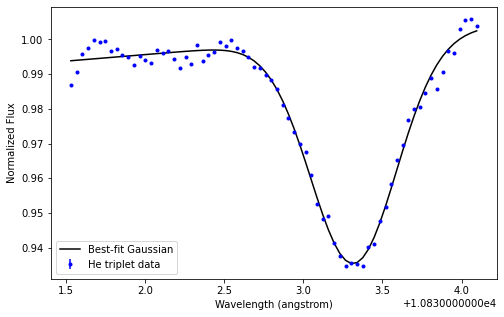

[-3.28604715e+01  6.53476492e-02  1.31765826e+00  2.61196540e-01
  3.03580536e-03  9.69313203e-01]


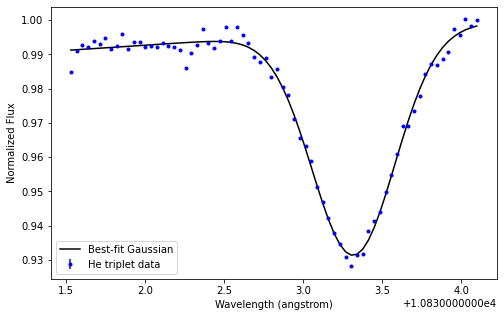

[-3.63723431e+01  6.49907372e-02  1.32394181e+00  2.69351861e-01
  3.36022408e-03  9.67217935e-01]


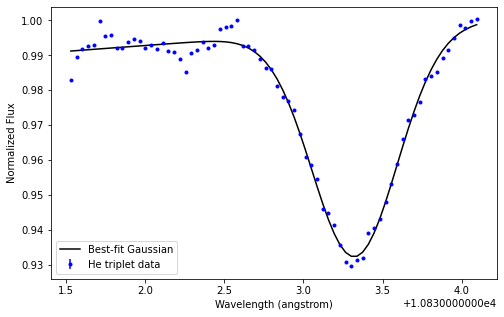

[-3.93519828e+01  6.62427720e-02  1.31668262e+00  2.76031197e-01
  3.63571692e-03  9.66088398e-01]


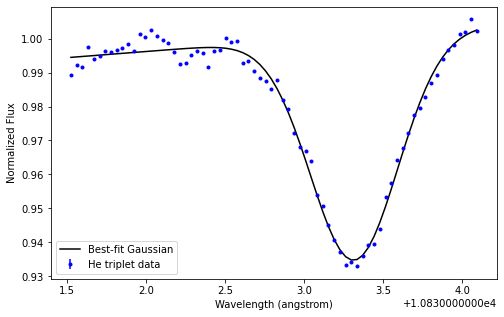

[-5.87501737e+01  6.75875178e-02  1.33150698e+00  2.80815542e-01
  5.42574030e-03  9.68738166e-01]


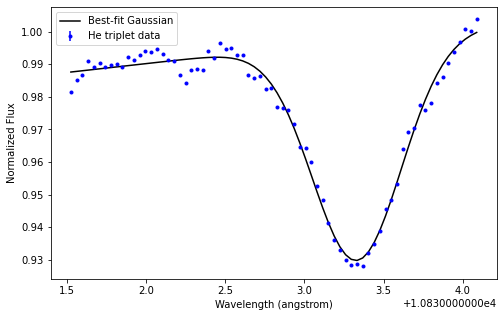

[-4.40714543e+01  6.51806673e-02  1.31168619e+00  2.75666998e-01
  4.07144987e-03  9.63824301e-01]


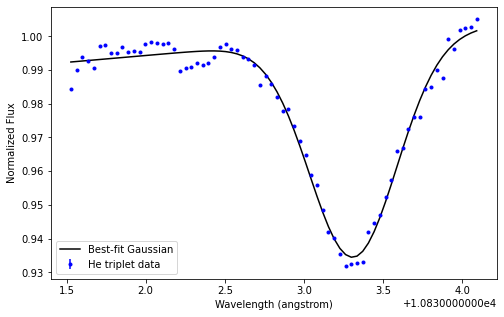

[-4.01122553e+01  6.45858344e-02  1.31180513e+00  2.62629362e-01
  3.70530776e-03  9.69593234e-01]


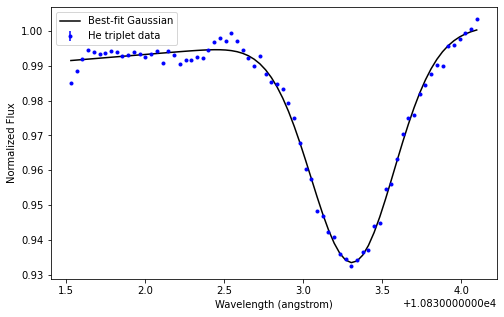

[-6.22528734e+01  6.65404253e-02  1.32143519e+00  2.81515685e-01
  5.74916772e-03  9.69825176e-01]


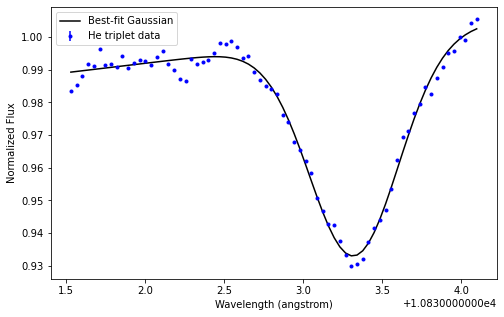

[-4.09580599e+01  6.36362653e-02  1.31661001e+00  2.77094098e-01
  3.78493572e-03  9.53833037e-01]


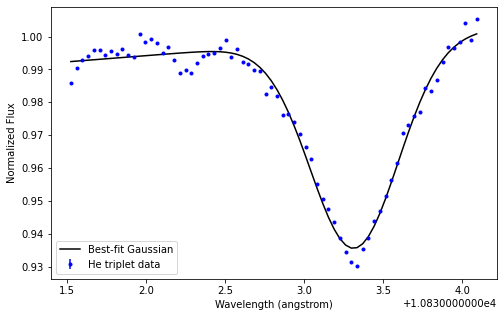

[-4.90906086e+01  6.66889057e-02  1.32039725e+00  2.78206091e-01
  4.53440590e-03  9.69491173e-01]


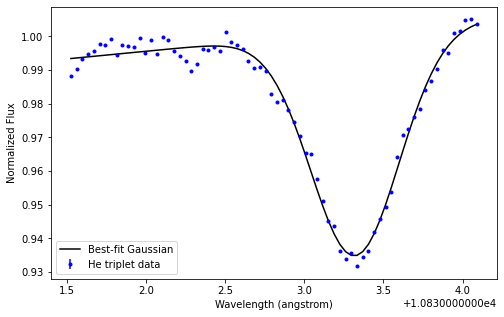

[-5.50900566e+01  6.76625907e-02  1.32577201e+00  2.74779440e-01
  5.08839673e-03  9.69359237e-01]


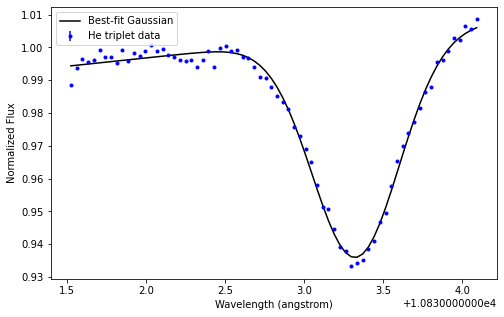

[-4.47854634e+01  6.51146971e-02  1.31748984e+00  2.78726834e-01
  4.13758269e-03  9.62170007e-01]


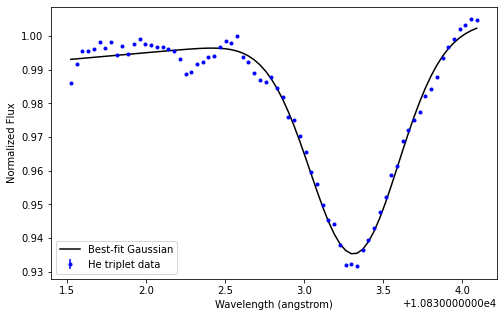

[-5.79879049e+01  6.76162049e-02  1.32157061e+00  2.89117865e-01
  5.35581787e-03  9.69073885e-01]


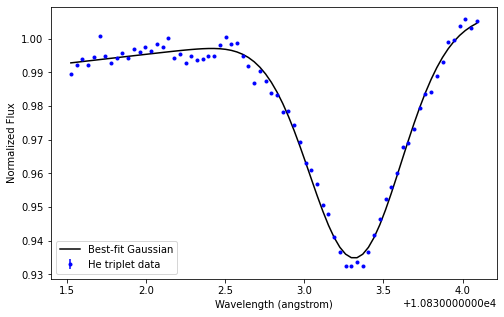

[-3.70951406e+01  6.53775076e-02  1.32043548e+00  2.70566365e-01
  3.42686033e-03  9.67066289e-01]


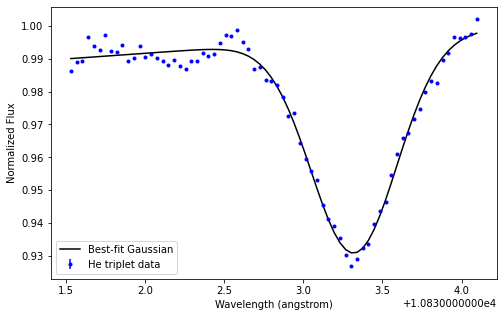

[-3.88736910e+01  6.45588941e-02  1.31999211e+00  2.73652438e-01
  3.59105655e-03  9.68769416e-01]


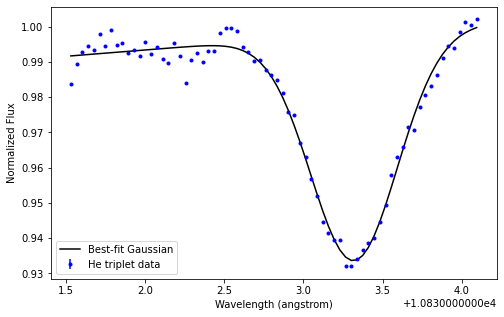

[-3.88548230e+01  6.47275710e-02  1.32190803e+00  2.68436719e-01
  3.58942571e-03  9.68594469e-01]


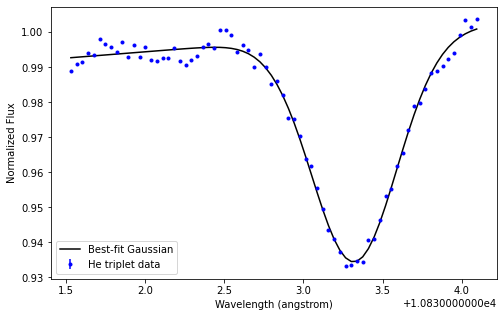

[-3.77198673e+01  6.42953691e-02  1.32339638e+00  2.68610146e-01
  3.48454750e-03  9.67534920e-01]


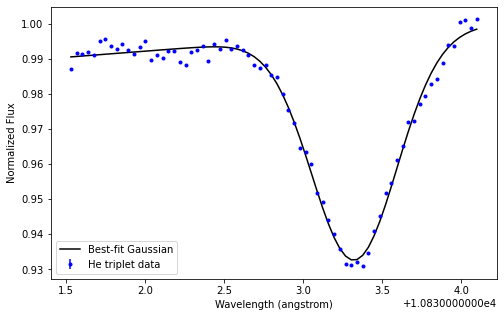

[-3.42480653e+01  6.65453432e-02  1.32425105e+00  2.55903945e-01
  3.16393093e-03  9.65908187e-01]


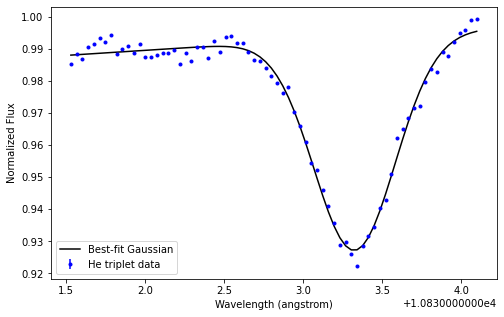

[-5.27739965e+01  6.70990296e-02  1.31510671e+00  2.75695498e-01
  4.87437482e-03  9.69471064e-01]


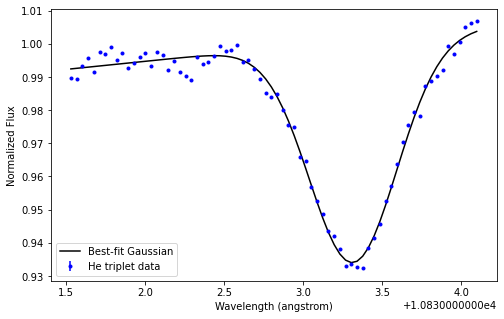

[-4.39909093e+01  6.64616444e-02  1.32318489e+00  2.83458379e-01
  4.06452870e-03  9.61637928e-01]


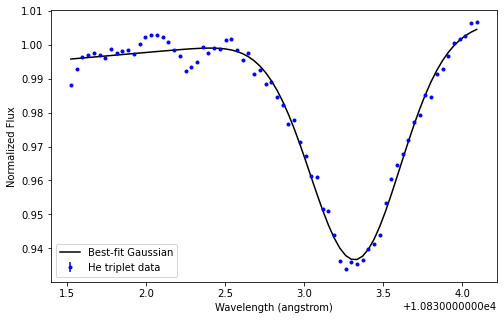

[-3.52317690e+01  6.42182225e-02  1.31834439e+00  2.72042323e-01
  3.25507556e-03  9.66670854e-01]


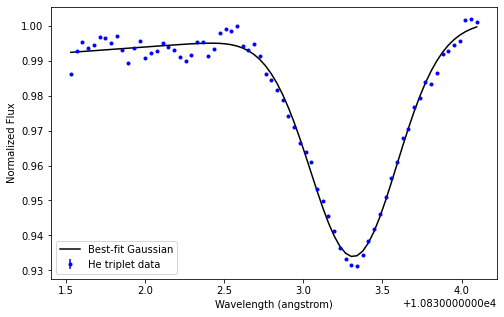

[-4.76175108e+01  6.42005492e-02  1.32835162e+00  2.71552340e-01
  4.39810115e-03  9.69392266e-01]


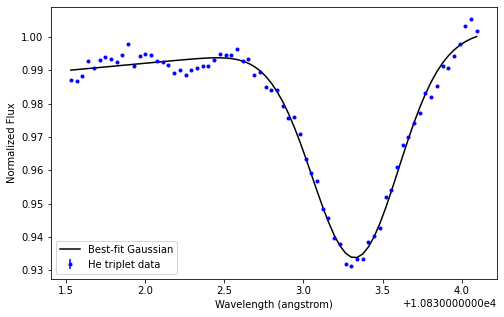

[-4.42542996e+01  6.57641963e-02  1.31786940e+00  2.68334112e-01
  4.08754193e-03  9.69696884e-01]


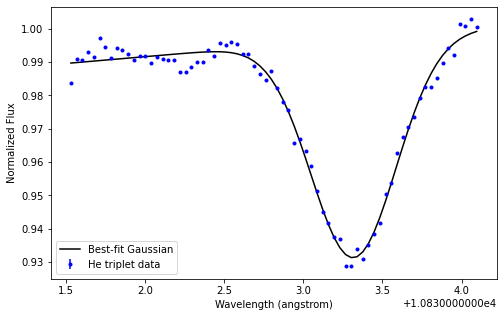

[-4.25529224e+01  6.49840823e-02  1.31226333e+00  2.70693184e-01
  3.93069444e-03  9.69404884e-01]


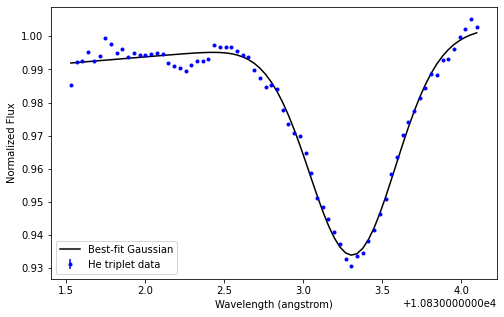

[-5.75807936e+01  6.67277439e-02  1.32043036e+00  2.82425997e-01
  5.31800244e-03  9.69054823e-01]


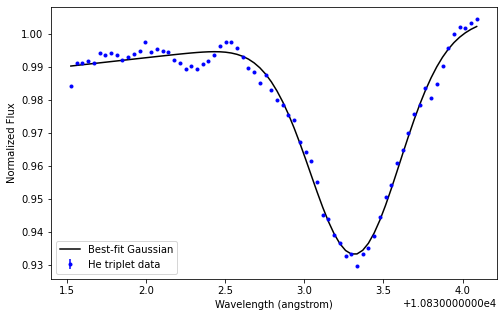

[-4.13205086e+01  6.54813355e-02  1.32032503e+00  2.82004563e-01
  3.81807093e-03  9.62426918e-01]


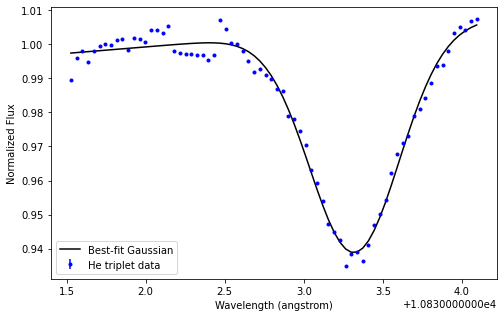

[-3.74880102e+01  6.44086603e-02  1.31911734e+00  2.72491098e-01
  3.46462130e-03  9.52919072e-01]


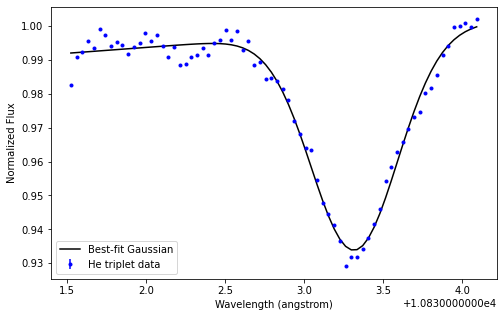

[-5.45819291e+01  6.67842911e-02  1.32195893e+00  2.86007611e-01
  5.04148766e-03  9.69519244e-01]


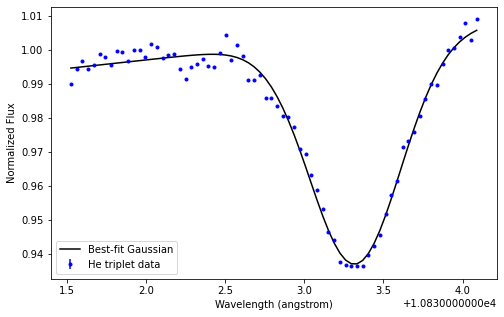

[-4.94099485e+01  6.64803025e-02  1.32267666e+00  2.80754775e-01
  4.56380057e-03  9.69330657e-01]


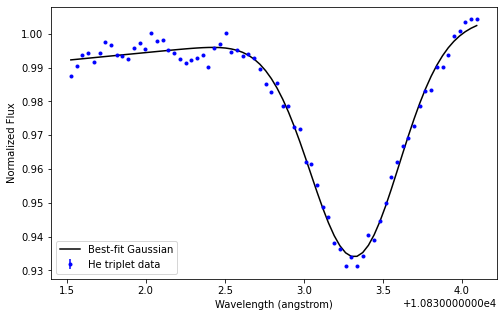

[-3.35498294e+01  6.54376878e-02  1.32203813e+00  2.70366479e-01
  3.09928726e-03  9.68334313e-01]


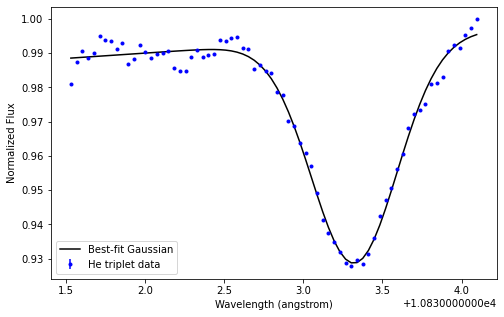

[-5.25743462e+01  6.68602988e-02  1.32841877e+00  2.72948568e-01
  4.85587890e-03  9.69352894e-01]


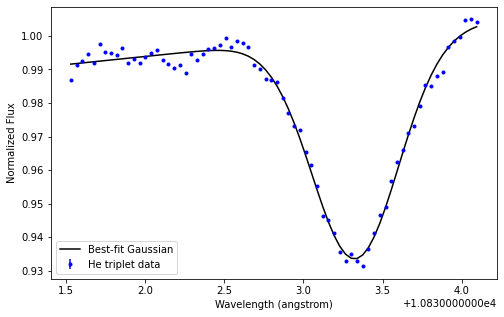

[-5.37566324e+01  6.67522833e-02  1.31932130e+00  2.83024237e-01
  4.96503538e-03  9.68618350e-01]


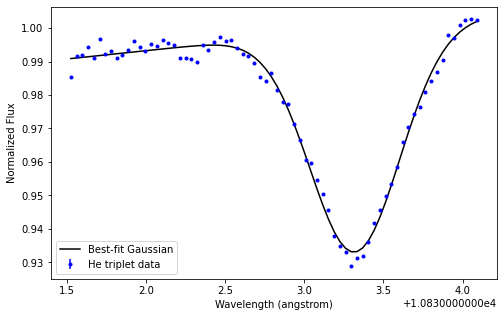

[-5.26068808e+01  6.62885838e-02  1.32059124e+00  2.80463560e-01
  4.85876984e-03  9.69441244e-01]


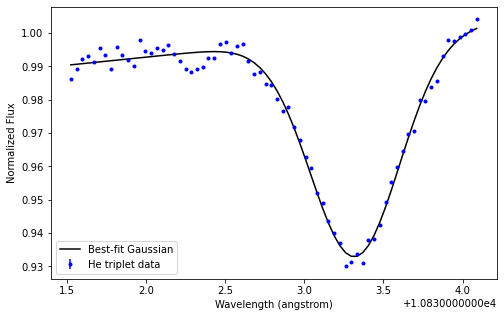

[-4.23887667e+01  6.62736611e-02  1.32391892e+00  2.66609943e-01
  3.91537541e-03  9.70490430e-01]


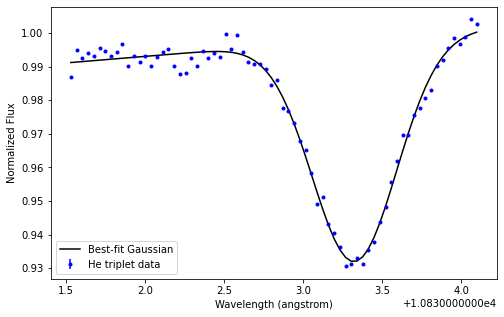

[-4.56324932e+01  6.63044290e-02  1.32591723e+00  2.78512957e-01
  4.21573289e-03  9.61140401e-01]


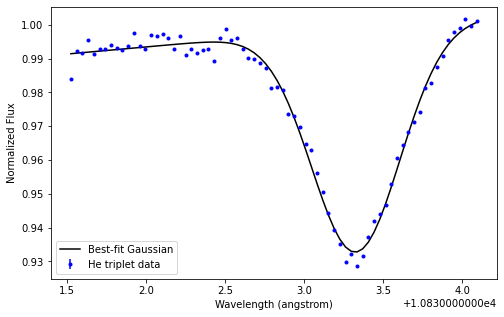

[-4.98577368e+01  6.62780198e-02  1.32389425e+00  2.79342164e-01
  4.60520544e-03  9.69414509e-01]


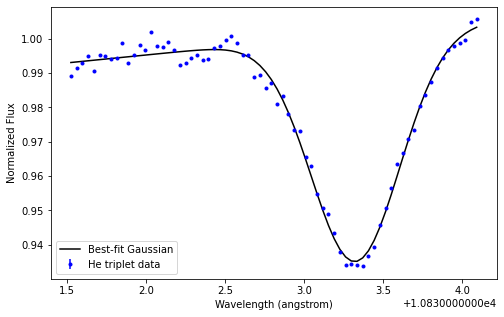

[-4.14223501e+01  6.56824534e-02  1.32015913e+00  2.80593648e-01
  3.82732656e-03  9.61919845e-01]


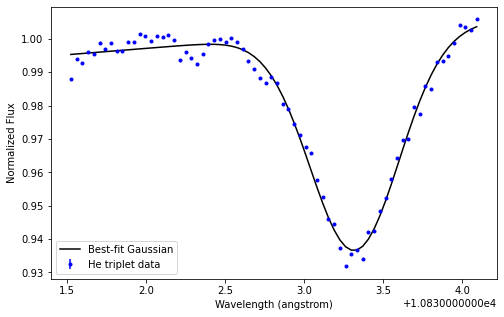

[-4.94399844e+01  6.71762013e-02  1.31911891e+00  2.85250402e-01
  4.56707121e-03  9.62219430e-01]


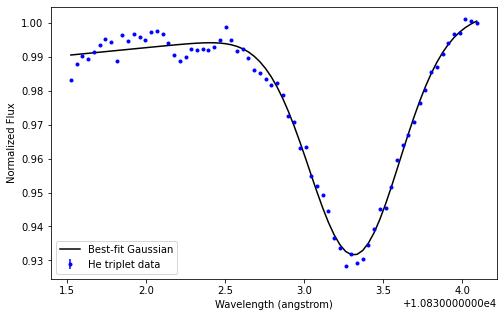

[-4.91412220e+01  6.44905368e-02  1.31485792e+00  2.78434711e-01
  4.53886843e-03  9.69789165e-01]


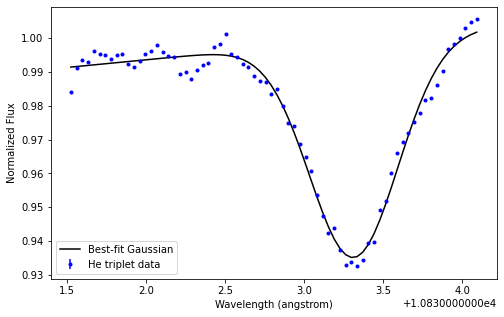

[-4.34180435e+01  6.42958159e-02  1.32181892e+00  2.76796401e-01
  4.01130036e-03  9.62116206e-01]


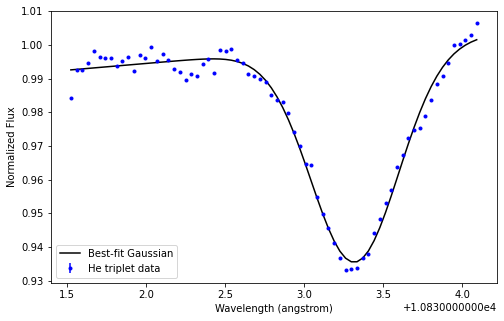

[-5.08798032e+01  6.59455583e-02  1.31279662e+00  2.72302591e-01
  4.69950244e-03  9.67432440e-01]


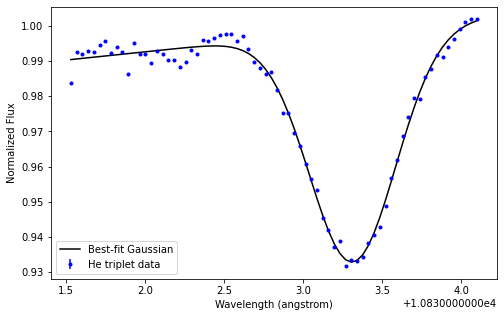

[-4.94224507e+01  6.59541347e-02  1.33184689e+00  2.72587676e-01
  4.56465215e-03  9.69261221e-01]


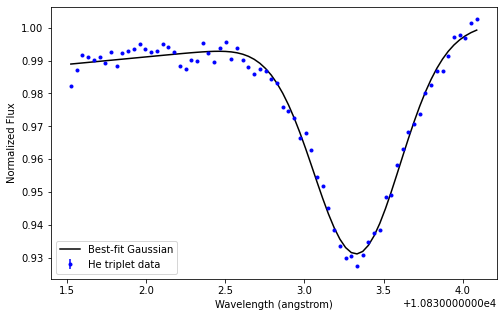

[-4.46195107e+01  6.54972786e-02  1.31622238e+00  2.78202655e-01
  4.12320189e-03  9.52702017e-01]


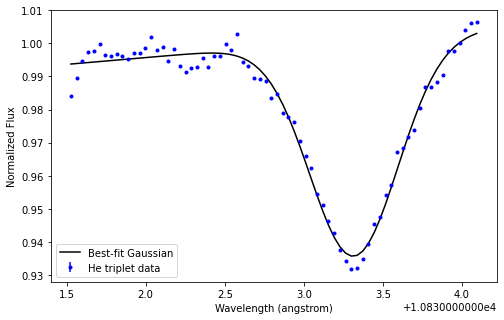

[-3.78015236e+01  6.63871222e-02  1.32115506e+00  2.61691172e-01
  3.49216831e-03  9.69471022e-01]


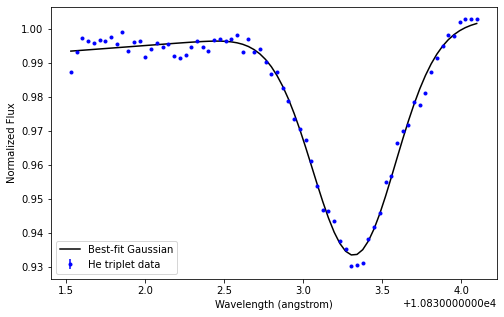

[-4.38386528e+01  6.34759962e-02  1.31755794e+00  2.80237194e-01
  4.05020154e-03  9.63207058e-01]


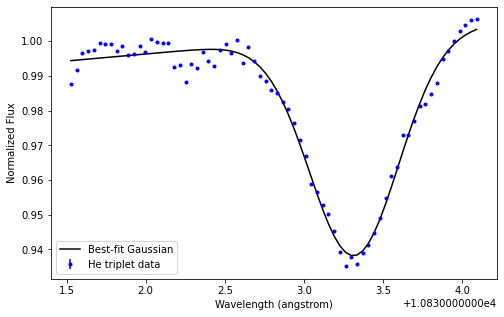

[-6.10516729e+01  6.80949909e-02  1.32798045e+00  2.89356563e-01
  5.63850648e-03  9.68468806e-01]


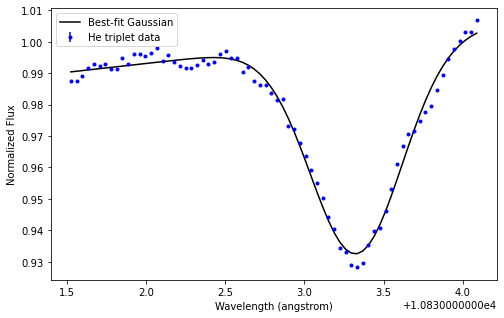

[-4.10605541e+01  6.59445921e-02  1.32314469e+00  2.67180422e-01
  3.79285682e-03  9.70335468e-01]


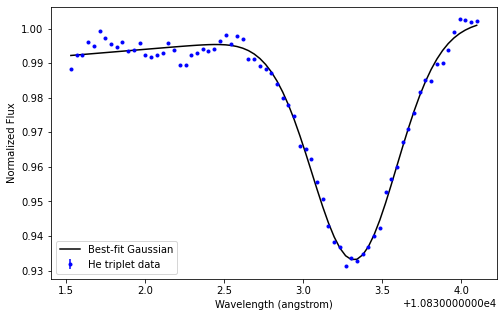

[-5.48380634e+01  6.81042882e-02  1.33166846e+00  2.82256727e-01
  5.06464741e-03  9.69367458e-01]


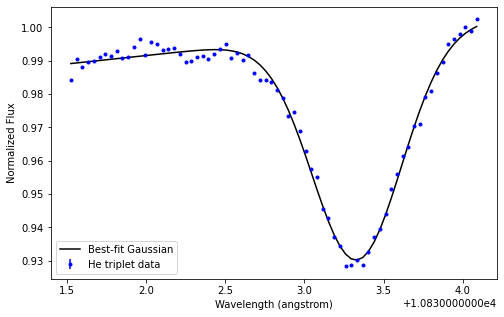

[-4.28052533e+01  6.59853595e-02  1.31778376e+00  2.77121008e-01
  3.95484230e-03  9.63223250e-01]


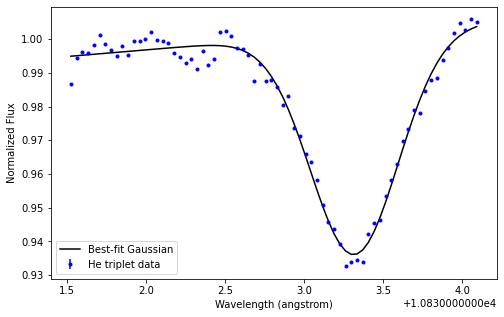

[-3.75036158e+01  6.57709329e-02  1.32394217e+00  2.57413238e-01
  3.46427676e-03  9.70083354e-01]


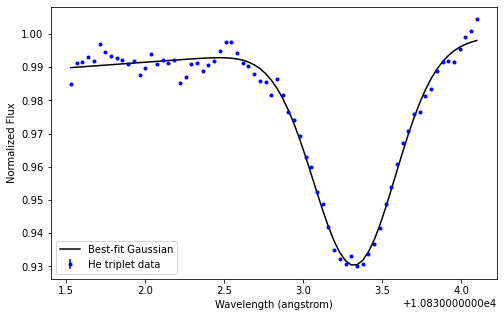

[-3.58132922e+01  6.62591758e-02  1.32389232e+00  2.59471348e-01
  3.30848138e-03  9.69955949e-01]


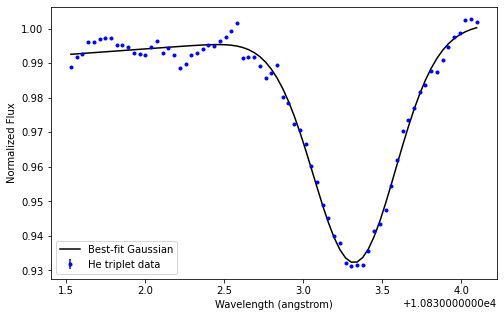

[-4.75656600e+01  6.56634122e-02  1.32432463e+00  2.82633350e-01
  4.39437557e-03  9.60468514e-01]


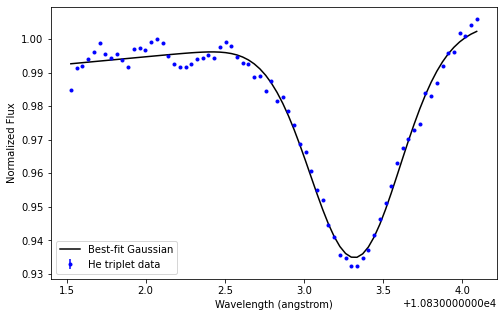

[-5.32116928e+01  6.55689896e-02  1.31611691e+00  2.80104266e-01
  4.91474985e-03  9.69874822e-01]


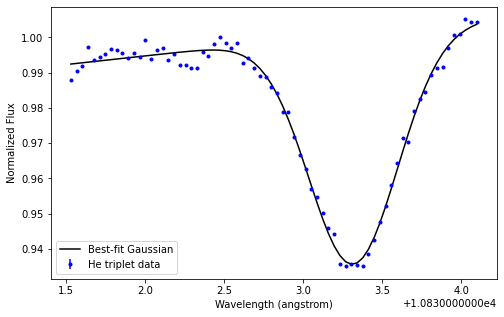

[-4.02978742e+01  6.60704299e-02  1.31281311e+00  2.64054114e-01
  3.72234397e-03  9.69957558e-01]


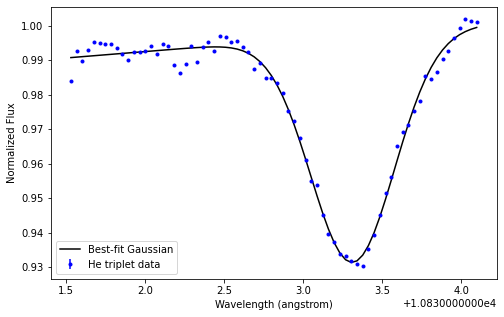

[-4.60806771e+01  6.47815491e-02  1.31356740e+00  2.73383286e-01
  4.25623137e-03  9.70101500e-01]


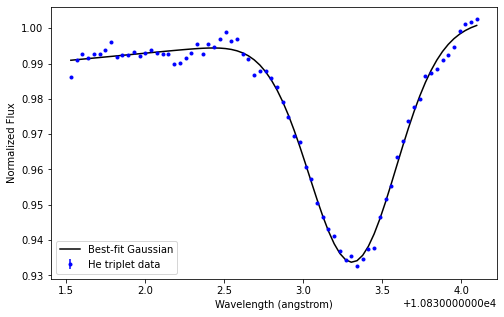

[-3.74606217e+01  6.56980780e-02  1.31865315e+00  2.66984214e-01
  3.46072734e-03  9.69215471e-01]


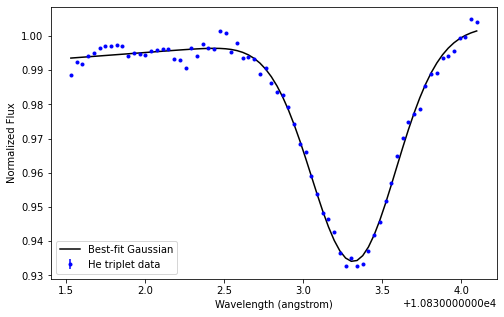

[-4.40082578e+01  6.47789858e-02  1.31861090e+00  2.78547444e-01
  4.06576727e-03  9.64607791e-01]


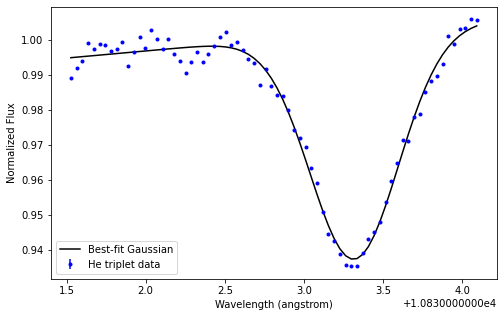

[-4.19516441e+01  6.54646901e-02  1.31603526e+00  2.76525704e-01
  3.87600958e-03  9.64445318e-01]


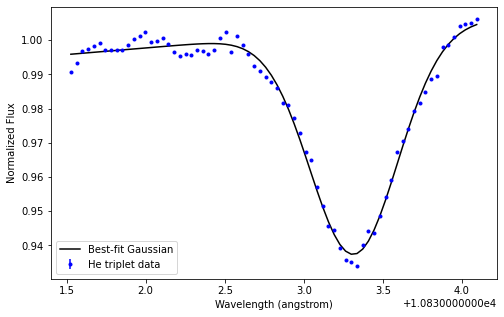

[-5.20231668e+01  6.61222764e-02  1.32791033e+00  2.86926827e-01
  4.80629904e-03  9.58999323e-01]


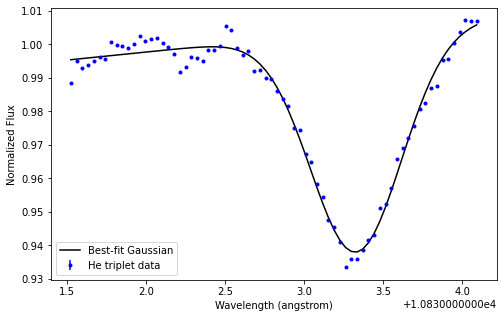

[-3.88874249e+01  6.37456891e-02  1.31630270e+00  2.76344471e-01
  3.59372478e-03  9.53535893e-01]


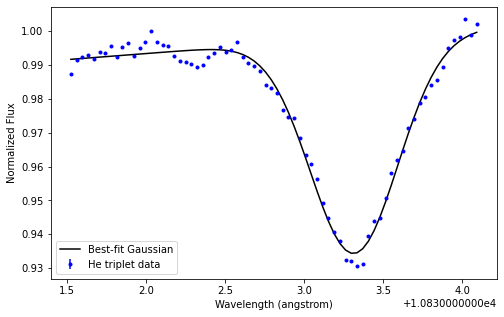

[-3.37806857e+01  6.51374809e-02  1.32261267e+00  2.67840414e-01
  3.12090831e-03  9.68717960e-01]


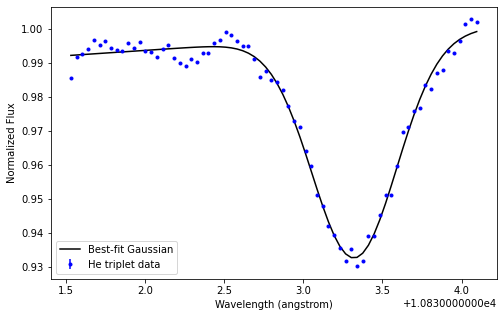

[-4.37177909e+01  6.46798261e-02  1.31853327e+00  2.81874951e-01
  4.03863082e-03  9.62791383e-01]


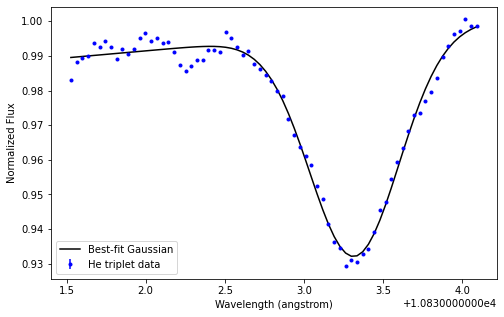

[-5.26095258e+01  6.74052644e-02  1.32720583e+00  2.80232710e-01
  4.85897294e-03  9.69356655e-01]


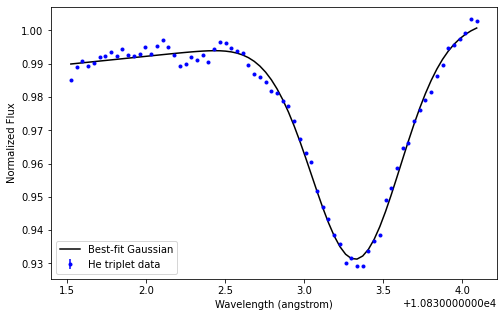

[-4.82075079e+01  6.64931196e-02  1.31896249e+00  2.76150492e-01
  4.45257282e-03  9.69471423e-01]


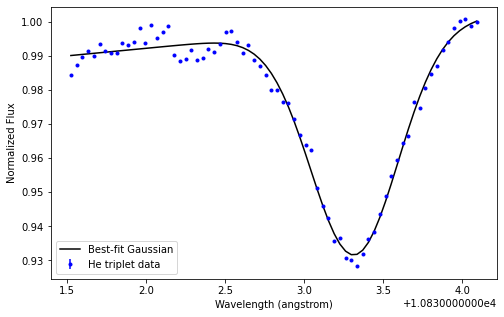

[-5.30207867e+01  6.66924867e-02  1.33166010e+00  2.72162504e-01
  4.89683982e-03  9.69338902e-01]


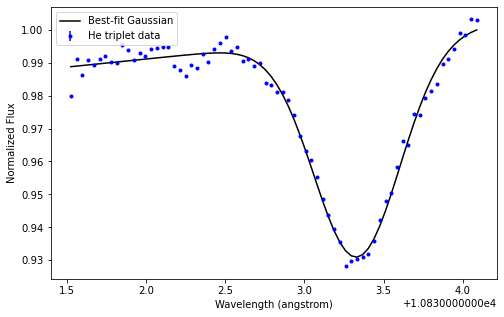

[-4.44166285e+01  6.59333381e-02  1.32392343e+00  2.88482819e-01
  4.10378320e-03  9.61729117e-01]


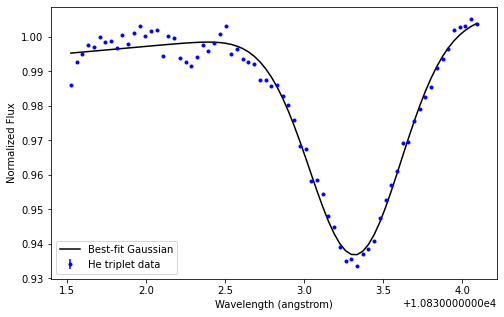

[-3.70270148e+01  6.57300293e-02  1.32450447e+00  2.61477444e-01
  3.42036011e-03  9.69154334e-01]


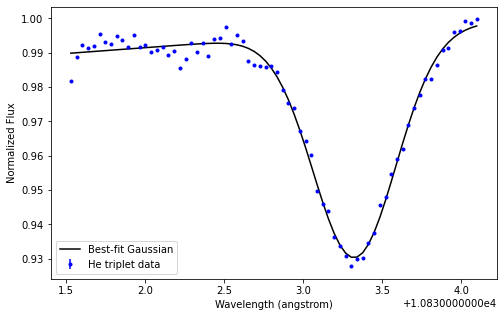

[-4.35201823e+01  6.69047679e-02  1.31859462e+00  2.68516801e-01
  4.02031701e-03  9.69915519e-01]


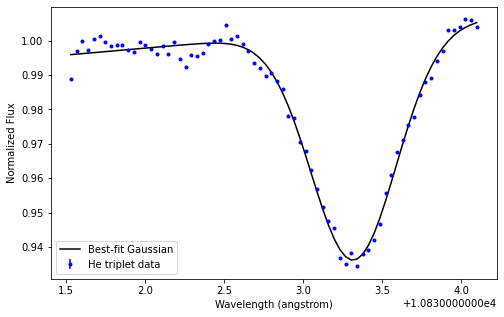

[-4.55343472e+01  6.59685566e-02  1.32458163e+00  2.63943879e-01
  4.20592522e-03  9.69650419e-01]


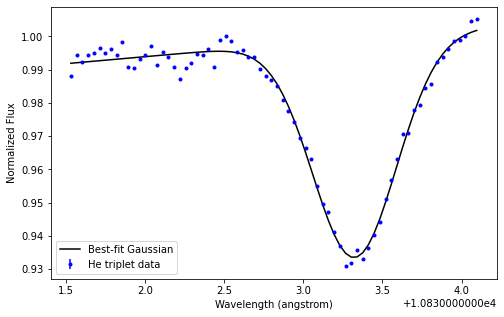

[-4.34050000e+01  6.64013181e-02  1.31703196e+00  2.80298604e-01
  4.01013586e-03  9.64250519e-01]


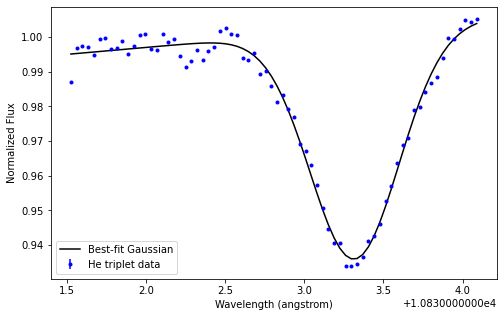

[-3.46018024e+01  6.51628617e-02  1.30925970e+00  2.62513093e-01
  3.19651921e-03  9.69958249e-01]


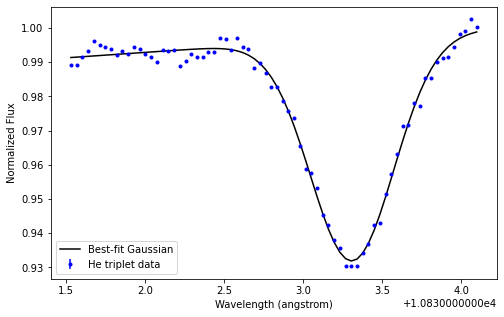

[-3.28416728e+01  6.42219191e-02  1.32146067e+00  2.63970963e-01
  3.03403887e-03  9.69657414e-01]


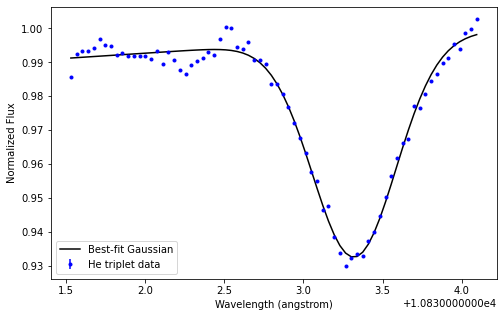

[-5.97662239e+01  6.74156863e-02  1.32464432e+00  2.79347765e-01
  5.51989883e-03  9.69010573e-01]


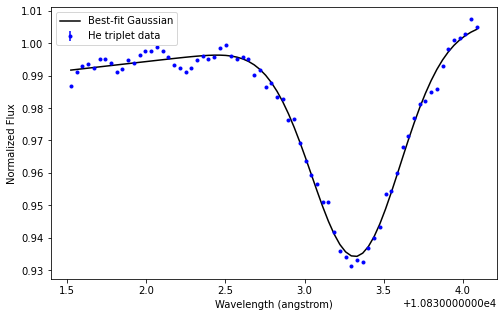

[-4.49917068e+01  6.54230545e-02  1.32088674e+00  2.68588391e-01
  4.15573997e-03  9.69906572e-01]


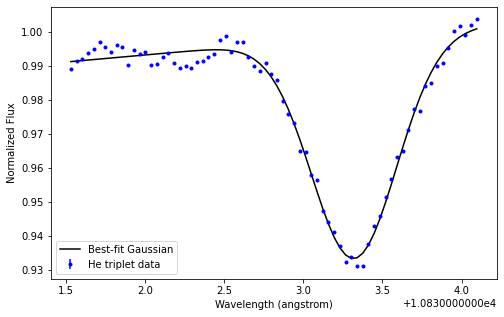

[-5.07446710e+01  6.61056960e-02  1.32466172e+00  2.82258153e-01
  4.68798675e-03  9.60392853e-01]


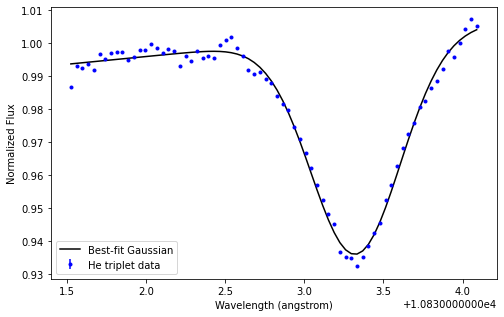

[-4.24599532e+01  6.57563963e-02  1.31876610e+00  2.66946111e-01
  3.92236292e-03  9.64318608e-01]


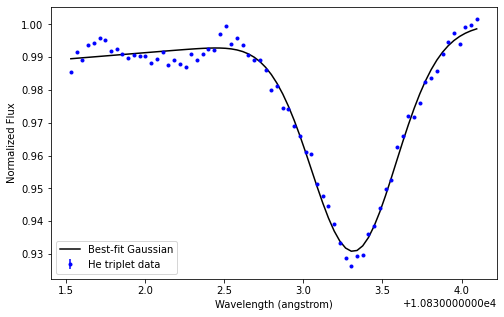

[-4.81961135e+01  6.51282711e-02  1.32233529e+00  2.87005020e-01
  4.45269618e-03  9.60776821e-01]


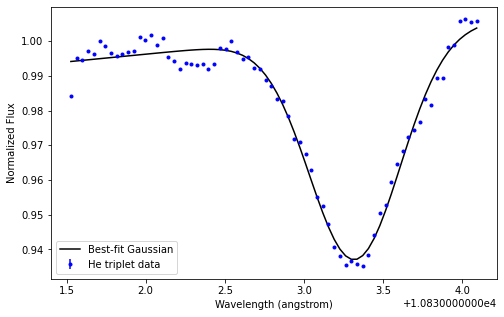

[-6.96218943e+01  6.85003484e-02  1.33587553e+00  2.88199020e-01
  6.42980678e-03  9.66838592e-01]


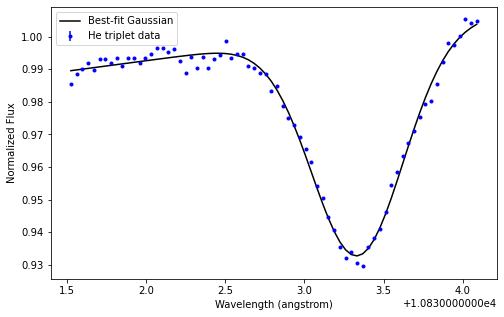

[-3.03530000e+01  6.59426615e-02  1.32002392e+00  2.66285526e-01
  2.80476866e-03  9.68417745e-01]


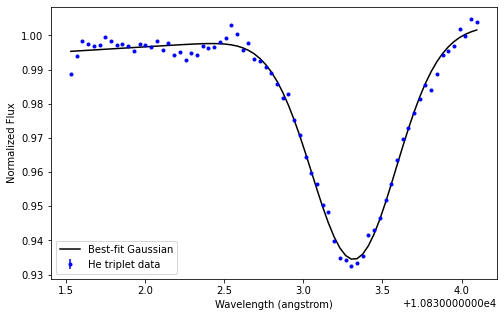

[-4.79100407e+01  6.66256929e-02  1.32130791e+00  2.84376218e-01
  4.42621979e-03  9.61467117e-01]


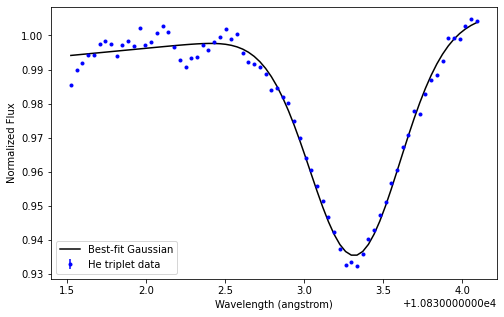

[-4.56976423e+01  6.42471055e-02  1.32194954e+00  2.77183101e-01
  4.22201900e-03  9.61515185e-01]


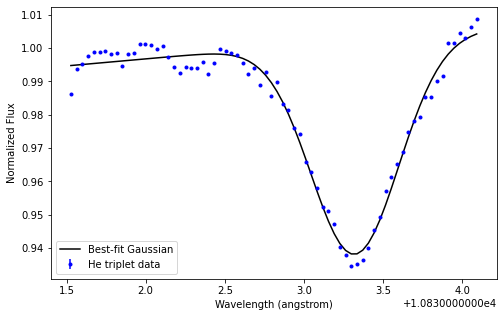

[-4.66644958e+01  6.65163234e-02  1.32613009e+00  2.66720461e-01
  4.31032807e-03  9.69590873e-01]


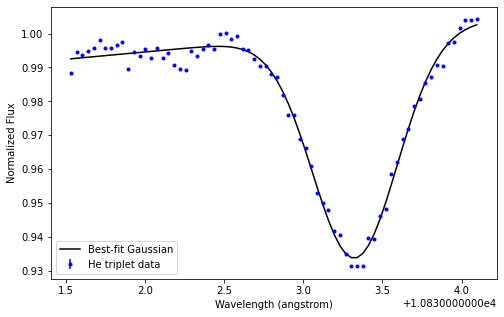

[-5.24732469e+01  6.68414161e-02  1.32387532e+00  2.75759652e-01
  4.84625927e-03  9.69441296e-01]


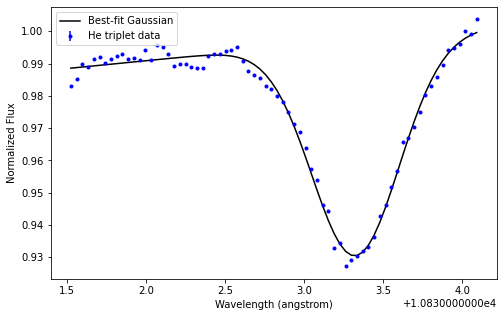

[-3.28727627e+01  6.56855861e-02  1.32220914e+00  2.61806075e-01
  3.03687230e-03  9.69494816e-01]


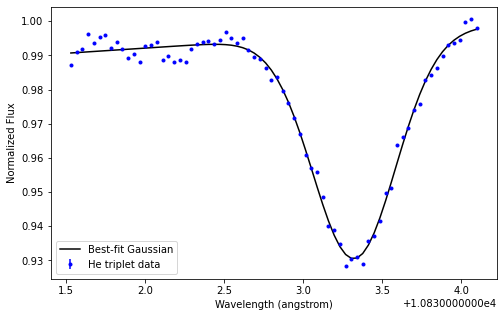

[-4.66237513e+01  6.60370626e-02  1.31343420e+00  2.69260265e-01
  4.30639415e-03  9.69661284e-01]


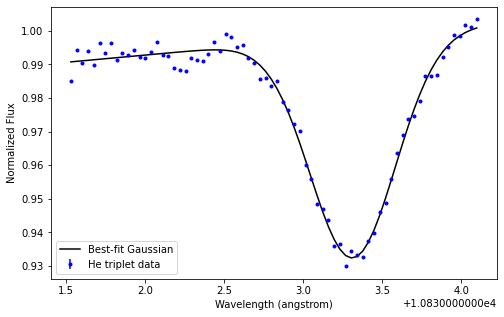

[-4.65936854e+01  6.64222657e-02  1.32409032e+00  2.71505605e-01
  4.30375449e-03  9.69638127e-01]


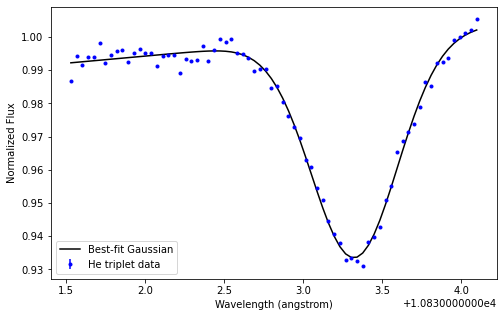

[-4.79854018e+01  6.65586946e-02  1.32432534e+00  2.72894001e-01
  4.43215878e-03  9.70681387e-01]


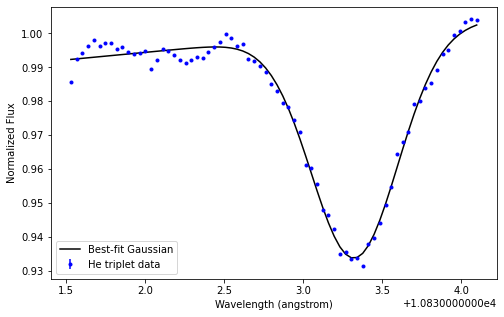

[-4.50060796e+01  6.58246218e-02  1.31145522e+00  2.73311793e-01
  4.15708443e-03  9.69923477e-01]


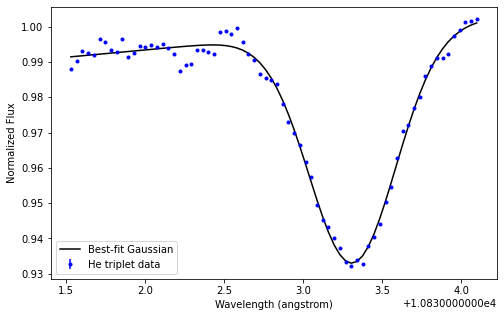

[-3.63831657e+01  6.51424760e-02  1.31666933e+00  2.64042365e-01
  3.36083211e-03  9.70166572e-01]


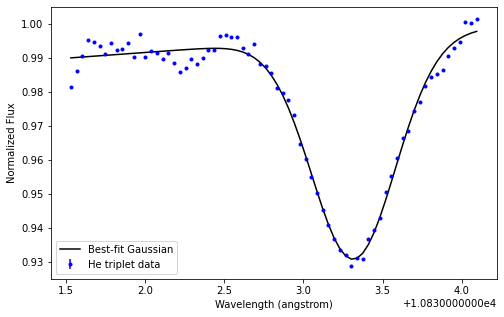

[-3.88344125e+01  6.62953424e-02  1.31561162e+00  2.76431622e-01
  3.58757891e-03  9.64926346e-01]


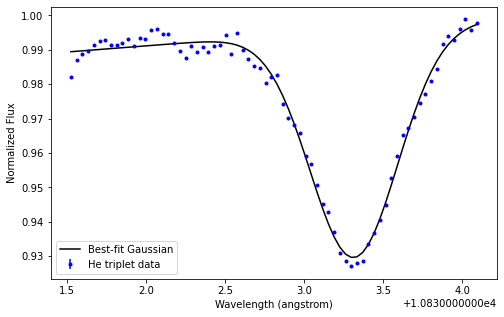

[-4.25714393e+01  6.47288752e-02  1.32082014e+00  2.78925972e-01
  3.93284391e-03  9.64025353e-01]


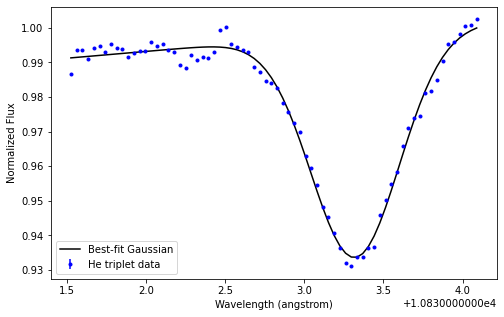

[-5.02605863e+01  6.68134447e-02  1.32250566e+00  2.85570442e-01
  4.64298353e-03  9.61727981e-01]


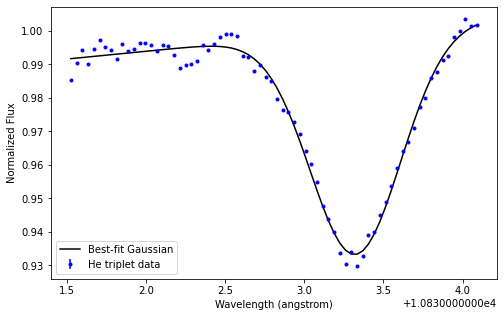

[-5.39585898e+01  6.63862450e-02  1.31703564e+00  2.80145510e-01
  4.98345577e-03  9.73467588e-01]


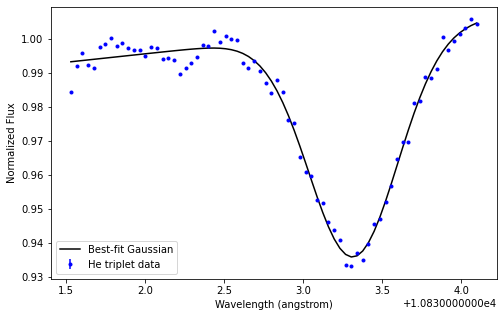

[-3.33272719e+01  6.40881645e-02  1.32141615e+00  2.68847630e-01
  3.07941824e-03  9.66996938e-01]


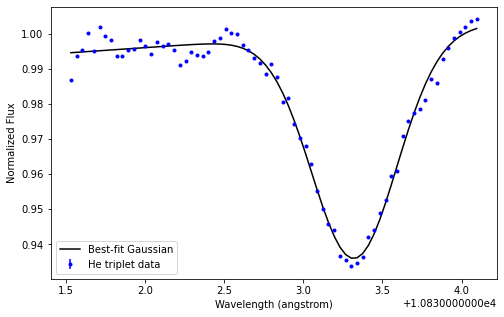

[-6.31544922e+01  6.88469856e-02  1.32361209e+00  2.79372258e-01
  5.83375735e-03  9.57989906e-01]


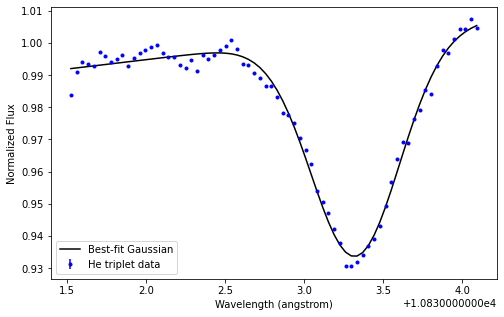

[-3.15731592e+01  6.55513928e-02  1.32042835e+00  2.64072844e-01
  2.91750945e-03  9.68142639e-01]


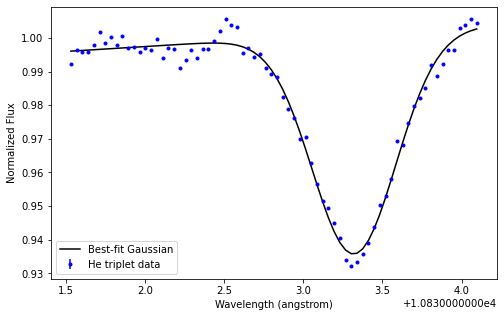

[-3.03042417e+01  6.56535964e-02  1.31666323e+00  2.52807037e-01
  2.79987887e-03  9.69777663e-01]


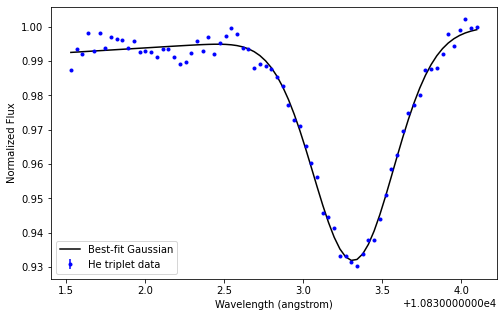

[-4.07210370e+01  6.56345714e-02  1.31924009e+00  2.69109141e-01
  3.76167883e-03  9.67166996e-01]


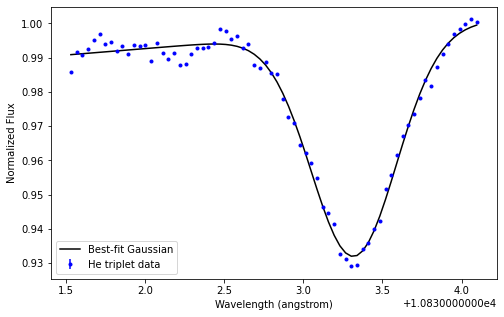

[-4.98663259e+01  6.54420471e-02  1.32315441e+00  2.85263237e-01
  4.60678605e-03  9.61909774e-01]


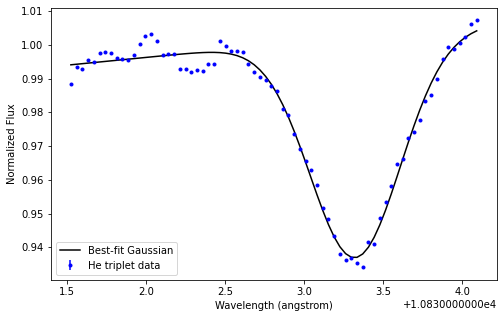

[-4.08898976e+01  6.62507504e-02  1.32011143e+00  2.73041132e-01
  3.77747783e-03  9.65220693e-01]


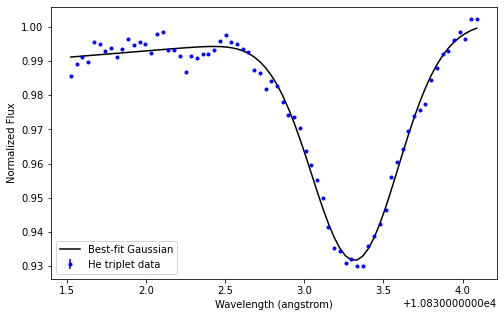

[-4.26937677e+01  6.54768303e-02  1.32248423e+00  2.75582653e-01
  3.94479816e-03  9.62770530e-01]


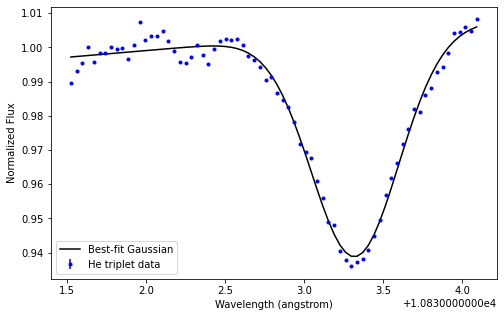

[-4.67707541e+01  6.56453507e-02  1.32309870e+00  2.77834703e-01
  4.31963860e-03  9.69741188e-01]


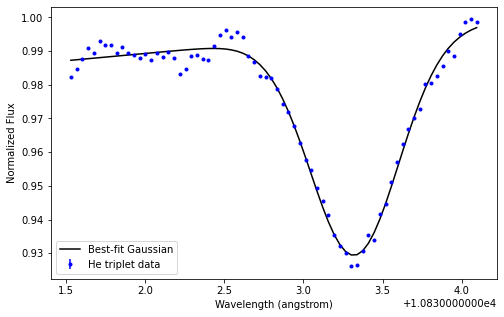

[-4.31980714e+01  6.54227409e-02  1.32252197e+00  2.82297781e-01
  3.99135170e-03  9.61988254e-01]


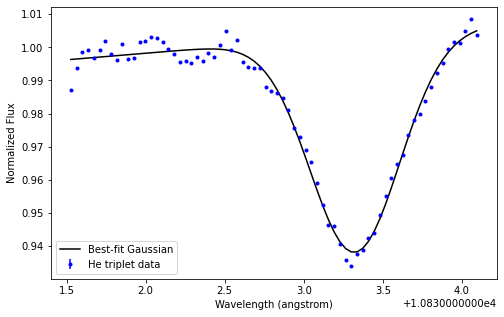

[-5.36223297e+01  6.51075582e-02  1.32384651e+00  2.84011574e-01
  4.95259329e-03  9.69249623e-01]


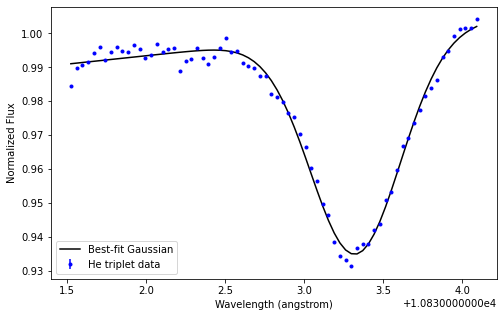

[-4.42799803e+01  6.60382156e-02  1.32470298e+00  2.78295122e-01
  4.09099442e-03  9.62085866e-01]


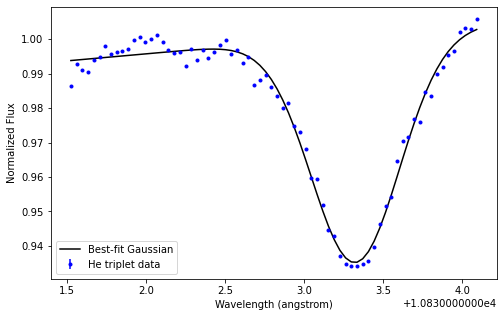

[-6.55290259e+01  6.74448650e-02  1.33682950e+00  2.84786744e-01
  6.05182393e-03  9.68828004e-01]


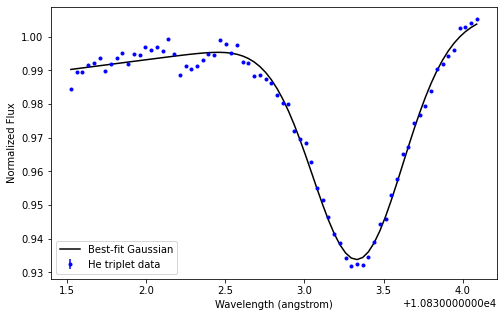

[-4.27056766e+01  6.44892297e-02  1.32601259e+00  2.72902699e-01
  3.94518279e-03  9.64135574e-01]


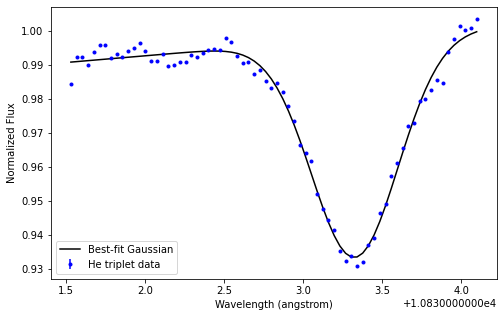

[-6.00743364e+01  6.80338544e-02  1.33139026e+00  2.90899125e-01
  5.54838603e-03  9.68873730e-01]


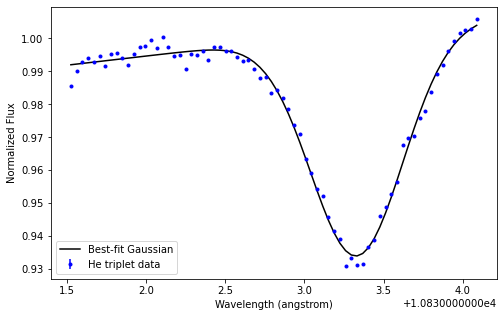

[-4.15794652e+01  6.45796954e-02  1.32123158e+00  2.79794324e-01
  3.84170600e-03  9.61371195e-01]


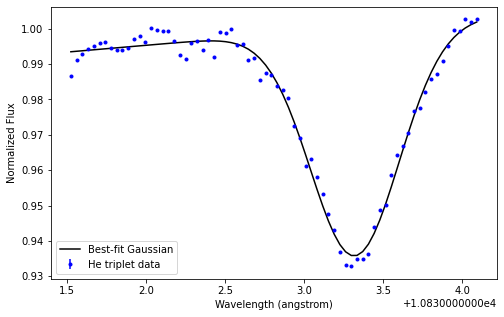

[-4.56990165e+01  6.64238618e-02  1.31960966e+00  2.86433322e-01
  4.22209735e-03  9.61319553e-01]


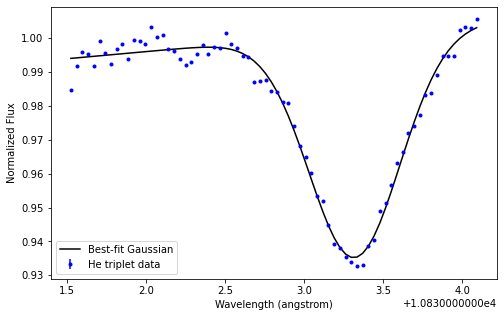

[-5.04248683e+01  6.67024212e-02  1.32120534e+00  2.84677588e-01
  4.65834858e-03  9.61223682e-01]


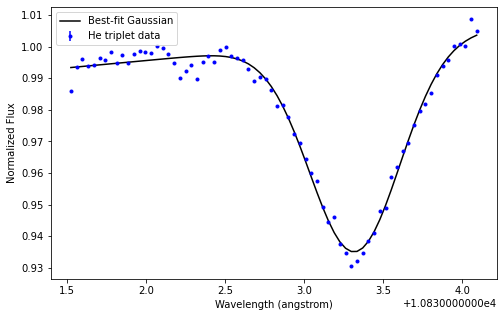

[-3.84786064e+01  6.55836574e-02  1.31542016e+00  2.66537377e-01
  3.55502832e-03  9.67500955e-01]


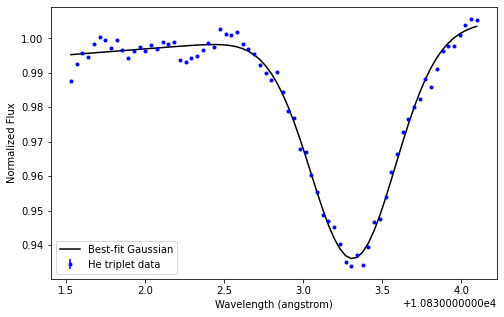

[-4.20719654e+01  6.55713612e-02  1.31808648e+00  2.77163995e-01
  3.88708916e-03  9.63490888e-01]


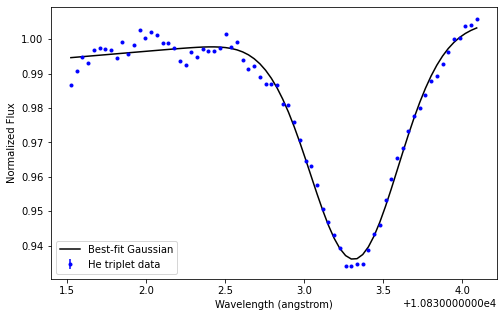

[-4.54639696e+01  6.67867567e-02  1.31940220e+00  2.78365849e-01
  4.20008353e-03  9.63934732e-01]


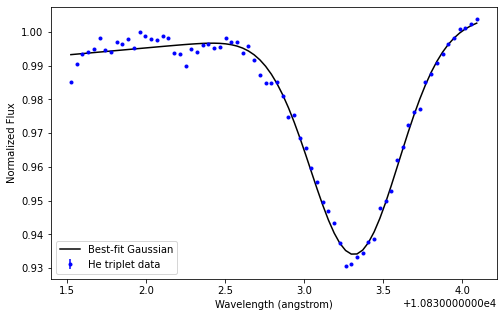

[-4.98186828e+01  6.65034643e-02  1.32573944e+00  2.79338128e-01
  4.60137330e-03  9.69400284e-01]


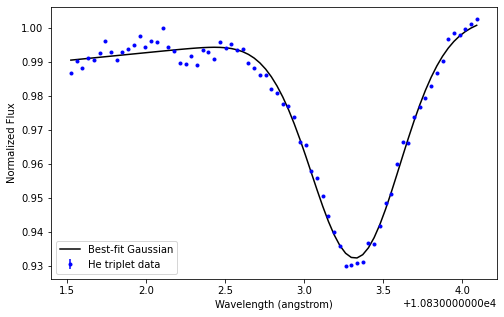

In [26]:
lower_lim = 10831.5
upper_lim = 10834.1
ref_lamda = 10832
guess_params = [1, 0.05, 1.3, 0.1, 0.008, 0.97]
bounds_param = ((-np.inf, -np.inf, 1.2, -np.inf, -np.inf, 0.95),(1, np.inf, 1.4, np.inf, np.inf, 0.99)) 

def gaussian_L(x, offset, A, mu, std, lin, ref):
    x_g, x_l = x
    return offset-(A * np.exp(-0.5*((x_g-mu)/std)**2)) + (lin*x_l+ref)
    
thetas_HA = np.ones((len(total_spctr_HA), 6))
thetas_HE = np.ones((len(total_spctr_HE), 6))

err_HA = np.ones((len(total_spctr_HA), 6))
err_HE = np.ones((len(total_spctr_HE), 6))

for i in range(len(total_spctr_HA)):
    
    temp_1 = total_lamda_HA[i][lower_lim<total_lamda_HA[i]]
    temp_2 = total_spctr_HA[i][lower_lim<total_lamda_HA[i]]
    temp_3 = total_err_HA[i][lower_lim<total_lamda_HA[i]]
    focus_lamda = temp_1[temp_1 < upper_lim]
    focus_spctr = temp_2[temp_1 < upper_lim]
    focus_err = temp_3[temp_1 < upper_lim]
    
    params, cov = curve_fit(gaussian_L, (focus_lamda-ref_lamda, focus_lamda), focus_spctr/np.mean(total_spctr_HA[i]),
                            sigma=focus_err/np.mean(total_spctr_HA[i]), p0 = guess_params, bounds = bounds_param)
    thetas_HA[i] = params
    err_HA[i] = np.sqrt(np.diag(cov))
    model = gaussian_L((focus_lamda, focus_lamda), thetas_HA[i][0], thetas_HA[i][1], thetas_HA[i][2]+ref_lamda, thetas_HA[i][3], thetas_HA[i][4], thetas_HA[i][5])
    
    plt.figure(figsize=[8, 5])
    plt.errorbar(focus_lamda, focus_spctr/np.mean(total_spctr_HA[i]), yerr=focus_err/np.mean(total_spctr_HA[i]),  fmt='b.', label='He triplet data')
    plt.plot(focus_lamda, model, 'r', label='Best-fit Gaussian')
    plt.xlabel('Wavelength (angstrom)')
    plt.ylabel('Normalized Flux')
    plt.legend()
    print(thetas_HA[i])
    plt.show()
    
for i in range(len(total_spctr_HE)):
    
    temp_1 = total_lamda_HE[i][lower_lim<total_lamda_HE[i]]
    temp_2 = total_spctr_HE[i][lower_lim<total_lamda_HE[i]]
    temp_3 = total_err_HE[i][lower_lim<total_lamda_HE[i]]
    focus_lamda = temp_1[temp_1 < upper_lim]
    focus_spctr = temp_2[temp_1 < upper_lim]
    focus_err = temp_3[temp_1 < upper_lim]
    
    params, cov = curve_fit(gaussian_L, (focus_lamda-ref_lamda, focus_lamda), focus_spctr/np.mean(total_spctr_HE[i]),
                            sigma=focus_err/np.mean(total_spctr_HE[i]), p0 = guess_params, bounds = bounds_param)
    thetas_HE[i] = params
    err_HE[i] = np.sqrt(np.diag(cov))
    model = gaussian_L((focus_lamda, focus_lamda), thetas_HE[i][0], thetas_HE[i][1], thetas_HE[i][2]+ref_lamda, thetas_HE[i][3], thetas_HE[i][4], thetas_HE[i][5])
    
    plt.figure(figsize=[8, 5])
    plt.errorbar(focus_lamda, focus_spctr/np.mean(total_spctr_HE[i]), yerr=focus_err/np.mean(total_spctr_HE[i]), fmt='b.', label='He triplet data')
    plt.plot(focus_lamda, model, 'k', label='Best-fit Gaussian')
    plt.xlabel('Wavelength (angstrom)')
    plt.ylabel('Normalized Flux')
    plt.legend()
    print(thetas_HE[i])
    plt.show()

## Plotting the positions, depths and widths of the fitted Gaussian lines

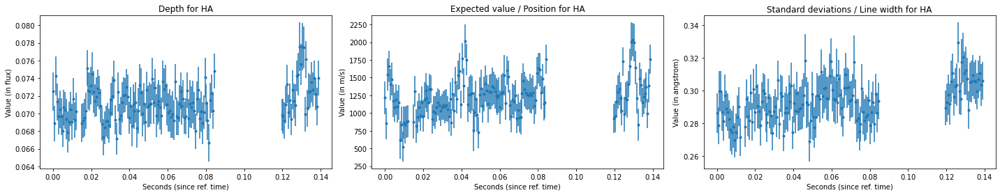

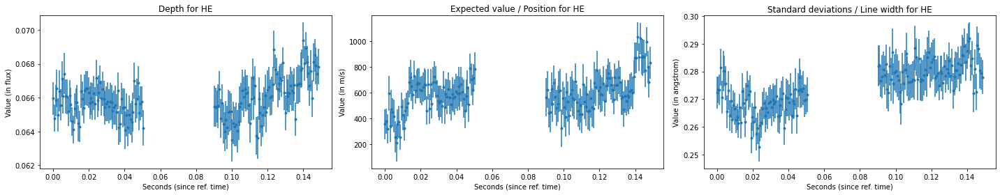

In [27]:
fig, (ax1, ax2, ax3) = plt.subplots (1, 3, figsize=[20, 4])

ref_He = 10833.3

ax1.errorbar(date_HA-min(date_HA), thetas_HA[:, 1], yerr=err_HA[:, 1], fmt='.')
ax2.errorbar(date_HA-min(date_HA), (thetas_HA[:, 2]+ref_lamda-ref_He)*3e8/ref_He, yerr=err_HA[:, 2]*3e8/ref_He, fmt='.')
ax3.errorbar(date_HA-min(date_HA), np.abs(thetas_HA[:, 3]), yerr=err_HA[:, 3], fmt='.')
ax1.set_xlabel('Seconds (since ref. time)')
ax2.set_xlabel('Seconds (since ref. time)')
ax3.set_xlabel('Seconds (since ref. time)')
ax2.set_ylabel('Value (in m/s)')
ax3.set_ylabel('Value (in angstrom)')
ax1.set_ylabel('Value (in flux)')
ax1.set_title('Depth for HA')
ax2.set_title('Expected value / Position for HA')
ax3.set_title('Standard deviations / Line width for HA')

fig.tight_layout()

fig, (ax4, ax5, ax6) = plt.subplots (1, 3, figsize=[20, 4])

ax4.errorbar(date_HE-min(date_HE), thetas_HE[:, 1], yerr=err_HE[:, 1], fmt='.')
ax5.errorbar(date_HE-min(date_HE), (thetas_HE[:, 2]+ref_lamda-ref_He)*3e8/ref_He, yerr=err_HE[:, 2]*3e8/ref_He, fmt='.')
ax6.errorbar(date_HE-min(date_HE), np.abs(thetas_HE[:, 3]), yerr=err_HE[:, 3], fmt='.')
ax4.set_xlabel('Seconds (since ref. time)')
ax5.set_xlabel('Seconds (since ref. time)')
ax6.set_xlabel('Seconds (since ref. time)')
ax5.set_ylabel('Value (in m/s)')
ax6.set_ylabel('Value (in angstrom)')
ax4.set_ylabel('Value (in flux)')
ax4.set_title('Depth for HE')
ax5.set_title('Expected value / Position for HE')
ax6.set_title('Standard deviations / Line width for HE')

fig.tight_layout()

## Periodogram for the position, depth and width of the He line

In [28]:
oscillation_freq = 24*60/5.4 #in 1/days!!

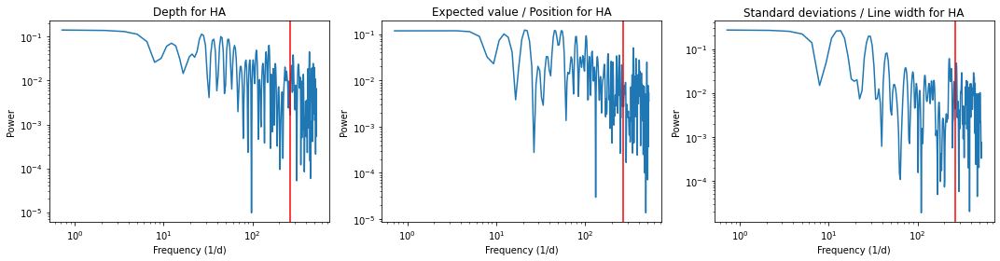

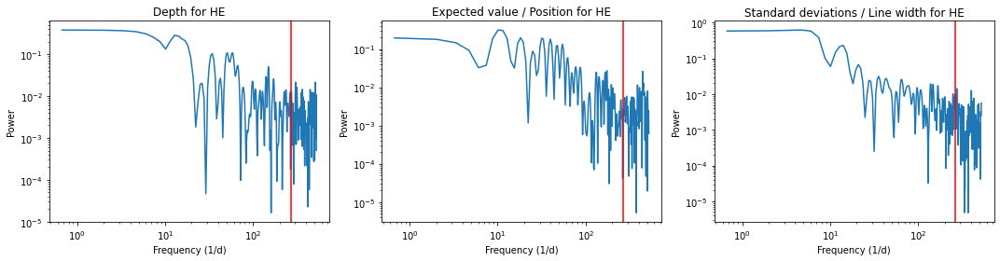

In [29]:
fig, (ax1, ax2, ax3) = plt.subplots (1, 3, figsize=[15, 4])

LS_depth_HA = LombScargle(date_HA-min(date_HA), thetas_HA[:, 1]).autopower(nyquist_factor=1)
LS_position_HA = LombScargle(date_HA-min(date_HA), thetas_HA[:, 2]).autopower(nyquist_factor=1)
LS_width_HA = LombScargle(date_HA-min(date_HA), thetas_HA[:, 3]).autopower(nyquist_factor=1)

ax1.loglog(LS_depth_HA[0], LS_depth_HA[1])
ax2.loglog(LS_position_HA[0], LS_position_HA[1])
ax3.loglog(LS_width_HA[0], LS_width_HA[1])
ax1.set_xlabel('Frequency (1/d)')
ax2.set_xlabel('Frequency (1/d)')
ax3.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax3.set_ylabel('Power')
ax1.set_ylabel('Power')
ax1.set_title('Depth for HA')
ax2.set_title('Expected value / Position for HA')
ax3.set_title('Standard deviations / Line width for HA')
ax1.axvline(oscillation_freq, color='r')
ax2.axvline(oscillation_freq, color='r')
ax3.axvline(oscillation_freq, color='r')
fig.tight_layout()
plt.show()

fig, (ax4, ax5, ax6) = plt.subplots (1, 3, figsize=[15, 4])

LS_depth_HE = LombScargle(date_HE-min(date_HE), thetas_HE[:, 1]).autopower(nyquist_factor=1)
LS_position_HE = LombScargle(date_HE-min(date_HE), thetas_HE[:, 2]).autopower(nyquist_factor=1)
LS_width_HE = LombScargle(date_HE-min(date_HE), thetas_HE[:, 3]).autopower(nyquist_factor=1)

ax4.loglog(LS_depth_HE[0], LS_depth_HE[1])
ax5.loglog(LS_position_HE[0], LS_position_HE[1])
ax6.loglog(LS_width_HE[0], LS_width_HE[1])
ax4.set_xlabel('Frequency (1/d)')
ax5.set_xlabel('Frequency (1/d)')
ax6.set_xlabel('Frequency (1/d)')
ax5.set_ylabel('Power')
ax6.set_ylabel('Power')
ax4.set_ylabel('Power')
ax4.set_title('Depth for HE')
ax5.set_title('Expected value / Position for HE')
ax6.set_title('Standard deviations / Line width for HE')
ax4.axvline(oscillation_freq, color='r')
ax5.axvline(oscillation_freq, color='r')
ax6.axvline(oscillation_freq, color='r')
fig.tight_layout()
plt.show()

In [30]:
'''def plot_TS_Periodo(list_HA, list_HE, time_HA, time_HE, title1, title2):
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

    ax1.plot(time_HA, list_HA, '.')
    ax1.set_xlabel('Time (MJD)')
    ax1.set_ylabel(title2)
    ax1.set_title(title1+'Time Series for HA')

    ax2.loglog(LombScargle(time_HA-min(time_HA), list_HA).autopower(nyquist_factor=1)[0], LombScargle(time_HA-min(time_HA), list_HA).autopower(nyquist_factor=1)[1])
    ax2.set_xlabel('Frequency (1/d)')
    ax2.set_ylabel('Power')
    ax2.set_title(title1+'Periodogram for HA')

    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

    ax1.plot(time_HE, list_HE, '.')
    ax1.set_xlabel('Time (MJD)')
    ax1.set_ylabel(title2)
    ax1.set_title(title1+'Time Series for HE')

    ax2.loglog(LombScargle(time_HE-min(time_HE), list_HE).autopower(nyquist_factor=1)[0], LombScargle(time_HE-min(time_HE), list_HE).autopower(nyquist_factor=1)[1])
    ax2.set_xlabel('Frequency (1/d)')
    ax2.set_ylabel('Power')
    ax2.set_title(title1+'Periodogram for HE')
    
    plt.show()'''

"def plot_TS_Periodo(list_HA, list_HE, time_HA, time_HE, title1, title2):\n    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])\n\n    ax1.plot(time_HA, list_HA, '.')\n    ax1.set_xlabel('Time (MJD)')\n    ax1.set_ylabel(title2)\n    ax1.set_title(title1+'Time Series for HA')\n\n    ax2.loglog(LombScargle(time_HA-min(time_HA), list_HA).autopower(nyquist_factor=1)[0], LombScargle(time_HA-min(time_HA), list_HA).autopower(nyquist_factor=1)[1])\n    ax2.set_xlabel('Frequency (1/d)')\n    ax2.set_ylabel('Power')\n    ax2.set_title(title1+'Periodogram for HA')\n\n    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])\n\n    ax1.plot(time_HE, list_HE, '.')\n    ax1.set_xlabel('Time (MJD)')\n    ax1.set_ylabel(title2)\n    ax1.set_title(title1+'Time Series for HE')\n\n    ax2.loglog(LombScargle(time_HE-min(time_HE), list_HE).autopower(nyquist_factor=1)[0], LombScargle(time_HE-min(time_HE), list_HE).autopower(nyquist_factor=1)[1])\n    ax2.set_xlabel('Frequency (1/d)')\n    ax2.set_ylab

## Plotting the timeseries and periodogram of the Radial Velocity

/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3444: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
No handles with labels found to put in legend.


           3          2
-1.69e-06 x + 0.1013 x + 6077 x - 3.644e+08


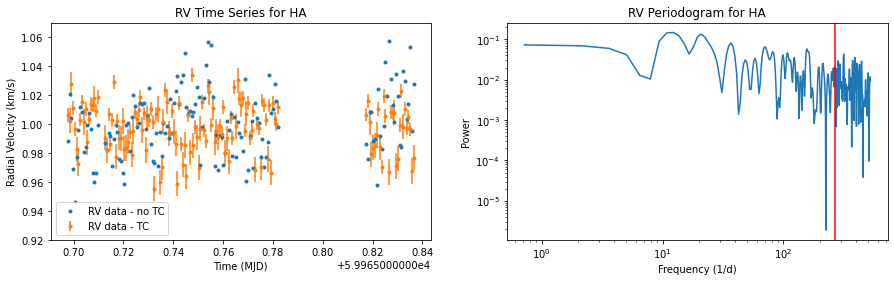

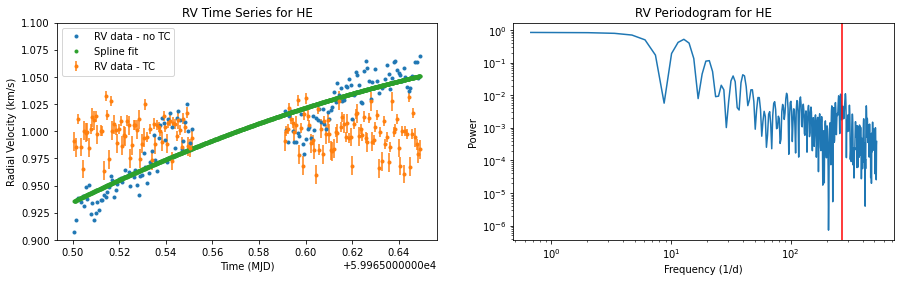

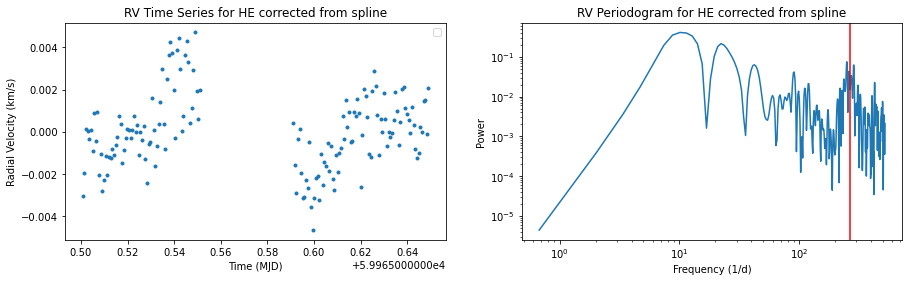

In [82]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

LS_RV_HA = LombScargle(date_HA-min(date_HA), total_RV_HA).autopower(nyquist_factor=1)
LS_RV_HE = LombScargle(date_HE-min(date_HE), total_RV_HE).autopower(nyquist_factor=1)

ax1.plot(date_HA, total_RV_HA/np.mean(total_RV_HA), '.', label='RV data - no TC')
ax1.errorbar(date_HA, total_CCF_RV_HA/np.median(total_CCF_RV_HA), yerr = total_CCF_RV_err_HA/np.median(total_CCF_RV_HA), fmt='.', label='RV data - TC')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('Radial Velocity (km/s)')
ax1.set_title('RV Time Series for HA')
ax1.set_ylim([0.92, 1.07])
ax1.legend()

ax2.loglog(LS_RV_HA[0], LS_RV_HA[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('RV Periodogram for HA')

ax2.axvline(oscillation_freq, color='r')


model = np.poly1d(np.polyfit(date_HE, total_RV_HE, 3))
model_x = np.linspace(min(date_HE), max(date_HE), 1000)
print(model)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

ax1.plot(date_HE, total_RV_HE/np.mean(total_RV_HE), '.', label='RV data - no TC')
ax1.errorbar(date_HE, total_CCF_RV_HE/np.median(total_CCF_RV_HE), yerr = total_CCF_RV_err_HE/np.median(total_CCF_RV_HE), fmt='.', label='RV data - TC')
ax1.plot(model_x, model(model_x)/np.mean(total_RV_HE), '.', label='Spline fit')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('Radial Velocity (km/s)')
ax1.set_title('RV Time Series for HE')
ax1.set_ylim([.9, 1.1])
ax1.legend()

ax2.loglog(LS_RV_HE[0], LS_RV_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('RV Periodogram for HE')

ax2.axvline(oscillation_freq, color='r')


## Removing the trend from the model

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

ax1.plot(date_HE, total_RV_HE-model(date_HE), '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('Radial Velocity (km/s)')
ax1.set_title('RV Time Series for HE corrected from spline')
ax1.legend()

new_LS_RV_HE = LombScargle(date_HE-min(date_HE), total_RV_HE-model(date_HE)).autopower(nyquist_factor=1)

ax2.loglog(new_LS_RV_HE[0], new_LS_RV_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('RV Periodogram for HE corrected from spline')

ax2.axvline(oscillation_freq, color='r')

## Plotting the timeseries and periodogram of the FWHM

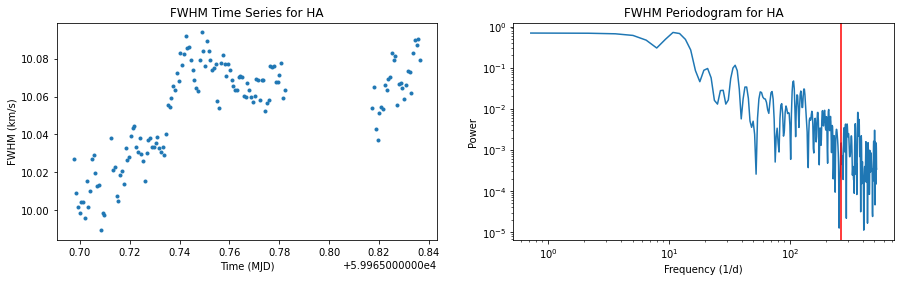

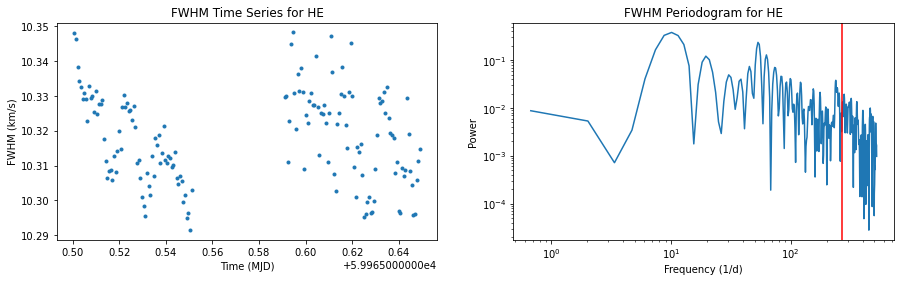

In [23]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

LS_FWHM_HA = LombScargle(date_HA-min(date_HA), total_FWHM_HA).autopower(nyquist_factor=1)
LS_FWHM_HE = LombScargle(date_HE-min(date_HE), total_FWHM_HE).autopower(nyquist_factor=1)

ax1.plot(date_HA, total_FWHM_HA, '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('FWHM (km/s)')
ax1.set_title('FWHM Time Series for HA')

ax2.loglog(LS_FWHM_HA[0], LS_FWHM_HA[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('FWHM Periodogram for HA')

ax2.axvline(oscillation_freq, color='r')

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

ax1.plot(date_HE, total_FWHM_HE, '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('FWHM (km/s)')
ax1.set_title('FWHM Time Series for HE')

ax2.loglog(LS_FWHM_HE[0], LS_FWHM_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('FWHM Periodogram for HE')

ax2.axvline(oscillation_freq, color='r')

## Plotting the timeseries and periodogram of the Bisector Span

/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3444: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
No handles with labels found to put in legend.


            3          2
-1.616e-05 x + 0.9692 x + 5.812e+04 x - 3.485e+09


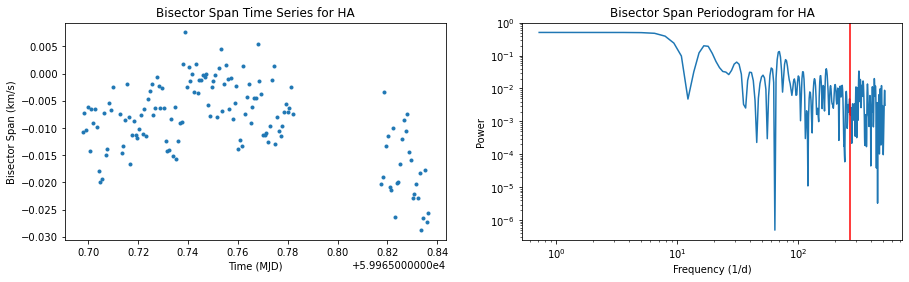

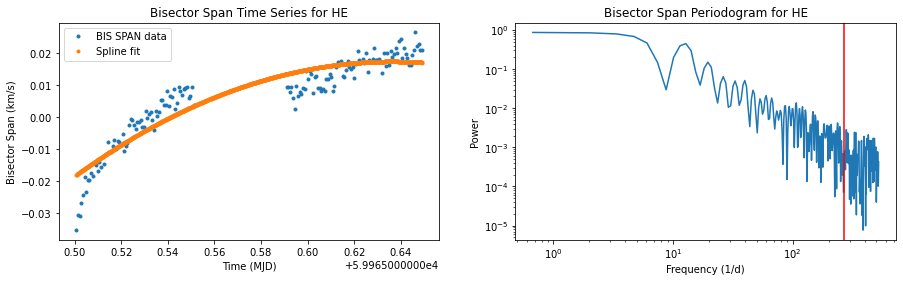

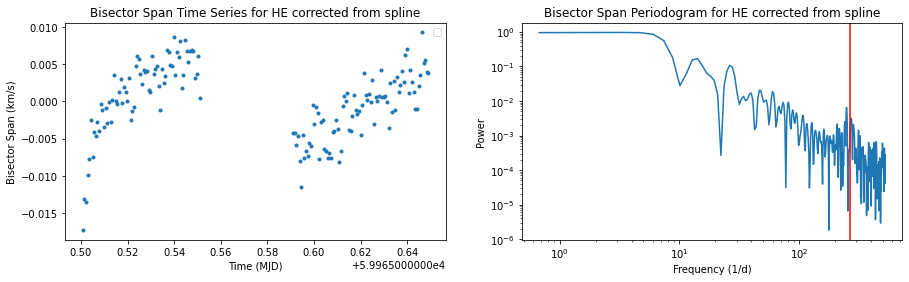

In [24]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

LS_BIS_SPAN_HA = LombScargle(date_HA-min(date_HA), total_BIS_SPAN_HA).autopower(nyquist_factor=1)
LS_BIS_SPAN_HE = LombScargle(date_HE-min(date_HE), total_BIS_SPAN_HE).autopower(nyquist_factor=1)

ax1.plot(date_HA, total_BIS_SPAN_HA, '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('Bisector Span (km/s)')
ax1.set_title('Bisector Span Time Series for HA')

ax2.loglog(LS_BIS_SPAN_HA[0], LS_BIS_SPAN_HA[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('Bisector Span Periodogram for HA')

ax2.axvline(oscillation_freq, color='r')

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

model_BS = np.poly1d(np.polyfit(date_HE, total_BIS_SPAN_HE, 3))
model_BS_x = np.linspace(min(date_HE), max(date_HE), 1000)
print(model_BS)

ax1.plot(date_HE, total_BIS_SPAN_HE, '.', label='BIS SPAN data')
ax1.plot(model_BS_x, model_BS(model_BS_x), '.', label='Spline fit')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('Bisector Span (km/s)')
ax1.set_title('Bisector Span Time Series for HE')
ax1.legend()

ax2.loglog(LS_BIS_SPAN_HE[0], LS_BIS_SPAN_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('Bisector Span Periodogram for HE')

ax2.axvline(oscillation_freq, color='r')
## Removing the trend from the model

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

ax1.plot(date_HE, total_BIS_SPAN_HE-model_BS(date_HE), '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('Bisector Span (km/s)')
ax1.set_title('Bisector Span Time Series for HE corrected from spline')
ax1.legend()

new_LS_BIS_SPAN_HE = LombScargle(date_HE-min(date_HE), total_RV_HE-model_BS(date_HE)).autopower(nyquist_factor=1)

ax2.loglog(new_LS_BIS_SPAN_HE[0], new_LS_BIS_SPAN_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('Bisector Span Periodogram for HE corrected from spline')

ax2.axvline(oscillation_freq, color='r')

## Plotting the timeseries and periodogram of H2O IWV

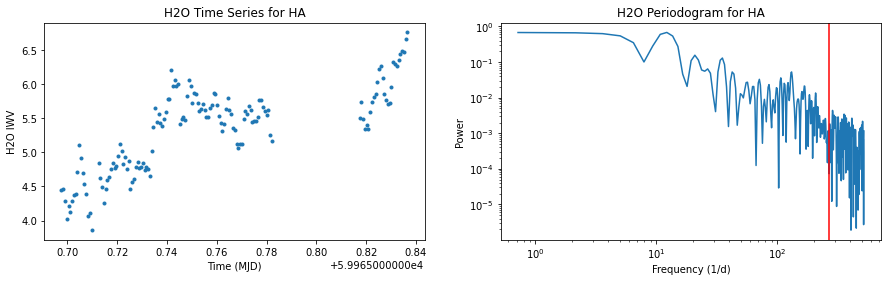

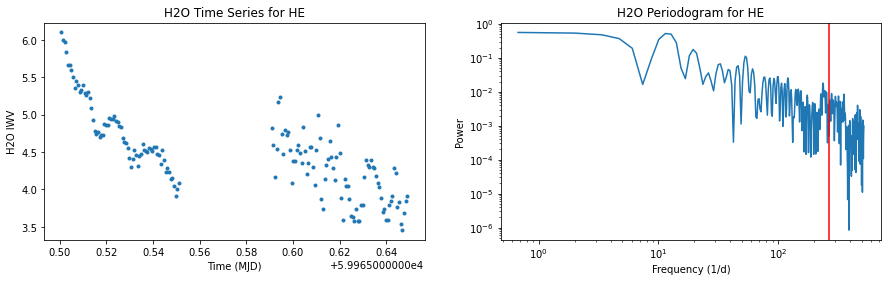

In [25]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

LS_H2O_HA = LombScargle(date_HA-min(date_HA), total_H2O_HA).autopower(nyquist_factor=1)
LS_H2O_HE = LombScargle(date_HE-min(date_HE), total_H2O_HE).autopower(nyquist_factor=1)

ax1.plot(date_HA, total_H2O_HA, '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('H2O IWV')
ax1.set_title('H2O Time Series for HA')

ax2.loglog(LS_H2O_HA[0], LS_H2O_HA[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('H2O Periodogram for HA')

ax2.axvline(oscillation_freq, color='r')

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

ax1.plot(date_HE, total_H2O_HE, '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('H2O IWV')
ax1.set_title('H2O Time Series for HE')

ax2.loglog(LS_H2O_HE[0], LS_H2O_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('H2O Periodogram for HE')

ax2.axvline(oscillation_freq, color='r')

## Plotting the timeseries and periodogram of O2 IWV

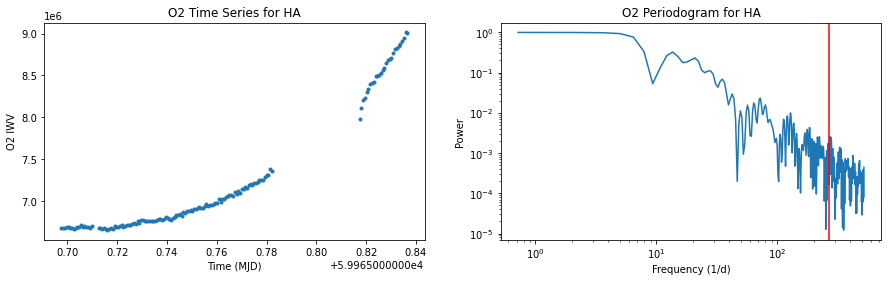

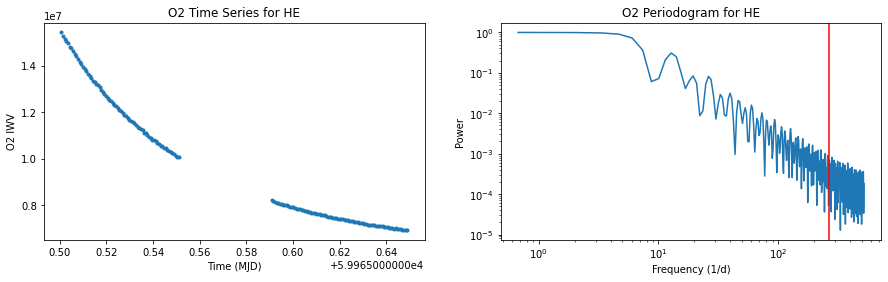

In [26]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

LS_O2_HA = LombScargle(date_HA-min(date_HA), total_O2_HA).autopower(nyquist_factor=1)
LS_O2_HE = LombScargle(date_HE-min(date_HE), total_O2_HE).autopower(nyquist_factor=1)

ax1.plot(date_HA, total_O2_HA, '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('O2 IWV')
ax1.set_title('O2 Time Series for HA')

ax2.loglog(LS_O2_HA[0], LS_O2_HA[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('O2 Periodogram for HA')

ax2.axvline(oscillation_freq, color='r')

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

ax1.plot(date_HE, total_O2_HE, '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('O2 IWV')
ax1.set_title('O2 Time Series for HE')

ax2.loglog(LS_O2_HE[0], LS_O2_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('O2 Periodogram for HE')

ax2.axvline(oscillation_freq, color='r')

## Plotting the timeseries and periodogram of CO2 IWV

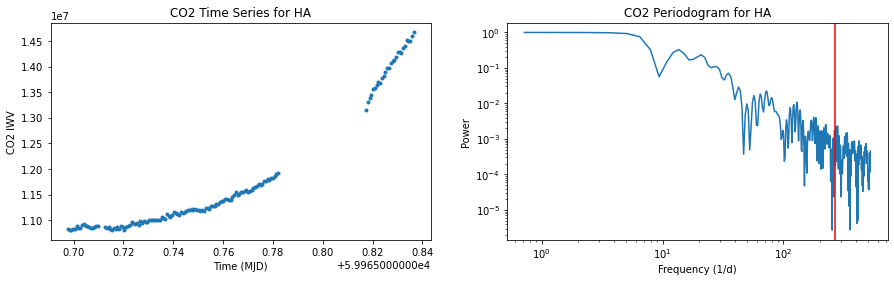

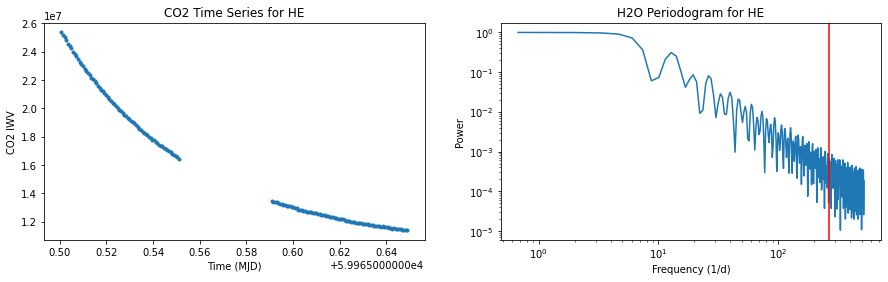

In [27]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

LS_CO2_HA = LombScargle(date_HA-min(date_HA), total_CO2_HA).autopower(nyquist_factor=1)
LS_CO2_HE = LombScargle(date_HE-min(date_HE), total_CO2_HE).autopower(nyquist_factor=1)

ax1.plot(date_HA, total_CO2_HA, '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('CO2 IWV')
ax1.set_title('CO2 Time Series for HA')

ax2.loglog(LS_CO2_HA[0], LS_CO2_HA[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('CO2 Periodogram for HA')

ax2.axvline(oscillation_freq, color='r')

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

ax1.plot(date_HE, total_CO2_HE, '.')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('CO2 IWV')
ax1.set_title('CO2 Time Series for HE')

ax2.loglog(LS_CO2_HE[0], LS_CO2_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('H2O Periodogram for HE')

ax2.axvline(oscillation_freq, color='r')

## Fitting a Voigt profile to the Si line

[9.98286461e-01 4.68428851e-01 1.08300794e+04 7.60464873e-05
 2.48651063e-01]


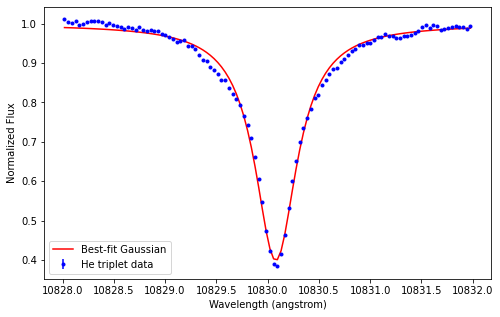

[9.96697400e-01 4.55686649e-01 1.08300799e+04 1.09087660e-05
 2.39778495e-01]


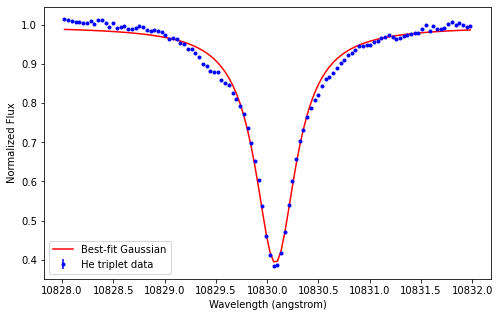

[1.00044569e+00 4.69502619e-01 1.08300794e+04 1.22432844e-04
 2.48669792e-01]


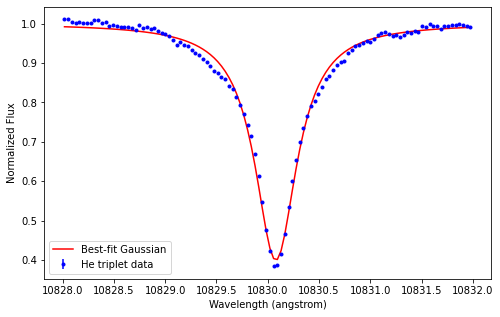

[9.96481049e-01 4.56156544e-01 1.08300805e+04 4.07457288e-06
 2.40307977e-01]


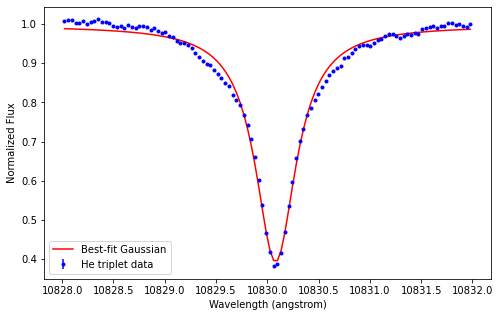

[9.98762686e-01 4.62797185e-01 1.08300800e+04 1.36745126e-05
 2.43559192e-01]


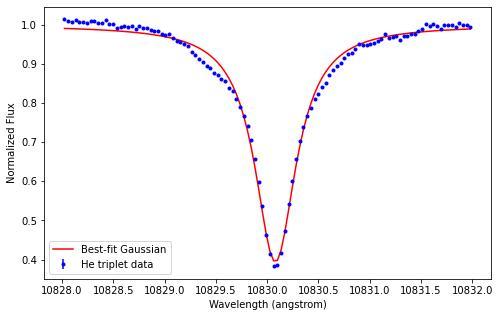

[1.00075100e+00 4.68498693e-01 1.08300791e+04 6.14194485e-06
 2.47391311e-01]


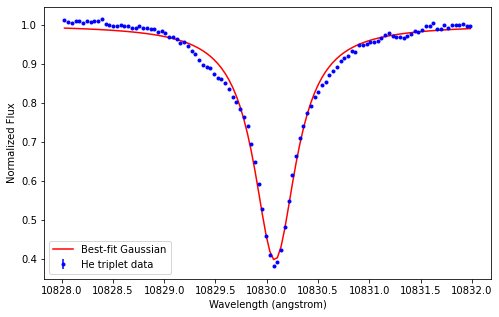

[1.00079548e+00 4.71097559e-01 1.08300798e+04 2.68783007e-04
 2.46973457e-01]


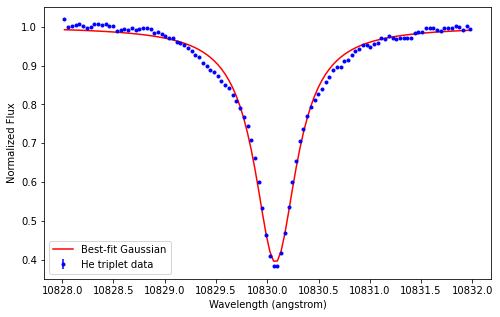

[9.99828546e-01 4.66040767e-01 1.08300798e+04 8.46508392e-06
 2.46282634e-01]


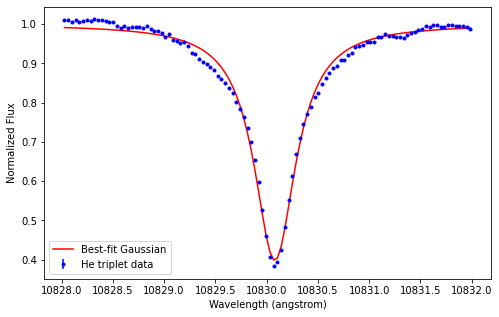

[1.00009414e+00 4.66284316e-01 1.08300799e+04 3.15958853e-05
 2.45831084e-01]


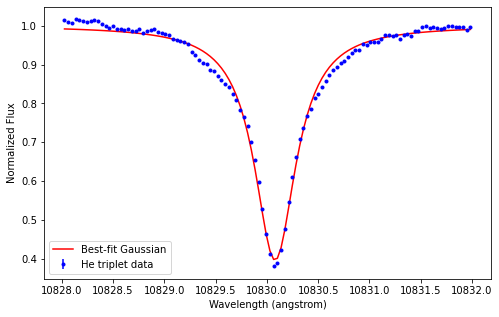

[1.00244323e+00 4.76143810e-01 1.08300799e+04 1.50019435e-04
 2.48764553e-01]


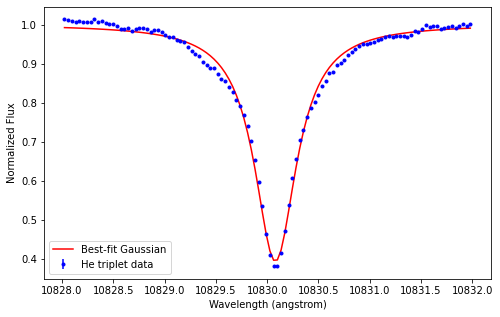

[9.98937395e-01 4.63232297e-01 1.08300802e+04 2.44073754e-05
 2.43523671e-01]


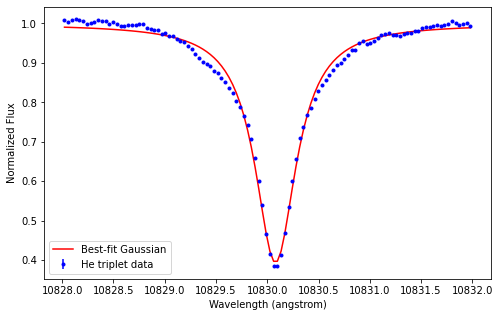

[9.96269494e-01 4.53537426e-01 1.08300801e+04 2.00498529e-06
 2.39364245e-01]


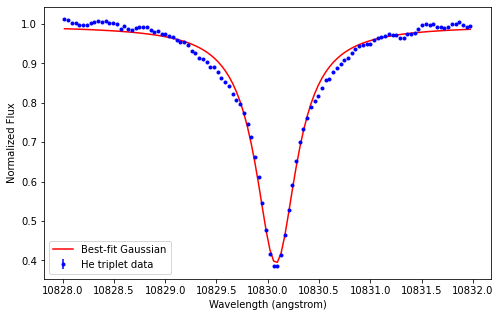

[9.98936364e-01 4.64329399e-01 1.08300801e+04 6.82871471e-06
 2.44745331e-01]


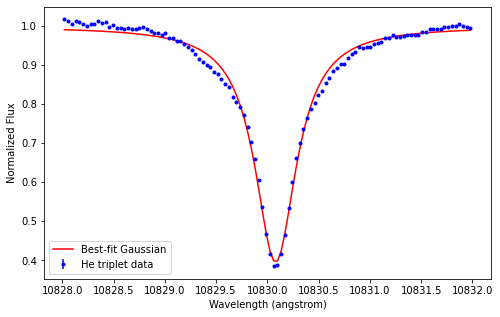

[1.00118933e+00 4.69371209e-01 1.08300808e+04 2.63993669e-05
 2.47697725e-01]


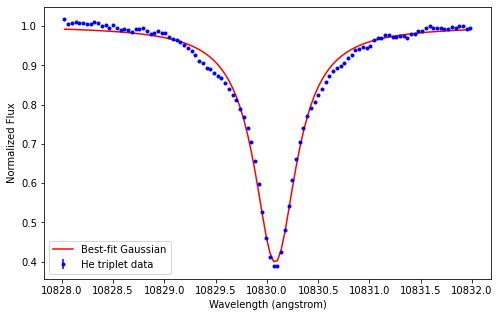

[9.97952494e-01 4.60438790e-01 1.08300810e+04 8.79028518e-06
 2.42455297e-01]


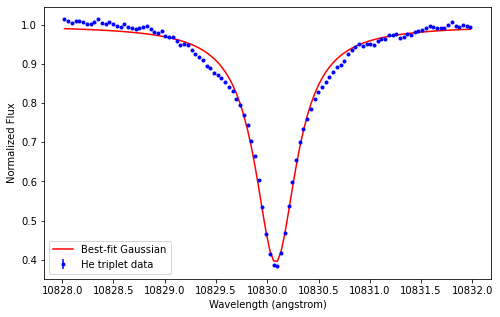

[9.97259984e-01 4.56600003e-01 1.08300807e+04 2.76022142e-07
 2.40818934e-01]


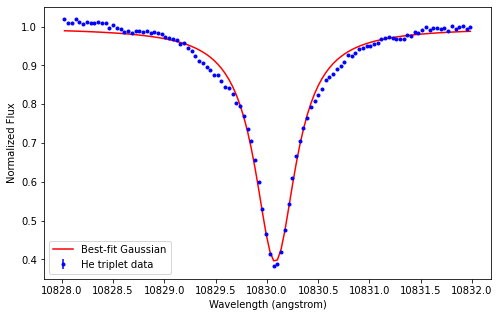

[1.00014918e+00 4.60930435e-01 1.08300794e+04 2.18022746e-05
 2.41753083e-01]


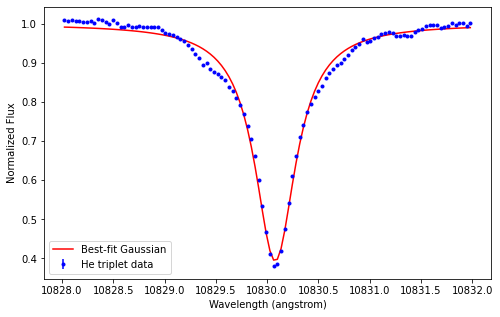

[1.00068705e+00 4.68855243e-01 1.08300789e+04 1.54033648e-05
 2.47514676e-01]


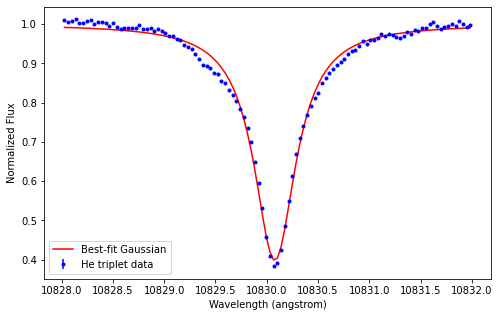

[1.00026906e+00 4.68420551e-01 1.08300805e+04 1.98230437e-04
 2.46837769e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


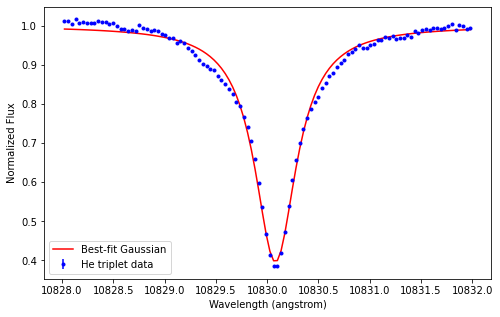

[9.99594485e-01 4.61545891e-01 1.08300791e+04 8.99943506e-06
 2.43750857e-01]


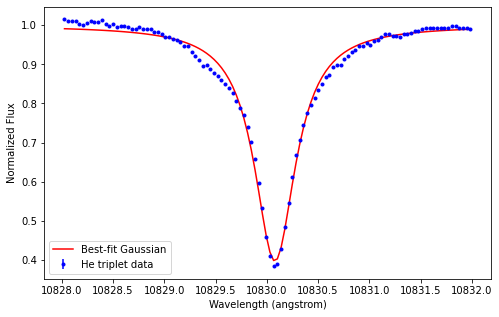

[9.97401409e-01 4.52591098e-01 1.08300804e+04 3.79248454e-06
 2.38648362e-01]


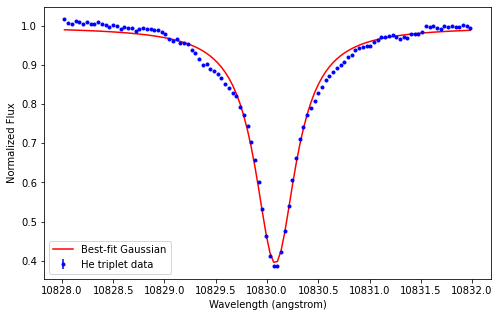

[9.98210864e-01 4.55892809e-01 1.08300789e+04 1.03308797e-05
 2.40496288e-01]


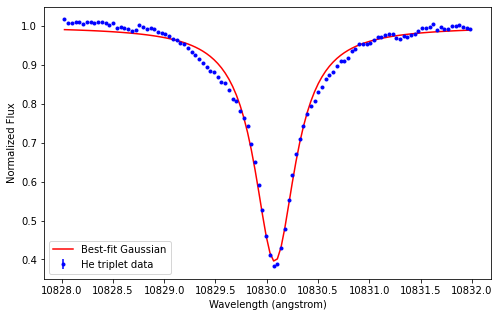

[9.98229640e-01 4.59159513e-01 1.08300789e+04 1.34370913e-05
 2.43207153e-01]


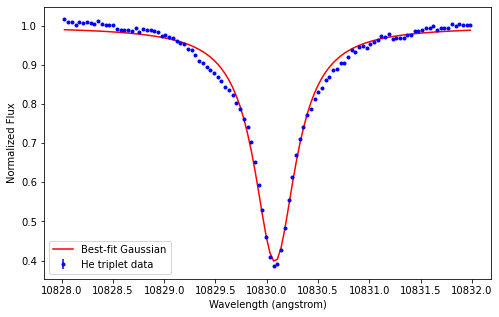

[9.97397420e-01 4.56153208e-01 1.08300786e+04 6.69916870e-06
 2.40143182e-01]


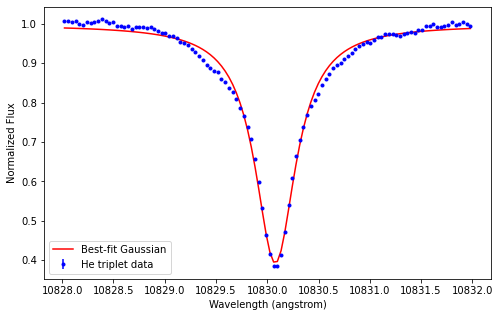

[9.97610276e-01 4.56195503e-01 1.08300797e+04 6.86903623e-07
 2.40349215e-01]


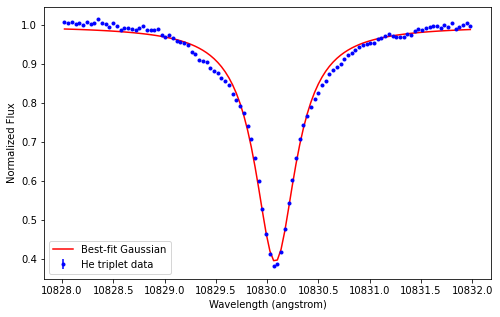

[9.99234659e-01 4.57833142e-01 1.08300795e+04 3.70715360e-06
 2.40956953e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


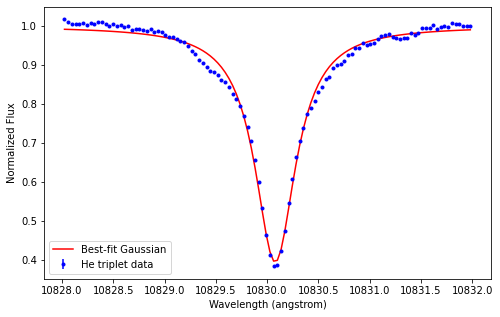

[9.98999616e-01 4.62953370e-01 1.08300799e+04 1.82338264e-05
 2.43339564e-01]


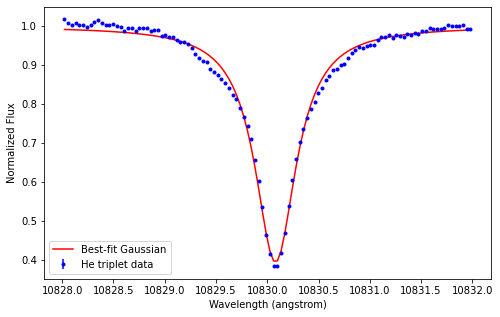

[1.00070577e+00 4.70119452e-01 1.08300785e+04 8.60641695e-05
 2.48201311e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


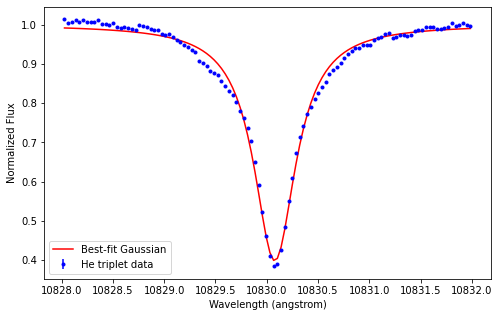

[1.00091099e+00 4.69852089e-01 1.08300804e+04 9.51973308e-05
 2.47612312e-01]


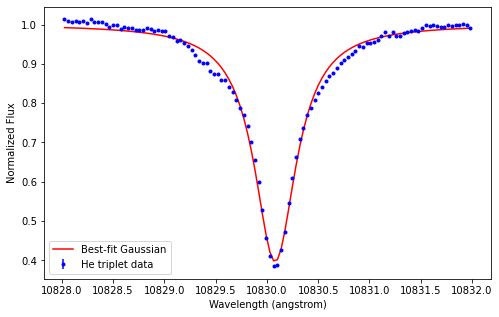

[9.98671958e-01 4.61264551e-01 1.08300795e+04 1.36851247e-05
 2.43052800e-01]


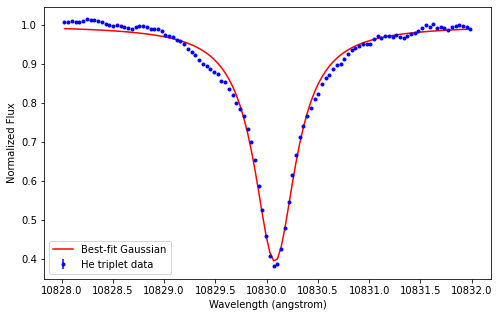

[1.00005975e+00 4.64648255e-01 1.08300792e+04 6.39598923e-07
 2.44651750e-01]


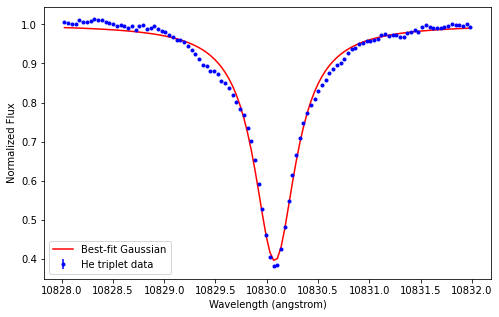

[9.98470776e-01 4.57226019e-01 1.08300796e+04 4.81679866e-06
 2.40570028e-01]


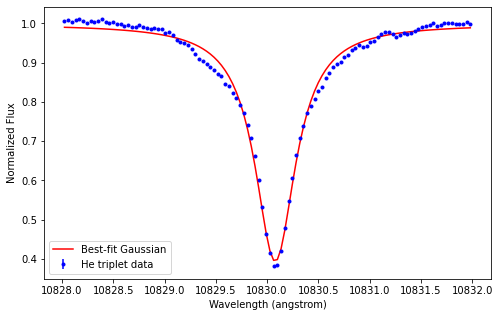

[1.00214818e+00 4.76991517e-01 1.08300792e+04 2.31687222e-05
 2.52445539e-01]


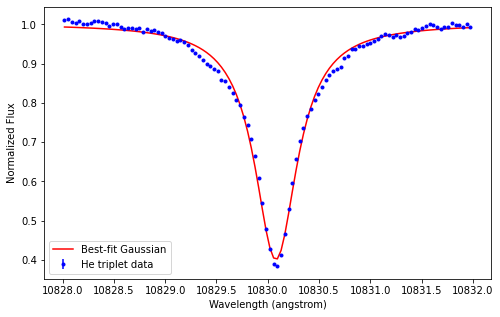

[9.99153285e-01 4.62177502e-01 1.08300787e+04 1.00660168e-05
 2.44680318e-01]


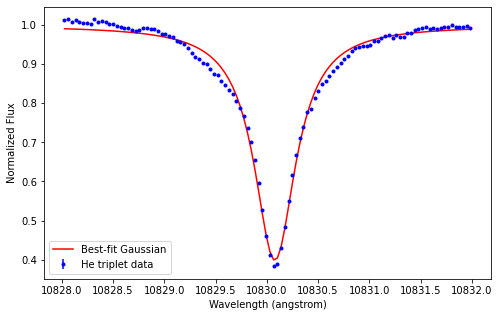

[9.96507689e-01 4.51291011e-01 1.08300803e+04 9.26315784e-06
 2.38410253e-01]


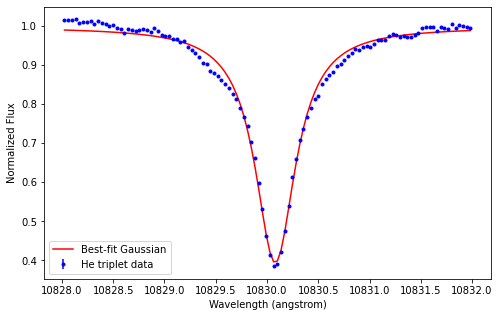

[9.99330311e-01 4.60304909e-01 1.08300800e+04 5.51735437e-06
 2.43064158e-01]


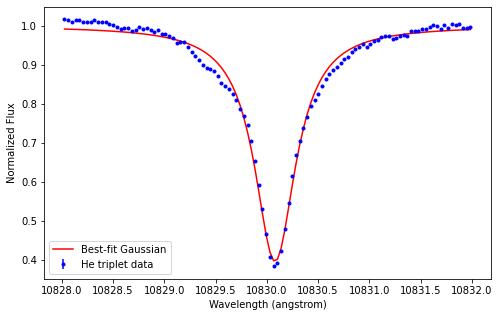

[1.00005826e+00 4.64445653e-01 1.08300795e+04 4.84335226e-05
 2.44603748e-01]


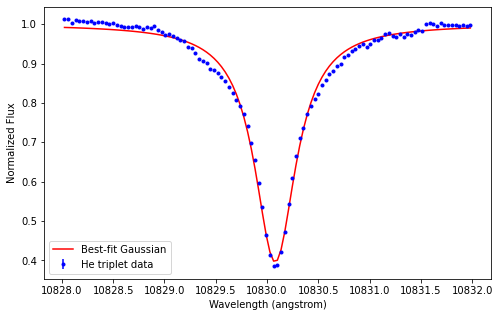

[1.00049327e+00 4.68883541e-01 1.08300787e+04 2.65295239e-05
 2.47562932e-01]


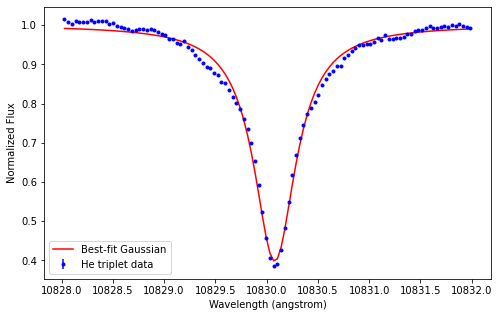

[9.99812249e-01 4.61749214e-01 1.08300789e+04 9.77662438e-07
 2.43763256e-01]


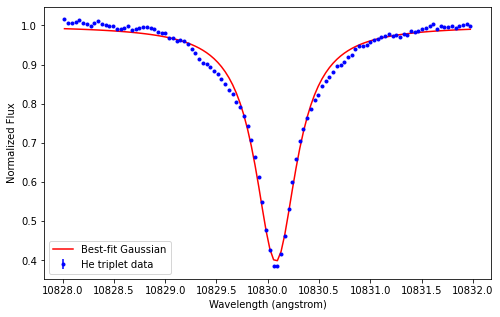

[1.00139692e+00 4.67444037e-01 1.08300794e+04 2.81294526e-04
 2.47136306e-01]


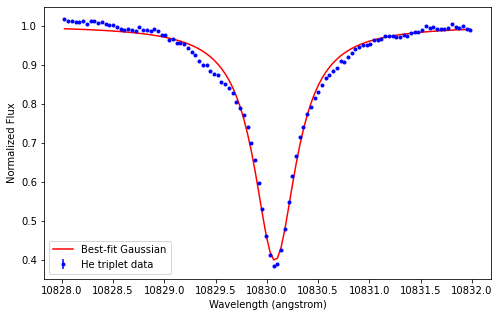

[1.00079711e+00 4.72043245e-01 1.08300801e+04 4.14557333e-05
 2.47603663e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


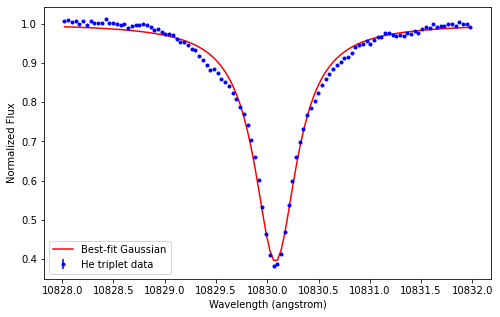

[1.00040118e+00 4.65092061e-01 1.08300794e+04 2.48669334e-05
 2.46563290e-01]


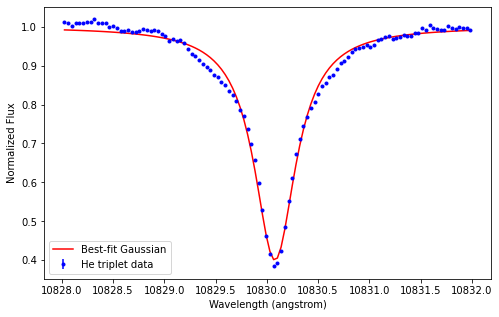

[9.97494265e-01 4.55762851e-01 1.08300802e+04 6.51931110e-06
 2.39951240e-01]


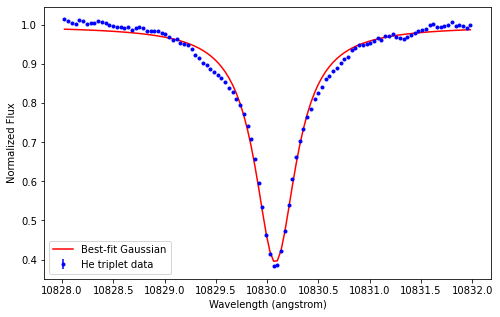

[9.98351873e-01 4.57239529e-01 1.08300805e+04 5.80020329e-06
 2.40671629e-01]


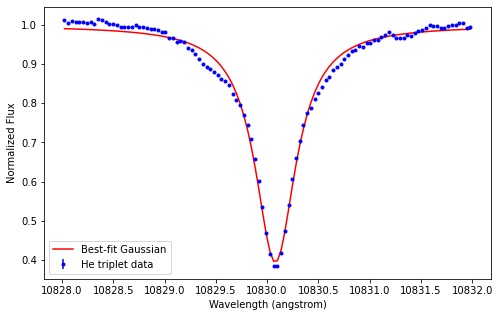

[9.99404733e-01 4.62449866e-01 1.08300793e+04 8.20804954e-06
 2.44252200e-01]


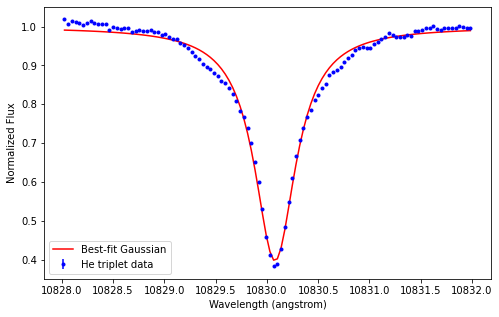

[9.99930265e-01 4.62300683e-01 1.08300805e+04 8.59184011e-06
 2.42973342e-01]


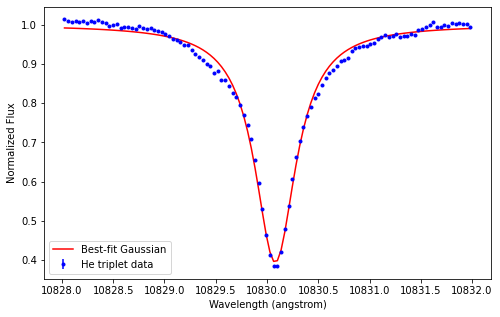

[9.98769872e-01 4.62225656e-01 1.08300806e+04 9.77728579e-06
 2.44127979e-01]


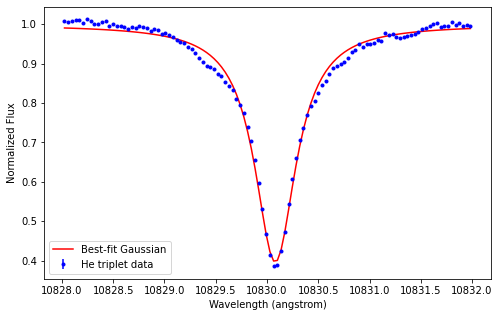

[1.00083684e+00 4.68146509e-01 1.08300804e+04 8.31872868e-06
 2.46433416e-01]


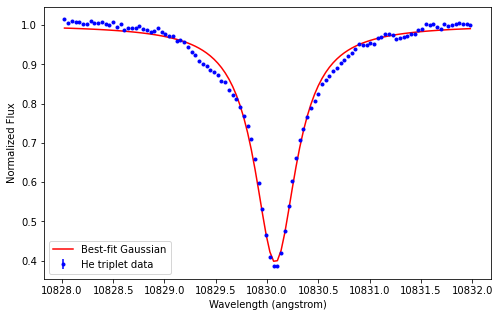

[9.87426411e-01 4.63540850e-01 1.08300791e+04 5.04580569e-05
 2.50137328e-01]


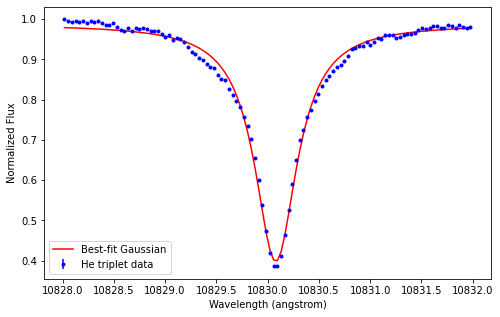

[9.98798591e-01 4.64566498e-01 1.08300805e+04 3.01391501e-05
 2.44958914e-01]


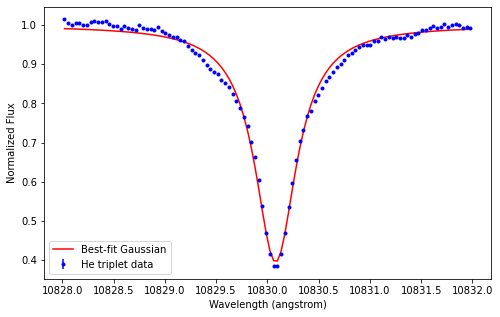

[1.00034102e+00 4.70769156e-01 1.08300805e+04 3.62248354e-05
 2.47121104e-01]


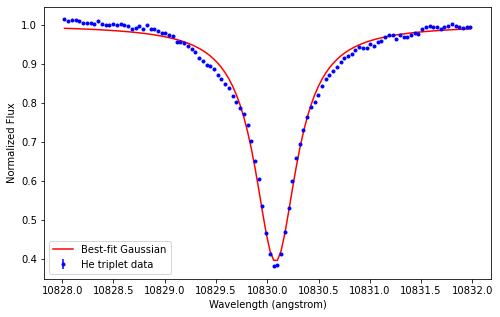

[9.97561969e-01 4.60845009e-01 1.08300808e+04 9.60156839e-06
 2.42535266e-01]


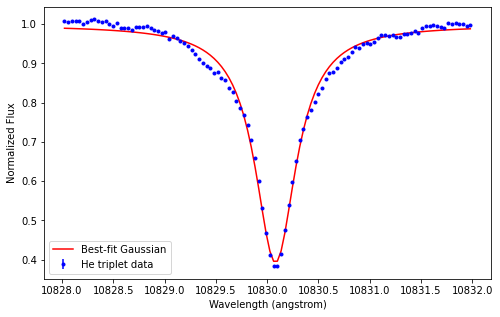

[9.98677610e-01 4.58694978e-01 1.08300798e+04 1.88970354e-05
 2.41576095e-01]


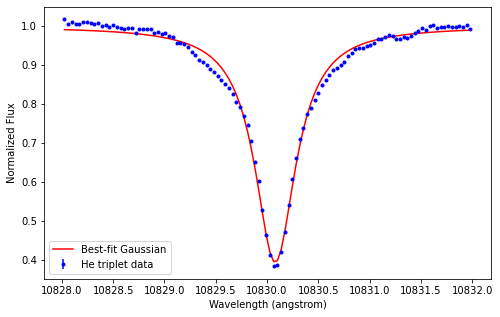

[9.97882670e-01 4.57313936e-01 1.08300807e+04 1.24544721e-05
 2.40390178e-01]


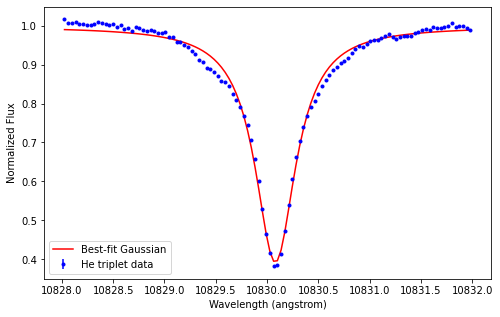

[1.00070028e+00 4.67170849e-01 1.08300790e+04 4.75921581e-07
 2.46697049e-01]


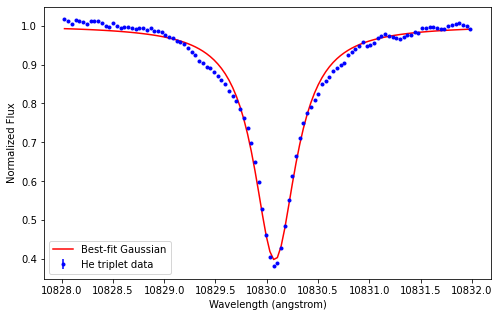

[9.98649108e-01 4.61421827e-01 1.08300801e+04 1.61791856e-04
 2.43824394e-01]


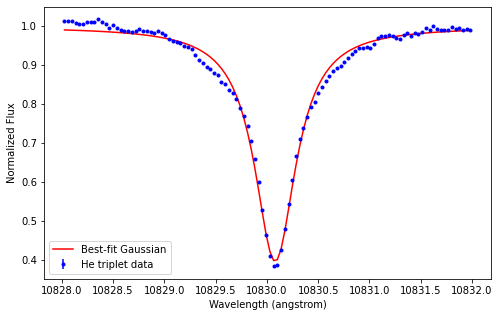

[9.97609393e-01 4.61665942e-01 1.08300799e+04 8.90832162e-06
 2.43192946e-01]


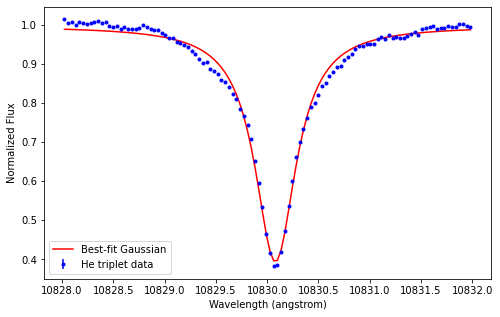

[1.00090227e+00 4.65429694e-01 1.08300790e+04 3.24098940e-06
 2.46059125e-01]


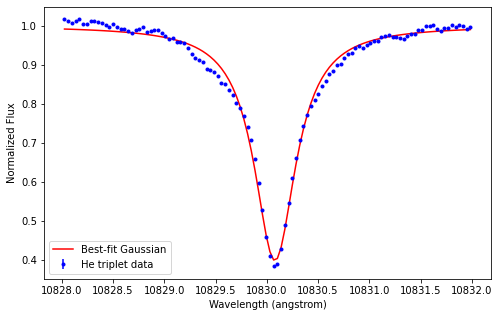

[9.98948543e-01 4.58572688e-01 1.08300790e+04 7.36508349e-06
 2.42424470e-01]


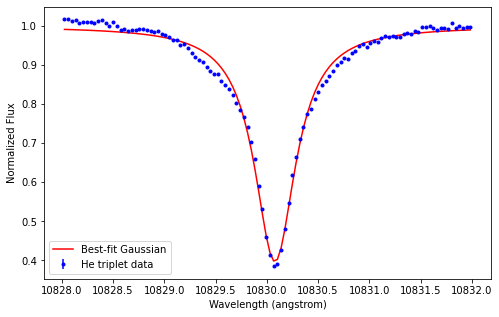

[9.99780191e-01 4.68836788e-01 1.08300803e+04 7.88836862e-07
 2.46357598e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


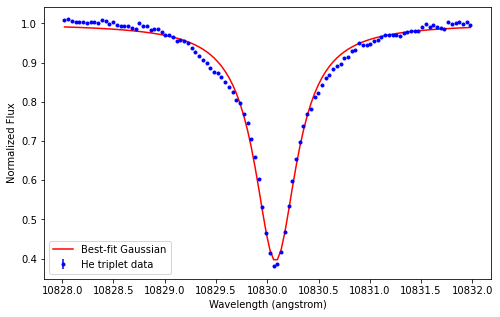

[9.99789450e-01 4.73269759e-01 1.08300789e+04 1.71955665e-03
 2.50031063e-01]


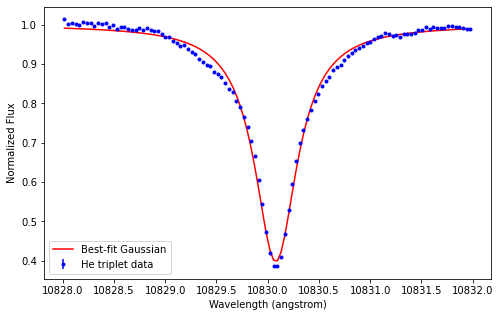

[9.98457507e-01 4.63535125e-01 1.08300803e+04 3.49095983e-05
 2.44677157e-01]


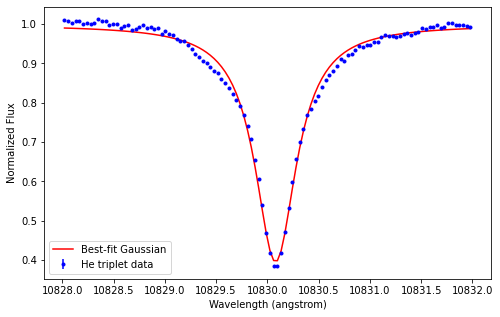

[9.99837189e-01 4.66293792e-01 1.08300797e+04 5.64864367e-05
 2.46380714e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


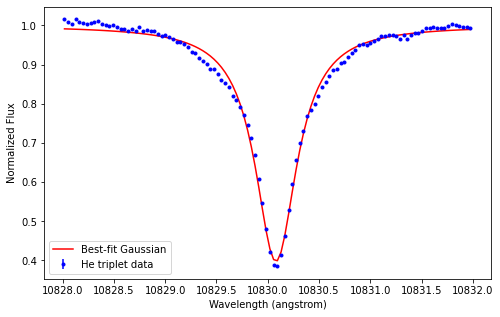

[1.00051369e+00 4.69637290e-01 1.08300798e+04 2.04420688e-05
 2.47831946e-01]


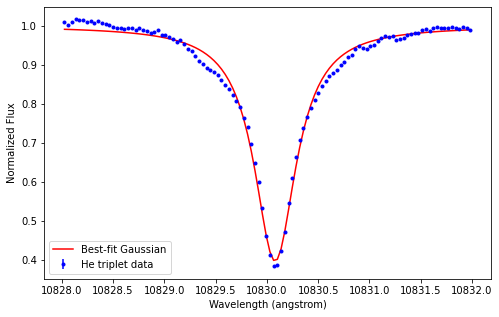

[9.99780970e-01 4.68126482e-01 1.08300796e+04 5.52027167e-05
 2.47303999e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


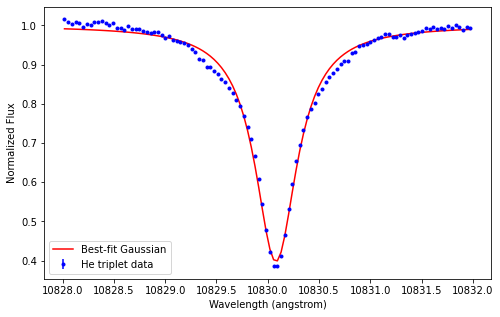

[9.98676702e-01 4.62329305e-01 1.08300788e+04 1.22595847e-05
 2.43952288e-01]


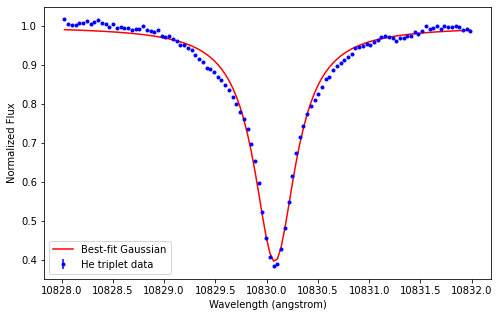

[1.00024328e+00 4.67778622e-01 1.08300798e+04 3.30382674e-05
 2.46615549e-01]


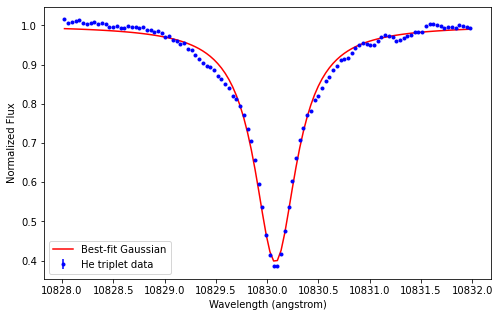

[1.00096957e+00 4.75422141e-01 1.08300789e+04 1.53981560e-04
 2.51894764e-01]


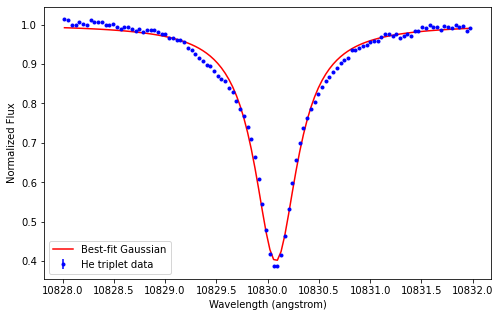

[1.00077172e+00 4.69846285e-01 1.08300786e+04 9.37580984e-05
 2.48352794e-01]


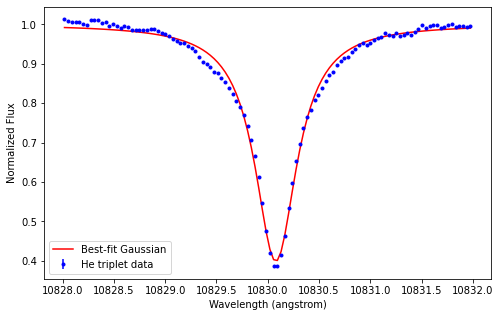

[9.97991784e-01 4.57462231e-01 1.08300805e+04 4.50329204e-06
 2.42036777e-01]


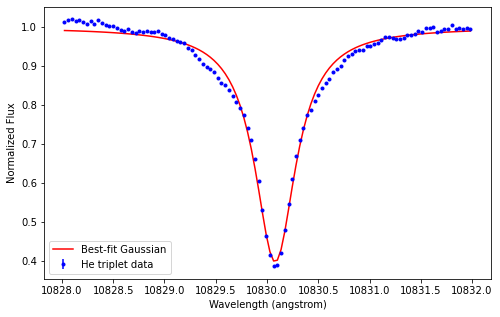

[9.98404810e-01 4.59762557e-01 1.08300809e+04 5.43073982e-06
 2.41592119e-01]


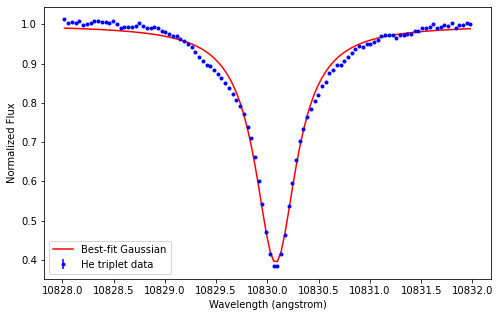

[9.98720198e-01 4.71553583e-01 1.08300798e+04 2.94973210e-05
 2.50315052e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


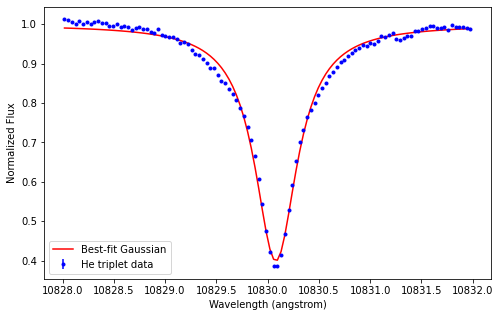

[1.00096669e+00 4.66430578e-01 1.08300800e+04 3.09812828e-04
 2.45686998e-01]


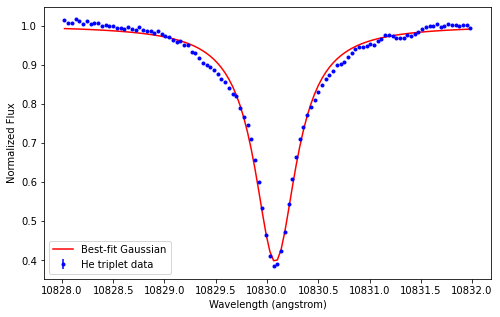

[1.00608595e+00 4.74286686e-01 1.08300789e+04 5.78812110e-05
 2.49217181e-01]


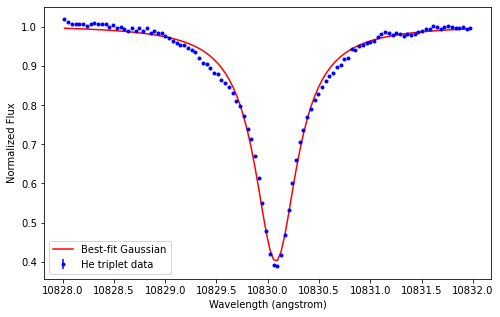

[1.00239399e+00 4.76120840e-01 1.08300803e+04 1.40787597e-03
 2.50430157e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


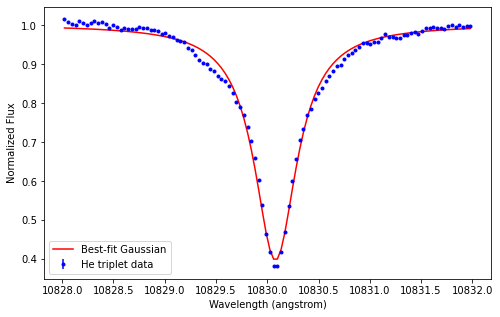

[9.97596049e-01 4.59982015e-01 1.08300800e+04 4.76878838e-06
 2.42128715e-01]


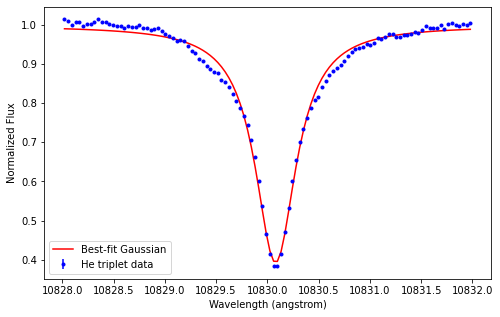

[9.98404515e-01 4.57939373e-01 1.08300806e+04 8.41406222e-06
 2.42014053e-01]


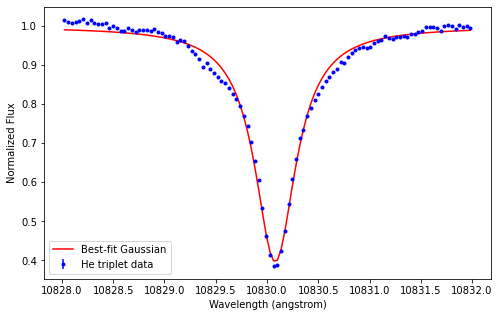

[9.99833632e-01 4.69238396e-01 1.08300801e+04 3.65775137e-05
 2.46342322e-01]


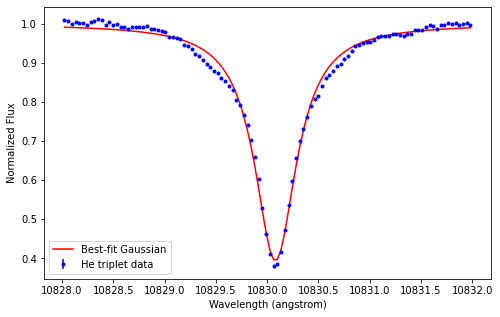

[9.99466146e-01 4.63149923e-01 1.08300787e+04 7.66521769e-06
 2.45042102e-01]


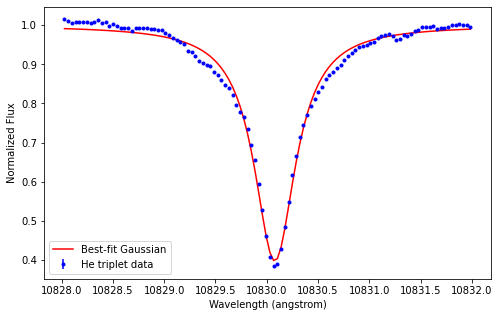

[9.98818387e-01 4.62273372e-01 1.08300797e+04 1.35749375e-05
 2.43996248e-01]


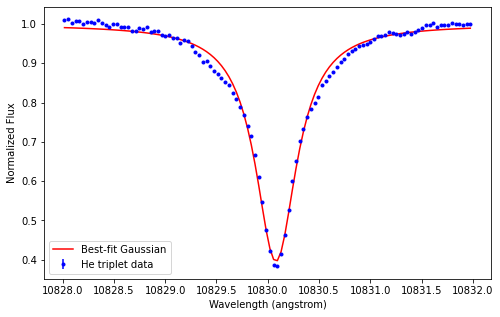

[9.97609631e-01 4.60241560e-01 1.08300781e+04 1.56290619e-06
 2.43695537e-01]


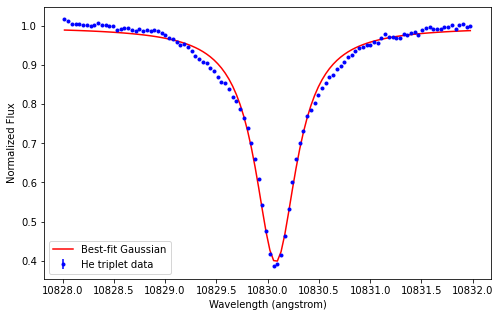

[9.99641725e-01 4.63952642e-01 1.08300812e+04 1.41901909e-05
 2.44379831e-01]


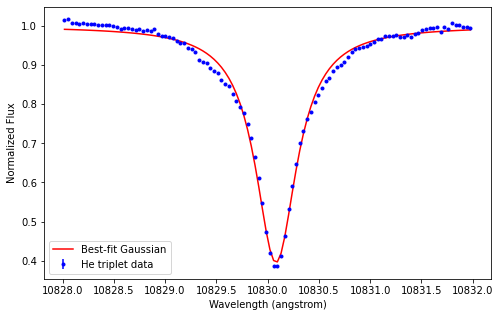

[1.00175700e+00 4.73530747e-01 1.08300792e+04 7.65903842e-05
 2.50834235e-01]


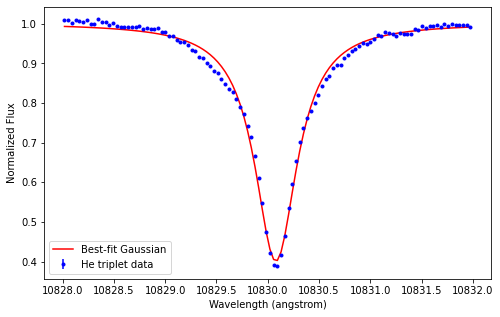

[1.00022556e+00 4.66919456e-01 1.08300801e+04 1.72250881e-05
 2.46451392e-01]


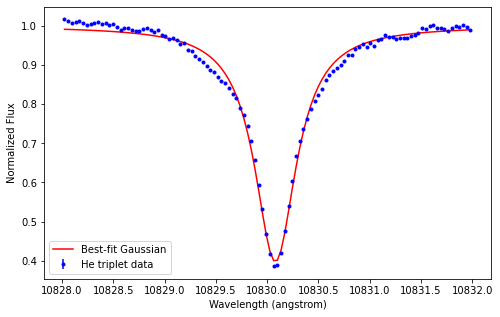

[1.00195399e+00 4.70293512e-01 1.08300799e+04 1.66186389e-05
 2.48861266e-01]


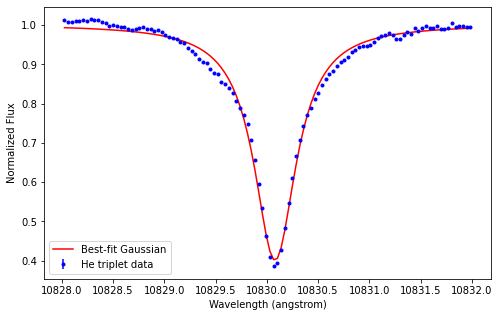

[9.99396375e-01 4.58572796e-01 1.08300793e+04 1.03689422e-05
 2.41397021e-01]


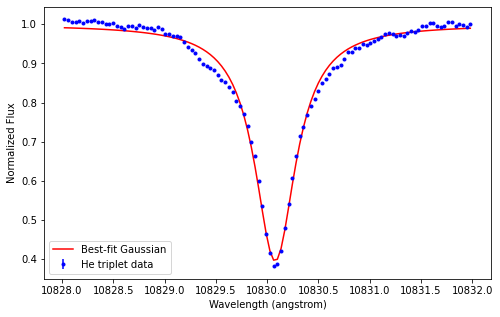

[9.98983092e-01 4.63813581e-01 1.08300802e+04 9.50821184e-07
 2.44333904e-01]


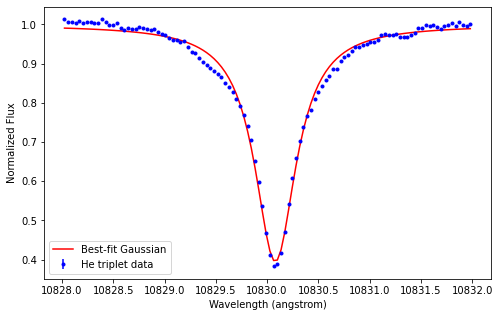

[9.96848485e-01 4.57853758e-01 1.08300803e+04 7.54893653e-07
 2.40919237e-01]


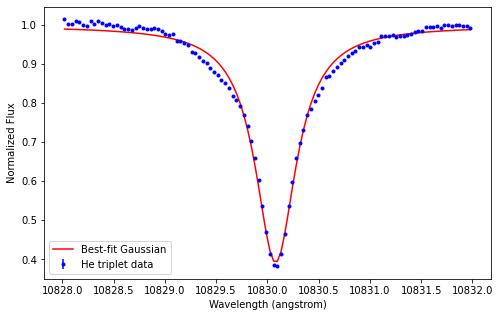

[9.99059774e-01 4.61855132e-01 1.08300797e+04 1.71890575e-05
 2.43202006e-01]


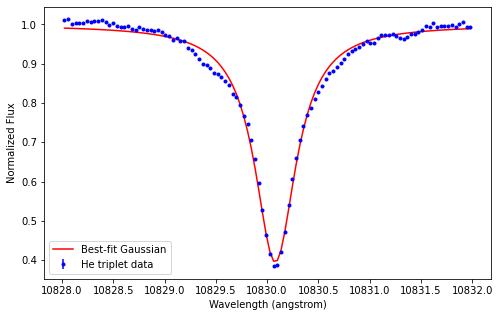

[9.99989202e-01 4.64480023e-01 1.08300800e+04 8.21795473e-06
 2.45005560e-01]


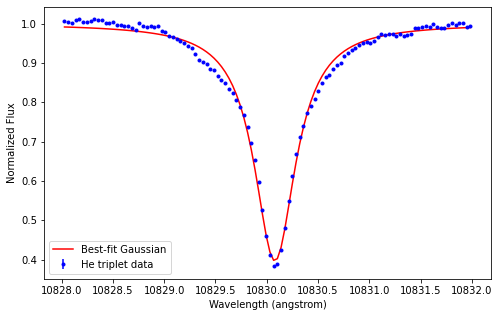

[1.00009979e+00 4.66324937e-01 1.08300792e+04 7.46131972e-06
 2.47318887e-01]


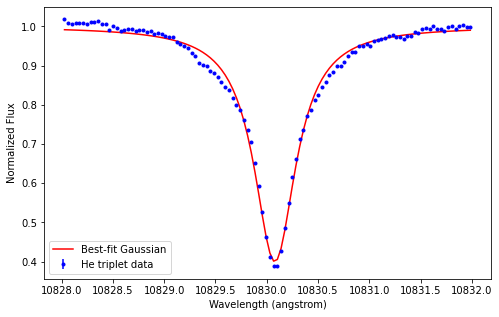

[9.99351497e-01 4.69822149e-01 1.08300785e+04 2.40117281e-05
 2.49705002e-01]


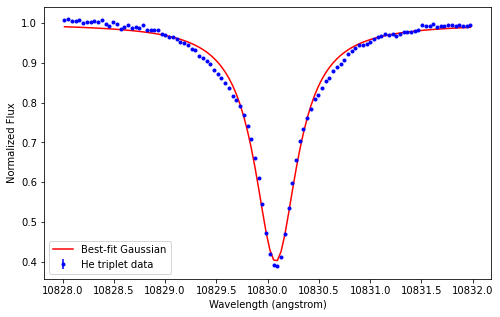

[9.98631397e-01 4.60425740e-01 1.08300789e+04 1.93044064e-05
 2.43402946e-01]


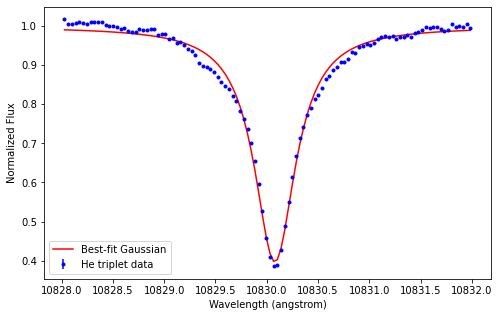

[1.00129897e+00 4.65697062e-01 1.08300798e+04 4.83727619e-07
 2.45527727e-01]


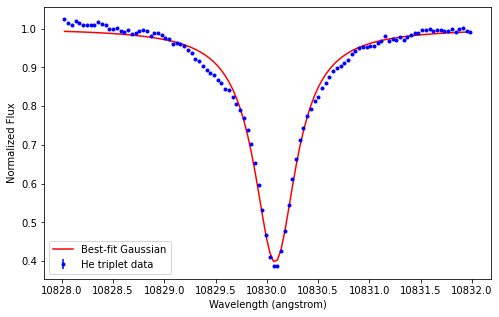

[9.96846164e-01 4.53236815e-01 1.08300803e+04 1.21957855e-05
 2.39837497e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


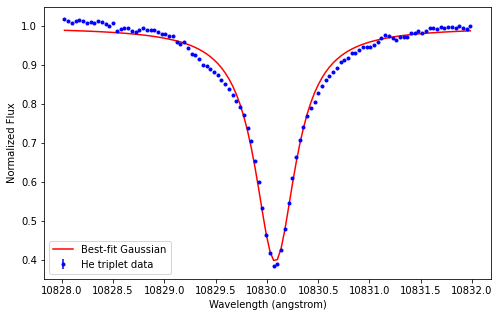

[9.98083607e-01 4.56816227e-01 1.08300796e+04 4.46418373e-06
 2.41256317e-01]


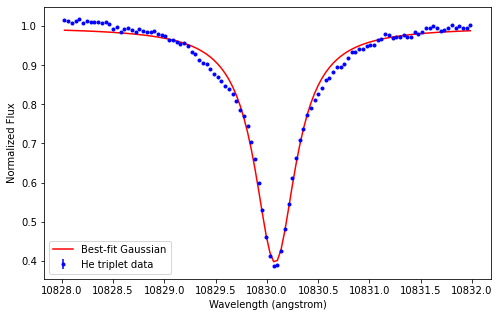

[9.99304511e-01 4.69639591e-01 1.08300790e+04 4.52954812e-04
 2.47675127e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


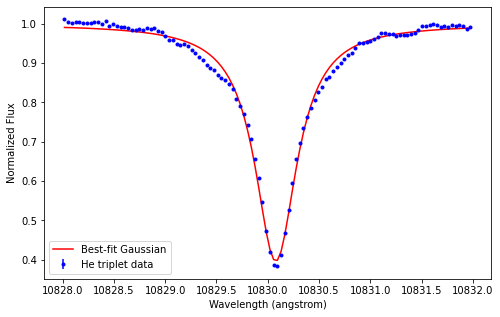

[9.96563767e-01 4.65075126e-01 1.08300790e+04 5.42318349e-04
 2.47021020e-01]


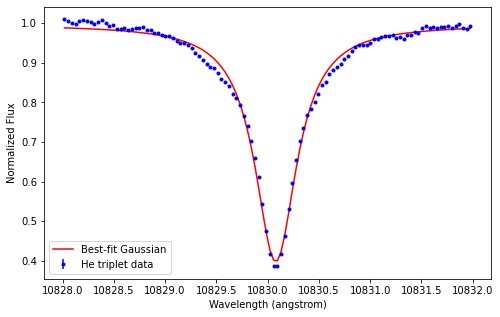

[9.94224041e-01 4.66269829e-01 1.08300788e+04 8.16071680e-05
 2.49454438e-01]


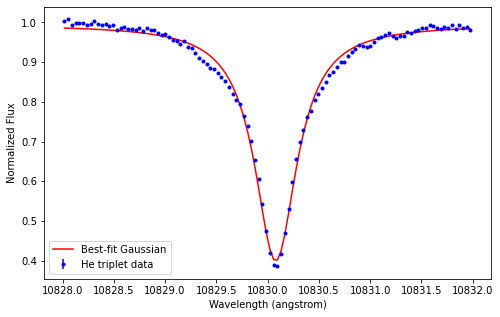

[9.99564970e-01 4.68368761e-01 1.08300803e+04 2.85658536e-05
 2.46136790e-01]


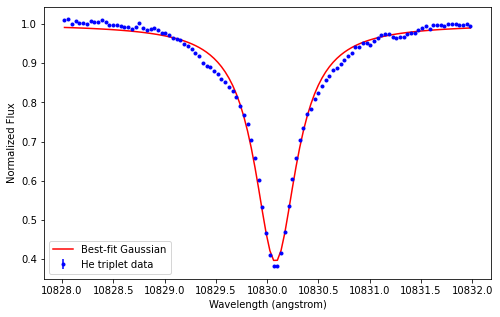

[9.96415740e-01 4.54845516e-01 1.08300802e+04 1.02496174e-05
 2.39791253e-01]


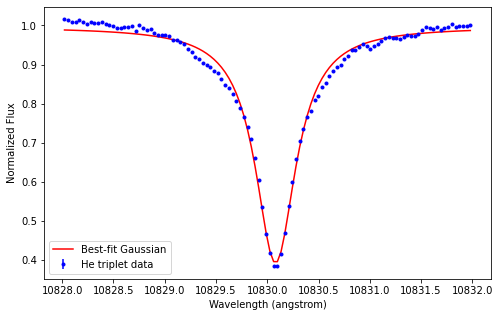

[1.00023540e+00 4.62125142e-01 1.08300791e+04 2.41025243e-06
 2.42575871e-01]


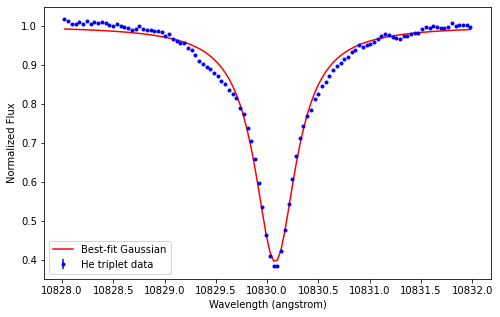

[1.00131651e+00 4.69716209e-01 1.08300800e+04 3.46685311e-04
 2.47486846e-01]


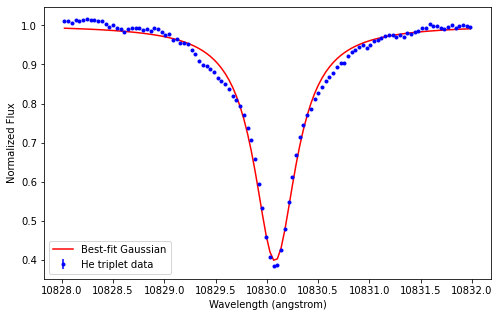

[1.00036041e+00 4.66789176e-01 1.08300797e+04 7.06994201e-06
 2.47179751e-01]


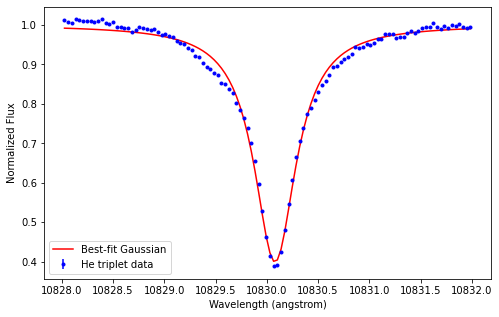

[9.97628944e-01 4.56260602e-01 1.08300804e+04 7.53012795e-07
 2.40810681e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


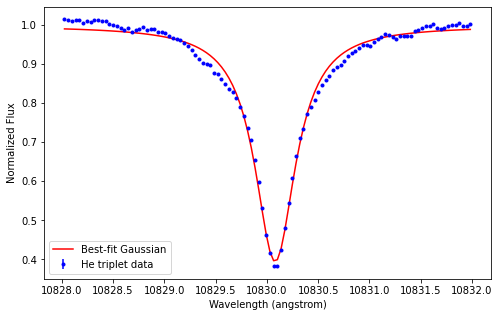

[9.95727741e-01 4.49911653e-01 1.08300802e+04 3.92592552e-07
 2.37358274e-01]


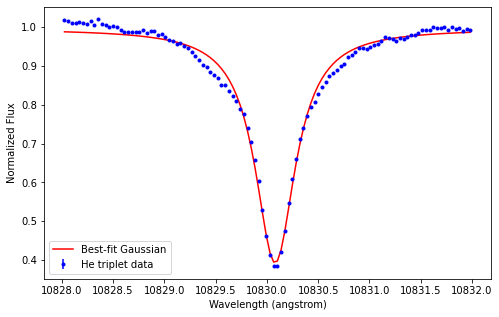

[9.95146633e-01 4.54604087e-01 1.08300796e+04 5.40950372e-06
 2.39865633e-01]


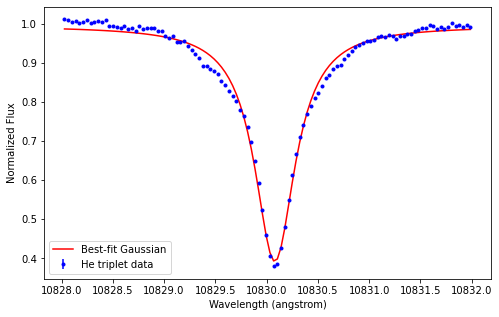

[9.98770656e-01 4.65409808e-01 1.08300804e+04 7.21095162e-06
 2.45383550e-01]


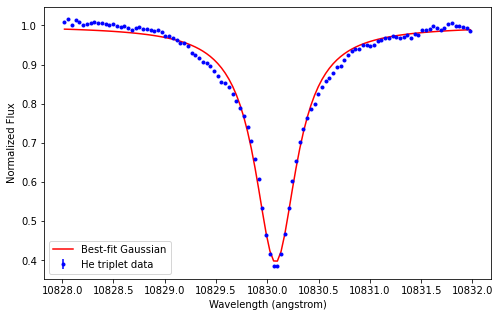

[9.99477311e-01 4.63544739e-01 1.08300801e+04 1.52962159e-05
 2.44460824e-01]


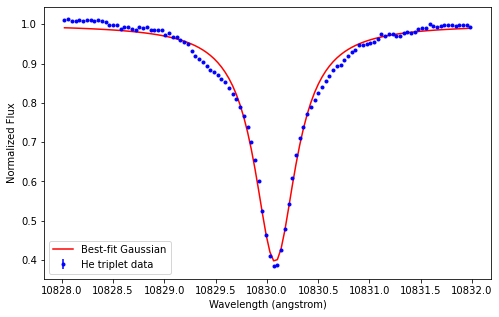

[9.98432913e-01 4.66224730e-01 1.08300788e+04 2.65997626e-05
 2.46995430e-01]


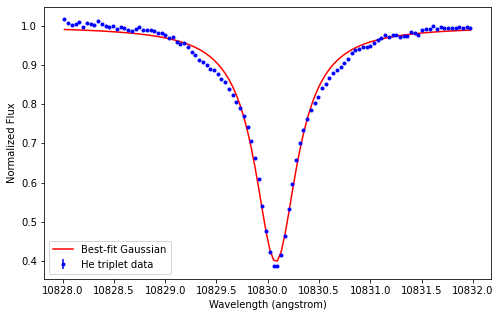

[1.00089669e+00 4.72462497e-01 1.08300811e+04 8.02858239e-06
 2.48826895e-01]


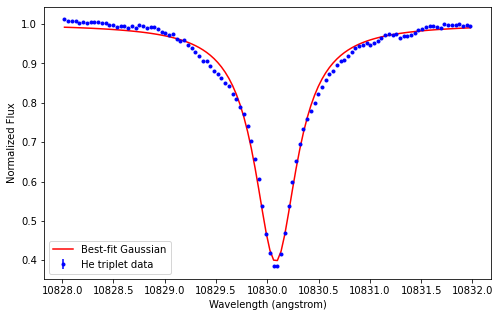

[9.99364516e-01 4.60396300e-01 1.08300790e+04 3.57139335e-07
 2.43008567e-01]


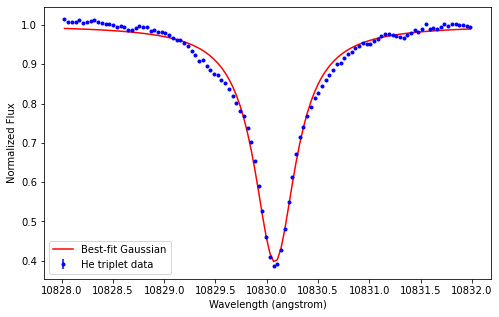

[9.99463840e-01 4.72816685e-01 1.08300793e+04 9.31253649e-05
 2.50985356e-01]


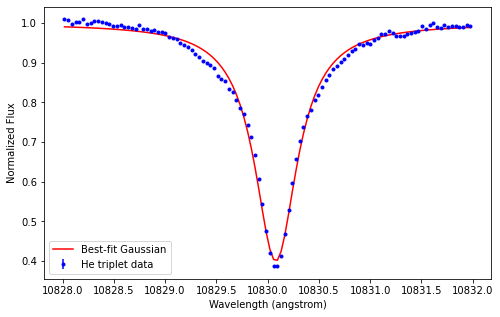

[1.00027865e+00 4.72618758e-01 1.08300799e+04 8.01027873e-06
 2.48111384e-01]


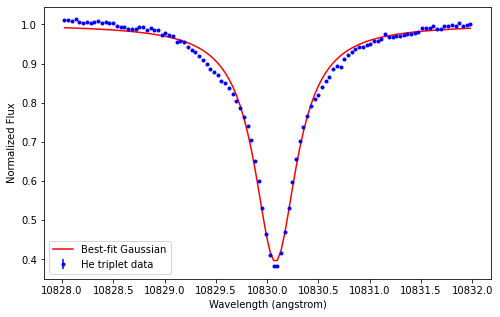

[9.98785595e-01 4.62052318e-01 1.08300807e+04 6.94827147e-06
 2.44313829e-01]


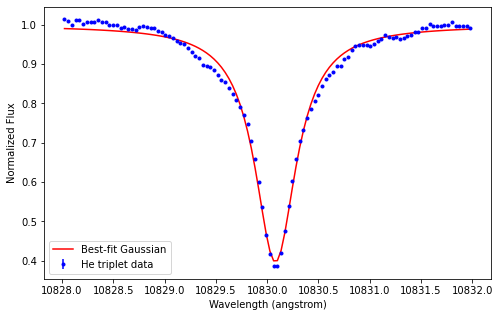

[9.98261797e-01 4.60706051e-01 1.08300802e+04 1.08571794e-05
 2.44034073e-01]


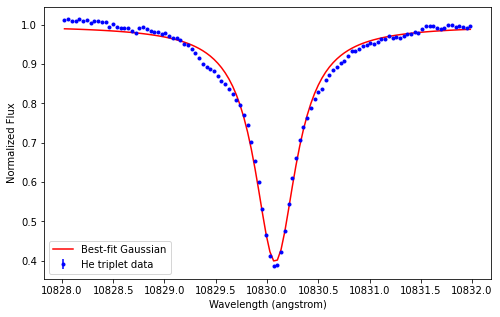

[9.99714646e-01 4.68020349e-01 1.08300801e+04 8.73497602e-05
 2.46249794e-01]


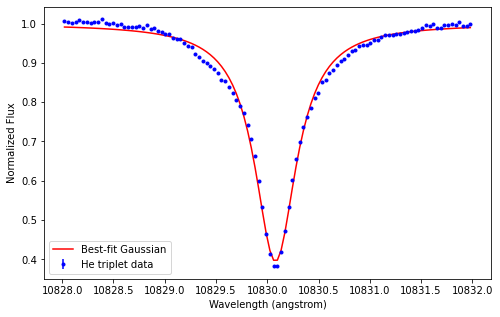

[9.97832712e-01 4.58181413e-01 1.08300814e+04 2.04365277e-06
 2.41313067e-01]


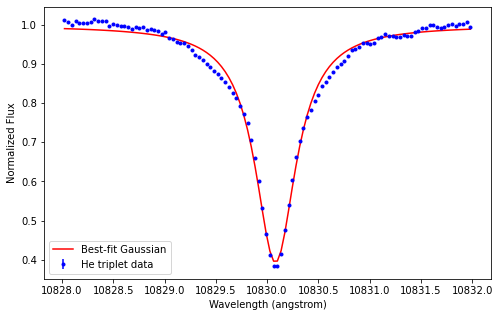

[9.97117943e-01 4.53671985e-01 1.08300806e+04 1.22545416e-05
 2.39593860e-01]


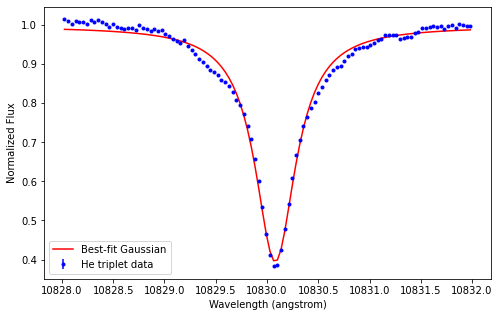

[9.99619449e-01 4.67284552e-01 1.08300807e+04 3.01836732e-04
 2.46408026e-01]


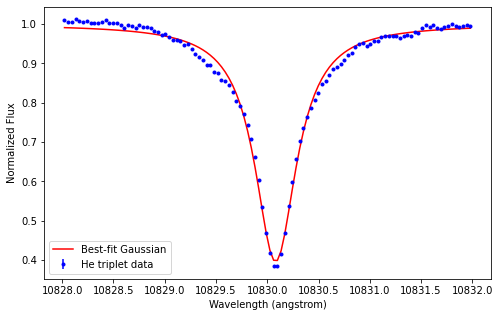

[9.97206073e-01 4.57958350e-01 1.08300799e+04 2.18733744e-05
 2.41389226e-01]


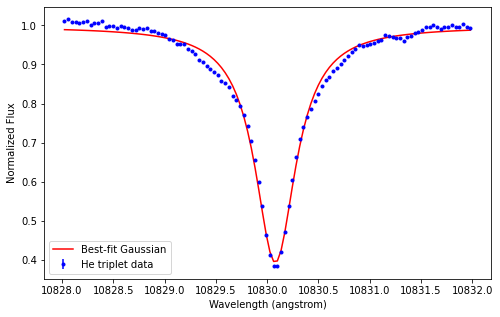

[1.00189602e+00 4.79684859e-01 1.08300789e+04 1.26187896e-06
 2.53859360e-01]


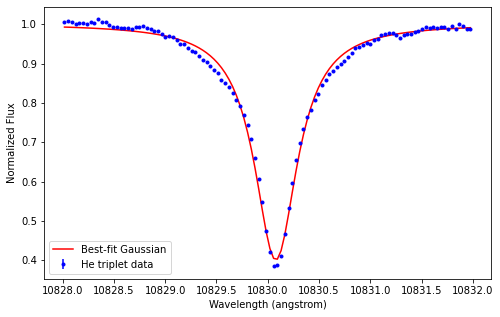

[9.97061515e-01 4.55929569e-01 1.08300804e+04 4.02781941e-06
 2.41699189e-01]


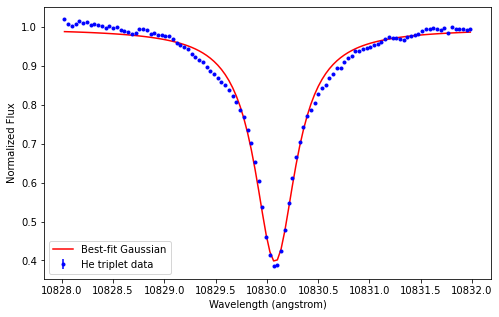

[9.97186716e-01 4.60744264e-01 1.08300788e+04 2.06155873e-06
 2.44424522e-01]


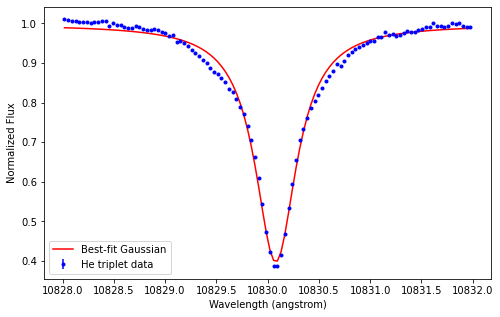

[9.98717345e-01 4.61925458e-01 1.08300804e+04 2.88928733e-05
 2.44675278e-01]


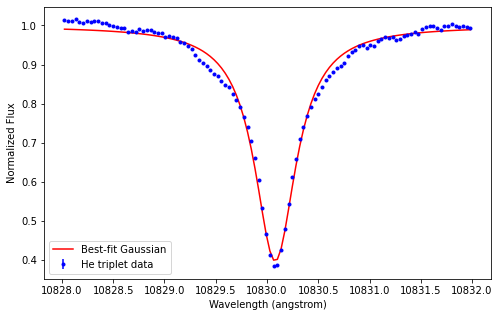

[9.97790800e-01 4.60790501e-01 1.08300814e+04 1.23370418e-05
 2.42405524e-01]


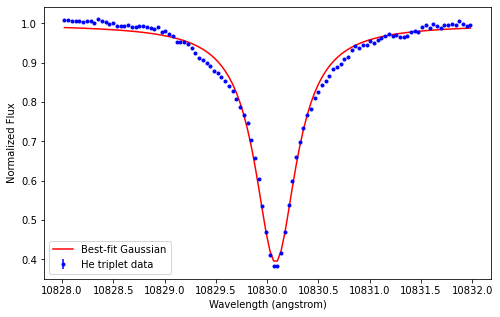

[9.96372578e-01 4.55459681e-01 1.08300802e+04 1.21798862e-05
 2.40628254e-01]


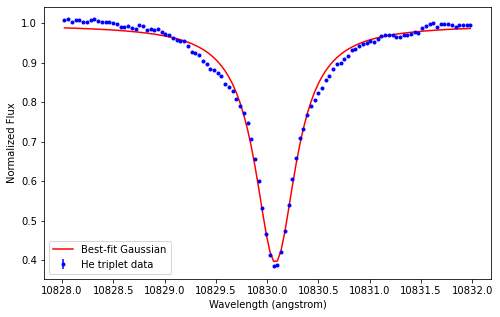

[9.97196690e-01 4.57813026e-01 1.08300804e+04 7.15568991e-06
 2.40842080e-01]


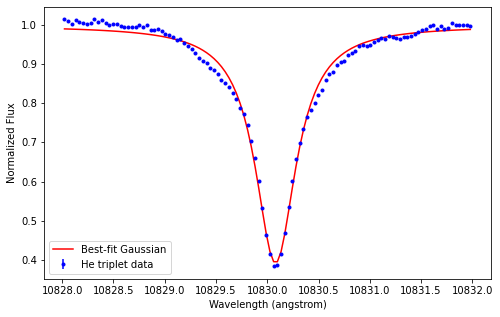

[9.98213270e-01 4.59265902e-01 1.08300796e+04 1.45822804e-05
 2.41861875e-01]


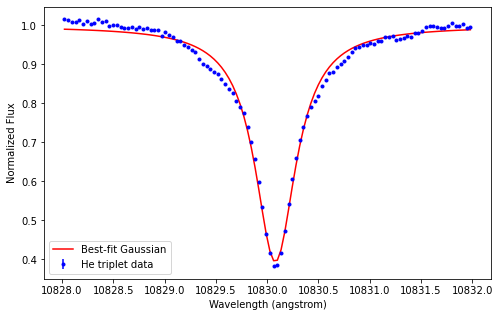

[1.00189386e+00 4.71924675e-01 1.08300800e+04 5.34012816e-04
 2.49053490e-01]


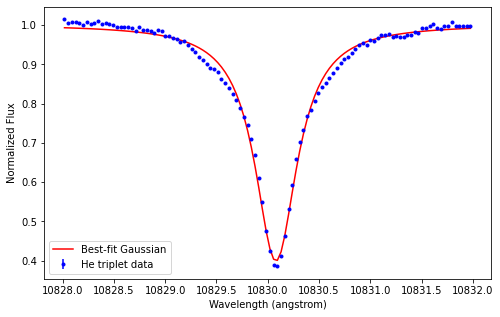

[1.00034588e+00 4.65903898e-01 1.08300800e+04 4.23559306e-05
 2.46427458e-01]


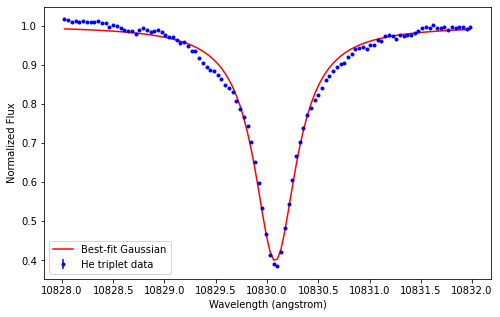

[9.99235363e-01 4.61336869e-01 1.08300798e+04 1.11525127e-05
 2.44225677e-01]


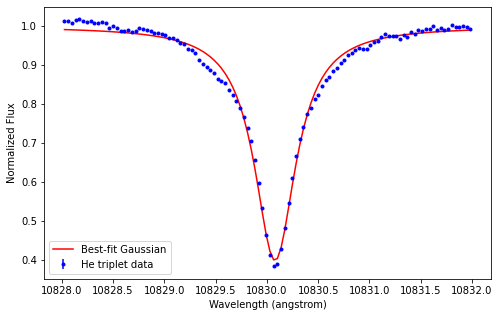

[1.00046589e+00 4.74547988e-01 1.08300790e+04 4.14941623e-05
 2.50673825e-01]


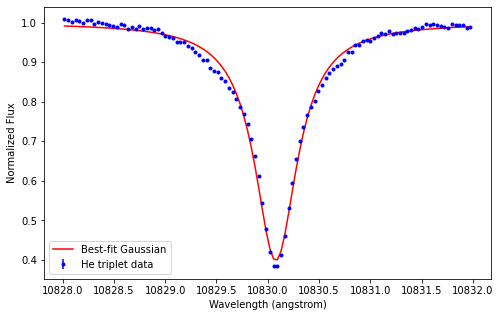

[9.98544795e-01 4.58461795e-01 1.08300799e+04 3.71419075e-06
 2.42086535e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


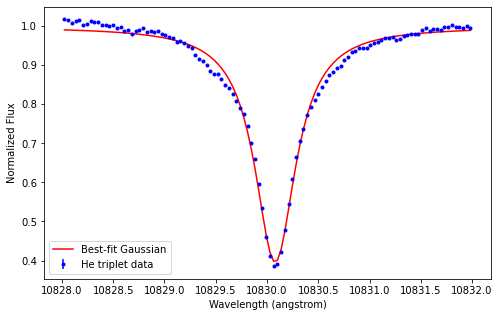

[9.98076138e-01 4.61698478e-01 1.08300799e+04 1.47262203e-05
 2.43499805e-01]


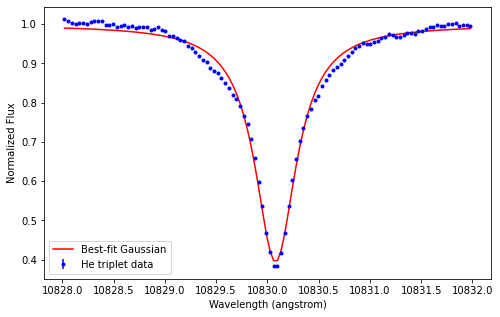

[9.98271555e-01 4.56636900e-01 1.08300803e+04 1.32872048e-05
 2.40206548e-01]


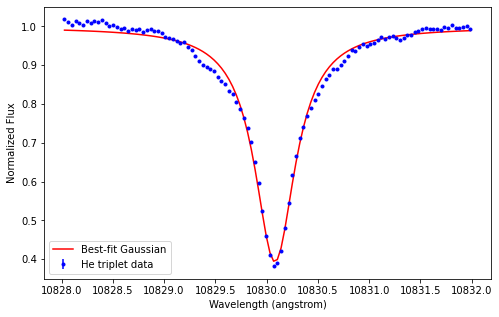

[9.98349507e-01 4.56724704e-01 1.08300793e+04 7.20218395e-06
 2.41005333e-01]


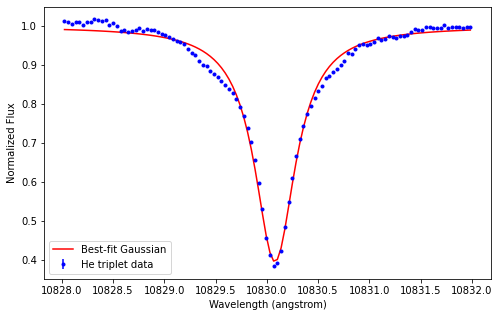

[9.99730508e-01 4.65636962e-01 1.08300800e+04 2.61726432e-05
 2.44921455e-01]


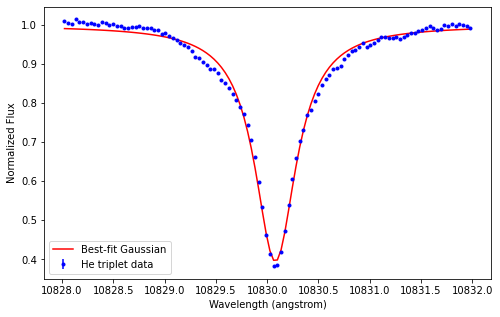

[9.99607797e-01 4.62601618e-01 1.08300791e+04 3.45446947e-04
 2.44377904e-01]


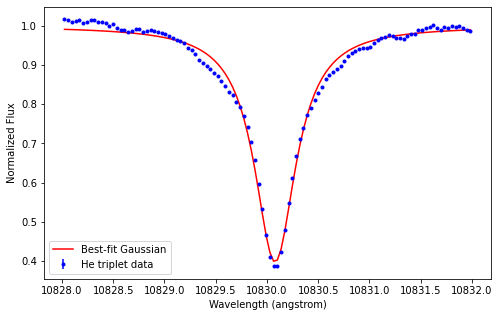

[9.99570962e-01 4.64658269e-01 1.08300800e+04 2.59967254e-05
 2.45784627e-01]


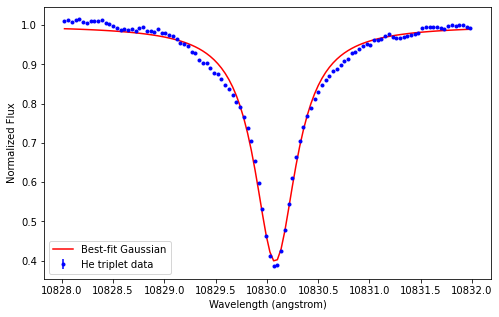

[9.99534203e-01 4.65107930e-01 1.08300792e+04 8.26953079e-06
 2.45762537e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


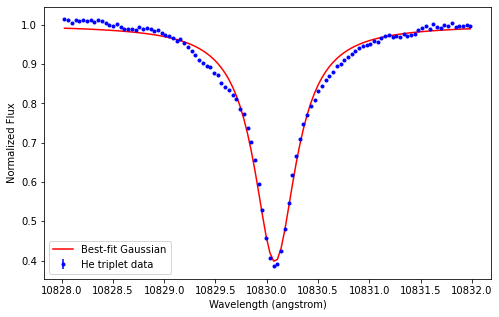

[9.98753797e-01 4.64143458e-01 1.08300810e+04 9.08554548e-05
 2.43785781e-01]


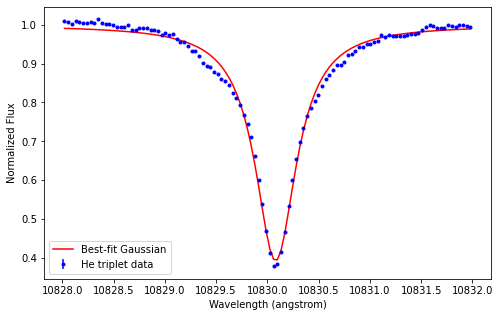

[9.99767592e-01 4.64097933e-01 1.08300800e+04 5.68582456e-06
 2.43495349e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


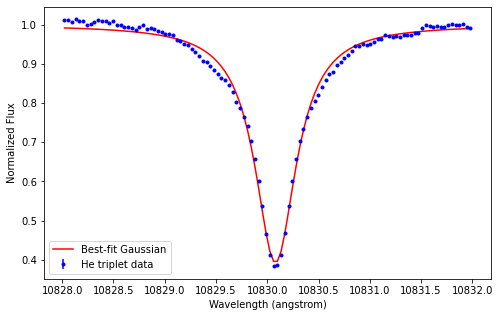

[1.00049050e+00 4.66235599e-01 1.08300803e+04 2.43052720e-07
 2.44882804e-01]


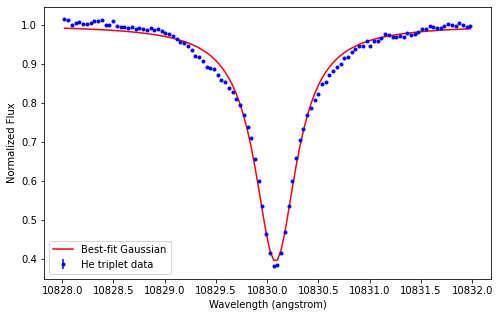

[9.99735528e-01 4.68936522e-01 1.08300788e+04 1.55047107e-05
 2.47484921e-01]


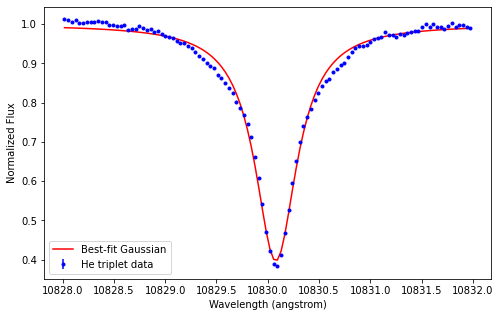

[1.00021844e+00 4.85600155e-01 1.08300780e+04 2.64095805e-05
 2.61415128e-01]


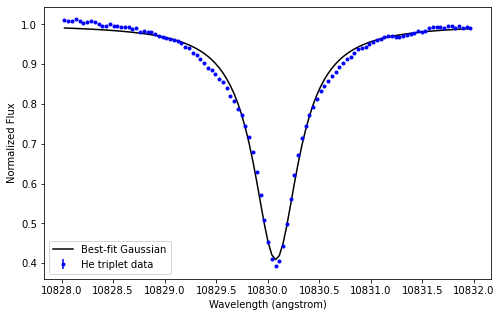

[1.00303769e+00 4.86407836e-01 1.08300776e+04 5.63651320e-06
 2.61212774e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


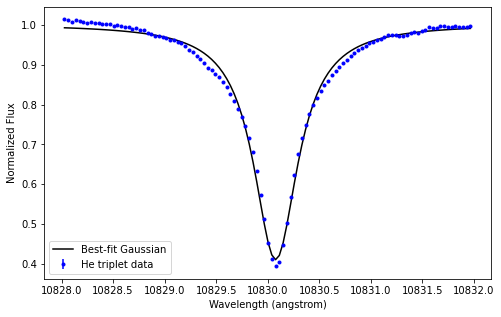

[1.00320386e+00 4.90926282e-01 1.08300776e+04 3.45180300e-04
 2.64587413e-01]


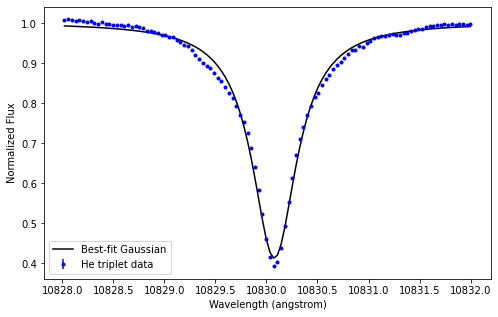

[1.00269430e+00 4.93080014e-01 1.08300773e+04 1.29557700e-03
 2.65978016e-01]


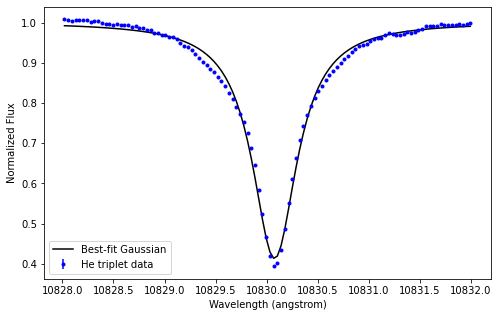

[1.00128995e+00 4.83721363e-01 1.08300783e+04 1.24903236e-04
 2.59983847e-01]


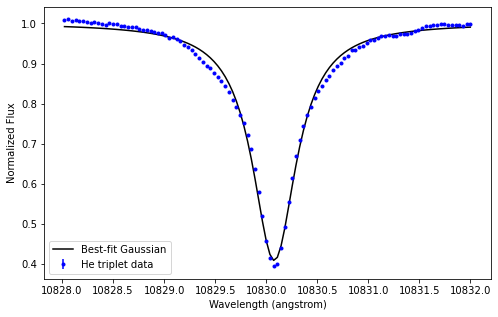

[9.98424867e-01 4.84347443e-01 1.08300785e+04 9.93246567e-05
 2.60844019e-01]


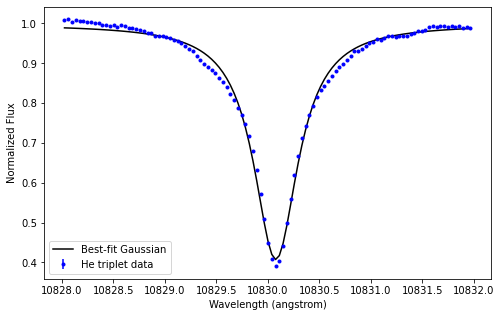

[1.00101323e+00 4.82857778e-01 1.08300775e+04 7.82896815e-04
 2.59795130e-01]


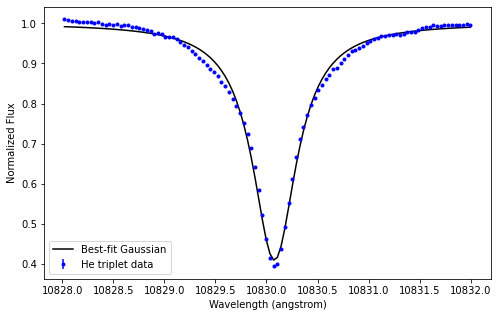

[9.98126663e-01 4.83723538e-01 1.08300784e+04 1.95276744e-06
 2.61165249e-01]


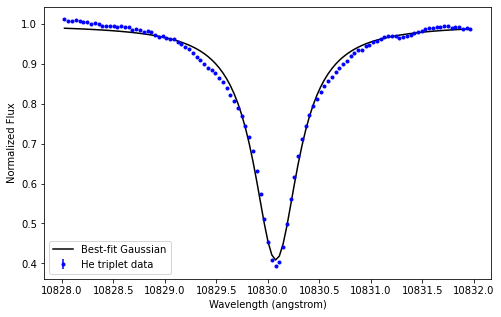

[9.99257597e-01 4.83627287e-01 1.08300781e+04 5.84519594e-06
 2.60647408e-01]


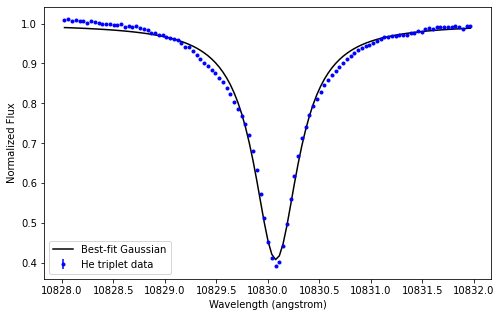

[1.00031495e+00 4.89071655e-01 1.08300782e+04 1.25466967e-03
 2.62903121e-01]


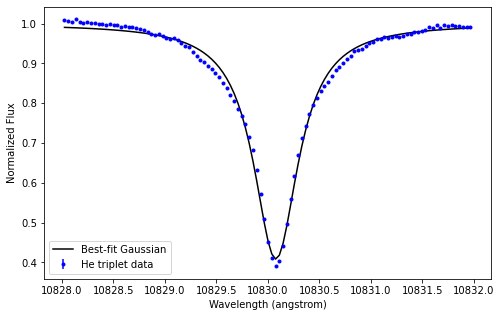

[9.98926750e-01 4.91400200e-01 1.08300772e+04 1.36098498e-04
 2.65994780e-01]


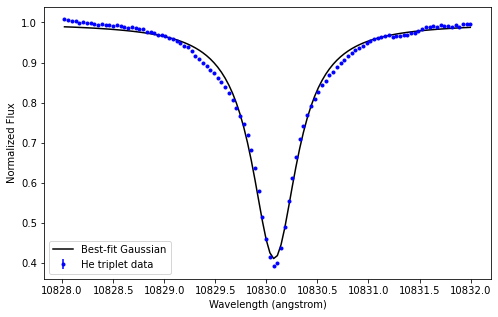

[1.00203608e+00 4.90276146e-01 1.08300774e+04 1.60730987e-04
 2.64030856e-01]


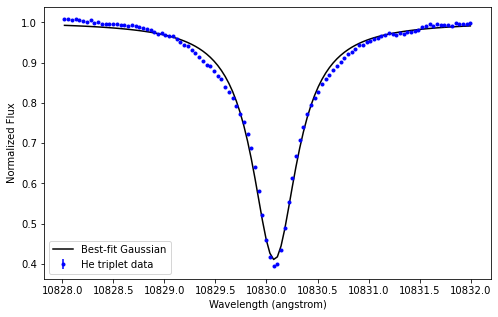

[1.00497164e+00 4.88389858e-01 1.08300779e+04 2.93125653e-05
 2.62313458e-01]


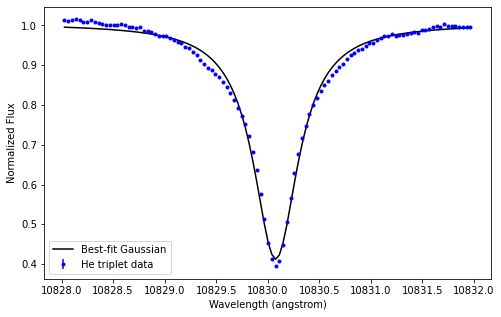

[9.98702713e-01 4.75233234e-01 1.08300783e+04 3.49744597e-06
 2.55703506e-01]


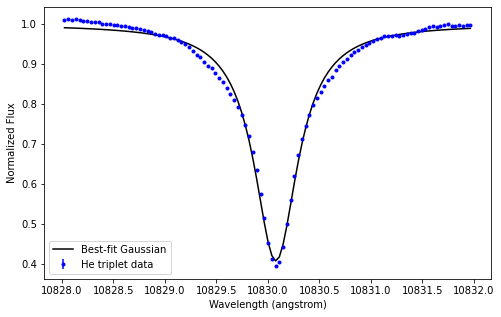

[1.00459407e+00 4.90581080e-01 1.08300768e+04 4.35515551e-04
 2.63709439e-01]


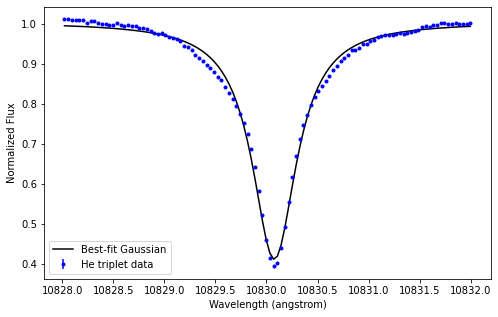

[1.00367171e+00 4.87888047e-01 1.08300775e+04 1.05855564e-03
 2.62245434e-01]


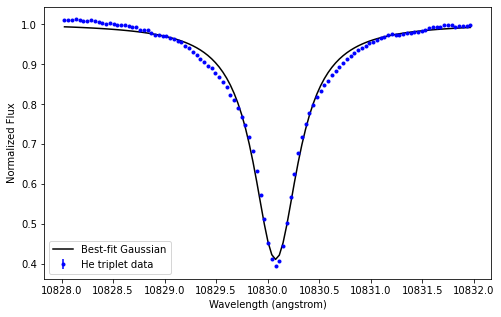

[9.99285298e-01 4.82899756e-01 1.08300784e+04 3.99994759e-05
 2.60051898e-01]


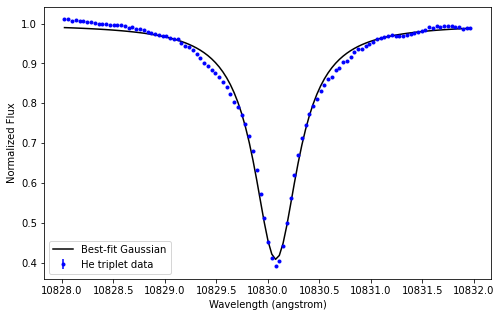

[1.00082430e+00 4.84604466e-01 1.08300781e+04 1.25670451e-04
 2.60364291e-01]


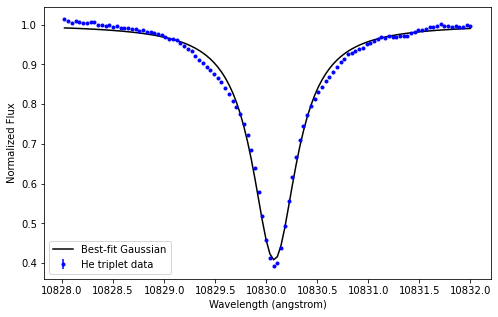

[9.98085661e-01 4.82950413e-01 1.08300777e+04 1.33251050e-04
 2.60515205e-01]


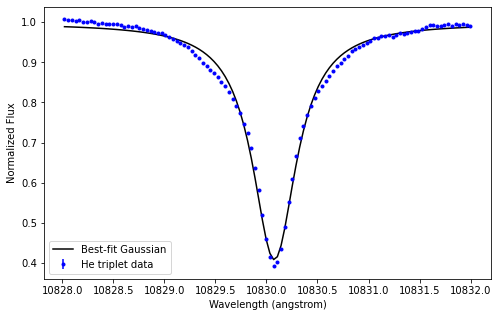

[1.00258476e+00 4.86921922e-01 1.08300785e+04 1.07589718e-04
 2.61483501e-01]


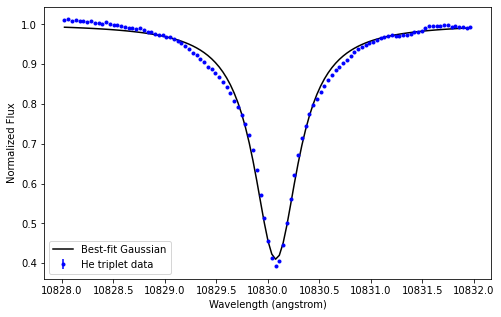

[1.00308141e+00 4.89435518e-01 1.08300779e+04 3.30769517e-05
 2.62277227e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


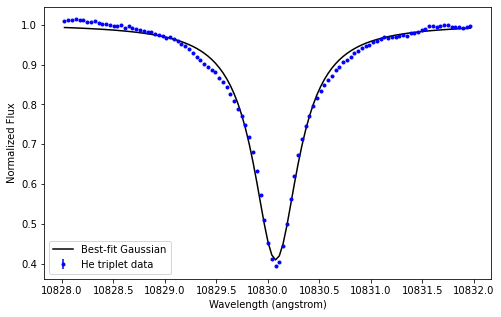

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


[1.00245732e+00 4.87387175e-01 1.08300773e+04 1.14446566e-03
 2.62021835e-01]


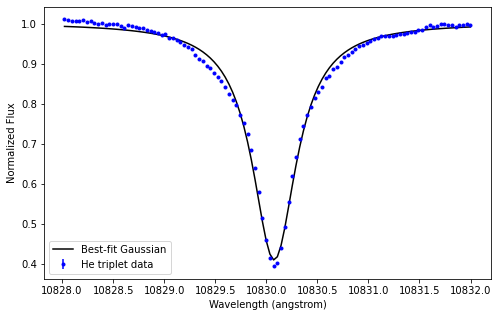

[1.00248589e+00 4.81086459e-01 1.08300778e+04 6.93238179e-06
 2.58245265e-01]


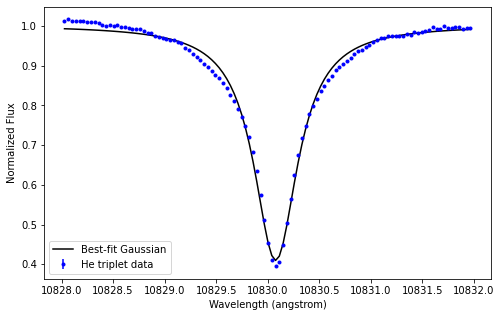

[1.00083601e+00 4.85328950e-01 1.08300777e+04 4.24371464e-05
 2.61103891e-01]


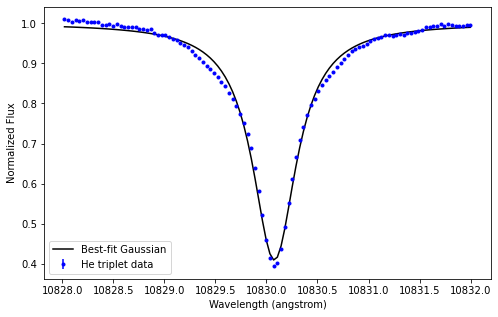

[1.00201027e+00 4.86235085e-01 1.08300782e+04 1.47402787e-05
 2.61504523e-01]


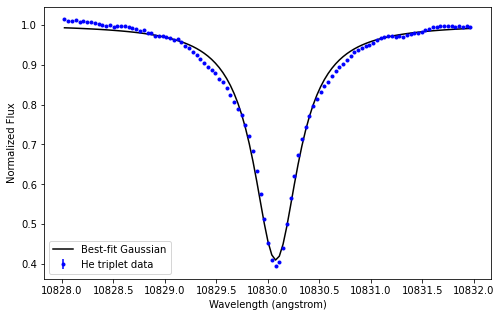

[1.00192109e+00 4.85221724e-01 1.08300785e+04 3.18080243e-05
 2.60595763e-01]


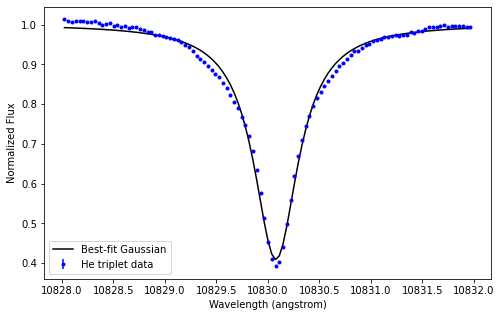

[9.99031798e-01 4.82889158e-01 1.08300771e+04 4.98851942e-04
 2.60223631e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


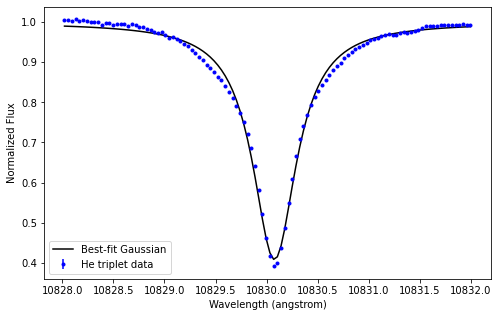

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


[9.99345092e-01 4.83730276e-01 1.08300770e+04 1.83366167e-04
 2.60704976e-01]


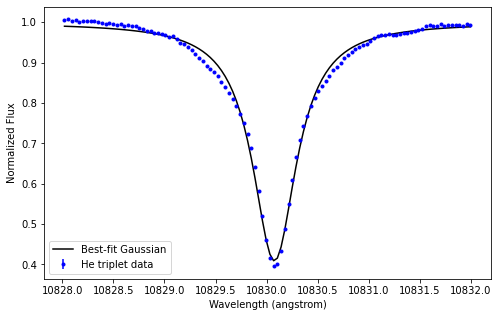

[1.00021675e+00 4.79430490e-01 1.08300781e+04 3.95236017e-06
 2.57471124e-01]


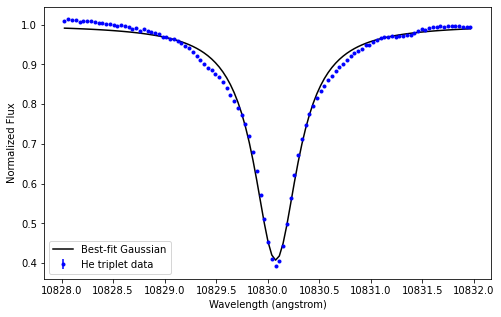

[9.98336874e-01 4.95592985e-01 1.08300770e+04 3.63512900e-06
 2.68894132e-01]


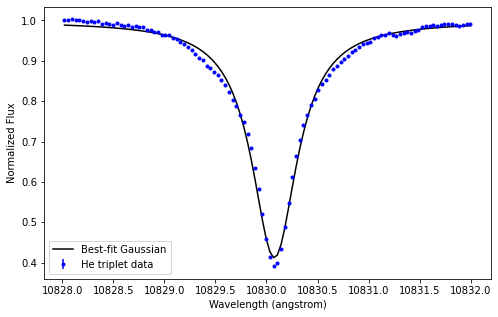

[1.00584437e+00 4.90323596e-01 1.08300771e+04 5.98600630e-05
 2.62823710e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


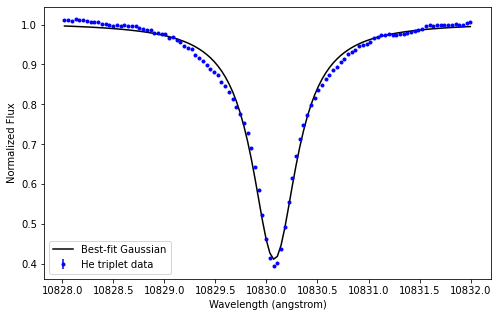

[1.00255675e+00 4.92018967e-01 1.08300774e+04 4.28086461e-05
 2.65415537e-01]


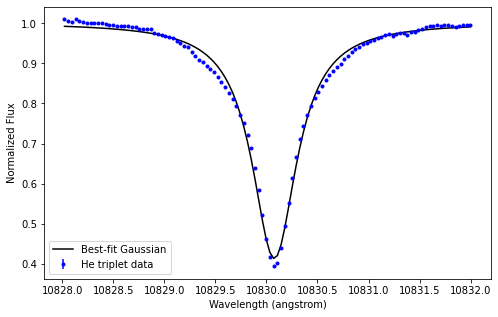

[1.00088601e+00 4.86577736e-01 1.08300778e+04 1.07636286e-05
 2.61986099e-01]


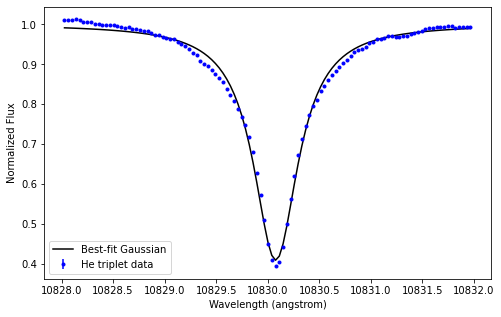

[1.00345425e+00 4.90482345e-01 1.08300782e+04 1.30443299e-04
 2.63709513e-01]


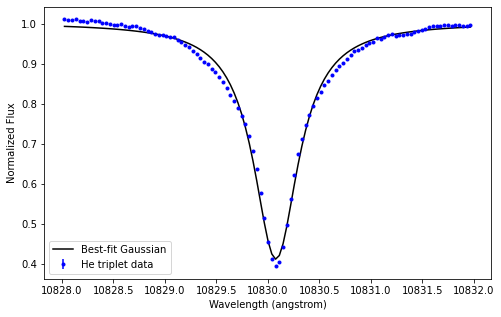

[9.97714776e-01 4.85121027e-01 1.08300772e+04 2.79293855e-03
 2.62269037e-01]


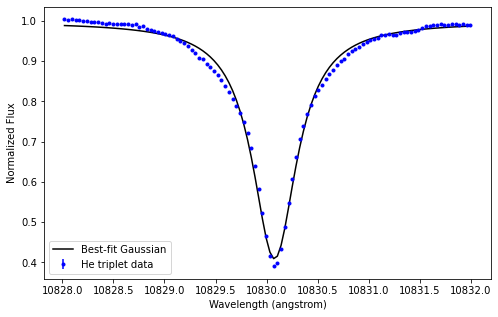

[9.98027389e-01 4.84257225e-01 1.08300781e+04 4.13894039e-06
 2.61184565e-01]


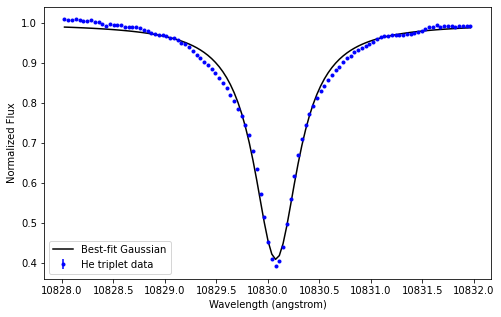

[9.98472957e-01 4.85139500e-01 1.08300787e+04 5.81531185e-04
 2.61253930e-01]


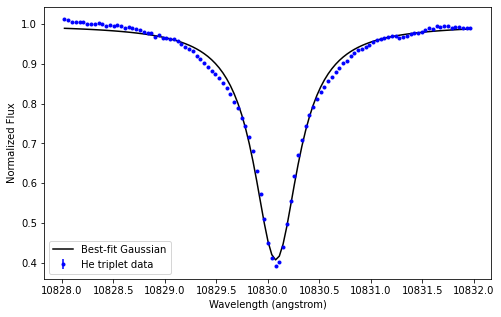

[9.97670124e-01 4.82551762e-01 1.08300772e+04 1.08206055e-04
 2.60212822e-01]


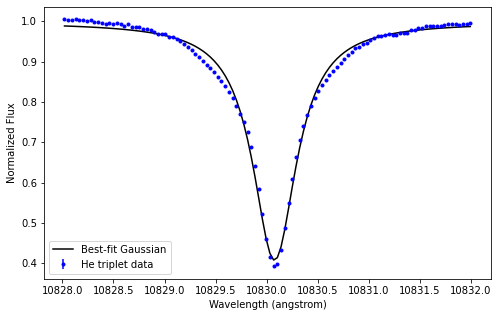

[9.98944038e-01 4.81664168e-01 1.08300778e+04 3.09210972e-04
 2.59371855e-01]


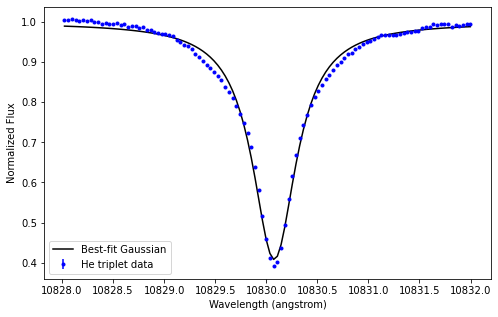

[1.00248351e+00 4.89409027e-01 1.08300783e+04 1.16918771e-03
 2.63343898e-01]


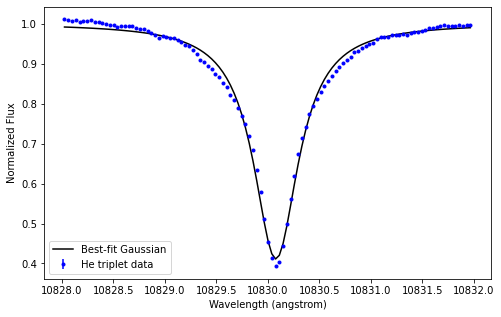

[1.00308362e+00 4.86106105e-01 1.08300783e+04 8.46294596e-05
 2.60815763e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


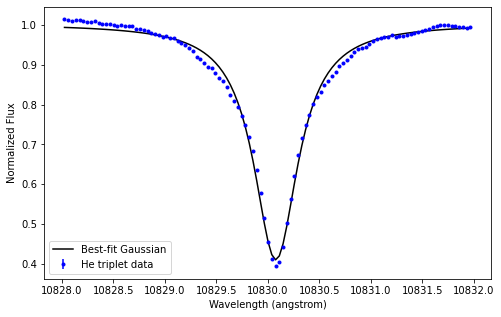

[1.00040838e+00 4.84241922e-01 1.08300778e+04 2.26151815e-04
 2.60392220e-01]


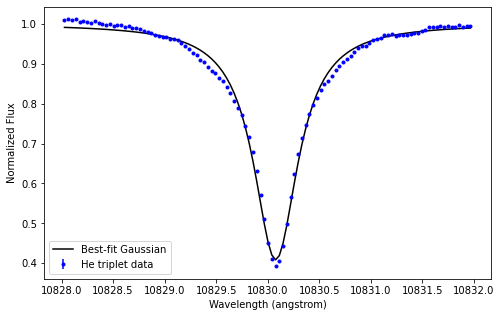

[9.99521523e-01 4.83297008e-01 1.08300784e+04 2.24286479e-05
 2.60110284e-01]


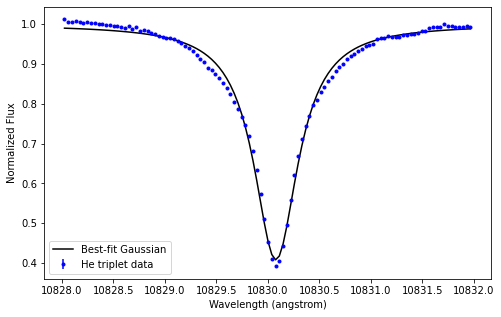

[1.00178813e+00 4.86494467e-01 1.08300770e+04 8.53137202e-05
 2.61251816e-01]


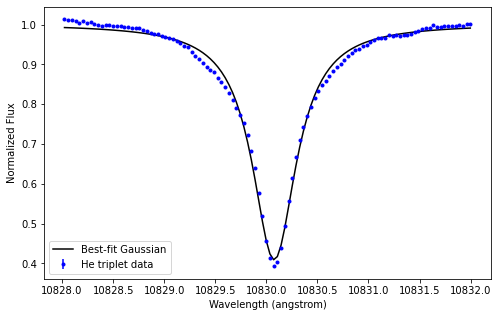

[9.96591739e-01 4.80664145e-01 1.08300770e+04 2.02220061e-04
 2.59144656e-01]


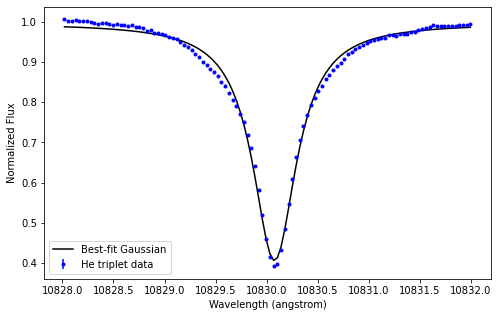

[1.00145966e+00 4.85290143e-01 1.08300777e+04 7.70519718e-05
 2.61125105e-01]


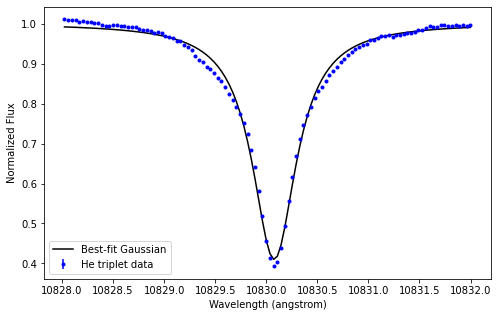

[1.00146968e+00 4.83632120e-01 1.08300777e+04 6.62504266e-06
 2.60167872e-01]


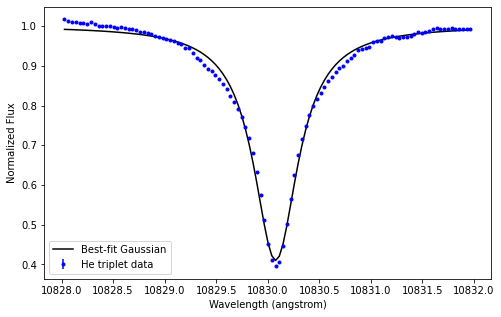

[1.00008780e+00 4.85403053e-01 1.08300781e+04 3.14514744e-05
 2.61479814e-01]


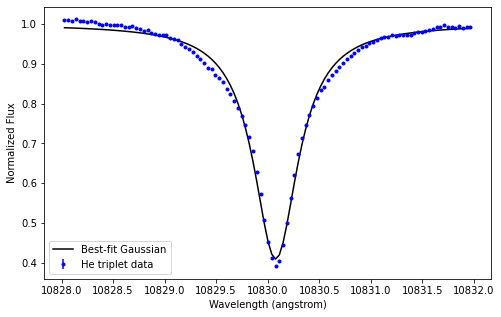

[1.00194063e+00 4.88868894e-01 1.08300776e+04 5.89890186e-05
 2.63661383e-01]


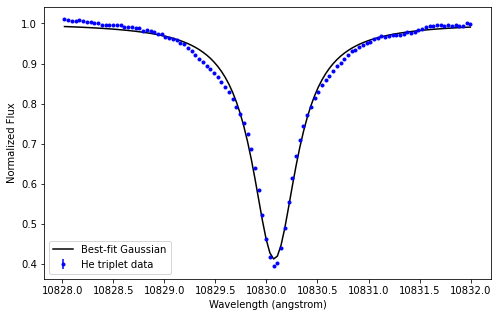

[1.00158459e+00 4.84253192e-01 1.08300769e+04 3.95041276e-04
 2.60325432e-01]


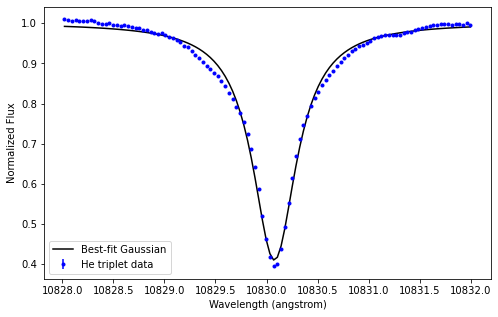

[1.00524111e+00 4.92684114e-01 1.08300772e+04 2.99756541e-05
 2.64017555e-01]


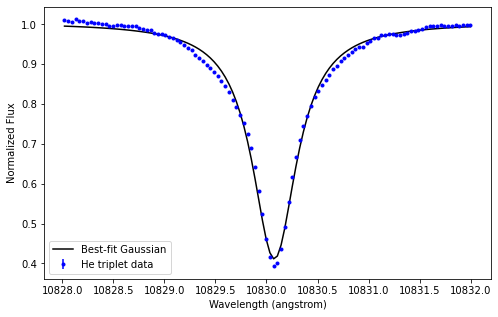

[1.00378993e+00 4.94829384e-01 1.08300774e+04 1.51352158e-04
 2.66271306e-01]


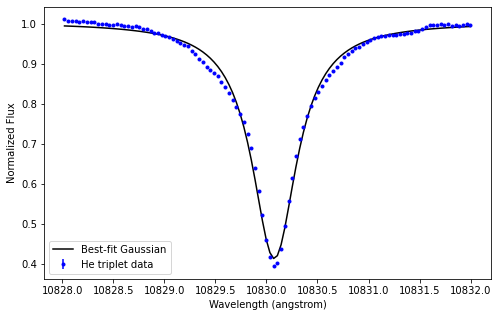

[1.00317541e+00 4.89643666e-01 1.08300772e+04 1.68211729e-03
 2.63682524e-01]


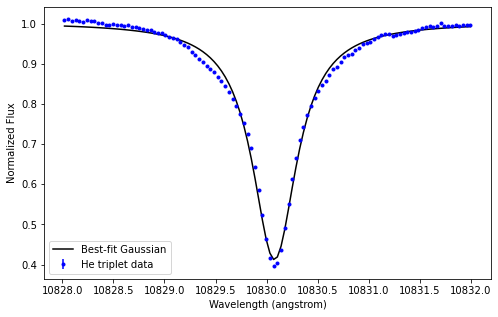

[9.98269475e-01 4.82820236e-01 1.08300783e+04 5.27891214e-06
 2.60260408e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


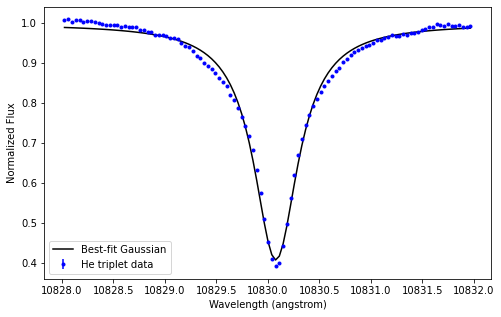

[1.00089518e+00 4.87731182e-01 1.08300789e+04 1.20494161e-04
 2.62620630e-01]


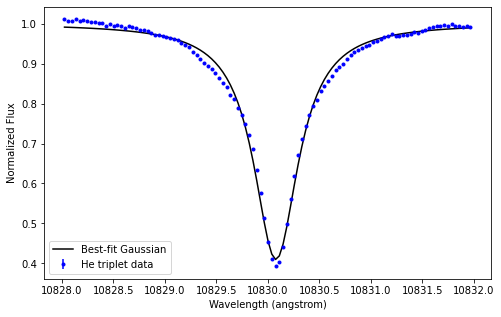

[1.00190082e+00 4.86163016e-01 1.08300785e+04 3.59248633e-04
 2.61362018e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


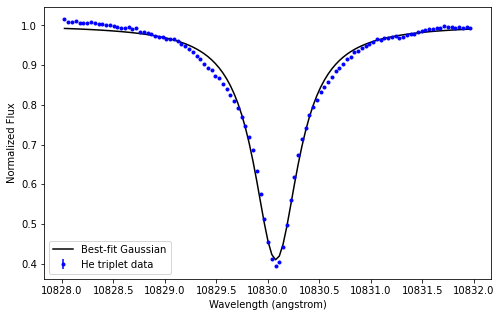

[1.00048402e+00 4.86192678e-01 1.08300778e+04 2.40297143e-05
 2.61918983e-01]


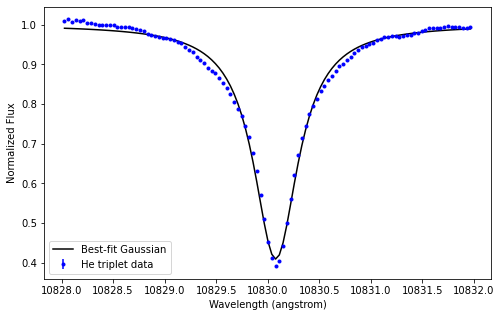

[9.98092171e-01 4.86545781e-01 1.08300780e+04 8.82506827e-06
 2.62743604e-01]


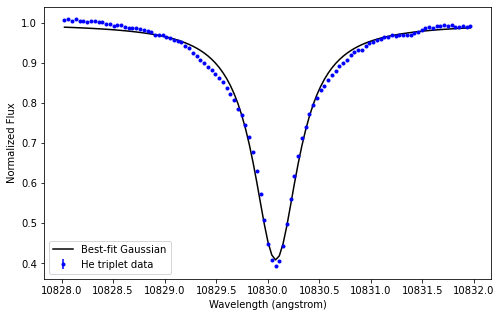

[1.00255425e+00 4.88309536e-01 1.08300780e+04 1.44140983e-03
 2.63069554e-01]


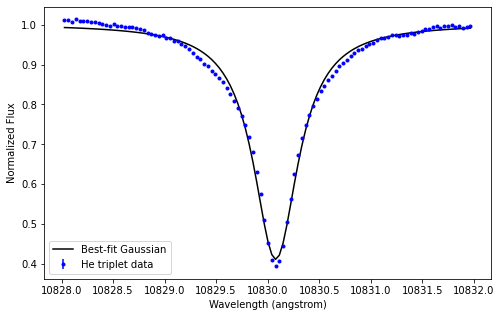

[1.00444945e+00 4.88611078e-01 1.08300775e+04 7.16034939e-05
 2.61728392e-01]


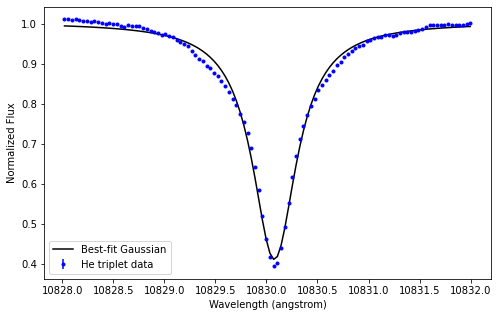

[1.00132452e+00 4.87187996e-01 1.08300782e+04 2.83085571e-06
 2.62039932e-01]


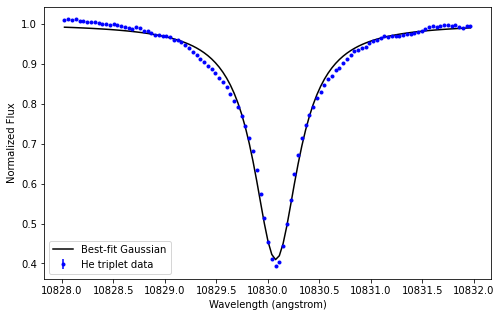

[9.99689333e-01 4.83459454e-01 1.08300782e+04 1.57364357e-05
 2.60388124e-01]


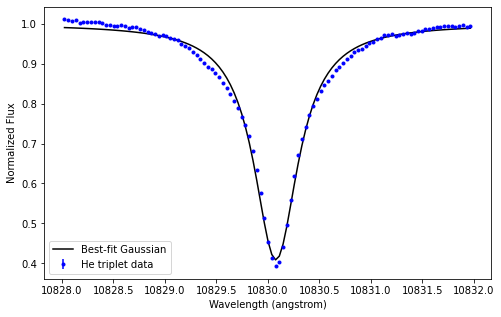

[9.98288452e-01 4.80412368e-01 1.08300786e+04 1.11358529e-05
 2.58683403e-01]


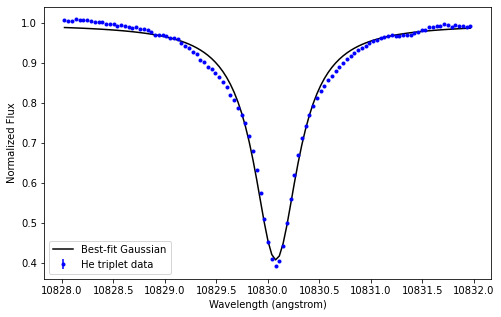

[1.00099342e+00 4.84572765e-01 1.08300782e+04 1.11040388e-05
 2.60524286e-01]


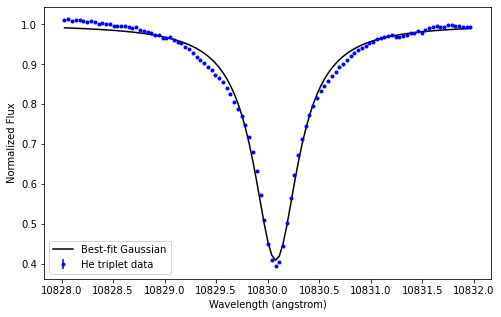

[9.99016165e-01 4.82581607e-01 1.08300770e+04 8.63393046e-04
 2.60180772e-01]


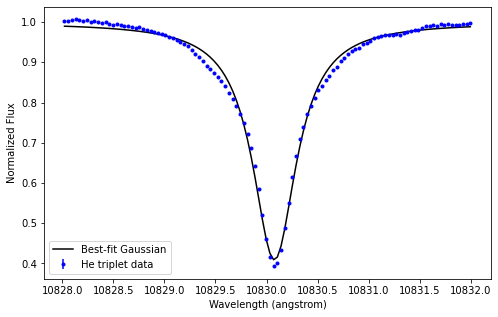

[1.00458094e+00 4.86313029e-01 1.08300780e+04 1.78867130e-04
 2.59767851e-01]


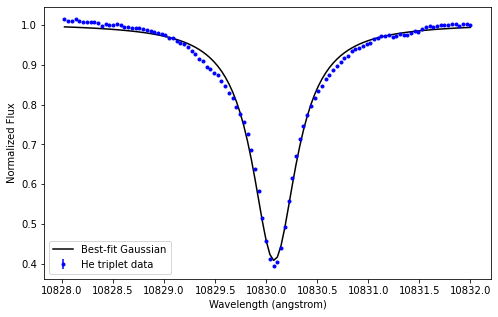

[1.00168925e+00 4.90771145e-01 1.08300776e+04 3.70874562e-05
 2.64874005e-01]


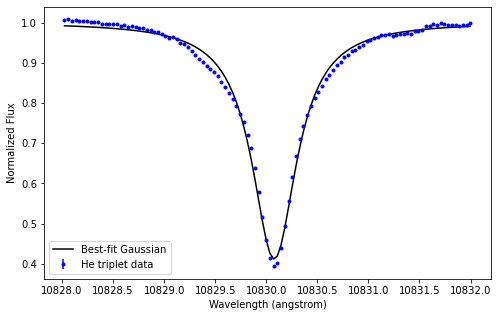

[1.00515425e+00 4.93462607e-01 1.08300775e+04 5.68405920e-05
 2.65290216e-01]


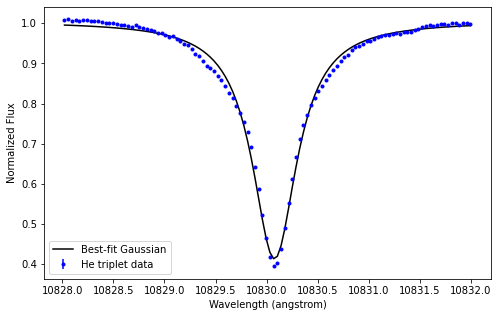

[1.00018182e+00 4.84336738e-01 1.08300779e+04 4.99043070e-06
 2.60605389e-01]


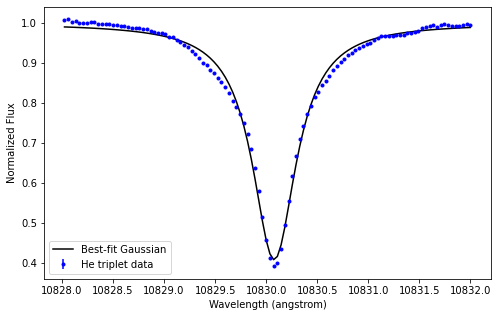

[9.97102143e-01 4.85825941e-01 1.08300781e+04 3.38180333e-05
 2.62311599e-01]


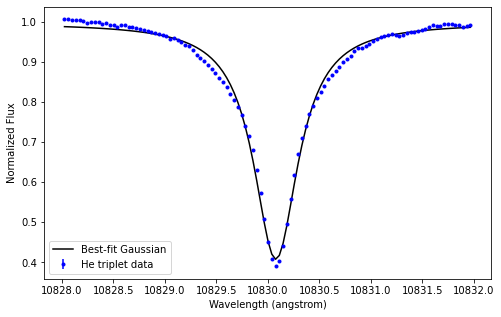

[1.00102409e+00 4.83757174e-01 1.08300781e+04 2.43468813e-05
 2.59829667e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


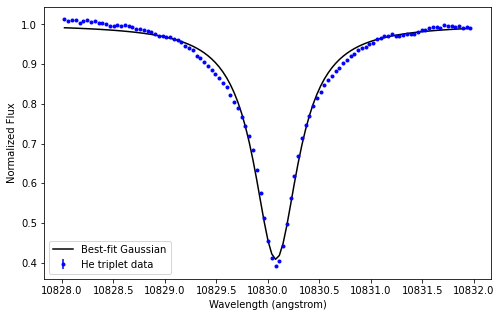

[1.00546931e+00 5.11298076e-01 1.08300772e+04 5.83870037e-06
 2.77482409e-01]


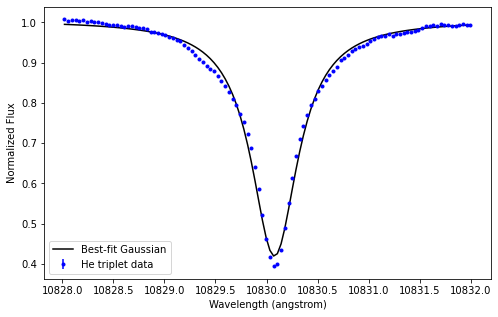

[1.00206249e+00 4.96996477e-01 1.08300772e+04 1.61228210e-05
 2.68895876e-01]


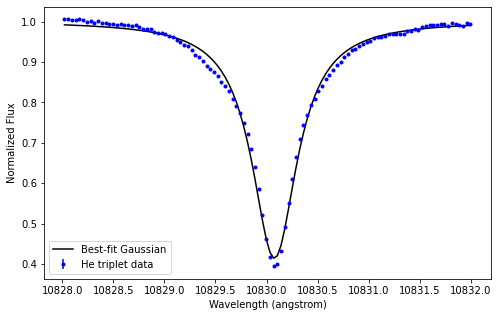

[1.00104719e+00 4.87879491e-01 1.08300785e+04 1.02156096e-04
 2.62361397e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


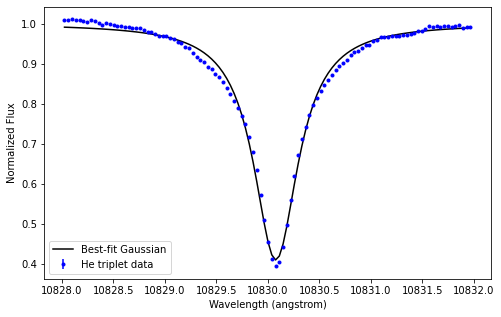

[9.99709456e-01 4.84509217e-01 1.08300772e+04 1.77136299e-05
 2.61191614e-01]


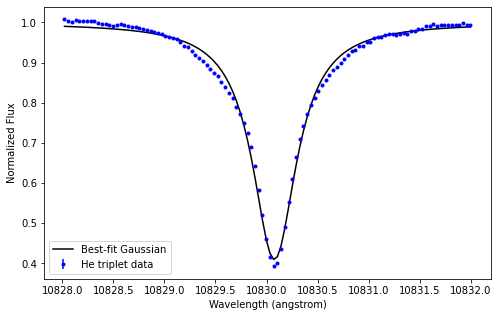

[1.00291968e+00 4.90592567e-01 1.08300773e+04 5.40919934e-05
 2.64259560e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


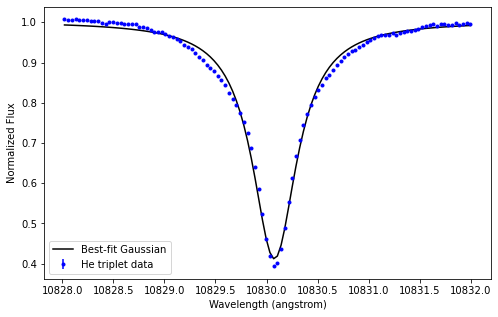

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


[1.00505969e+00 4.95964339e-01 1.08300778e+04 1.57902466e-03
 2.66713552e-01]


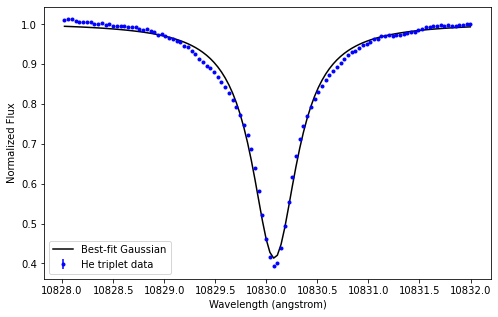

[9.98954952e-01 4.82299948e-01 1.08300768e+04 4.03519046e-05
 2.59542011e-01]


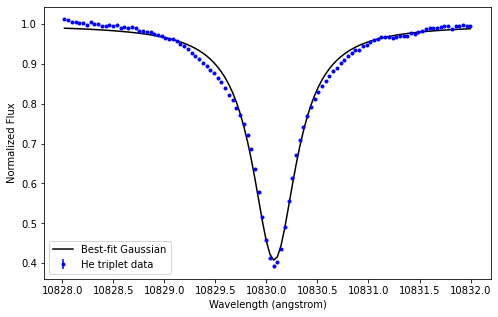

[1.00020798e+00 4.82386491e-01 1.08300777e+04 3.58563630e-04
 2.59364899e-01]


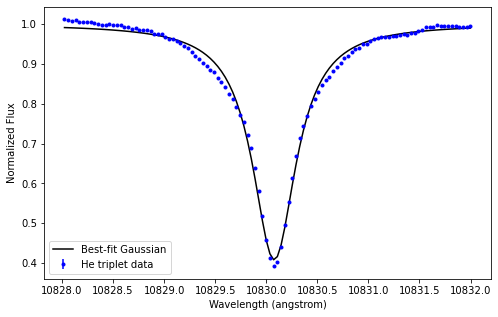

[1.00086776e+00 4.82778685e-01 1.08300779e+04 6.20204959e-04
 2.59793919e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


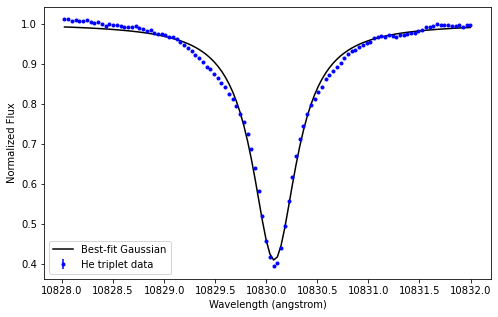

[1.00079351e+00 4.84210619e-01 1.08300783e+04 3.70520895e-06
 2.60087566e-01]


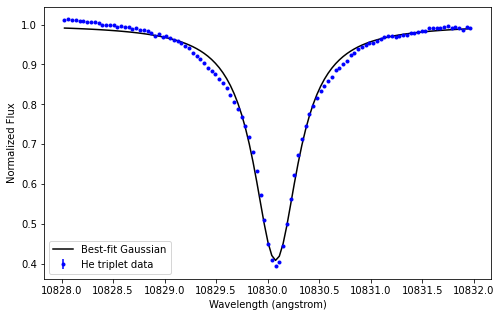

[9.99323181e-01 4.88159569e-01 1.08300769e+04 2.96842802e-04
 2.63543719e-01]


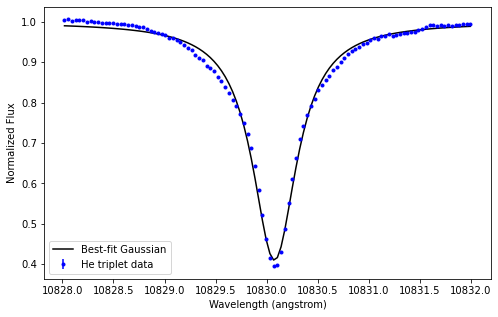

[1.00151132e+00 4.84561953e-01 1.08300783e+04 1.97635843e-04
 2.60311781e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


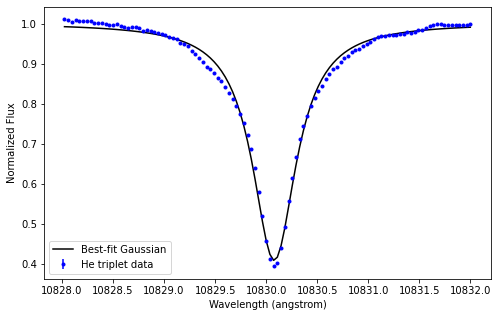

[1.00321372e+00 4.87017678e-01 1.08300776e+04 3.49816107e-05
 2.61279279e-01]


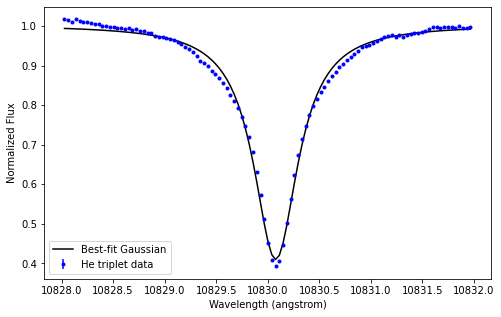

[1.00438683e+00 4.90390965e-01 1.08300773e+04 3.27141632e-05
 2.63872254e-01]


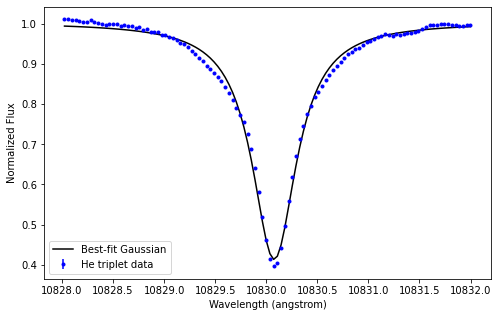

[9.99999409e-01 4.86063714e-01 1.08300769e+04 5.44090510e-04
 2.61785516e-01]


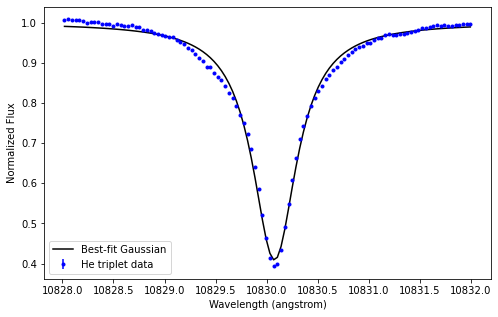

[1.00210219e+00 4.86514309e-01 1.08300782e+04 1.53644551e-05
 2.61538830e-01]


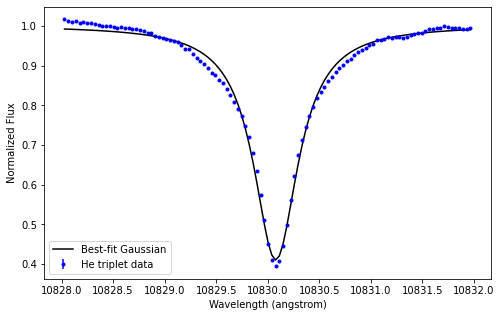

[9.98269545e-01 4.82255045e-01 1.08300772e+04 6.30287767e-04
 2.59882779e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


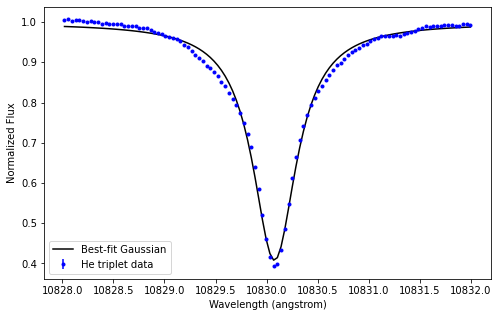

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


[1.00427471e+00 4.90715355e-01 1.08300775e+04 2.08679178e-03
 2.63914557e-01]


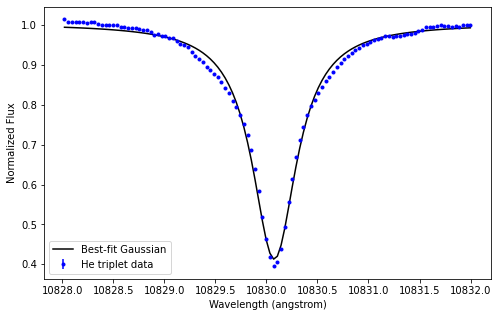

[9.99496542e-01 4.84910349e-01 1.08300784e+04 2.12984500e-05
 2.61479859e-01]


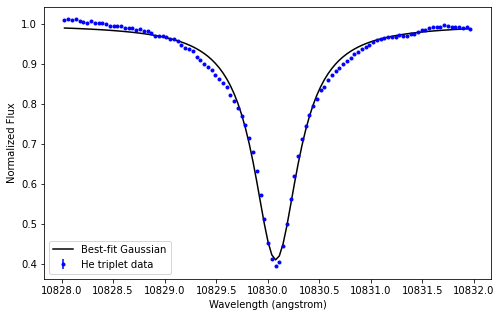

[1.00054026e+00 4.82043614e-01 1.08300785e+04 6.13255219e-06
 2.59494051e-01]


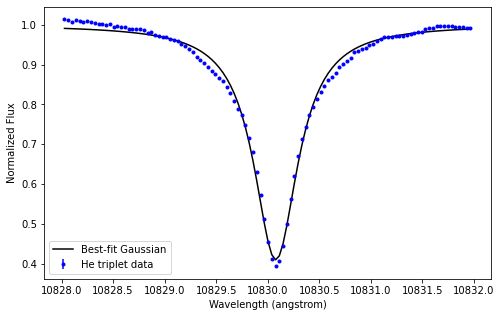

[1.00043689e+00 4.83389069e-01 1.08300782e+04 1.01587767e-03
 2.59682121e-01]


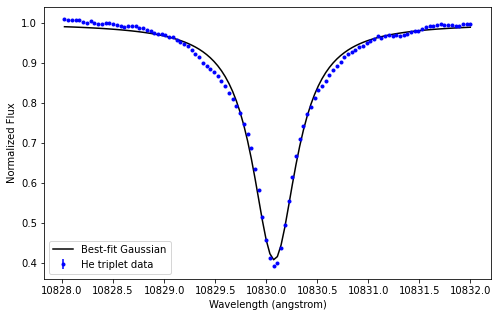

[1.00239883e+00 4.86889398e-01 1.08300780e+04 6.35589184e-06
 2.61899951e-01]


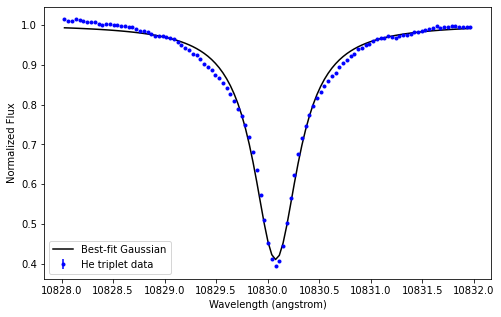

[9.99849778e-01 4.82469553e-01 1.08300776e+04 6.29773409e-05
 2.60299992e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


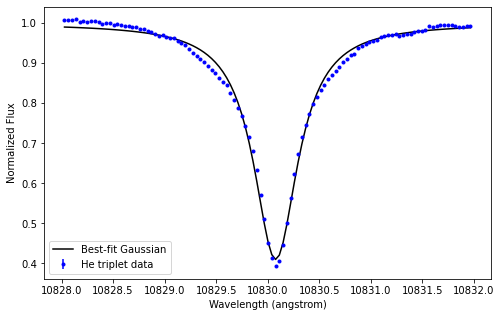

[1.00088938e+00 4.84684347e-01 1.08300784e+04 1.35754819e-05
 2.60661052e-01]


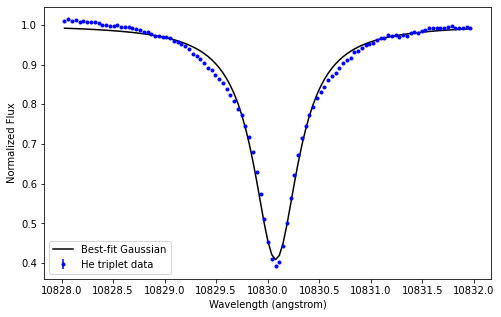

[1.00048622e+00 4.75523456e-01 1.08300780e+04 1.39096861e-07
 2.55738318e-01]


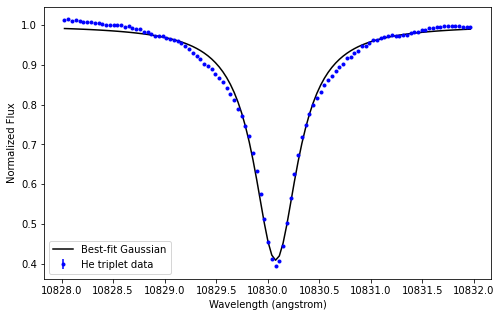

[1.00386127e+00 4.88344132e-01 1.08300782e+04 2.92191991e-04
 2.61958450e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


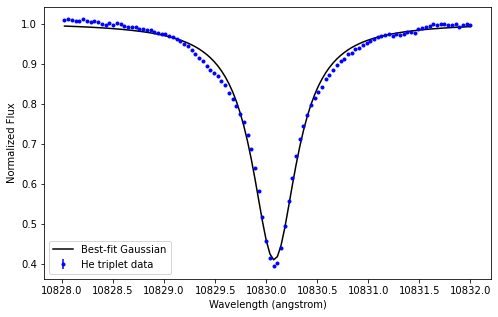

[1.00364910e+00 4.83921130e-01 1.08300781e+04 7.25991222e-04
 2.59030711e-01]


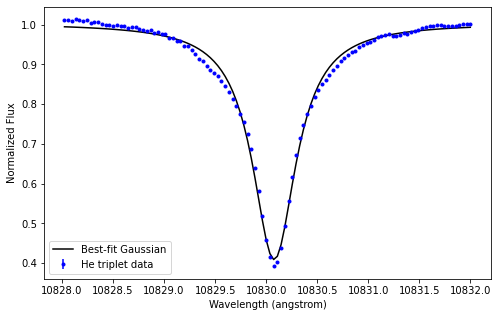

[1.00405419e+00 4.85112570e-01 1.08300778e+04 1.29273262e-04
 2.61192042e-01]


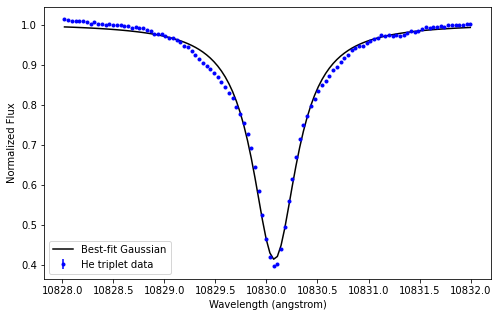

[9.99345522e-01 4.81736865e-01 1.08300776e+04 4.65569762e-05
 2.59195042e-01]


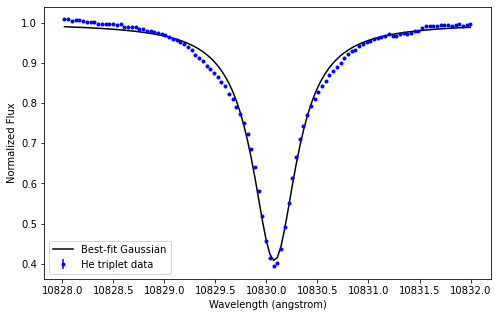

[1.00185454e+00 4.89305898e-01 1.08300780e+04 1.51261655e-05
 2.63328694e-01]


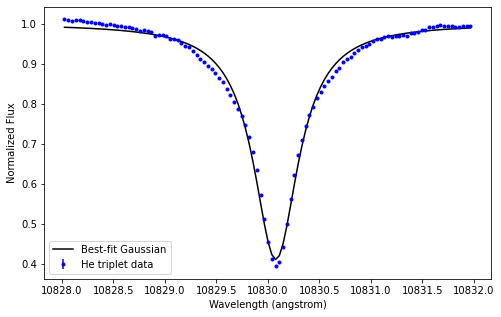

[9.98360932e-01 4.87125269e-01 1.08300778e+04 8.62248743e-04
 2.63159259e-01]


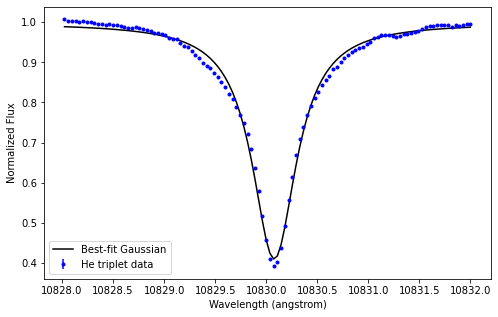

[9.98251847e-01 4.83347402e-01 1.08300779e+04 8.51898394e-05
 2.60915589e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


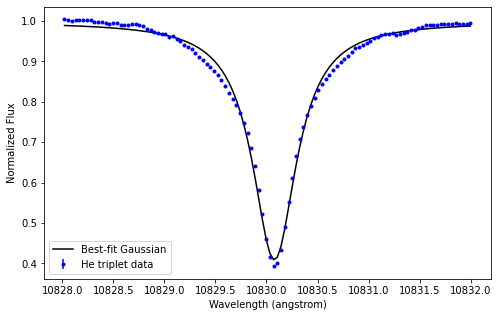

[9.98404176e-01 4.83941090e-01 1.08300771e+04 3.50272877e-04
 2.60930991e-01]


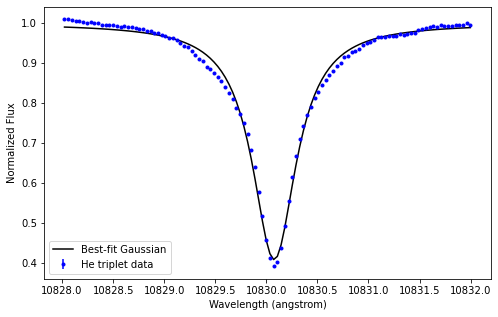

[9.97722176e-01 4.81176382e-01 1.08300770e+04 1.30340077e-04
 2.59495068e-01]


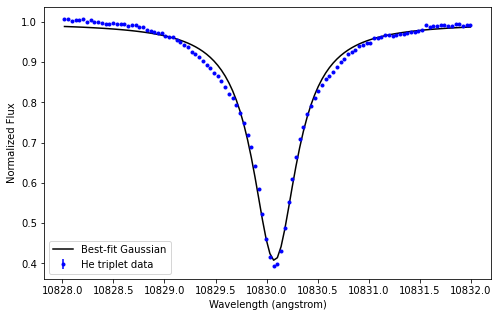

[1.00367127e+00 4.88103860e-01 1.08300776e+04 4.80328759e-05
 2.61913688e-01]


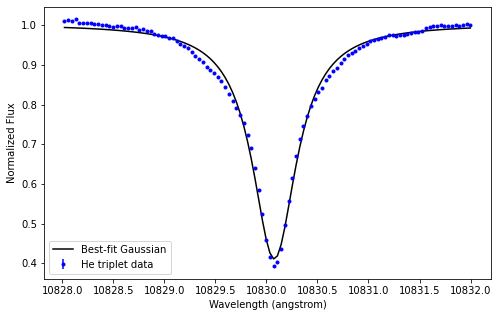

[9.98823486e-01 4.81175259e-01 1.08300777e+04 1.82481410e-06
 2.59356778e-01]


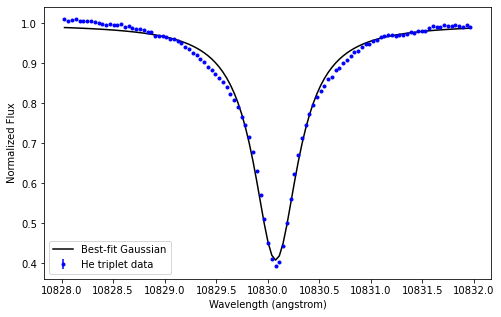

[1.00461113e+00 4.85190063e-01 1.08300783e+04 1.92578137e-06
 2.59281050e-01]


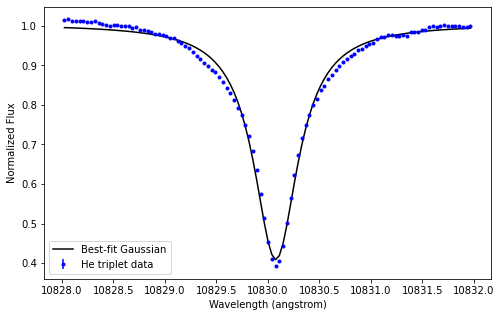

[1.00389411e+00 4.94183974e-01 1.08300782e+04 2.77177357e-06
 2.65914870e-01]


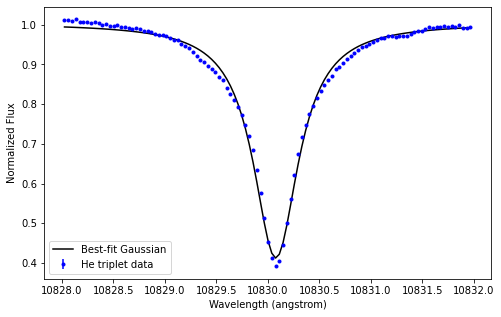

[1.00445126e+00 4.89718609e-01 1.08300772e+04 2.27608670e-03
 2.63166880e-01]


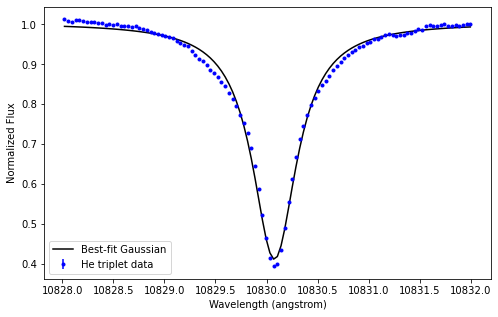

[1.00086699e+00 4.84012602e-01 1.08300776e+04 3.22414447e-05
 2.60673322e-01]


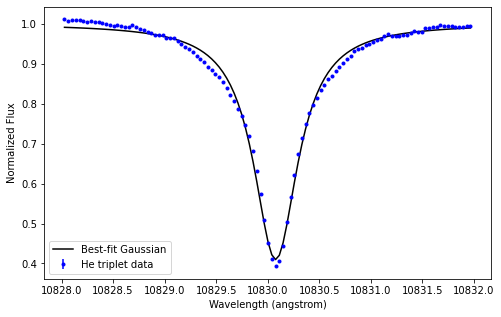

[9.99659986e-01 4.85059399e-01 1.08300784e+04 1.85995068e-05
 2.61328180e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


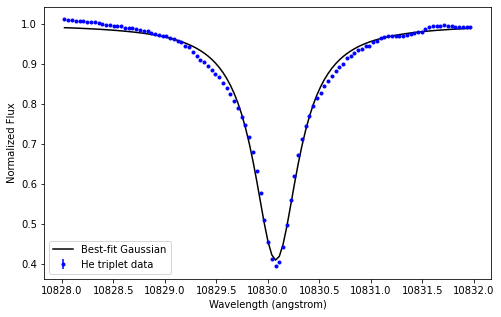

[1.00349707e+00 4.94762828e-01 1.08300771e+04 7.45772866e-06
 2.66811920e-01]


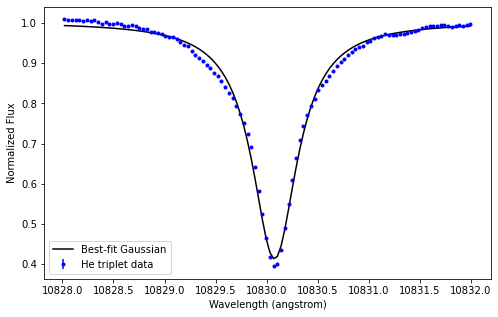

[1.00058367e+00 4.82369433e-01 1.08300785e+04 3.65351476e-06
 2.59283850e-01]


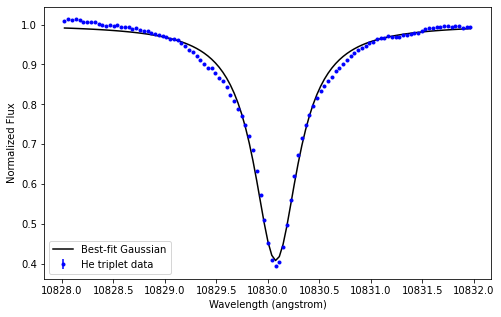

[1.00279462e+00 4.88335839e-01 1.08300770e+04 3.30265405e-05
 2.62878645e-01]


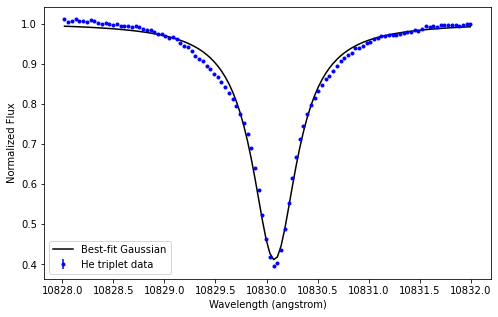

[9.98236610e-01 4.81123627e-01 1.08300784e+04 1.58678435e-05
 2.58961483e-01]


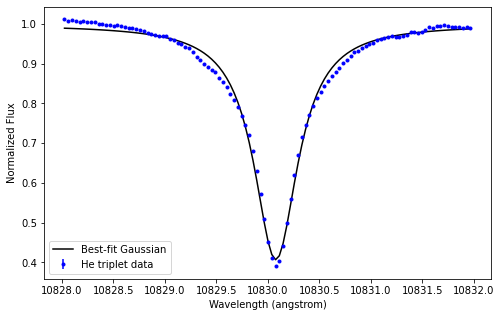

[1.00471403e+00 4.94676008e-01 1.08300776e+04 4.00996022e-05
 2.66595243e-01]


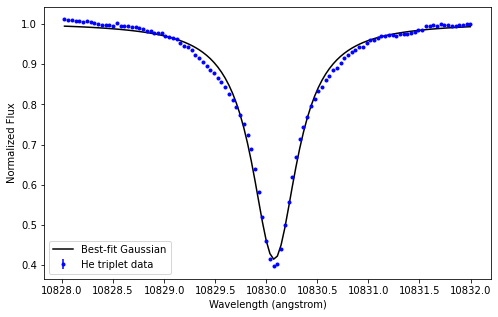

[9.98559012e-01 4.80671815e-01 1.08300769e+04 9.34995665e-04
 2.59345764e-01]


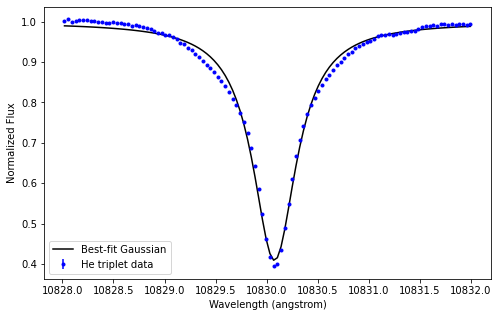

[1.00342047e+00 4.87074966e-01 1.08300789e+04 1.13659880e-03
 2.61494007e-01]


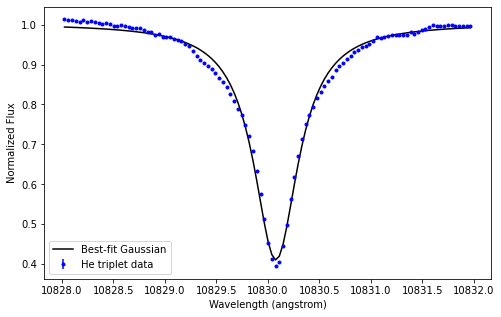

[1.00362809e+00 4.93006055e-01 1.08300769e+04 2.29657243e-04
 2.65309174e-01]


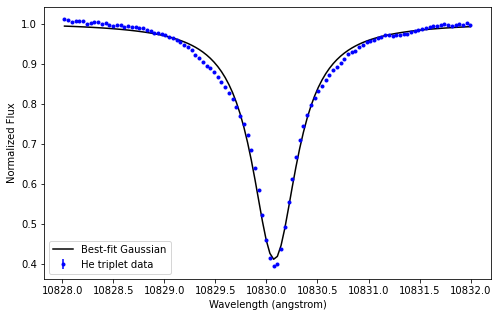

[1.00438967e+00 4.88490951e-01 1.08300781e+04 1.73335693e-03
 2.62544465e-01]


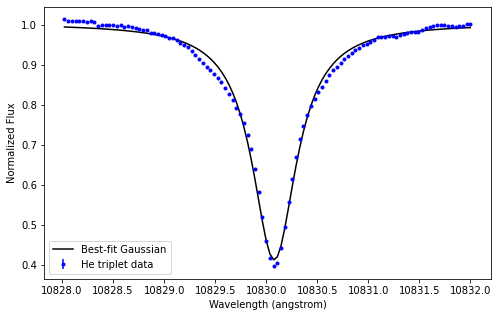

[1.00144400e+00 4.83181589e-01 1.08300784e+04 1.90315051e-05
 2.59722154e-01]


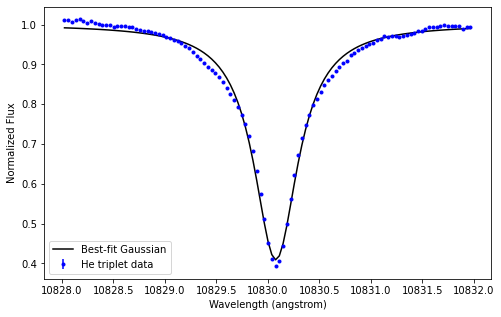

[9.99369591e-01 4.89732949e-01 1.08300776e+04 2.12817419e-05
 2.64624655e-01]


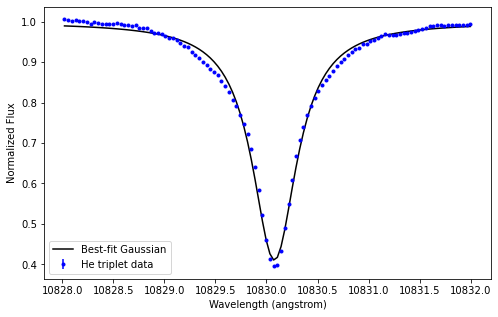

[9.98820128e-01 4.81731314e-01 1.08300775e+04 3.97805589e-06
 2.59273612e-01]


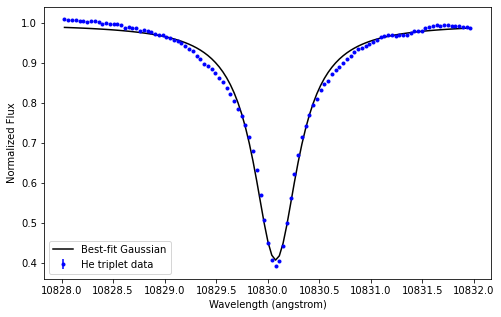

[1.00130916e+00 4.84632201e-01 1.08300779e+04 3.90078506e-05
 2.61095942e-01]


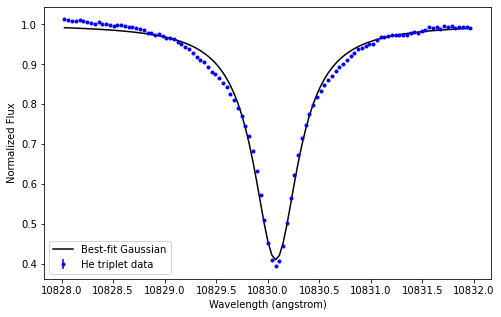

[1.00193018e+00 4.84518607e-01 1.08300776e+04 5.65240792e-06
 2.60461385e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


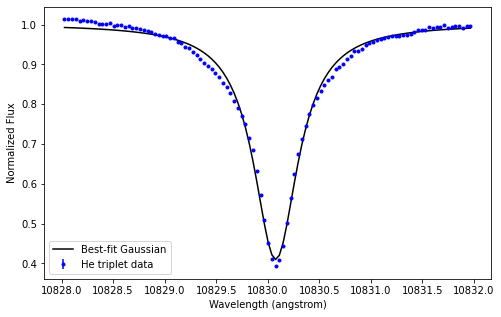

[1.00218049e+00 4.86690293e-01 1.08300781e+04 1.72063158e-04
 2.61680813e-01]


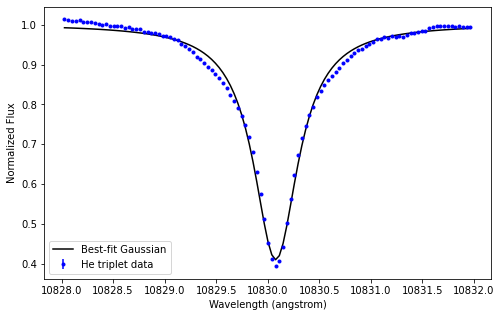

[1.00123906e+00 4.87198484e-01 1.08300783e+04 1.66151185e-05
 2.62034581e-01]


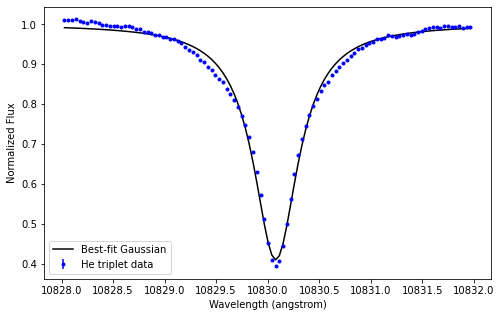

[9.99081093e-01 4.86071181e-01 1.08300785e+04 1.84092037e-05
 2.62055115e-01]


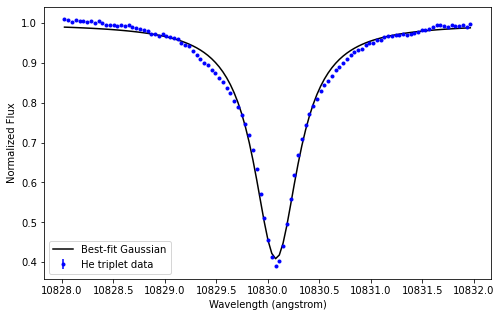

[9.97942736e-01 4.90122489e-01 1.08300770e+04 6.89486286e-05
 2.65334066e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


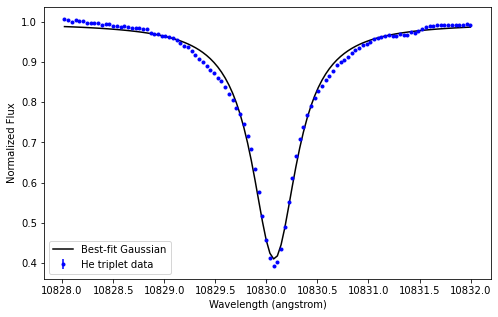

[9.98681764e-01 4.81281641e-01 1.08300773e+04 1.88967923e-04
 2.59479552e-01]


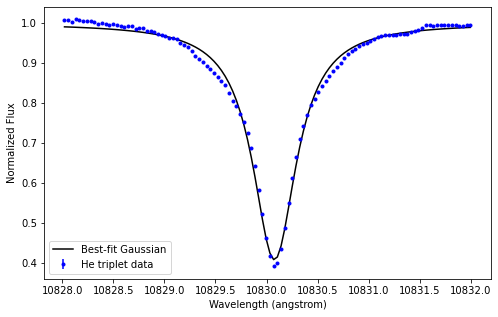

[9.99580249e-01 4.82382980e-01 1.08300771e+04 8.68795998e-05
 2.59868627e-01]


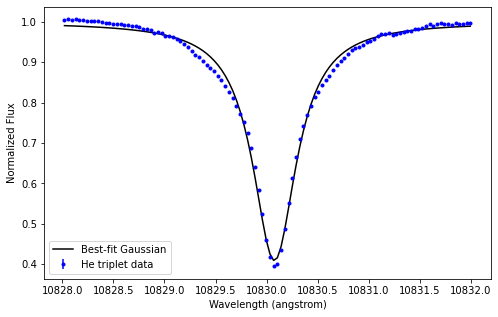

[1.00287253e+00 4.84539146e-01 1.08300779e+04 1.63191283e-06
 2.60003807e-01]


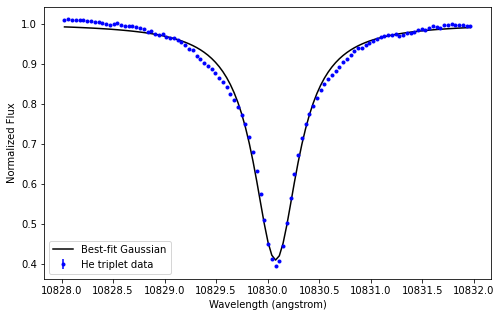

[1.00424601e+00 4.91773576e-01 1.08300785e+04 4.14638377e-04
 2.63972806e-01]


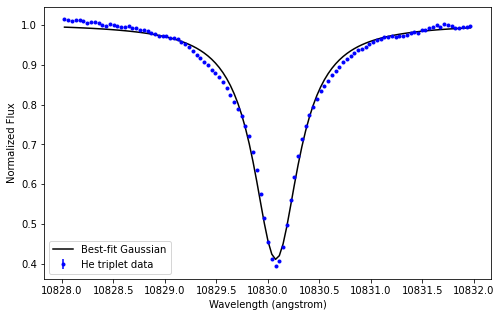

[1.00207904e+00 4.87553084e-01 1.08300773e+04 1.05246215e-03
 2.61918167e-01]


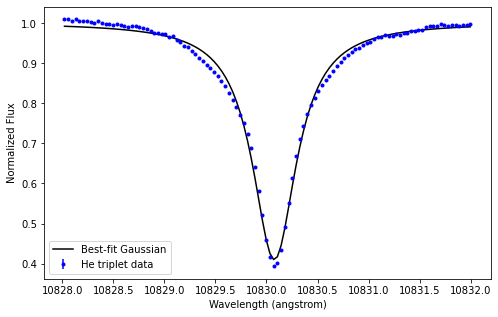

[1.00329640e+00 4.80060036e-01 1.08300785e+04 1.41781005e-05
 2.56892424e-01]


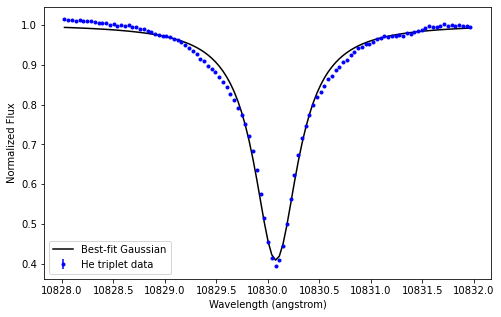

[1.00187336e+00 4.86547416e-01 1.08300782e+04 1.47140404e-05
 2.61797737e-01]


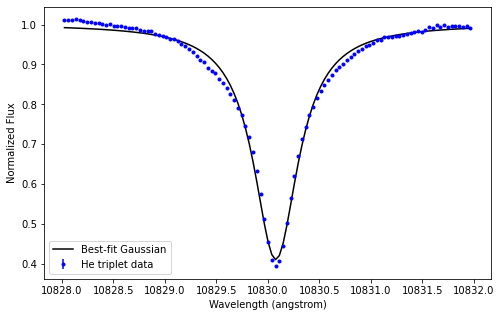

[9.99865892e-01 4.82670534e-01 1.08300782e+04 3.27120915e-06
 2.59353149e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


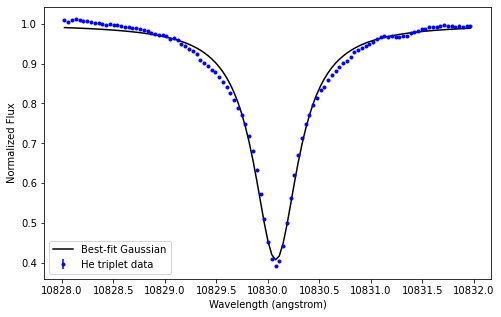

[1.00260074e+00 4.84903607e-01 1.08300771e+04 7.93362648e-04
 2.60386859e-01]


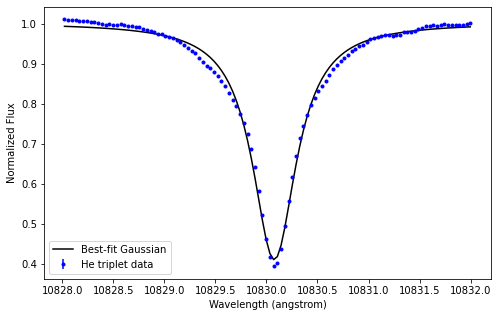

[9.99060577e-01 4.85285745e-01 1.08300773e+04 3.18679732e-05
 2.61397954e-01]


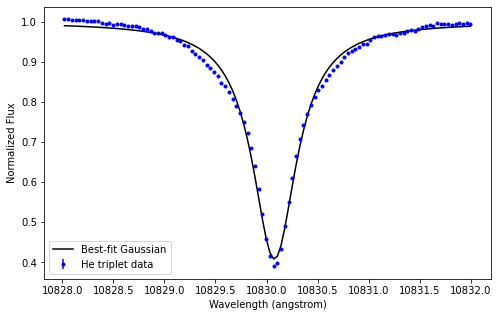

[1.00711855e+00 4.94887934e-01 1.08300779e+04 1.18436652e-04
 2.65714746e-01]


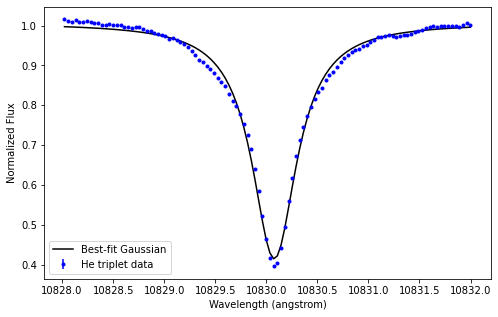

[9.95464019e-01 4.80474114e-01 1.08300780e+04 3.56757858e-06
 2.59785494e-01]


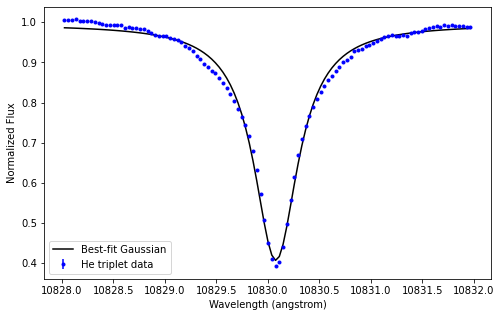

[1.00573496e+00 4.94723144e-01 1.08300781e+04 8.76304389e-06
 2.65704160e-01]


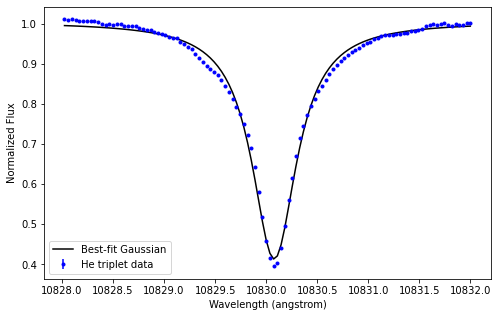

[1.00086228e+00 4.87568804e-01 1.08300772e+04 1.21194784e-04
 2.63057282e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


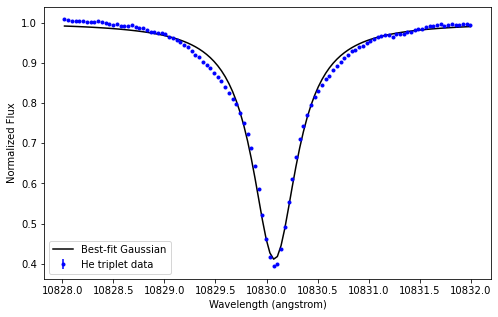

[1.00350173e+00 4.93192967e-01 1.08300777e+04 1.92463322e-03
 2.65538458e-01]


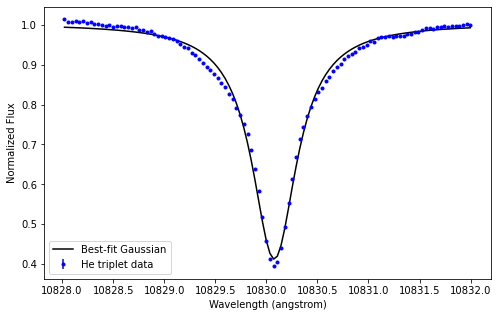

[1.00051449e+00 4.85695101e-01 1.08300768e+04 4.00650106e-04
 2.61176630e-01]


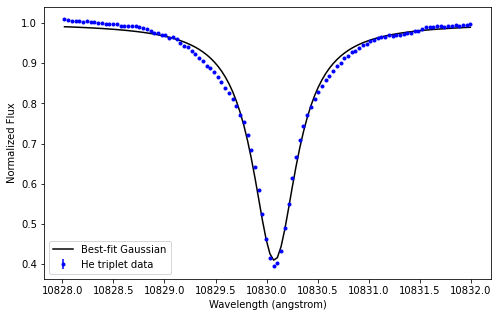

[1.00088431e+00 4.83994025e-01 1.08300776e+04 4.66808265e-05
 2.60721475e-01]


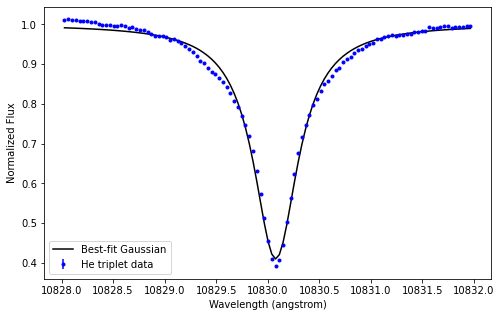

[1.00066463e+00 4.82278193e-01 1.08300773e+04 8.14145324e-04
 2.59371005e-01]


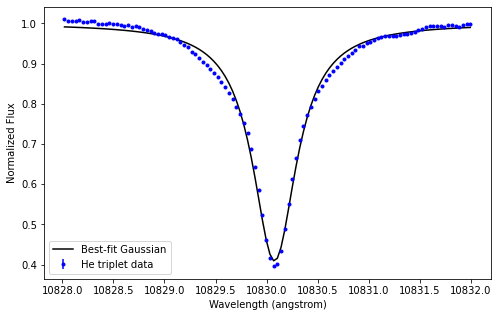

[1.00141191e+00 4.84972439e-01 1.08300779e+04 4.24568225e-04
 2.60875517e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


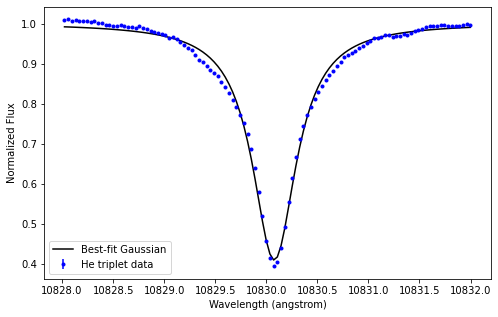

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


[1.00383068e+00 4.93725192e-01 1.08300772e+04 1.01188628e-04
 2.65554613e-01]


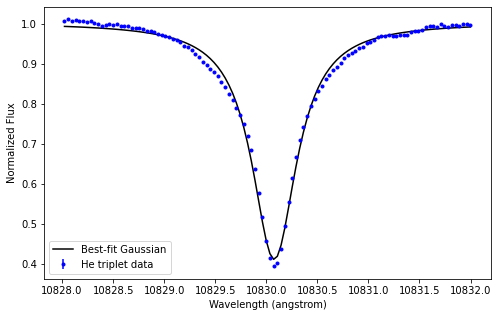

/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


[1.00161630e+00 4.84906653e-01 1.08300775e+04 2.78749182e-04
 2.60759322e-01]


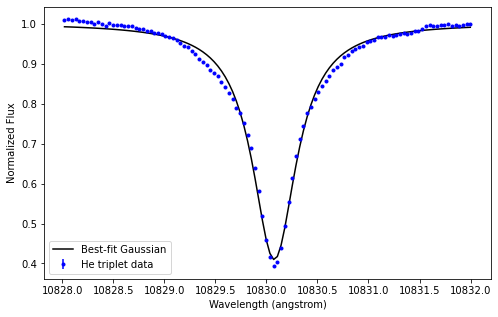

[1.00534838e+00 4.89024193e-01 1.08300775e+04 1.46003237e-04
 2.62014792e-01]


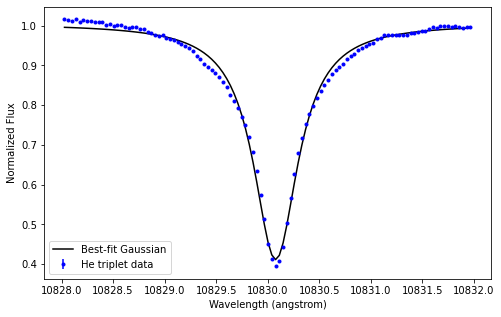

[1.00267813e+00 4.86799468e-01 1.08300773e+04 1.15181251e-04
 2.61183931e-01]


/opt/anaconda3/lib/python3.9/site-packages/scipy/optimize/minpack.py:488: RuntimeWarning: overflow encountered in multiply
  return transform * (func(xdata, *params) - ydata)


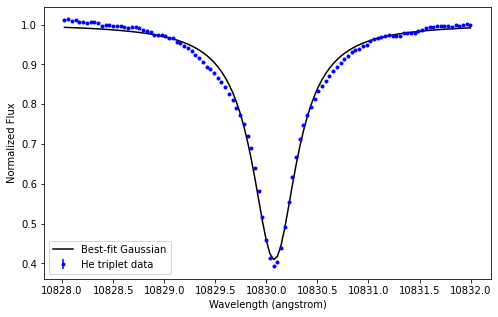

[1.00294021e+00 4.92505981e-01 1.08300770e+04 7.27034006e-05
 2.65288985e-01]


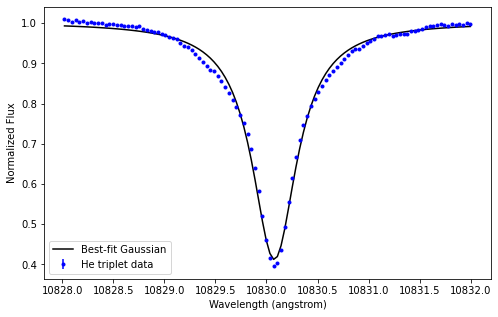

[1.00049808e+00 4.89510544e-01 1.08300777e+04 2.65902379e-05
 2.64360004e-01]


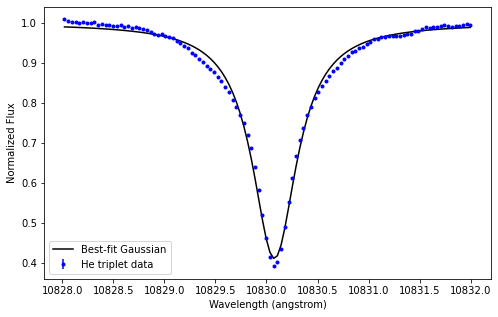

In [28]:
lower_l = 10828
upper_l = 10832

guess_params = [0.3, 1/8, 10830, 0.1, 0.2]

def Voigt(x, offset, depth, center, sig, gam):
    return offset-depth*voigt_profile(x-center, sig, gam)
    
thetas_Si_HA = np.ones((len(total_spctr_HA), 5))
thetas_Si_HE = np.ones((len(total_spctr_HE), 5))

err_Si_HA = np.ones((len(total_spctr_HA), 5))
err_Si_HE = np.ones((len(total_spctr_HE), 5))

for i in range(len(total_spctr_HA)):
    
    temp_1 = total_lamda_HA[i][lower_l < total_lamda_HA[i]]
    temp_2 = total_spctr_HA[i][lower_l < total_lamda_HA[i]]
    temp_3 = total_err_HA[i][lower_l < total_lamda_HA[i]]
    focus_lamda = temp_1[temp_1 < upper_l]
    focus_spctr = temp_2[temp_1 < upper_l]
    focus_err = temp_3[temp_1 < upper_l]
    
    params, cov = curve_fit(Voigt, focus_lamda, focus_spctr/np.mean(total_spctr_HA[i]),
                            sigma=focus_err/np.mean(total_spctr_HA[i]), p0 = guess_params)
    thetas_Si_HA[i] = params
    err_Si_HA[i] = np.sqrt(np.diag(cov))
    model = Voigt(focus_lamda, params[0], params[1], params[2], params[3], params[4])

    plt.figure(figsize=[8, 5])
    plt.errorbar(focus_lamda, focus_spctr/np.mean(total_spctr_HA[i]), yerr=focus_err/np.mean(total_spctr_HA[i]),  fmt='b.', label='He triplet data')
    plt.plot(focus_lamda, model, 'r', label='Best-fit Gaussian')
    plt.xlabel('Wavelength (angstrom)')
    plt.ylabel('Normalized Flux')
    plt.legend()
    print(thetas_Si_HA[i])
    plt.show()
    
    
for i in range(len(total_spctr_HE)):
    
    temp_1 = total_lamda_HE[i][lower_l < total_lamda_HE[i]]
    temp_2 = total_spctr_HE[i][lower_l < total_lamda_HE[i]]
    temp_3 = total_err_HE[i][lower_l < total_lamda_HE[i]]
    focus_lamda = temp_1[temp_1 < upper_l]
    focus_spctr = temp_2[temp_1 < upper_l]
    focus_err = temp_3[temp_1 < upper_l]
    
    params, cov = curve_fit(Voigt, focus_lamda, focus_spctr/np.mean(total_spctr_HE[i]),
                            sigma=focus_err/np.mean(total_spctr_HE[i]), p0 = guess_params)
    thetas_Si_HE[i] = params
    err_Si_HE[i] = np.sqrt(np.diag(cov))
    model = Voigt(focus_lamda, params[0], params[1], params[2], params[3], params[4])
    
    plt.figure(figsize=[8, 5])
    plt.errorbar(focus_lamda, focus_spctr/np.mean(total_spctr_HE[i]), yerr=focus_err/np.mean(total_spctr_HE[i]),  fmt='b.', label='He triplet data')
    plt.plot(focus_lamda, model, 'k', label='Best-fit Gaussian')
    plt.xlabel('Wavelength (angstrom)')
    plt.ylabel('Normalized Flux')
    plt.legend()
    print(thetas_Si_HE[i])
    plt.show()

## Plotting the positions, depths and widths of the fitted Gaussian lines for Si

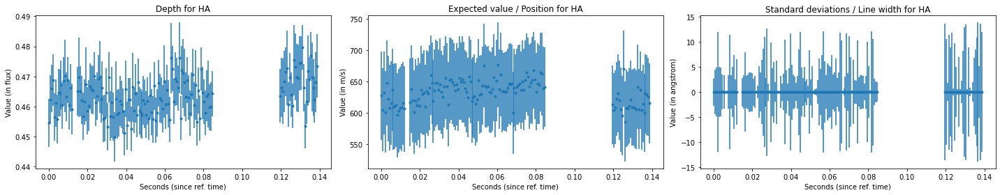

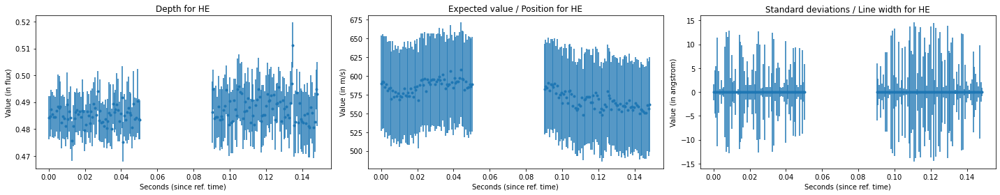

In [29]:
fig, (ax1, ax2, ax3) = plt.subplots (1, 3, figsize=[20, 4])

ref_Si = air2vac(10827.091)

ax1.errorbar(date_HA-min(date_HA), thetas_Si_HA[:, 1], yerr=err_Si_HA[:, 1], fmt='.')
ax2.errorbar(date_HA-min(date_HA), (thetas_Si_HA[:, 2]-ref_Si)*3e8/ref_Si, yerr=err_Si_HA[:, 2]*3e8/ref_Si, fmt='.')
ax3.errorbar(date_HA-min(date_HA), np.abs(thetas_Si_HA[:, 3]), yerr=err_Si_HA[:, 3], fmt='.')
ax1.set_xlabel('Seconds (since ref. time)')
ax2.set_xlabel('Seconds (since ref. time)')
ax3.set_xlabel('Seconds (since ref. time)')
ax2.set_ylabel('Value (in m/s)')
ax3.set_ylabel('Value (in angstrom)')
ax1.set_ylabel('Value (in flux)')
ax1.set_title('Depth for HA')
ax2.set_title('Expected value / Position for HA')
ax3.set_title('Standard deviations / Line width for HA')

fig.tight_layout()

fig, (ax4, ax5, ax6) = plt.subplots (1, 3, figsize=[20, 4])

ax4.errorbar(date_HE-min(date_HE), thetas_Si_HE[:, 1], yerr=err_Si_HE[:, 1], fmt='.')
ax5.errorbar(date_HE-min(date_HE), (thetas_Si_HE[:, 2]-ref_Si)*3e8/ref_Si, yerr=err_Si_HE[:, 2]*3e8/ref_Si, fmt='.')
ax6.errorbar(date_HE-min(date_HE), np.abs(thetas_Si_HE[:, 3]), yerr=err_Si_HE[:, 3], fmt='.')
ax4.set_xlabel('Seconds (since ref. time)')
ax5.set_xlabel('Seconds (since ref. time)')
ax6.set_xlabel('Seconds (since ref. time)')
ax5.set_ylabel('Value (in m/s)')
ax6.set_ylabel('Value (in angstrom)')
ax4.set_ylabel('Value (in flux)')
ax4.set_title('Depth for HE')
ax5.set_title('Expected value / Position for HE')
ax6.set_title('Standard deviations / Line width for HE')

fig.tight_layout()

## Periodogram for the position, depth and width of the Si line

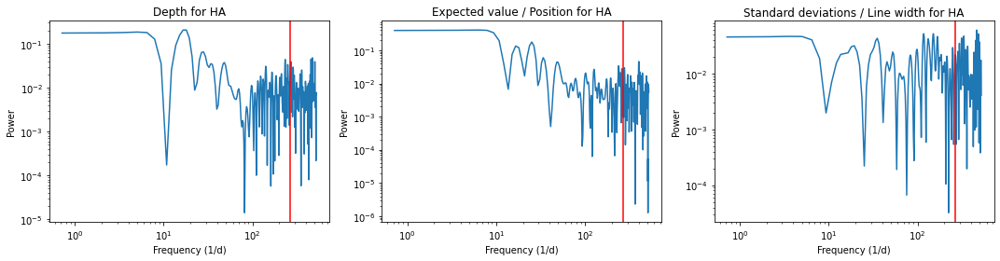

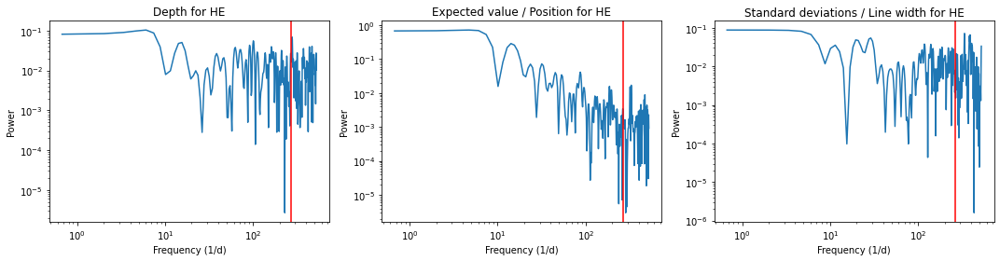

In [30]:
fig, (ax1, ax2, ax3) = plt.subplots (1, 3, figsize=[15, 4])

LS_depth_Si_HA = LombScargle(date_HA-min(date_HA), thetas_Si_HA[:, 1]).autopower(nyquist_factor=1)
LS_position_Si_HA = LombScargle(date_HA-min(date_HA), thetas_Si_HA[:, 2]).autopower(nyquist_factor=1)
LS_width_Si_HA = LombScargle(date_HA-min(date_HA), thetas_Si_HA[:, 3]).autopower(nyquist_factor=1)

ax1.loglog(LS_depth_Si_HA[0], LS_depth_Si_HA[1])
ax2.loglog(LS_position_Si_HA[0], LS_position_Si_HA[1])
ax3.loglog(LS_width_Si_HA[0], LS_width_Si_HA[1])
ax1.set_xlabel('Frequency (1/d)')
ax2.set_xlabel('Frequency (1/d)')
ax3.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax3.set_ylabel('Power')
ax1.set_ylabel('Power')
ax1.set_title('Depth for HA')
ax2.set_title('Expected value / Position for HA')
ax3.set_title('Standard deviations / Line width for HA')
ax1.axvline(oscillation_freq, color='r')
ax2.axvline(oscillation_freq, color='r')
ax3.axvline(oscillation_freq, color='r')
fig.tight_layout()
plt.show()

fig, (ax4, ax5, ax6) = plt.subplots (1, 3, figsize=[15, 4])

LS_depth_Si_HE = LombScargle(date_HE-min(date_HE), thetas_Si_HE[:, 1]).autopower(nyquist_factor=1)
LS_position_Si_HE = LombScargle(date_HE-min(date_HE), thetas_Si_HE[:, 2]).autopower(nyquist_factor=1)
LS_width_Si_HE = LombScargle(date_HE-min(date_HE), thetas_Si_HE[:, 3]).autopower(nyquist_factor=1)

ax4.loglog(LS_depth_Si_HE[0], LS_depth_Si_HE[1])
ax5.loglog(LS_position_Si_HE[0], LS_position_Si_HE[1])
ax6.loglog(LS_width_Si_HE[0], LS_width_Si_HE[1])
ax4.set_xlabel('Frequency (1/d)')
ax5.set_xlabel('Frequency (1/d)')
ax6.set_xlabel('Frequency (1/d)')
ax5.set_ylabel('Power')
ax6.set_ylabel('Power')
ax4.set_ylabel('Power')
ax4.set_title('Depth for HE')
ax5.set_title('Expected value / Position for HE')
ax6.set_title('Standard deviations / Line width for HE')
ax4.axvline(oscillation_freq, color='r')
ax5.axvline(oscillation_freq, color='r')
ax6.axvline(oscillation_freq, color='r')
fig.tight_layout()
plt.show()

## Checking the impact of tellurics

In [31]:
total_spctr_NC = np.zeros((len(os.listdir('Corr-data')), 4084))
total_err_NC = np.zeros((len(os.listdir('Corr-data')), 4084))
total_telluric = np.zeros((len(os.listdir('Corr-data')), 4084))

In [32]:
for i in range(len(os.listdir('Corr-data'))):
    file = pf.open('Corr-data/'+os.listdir('Corr-data')[i])
    file_lamda = file[4].data[14]
    file_spctr = file[1].data[14]
    file_err = file[2].data[14]
    file_telluric = file[11].data[14]
    file_DLL = file[6].data[14]

    #Getting the telluric spectra
    total_telluric[i] = file_telluric
         
    #Getting the wavelength and error on the flux
    total_err_NC[i] = file_err
    
    #Performing Blaze correction
    if file[0].header['HIERARCH ESO INS MODE'] == 'HA':
        A = file_spctr/blaze_spctr_HA[14]
    else: 
        A = file_spctr/blaze_spctr_HE[14]
    
    #Performing DLL and Sun BB correction
    B = A/file_DLL
    
    total_spctr_NC[i] = B / Sun_BB(file_lamda*u.AA).value

In [33]:
total_spctr_NC_HA, total_spctr_NC_HE = segment_and_reduce(mode, total_SNR, total_spctr_NC)

total_err_NC_HA, total_err_NC_HE = segment_and_reduce(mode, total_SNR, total_err_NC)

total_telluric_HA, total_telluric_HE = segment_and_reduce(mode, total_SNR, total_telluric)

In [34]:
i = 25

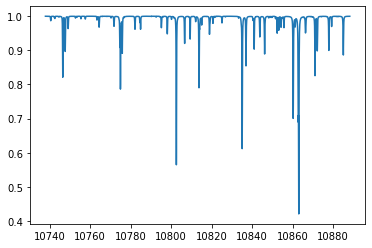

In [35]:
plt.plot(total_lamda_HA[i], total_telluric_HA[i])

## PLotting the telluric spectra and the diff between the TC and not TC spectra

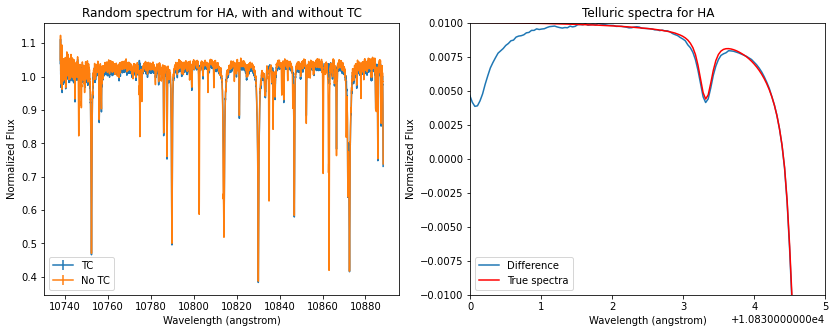

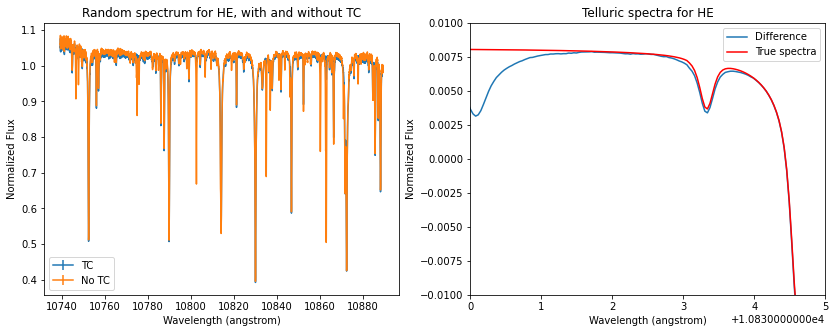

In [36]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[14, 5])
ax1.errorbar(total_lamda_HA[i], total_spctr_HA[i]/np.mean(total_spctr_HA[i]), yerr=total_err_HA[i]/np.mean(total_spctr_HA[i]), label='TC')
ax1.errorbar(total_lamda_HA[i], total_spctr_NC_HA[i]/np.mean(total_spctr_NC_HA[i]), yerr=total_err_NC_HA[i]/np.mean(total_spctr_NC_HA[i]), label='No TC')
ax1.set_xlabel('Wavelength (angstrom)')
ax1.set_ylabel('Normalized Flux')
ax1.set_title('Random spectrum for HA, with and without TC')
ax1.legend()

diff = total_spctr_NC_HA[i]/np.mean(total_spctr_NC_HA[i]) - total_spctr_HA[i]/np.mean(total_spctr_HA[i])
ax2.plot(total_lamda_HA[i], diff, label='Difference')
ax2.plot(total_lamda_HA[i], total_telluric_HA[i]-np.mean(total_telluric_HA[i]), 'r', label='True spectra')
ax2.set_xlabel('Wavelength (angstrom)')
ax2.set_ylabel('Normalized Flux')
ax2.set_title('Telluric spectra for HA')
ax2.legend()
ax2.set_xlim([10830, 10835])
ax2.set_ylim([-0.01, 0.01])
plt.show()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[14, 5])
ax1.errorbar(total_lamda_HE[i], total_spctr_HE[i]/np.mean(total_spctr_HE[i]), yerr=total_err_HE[i]/np.mean(total_spctr_HE[i]), label='TC')
ax1.errorbar(total_lamda_HE[i], total_spctr_NC_HE[i]/np.mean(total_spctr_NC_HE[i]), yerr=total_err_NC_HE[i]/np.mean(total_spctr_NC_HE[i]), label='No TC')
ax1.set_xlabel('Wavelength (angstrom)')
ax1.set_ylabel('Normalized Flux')
ax1.set_title('Random spectrum for HE, with and without TC')
ax1.legend()

diff = total_spctr_NC_HE[i]/np.mean(total_spctr_NC_HE[i]) - total_spctr_HE[i]/np.mean(total_spctr_HE[i])
ax2.plot(total_lamda_HE[i], diff, label='Difference')
ax2.plot(total_lamda_HE[i], total_telluric_HE[i]-np.mean(total_telluric_HE[i]), 'r', label='True spectra')
ax2.set_xlabel('Wavelength (angstrom)')
ax2.set_ylabel('Normalized Flux')
ax2.set_title('Telluric spectra for HE')
ax2.legend()
ax2.set_xlim([10830, 10835])
ax2.set_ylim([-0.01, 0.01])
plt.show()



## Fitting the line in the telluric spectra around the He triplet

[ 9.99999950e-01  3.92424130e-03  1.30754923e+00  8.42493855e-02
 -1.76036981e-03  1.90790031e+01]


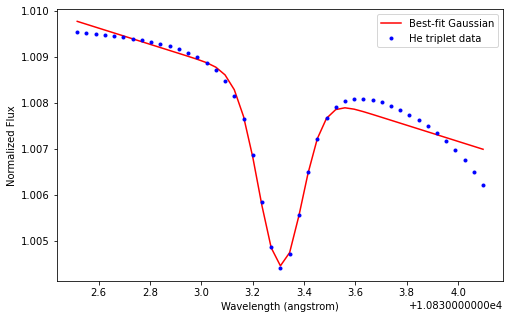

[ 9.99998869e-01  4.19584722e-03  1.31225327e+00  8.50825721e-02
 -1.80751733e-03  1.95902935e+01]


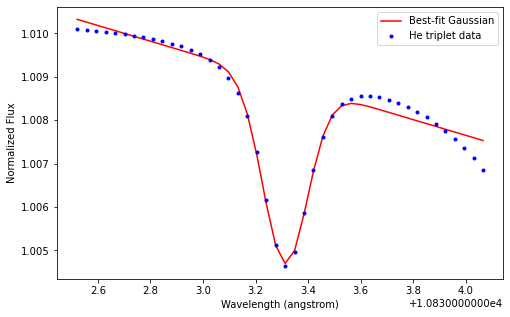

[ 1.00000000e+00  4.39294509e-03  1.30763668e+00  8.31530002e-02
 -2.00991822e-03  2.17834500e+01]


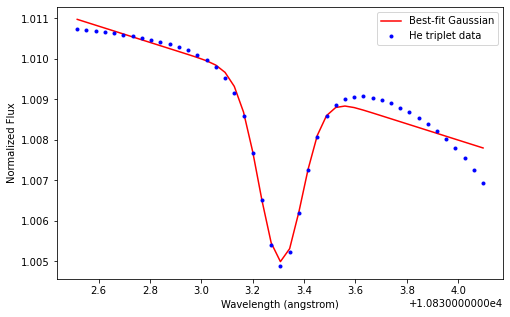

[ 1.00000000e+00  4.04737905e-03  1.31099004e+00  8.49423979e-02
 -1.72309688e-03  1.86754213e+01]


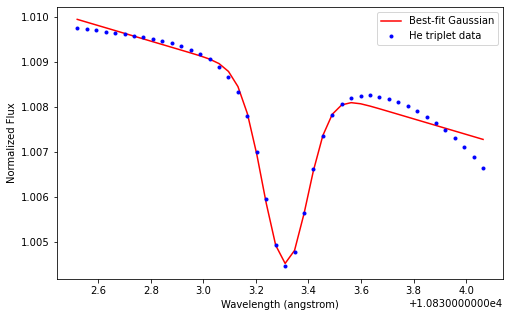

[ 9.99999441e-01  4.14580417e-03  1.31264971e+00  8.50715071e-02
 -1.78399504e-03  1.93353723e+01]


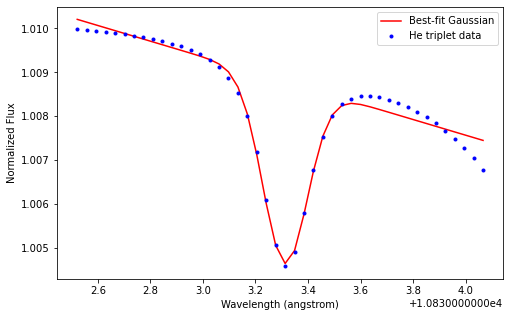

[ 1.00000000e+00  3.61503429e-03  1.31694859e+00  8.51488615e-02
 -1.56047860e-03  1.69129513e+01]


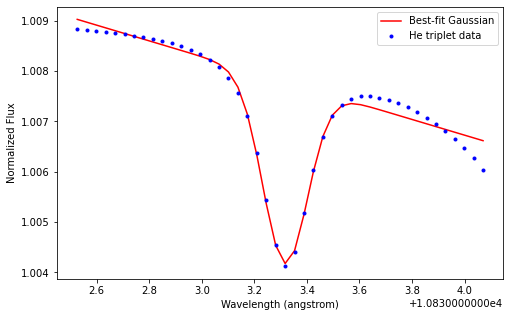

[ 1.00000000e+00  3.94032006e-03  1.31165701e+00  8.49933236e-02
 -1.68208727e-03  1.82309595e+01]


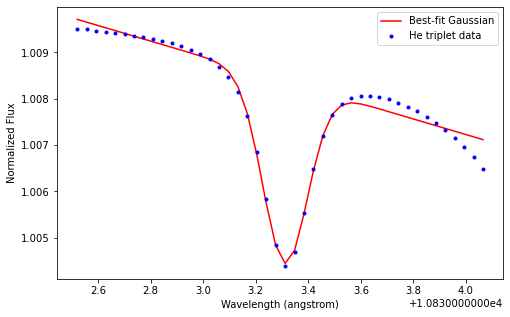

[ 9.99999998e-01  3.17600338e-03  1.31746591e+00  8.49644124e-02
 -1.35130138e-03  1.46459716e+01]


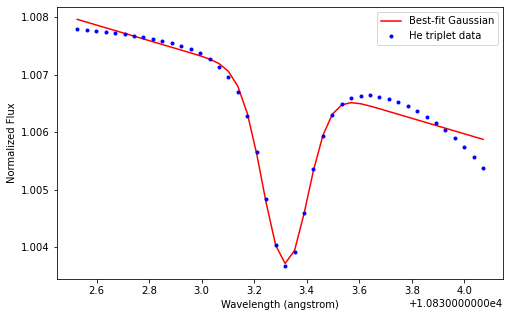

[ 1.00000000e+00  3.32726350e-03  1.31518140e+00  8.48186960e-02
 -1.40182318e-03  1.51935584e+01]


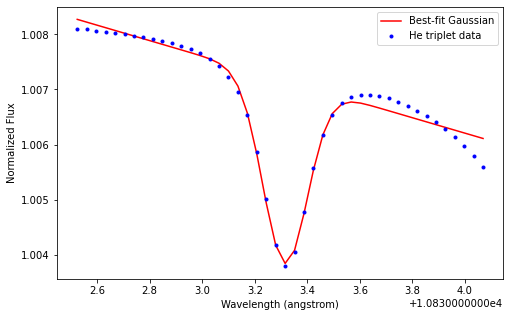

[ 1.00000000e+00  4.08004547e-03  1.31219070e+00  8.51047293e-02
 -1.75849804e-03  1.90590354e+01]


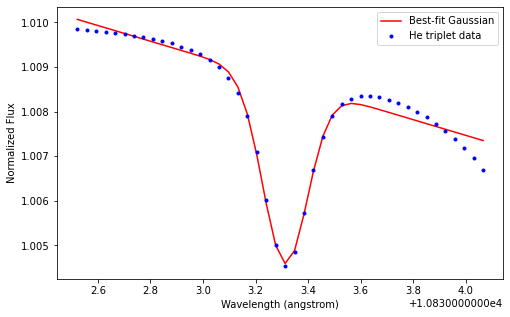

[ 1.00000000e+00  3.75787708e-03  1.31159708e+00  8.49218248e-02
 -1.59677514e-03  1.73063837e+01]


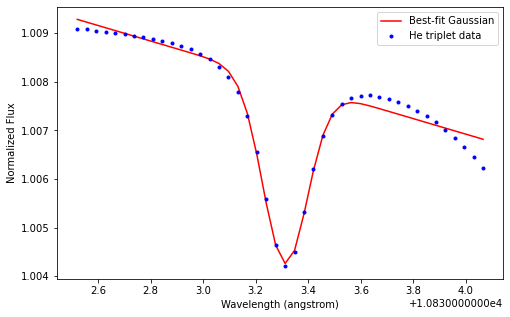

[ 1.00000000e+00  4.32263445e-03  1.30724133e+00  8.32434210e-02
 -1.95542085e-03  2.11928942e+01]


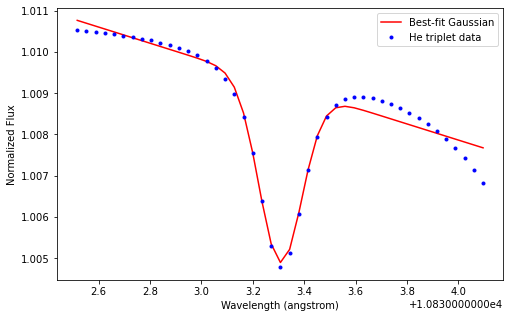

[ 1.00000000e+00  3.82365279e-03  1.31015012e+00  8.40576274e-02
 -1.69004183e-03  1.83168878e+01]


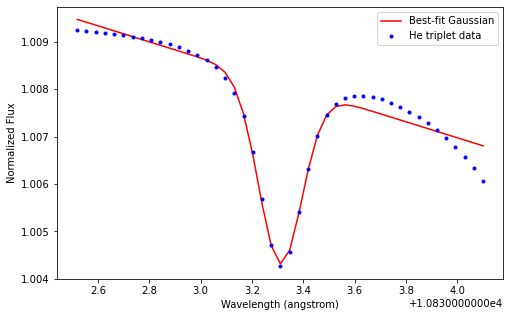

[ 1.00000000e+00  3.64466220e-03  1.31540437e+00  8.50643949e-02
 -1.56399005e-03  1.69510298e+01]


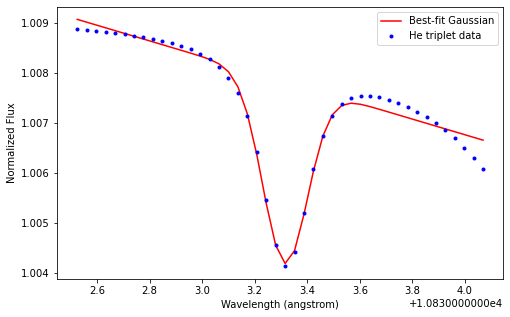

[ 9.99999032e-01  4.17322686e-03  1.31125409e+00  8.51818069e-02
 -1.80972828e-03  1.96142224e+01]


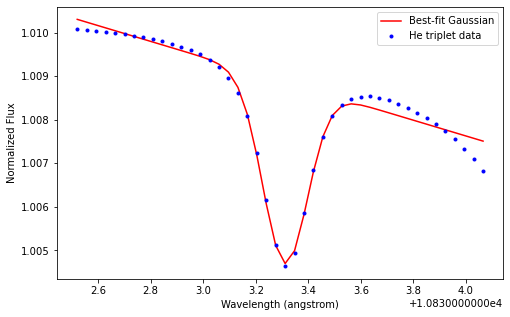

[ 1.00000000e+00  3.51328288e-03  1.31470982e+00  8.49151626e-02
 -1.49097888e-03  1.61597907e+01]


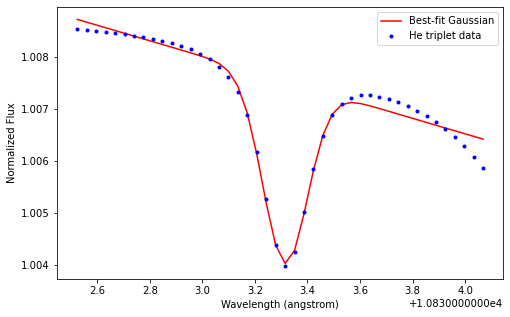

[ 1.00000000e+00  4.03582862e-03  1.31328301e+00  8.50698293e-02
 -1.73506139e-03  1.88050498e+01]


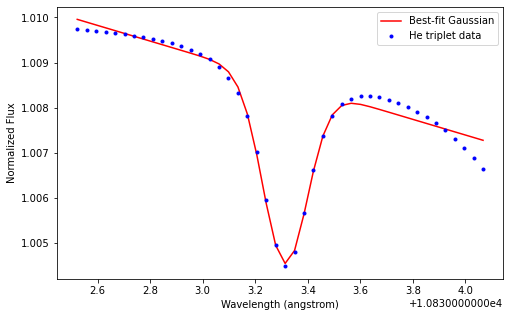

[ 9.99999999e-01  3.25805317e-03  1.31672338e+00  8.49237165e-02
 -1.38240075e-03  1.49830343e+01]


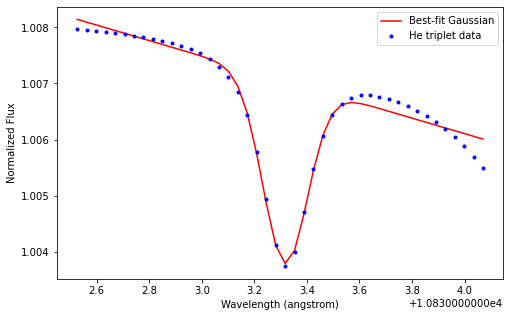

[ 9.99999180e-01  4.16899722e-03  1.31247517e+00  8.50468394e-02
 -1.79108842e-03  1.94122552e+01]


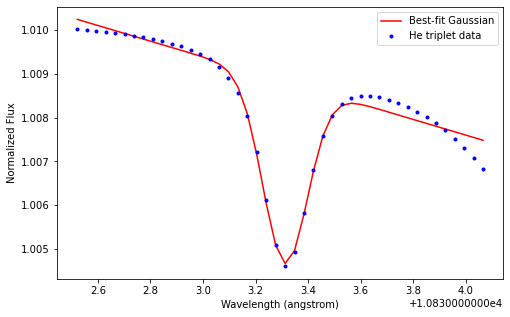

[ 1.00000000e+00  3.40031090e-03  1.31600769e+00  8.50243902e-02
 -1.45420332e-03  1.57611926e+01]


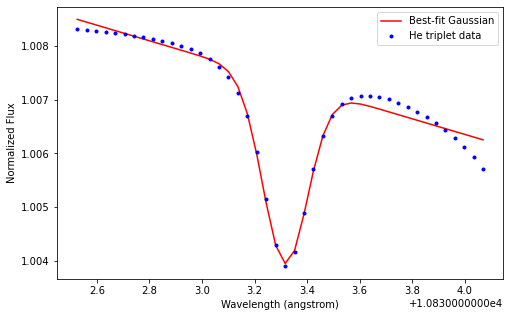

[ 9.99998423e-01  4.25126080e-03  1.31388744e+00  8.51194460e-02
 -1.83821860e-03  1.99230094e+01]


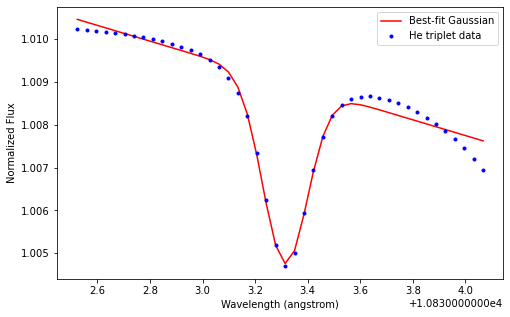

[ 9.99999998e-01  3.17606094e-03  1.31722335e+00  8.49881278e-02
 -1.35357587e-03  1.46706158e+01]


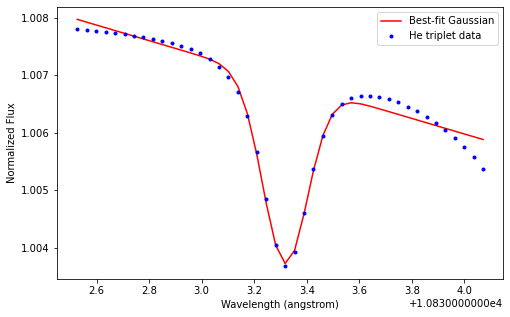

[ 9.99999997e-01  2.87926856e-03  1.31651876e+00  8.47572286e-02
 -1.20746087e-03  1.30870759e+01]


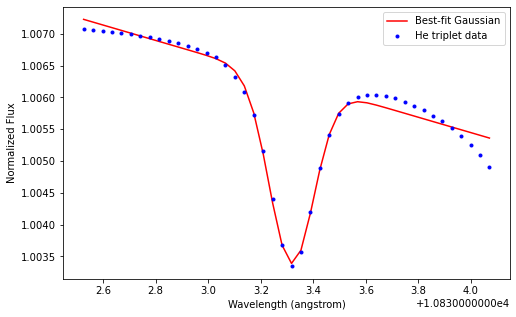

[ 9.99999829e-01  4.10330933e-03  1.31179212e+00  8.50791118e-02
 -1.76546483e-03  1.91345464e+01]


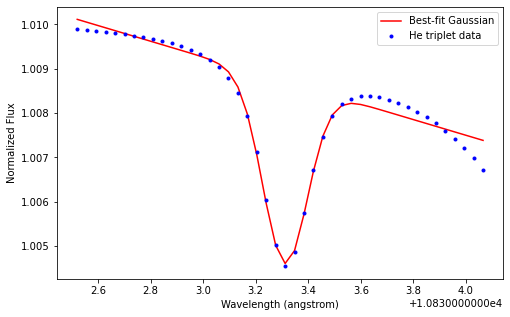

[ 9.99997068e-01  4.36687061e-03  1.31316556e+00  8.53476408e-02
 -1.92071228e-03  2.08169623e+01]


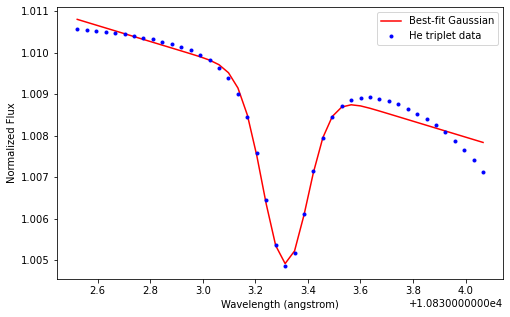

[ 1.00000000e+00  4.00153452e-03  1.31345732e+00  8.50660553e-02
 -1.71934057e-03  1.86346751e+01]


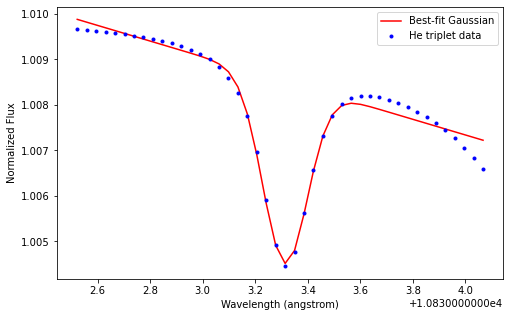

[ 1.00000000e+00  3.79981120e-03  1.31141640e+00  8.49461229e-02
 -1.61391446e-03  1.74921406e+01]


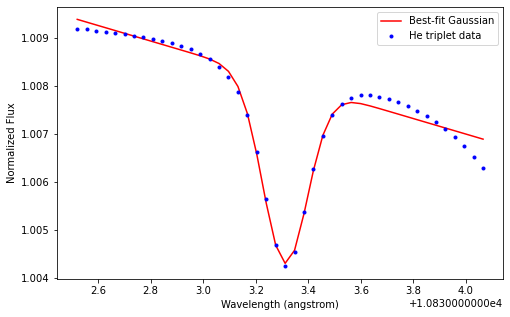

[ 9.99999999e-01  3.47470707e-03  1.31686090e+00  8.49806978e-02
 -1.48148494e-03  1.60568810e+01]


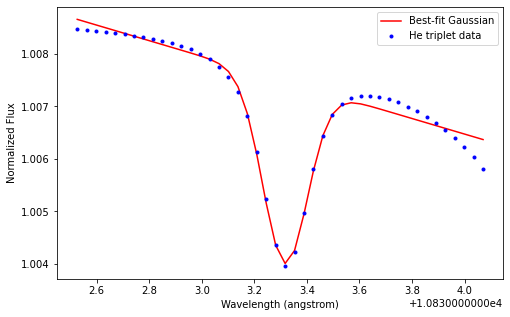

[ 1.00000000e+00  3.52784545e-03  1.31532305e+00  8.49460620e-02
 -1.50055801e-03  1.62635997e+01]


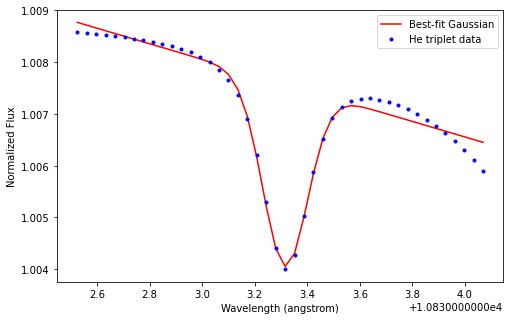

[ 9.99999998e-01  3.06162323e-03  1.31726761e+00  8.48845195e-02
 -1.29475773e-03  1.40331745e+01]


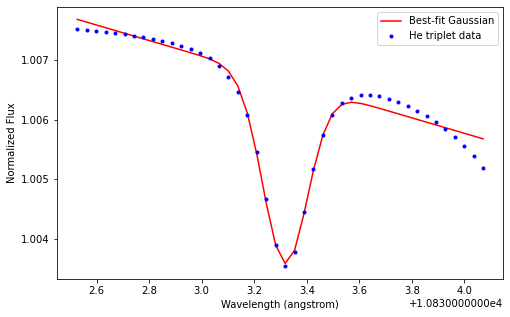

[ 9.99999999e-01  3.22322629e-03  1.31718225e+00  8.51281903e-02
 -1.38763507e-03  1.50397090e+01]


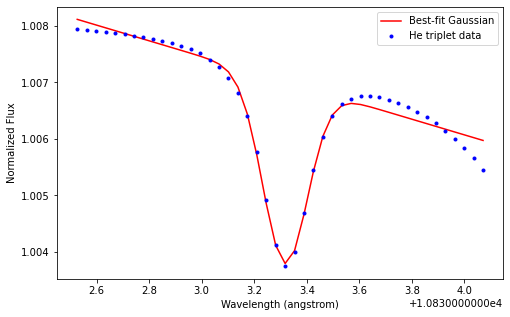

[ 1.00000000e+00  4.05299331e-03  1.31339563e+00  8.50291834e-02
 -1.73770830e-03  1.88337485e+01]


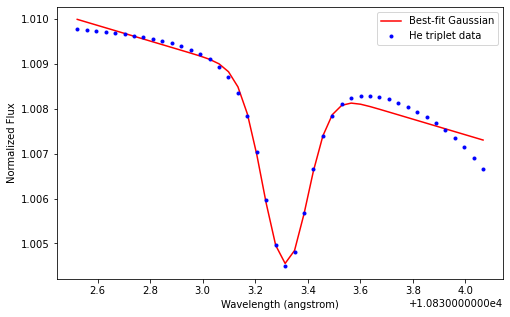

[ 1.00000000e+00  4.59837485e-03  1.30750609e+00  8.22919339e-02
 -2.10193014e-03  2.27806146e+01]


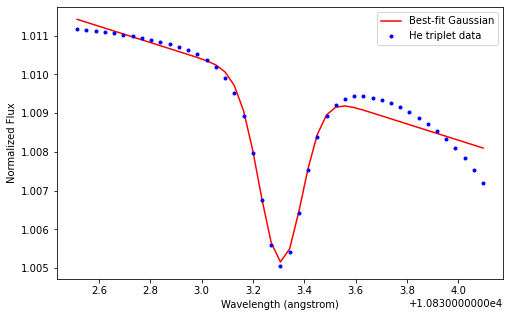

[ 9.99999999e-01  3.16118209e-03  1.31609792e+00  8.48571888e-02
 -1.33459872e-03  1.44649756e+01]


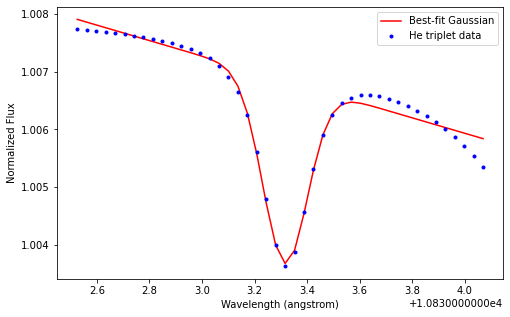

[ 1.00000000e+00  4.10117286e-03  1.31417352e+00  8.50843300e-02
 -1.76681418e-03  1.91491689e+01]


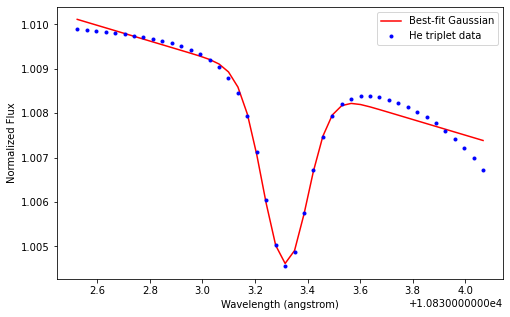

[ 1.00000000e+00  3.56737075e-03  1.31584657e+00  8.51793482e-02
 -1.54311293e-03  1.67247353e+01]


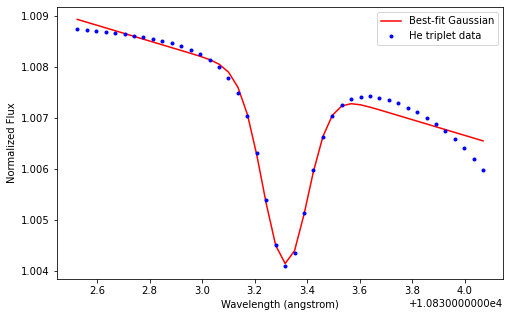

[ 9.99996984e-01  4.38001605e-03  1.31373765e+00  8.52599500e-02
 -1.91487808e-03  2.07537638e+01]


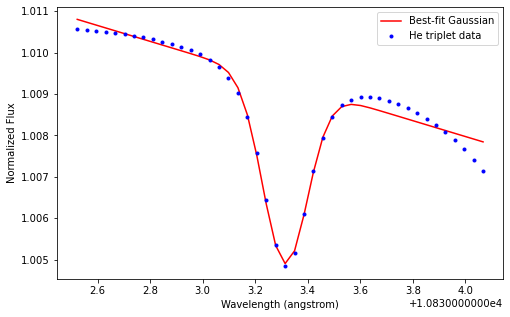

[ 9.99999998e-01  2.99379032e-03  1.31738477e+00  8.48364470e-02
 -1.26184172e-03  1.36764422e+01]


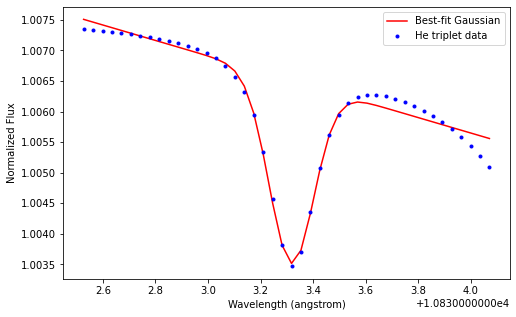

[ 1.00000000e+00  4.56363955e-03  1.30761657e+00  8.25242465e-02
 -2.09795071e-03  2.27374612e+01]


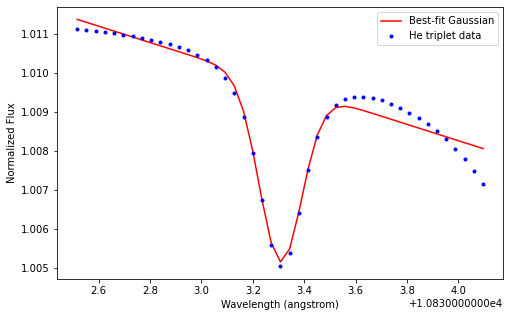

[ 9.99999999e-01  3.43245165e-03  1.31594073e+00  8.50051476e-02
 -1.46571057e-03  1.58859128e+01]


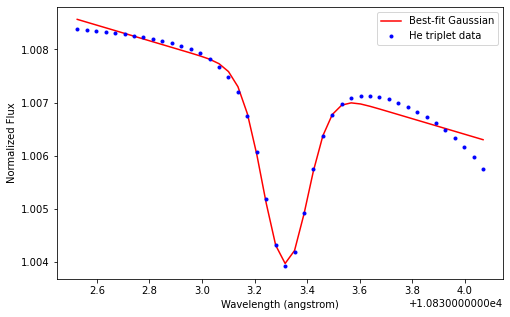

[ 1.00000000e+00  3.96912437e-03  1.31171563e+00  8.49995443e-02
 -1.69565968e-03  1.83780504e+01]


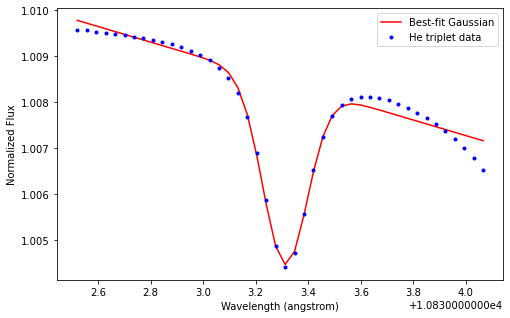

[ 1.00000000e+00  3.31278651e-03  1.31619948e+00  8.50965229e-02
 -1.42365609e-03  1.54301067e+01]


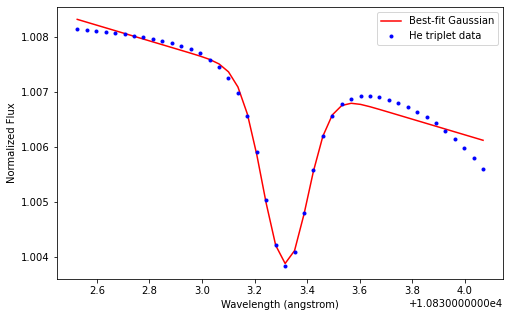

[ 9.99997780e-01  4.30046130e-03  1.31296044e+00  8.51589454e-02
 -1.86486609e-03  2.02117903e+01]


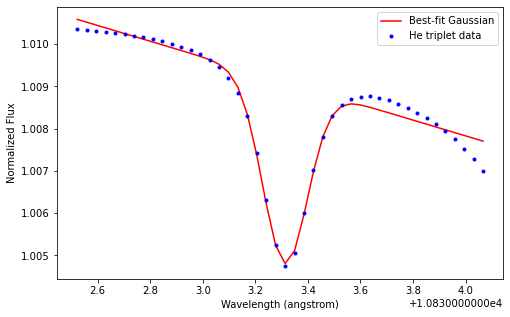

[ 9.99997977e-01  4.28564920e-03  1.31324782e+00  8.51414723e-02
 -1.85607105e-03  2.01164793e+01]


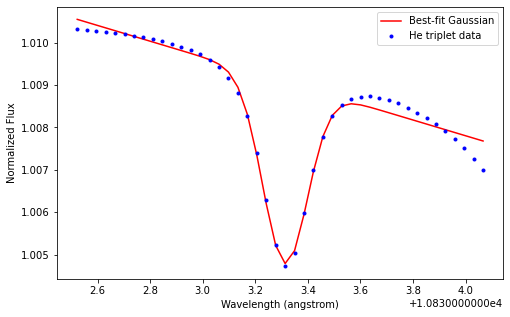

[ 1.00000000e+00  3.61380522e-03  1.31526015e+00  8.49155867e-02
 -1.53418710e-03  1.66280747e+01]


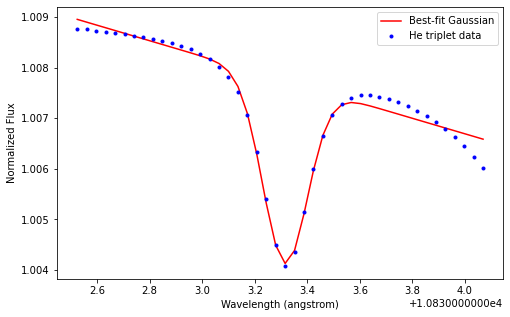

[ 1.00000000e+00  4.04408247e-03  1.31400223e+00  8.51463232e-02
 -1.74891162e-03  1.89551291e+01]


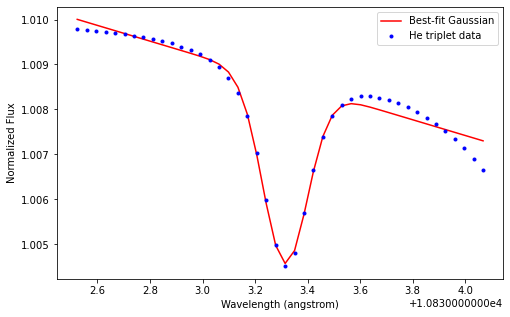

[ 9.99999899e-01  4.00950585e-03  1.31460408e+00  8.68948196e-02
 -1.77028132e-03  1.91867565e+01]


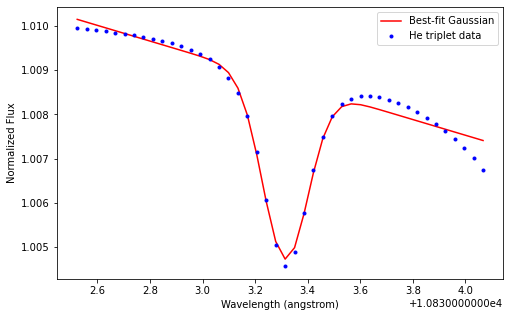

[ 9.99996828e-01  4.39122917e-03  1.31360947e+00  8.51708332e-02
 -1.90758550e-03  2.06747603e+01]


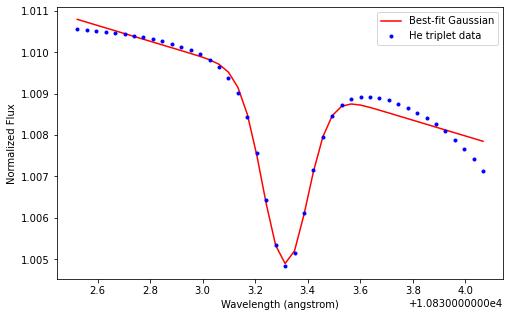

[ 9.99999967e-01  4.00718892e-03  1.30773215e+00  8.45291031e-02
 -1.83799821e-03  1.99202024e+01]


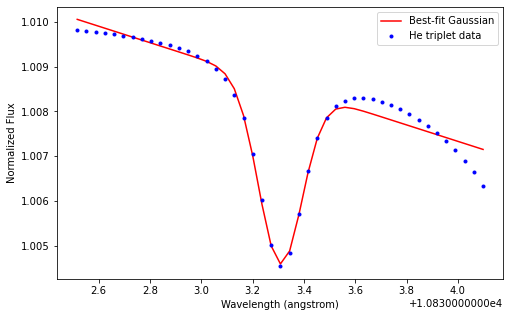

[ 9.99997814e-01  4.27769686e-03  1.31090121e+00  8.49441484e-02
 -1.82531444e-03  1.97832152e+01]


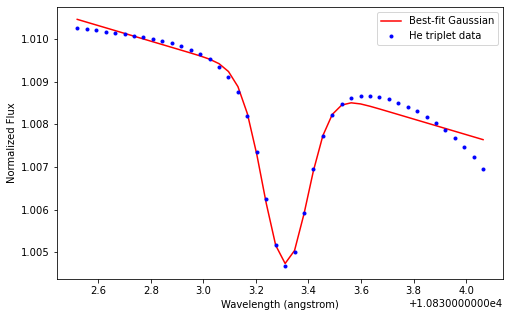

[ 9.99999718e-01  4.11087706e-03  1.31128406e+00  8.50325693e-02
 -1.76271532e-03  1.91047627e+01]


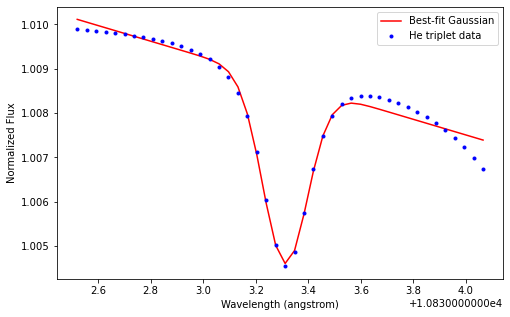

[ 9.99997561e-01  4.31296215e-03  1.31231973e+00  8.50864384e-02
 -1.86041551e-03  2.01635804e+01]


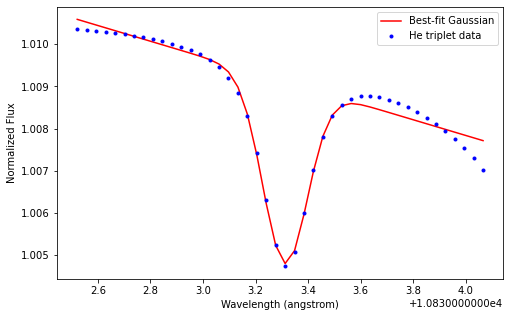

[ 1.00000000e+00  4.54392642e-03  1.31388017e+00  8.53277756e-02
 -1.98982050e-03  2.15659469e+01]


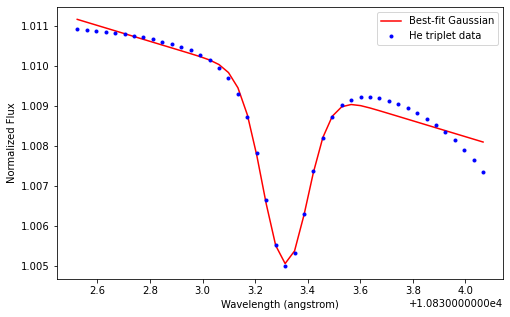

[ 1.00000000e+00  4.44068024e-03  1.31375387e+00  8.52865348e-02
 -1.93874267e-03  2.10124023e+01]


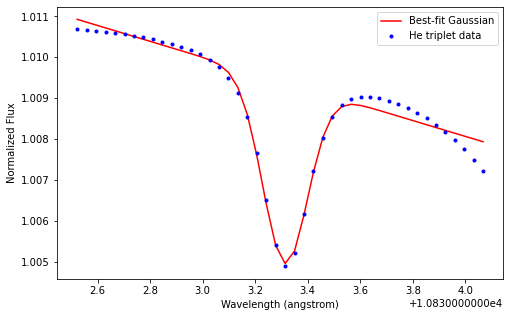

[ 9.99999999e-01  3.46486957e-03  1.31706912e+00  8.51529268e-02
 -1.49552339e-03  1.62089789e+01]


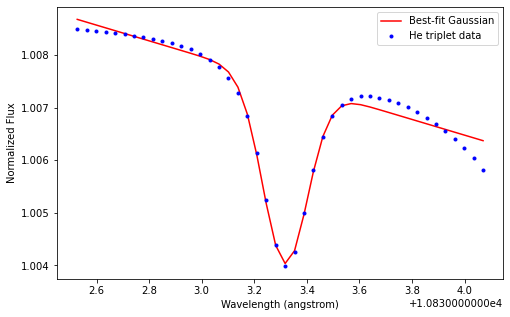

[ 1.00000000e+00  3.56907698e-03  1.31480736e+00  8.51631483e-02
 -1.54207031e-03  1.67134387e+01]


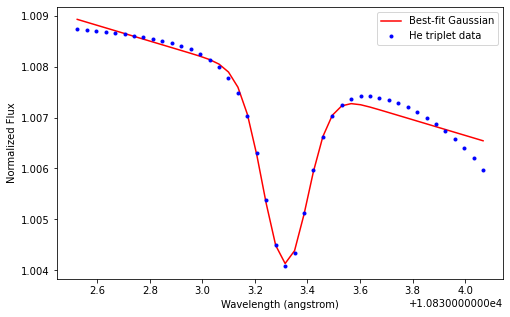

[ 1.00000000e+00  3.91659942e-03  1.31207031e+00  8.51252021e-02
 -1.68763519e-03  1.82910462e+01]


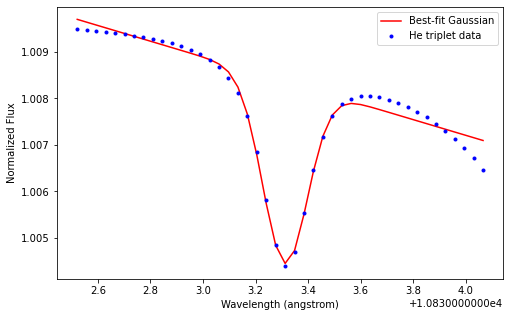

[ 1.00000000e+00  3.64435504e-03  1.31566231e+00  8.51619909e-02
 -1.57481826e-03  1.70683551e+01]


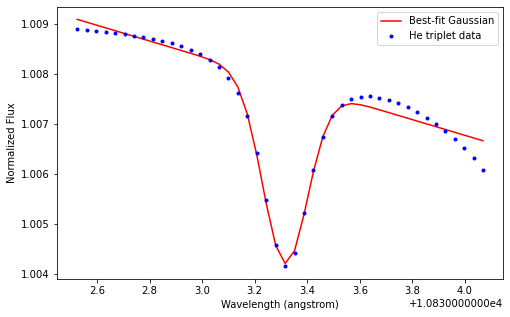

[ 1.00000000e+00  3.51363327e-03  1.31589387e+00  8.50912912e-02
 -1.51005683e-03  1.63665055e+01]


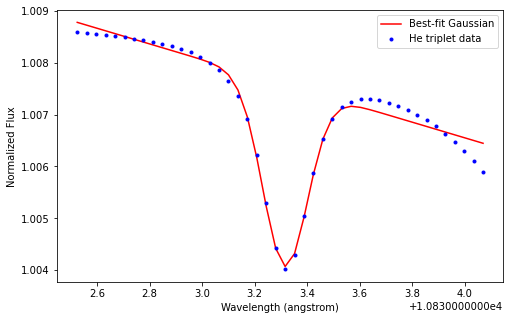

[ 1.00000000e+00  3.80631137e-03  1.31146526e+00  8.48865244e-02
 -1.60995138e-03  1.74492074e+01]


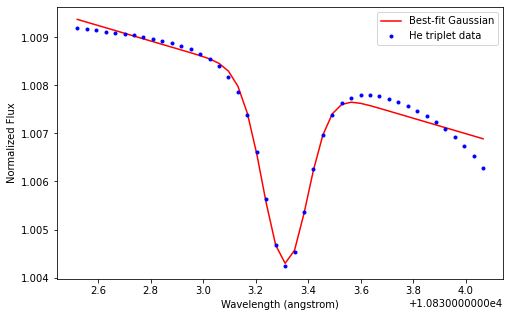

[ 1.00000000e+00  4.47805843e-03  1.30790224e+00  8.29199482e-02
 -2.06122454e-03  2.23394452e+01]


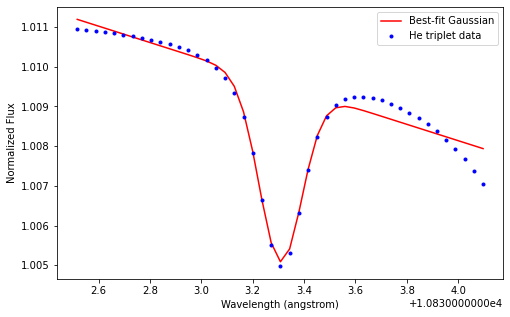

[ 9.99999311e-01  4.14494913e-03  1.31073284e+00  8.49959566e-02
 -1.77300146e-03  1.92162511e+01]


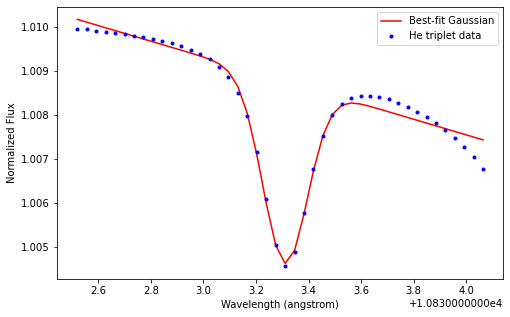

[ 1.00000000e+00  4.68822148e-03  1.30754829e+00  8.19556912e-02
 -2.14638637e-03  2.32623911e+01]


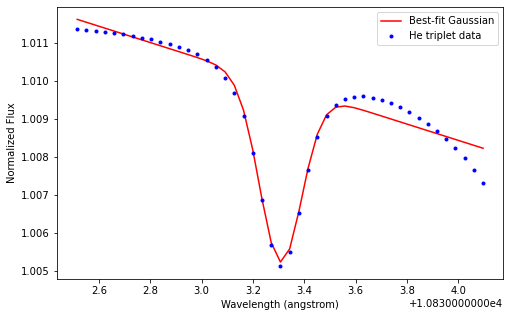

[ 1.00000000e+00  3.51821601e-03  1.31491886e+00  8.51071601e-02
 -1.51370971e-03  1.64060888e+01]


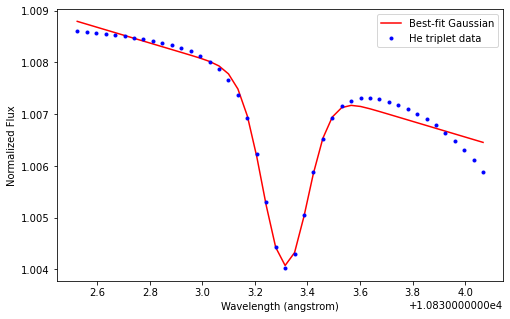

[ 9.99987898e-01  4.91127569e-03  1.30657041e+00  8.41564213e-02
 -2.19255958e-03  2.37628670e+01]


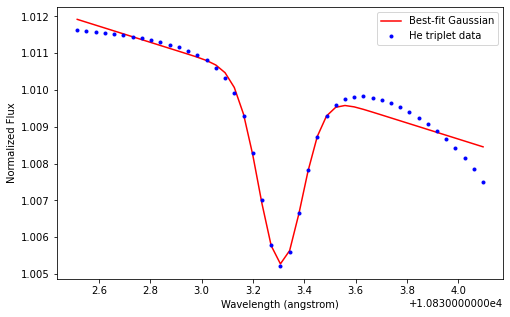

[ 9.99999999e-01  3.29873534e-03  1.31754044e+00  8.50415937e-02
 -1.41173295e-03  1.53009029e+01]


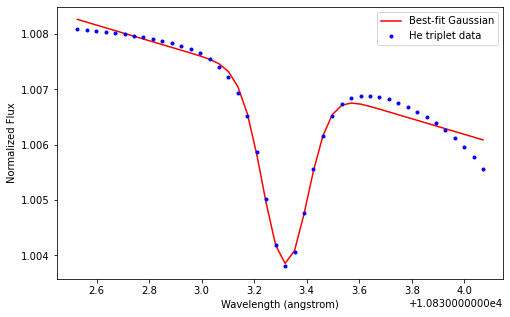

[ 9.99998822e-01  4.20392100e-03  1.31271504e+00  8.51018696e-02
 -1.81393758e-03  1.96598674e+01]


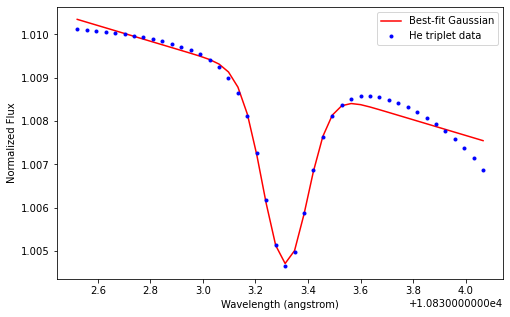

[ 1.00000000e+00  4.35305977e-03  1.30772440e+00  8.33142792e-02
 -1.99000632e-03  2.15676628e+01]


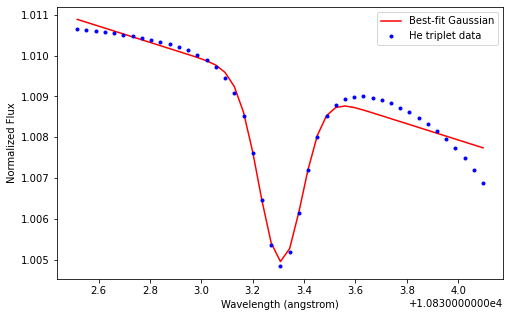

[ 1.00000000e+00  4.65847359e-03  1.30755205e+00  8.20624613e-02
 -2.13067988e-03  2.30921807e+01]


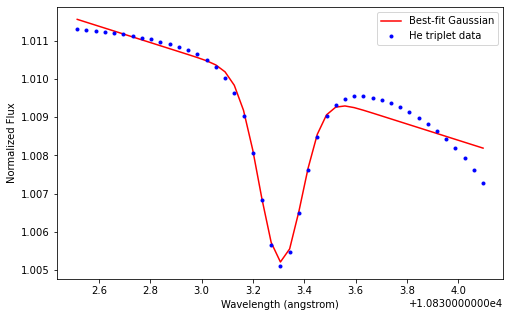

[ 9.99999999e-01  3.47330592e-03  1.31450831e+00  8.47784004e-02
 -1.45963939e-03  1.58201755e+01]


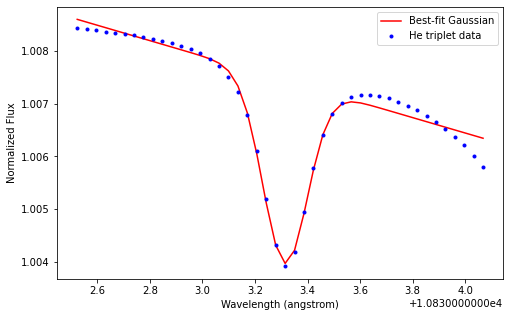

[ 1.00000000e+00  4.04293680e-03  1.31056503e+00  8.49673437e-02
 -1.84907432e-03  2.00403510e+01]


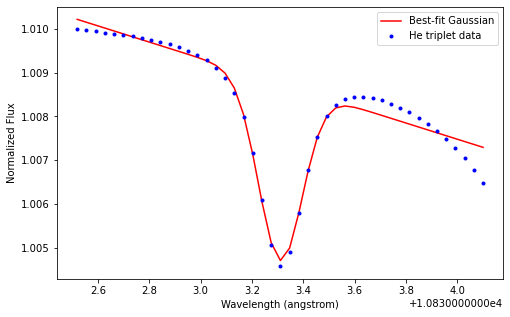

[ 9.99999959e-01  3.97472785e-03  1.30750345e+00  8.41898504e-02
 -1.77554190e-03  1.92434495e+01]


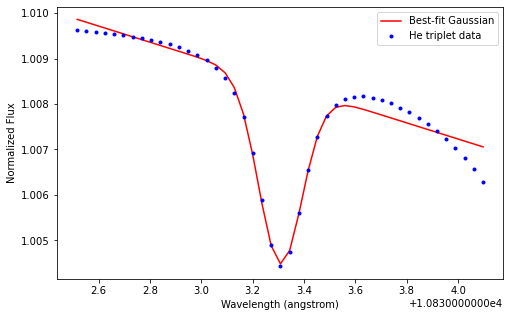

[ 9.99998476e-01  4.24609390e-03  1.31384137e+00  8.52111432e-02
 -1.84804894e-03  2.00295164e+01]


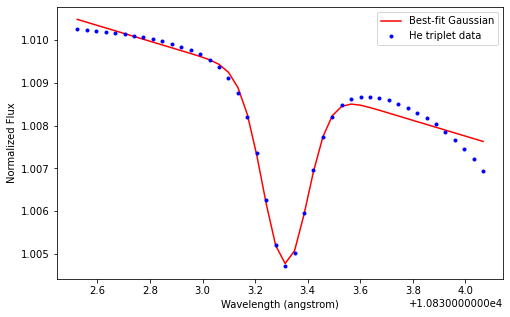

[ 1.00000000e+00  4.26787422e-03  1.30734354e+00  8.33957278e-02
 -1.91825171e-03  2.07901088e+01]


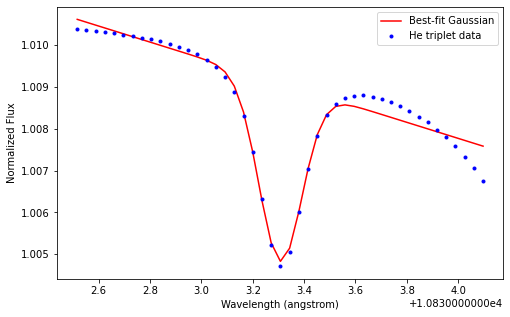

[ 9.99999475e-01  4.13656892e-03  1.31186556e+00  8.51781999e-02
 -1.79312103e-03  1.94342415e+01]


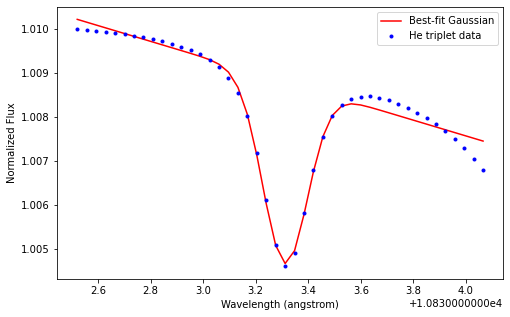

[ 9.99999903e-01  3.89490081e-03  1.31020619e+00  8.40074798e-02
 -1.71619142e-03  1.86002999e+01]


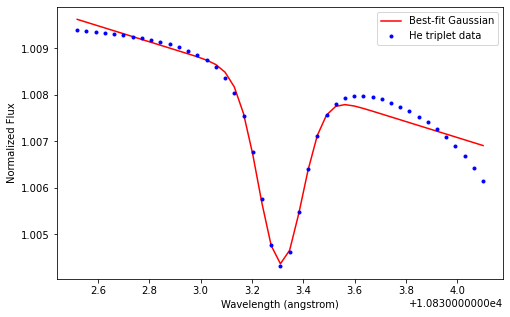

[ 1.00000000e+00  3.71879439e-03  1.31448105e+00  8.49729195e-02
 -1.58573697e-03  1.71867438e+01]


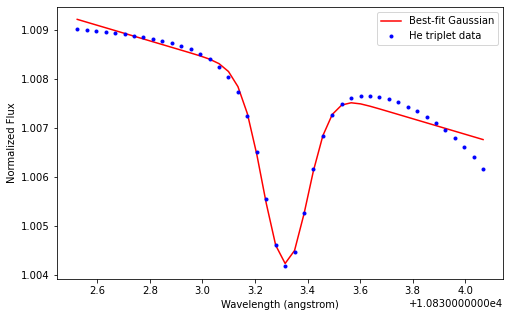

[ 1.00000000e+00  3.99941542e-03  1.31200447e+00  8.50234600e-02
 -1.71226387e-03  1.85579931e+01]


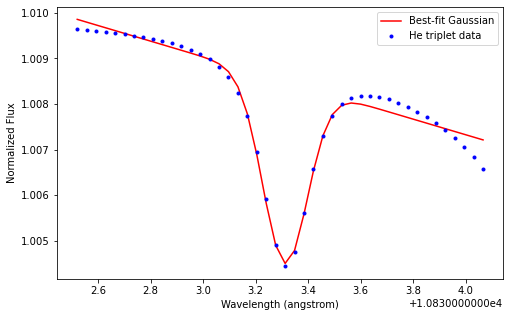

[ 9.99967058e-01  3.36126613e-03  1.31680215e+00  8.49887875e-02
 -1.43382163e-03  1.55403422e+01]


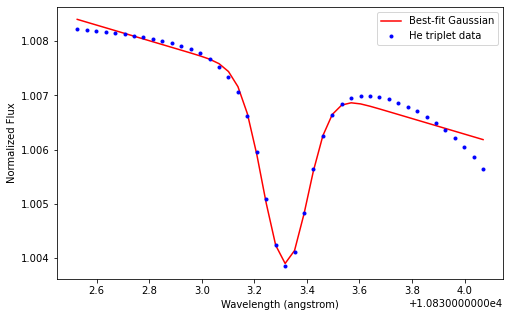

[ 1.00000000e+00  4.67756173e-03  1.30747933e+00  8.20110194e-02
 -2.14454102e-03  2.32423850e+01]


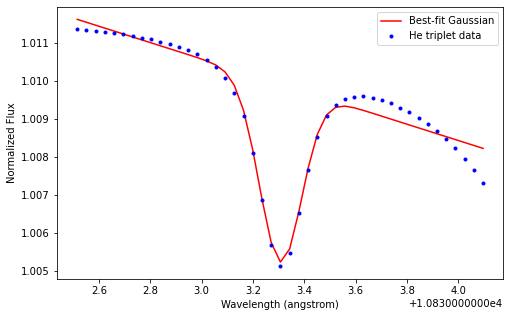

[ 1.00000000e+00  4.24873076e-03  1.30757946e+00  8.36195782e-02
 -1.92708769e-03  2.08858270e+01]


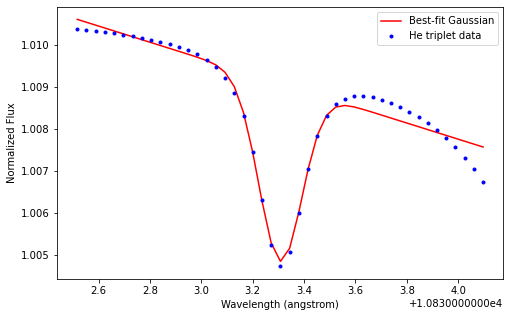

[ 1.00000000e+00  4.20827689e-03  1.30755956e+00  8.37929921e-02
 -1.91021784e-03  2.07029981e+01]


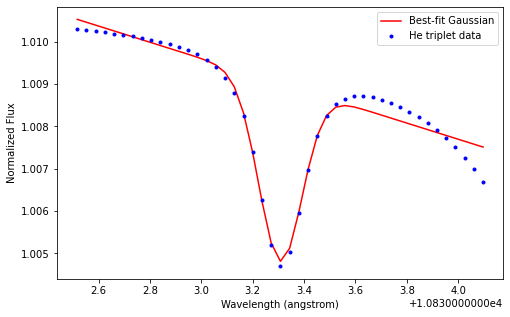

[ 9.99987016e-01  4.96681913e-03  1.30654239e+00  8.42709061e-02
 -2.23680633e-03  2.42423390e+01]


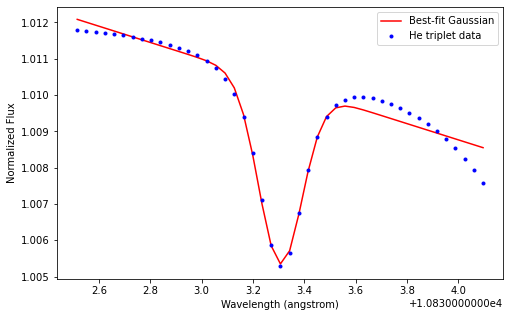

[ 9.99998911e-01  4.19704009e-03  1.31290429e+00  8.52181245e-02
 -1.82619324e-03  1.97926514e+01]


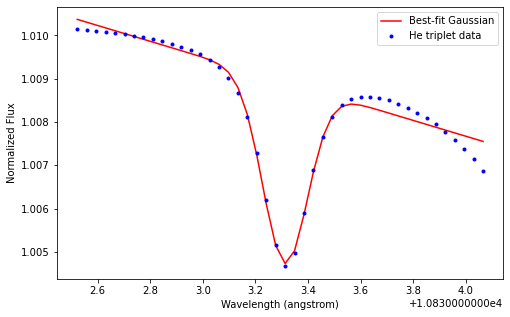

[ 1.00000000e+00  3.77518066e-03  1.31549716e+00  8.50817750e-02
 -1.62139536e-03  1.75731773e+01]


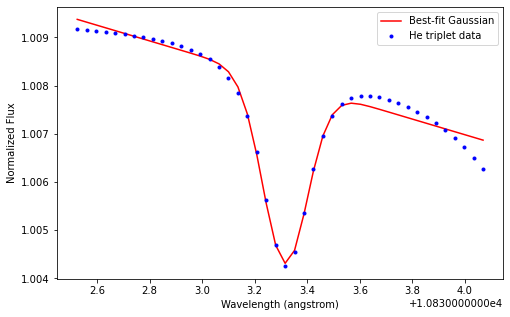

[ 9.99999939e-01  4.41495906e-03  1.31362065e+00  8.51935317e-02
 -1.91487531e-03  2.07537691e+01]


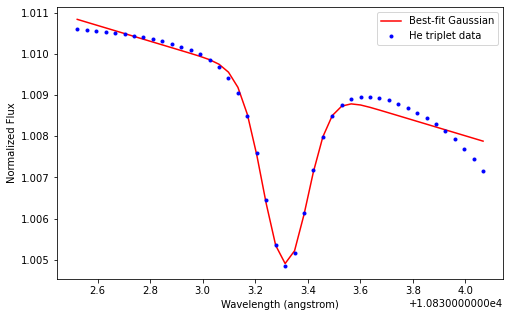

[ 9.99999020e-01  4.18828843e-03  1.31308692e+00  8.52810711e-02
 -1.83070977e-03  1.98415791e+01]


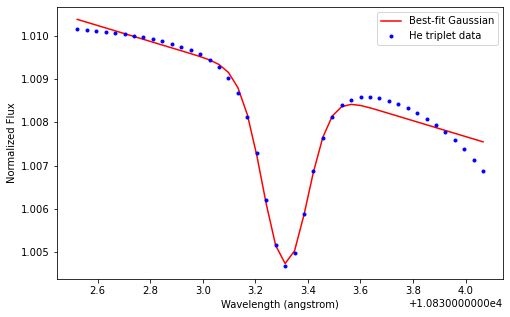

[ 9.99999066e-01  4.16710679e-03  1.31081174e+00  8.51523836e-02
 -1.80299650e-03  1.95412754e+01]


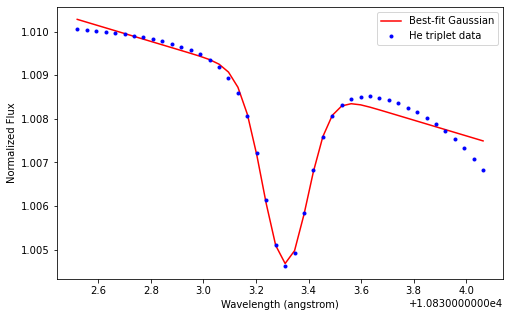

[ 9.99999956e-01  4.44581538e-03  1.31327562e+00  8.52606353e-02
 -1.93745432e-03  2.09984476e+01]


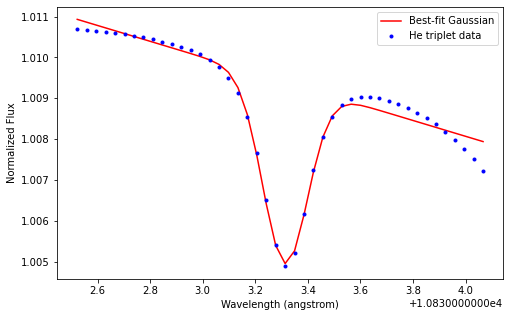

[ 9.99999999e-01  3.25844158e-03  1.31709146e+00  8.49151710e-02
 -1.38174839e-03  1.49759668e+01]


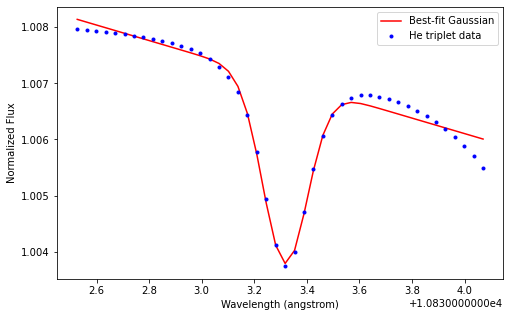

[ 9.99999998e-01  3.04766071e-03  1.31659429e+00  8.49058102e-02
 -1.29076059e-03  1.39898473e+01]


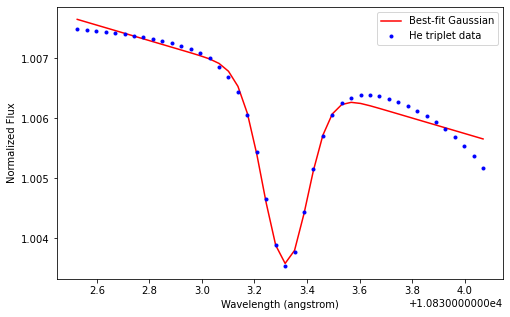

[ 1.00000000e+00  4.15376947e-03  1.30751455e+00  8.40280868e-02
 -1.88811062e-03  2.04634066e+01]


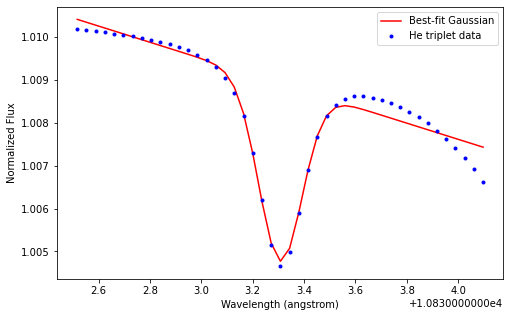

[ 9.99999998e-01  3.02646450e-03  1.31665022e+00  8.48716822e-02
 -1.27858211e-03  1.38578658e+01]


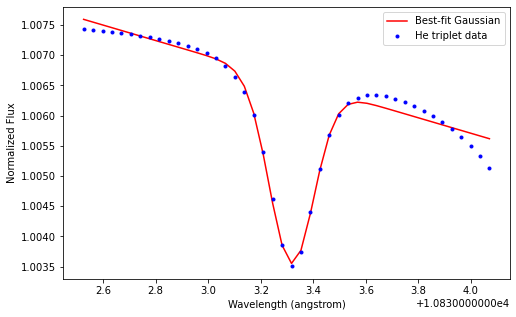

[ 1.00000000e+00  3.53933767e-03  1.31571566e+00  8.51290607e-02
 -1.52528845e-03  1.65315718e+01]


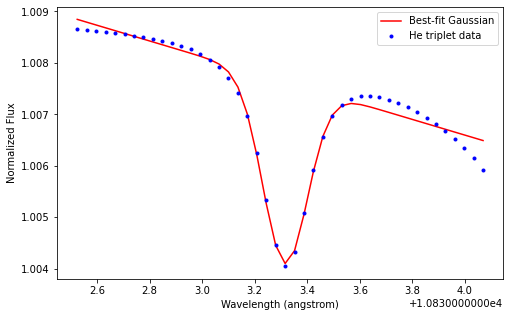

[ 1.00000000e+00  3.59479925e-03  1.31496879e+00  8.50106245e-02
 -1.53638448e-03  1.66518615e+01]


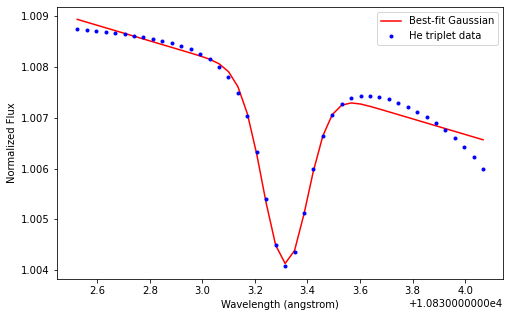

[ 1.00000000e+00  3.55124658e-03  1.31483849e+00  8.49576370e-02
 -1.51186277e-03  1.63861148e+01]


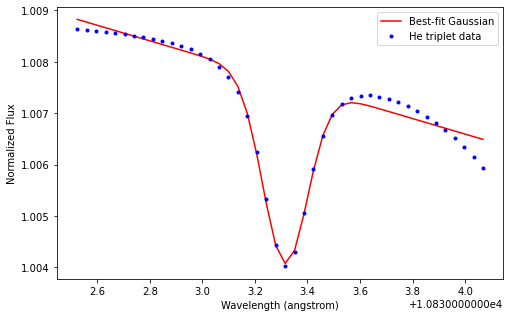

[ 1.00000000e+00  4.53858150e-03  1.30793835e+00  8.25281868e-02
 -2.06611573e-03  2.23925065e+01]


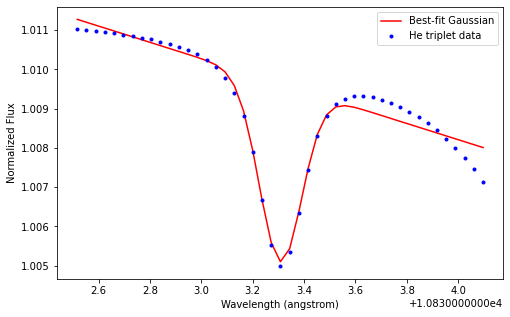

[ 9.99999968e-01  4.01949278e-03  1.30761887e+00  8.43412262e-02
 -1.81723125e-03  1.96952052e+01]


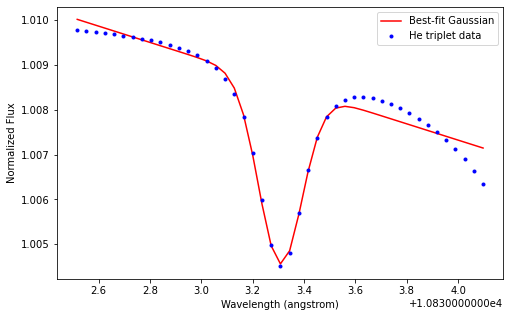

[ 1.00000000e+00  4.12757260e-03  1.30779412e+00  8.43452579e-02
 -1.90295334e-03  2.06241998e+01]


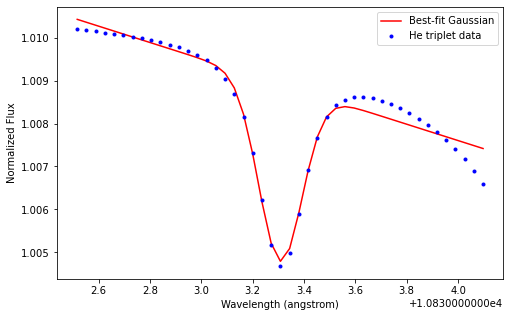

[ 9.99999235e-01  4.15997132e-03  1.31196758e+00  8.50912816e-02
 -1.79247652e-03  1.94272844e+01]


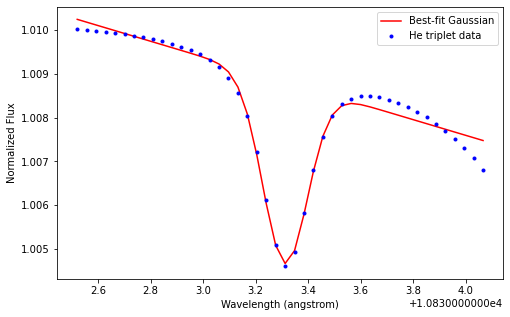

[ 1.00000000e+00  4.02173214e-03  1.31110832e+00  8.50122612e-02
 -1.72040309e-03  1.86462056e+01]


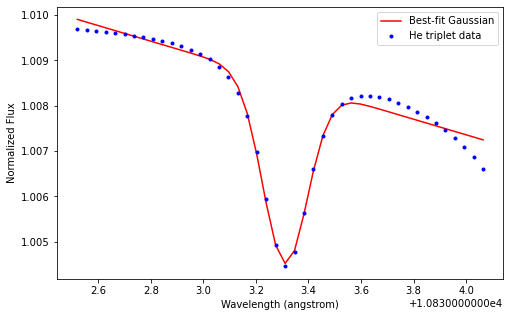

[ 1.00000000e+00  4.07700732e-03  1.31333852e+00  8.50313313e-02
 -1.74863360e-03  1.89521518e+01]


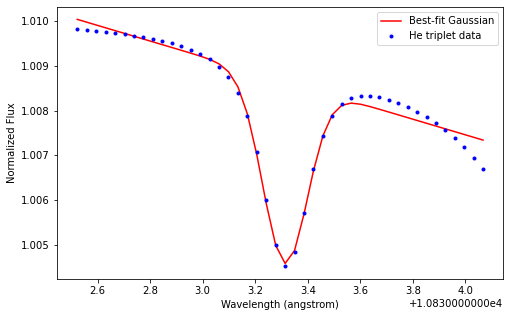

[ 1.00000000e+00  3.40322332e-03  1.31627307e+00  8.51828590e-02
 -1.47185991e-03  1.59525086e+01]


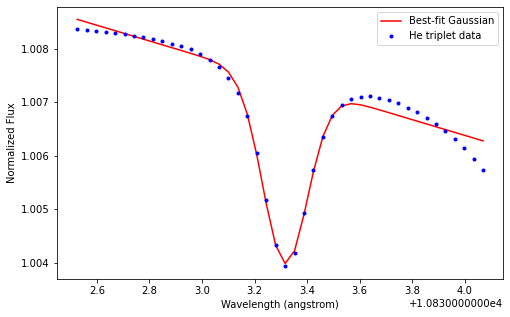

[ 1.00000000e+00  3.51430010e-03  1.31577967e+00  8.51453097e-02
 -1.51625221e-03  1.64336341e+01]


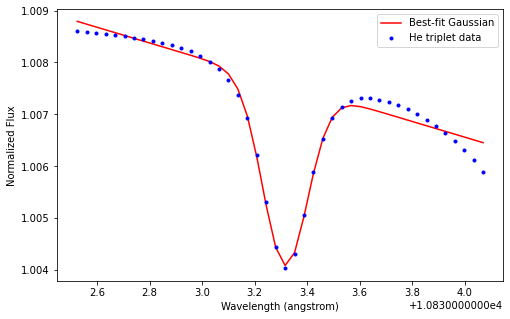

[ 9.99999999e-01  3.42046839e-03  1.31507569e+00  8.49392010e-02
 -1.45365979e-03  1.57553254e+01]


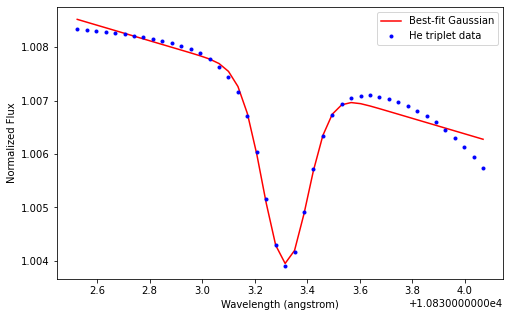

[ 1.00000000e+00  3.55476917e-03  1.31465205e+00  8.49250723e-02
 -1.50989092e-03  1.63647533e+01]


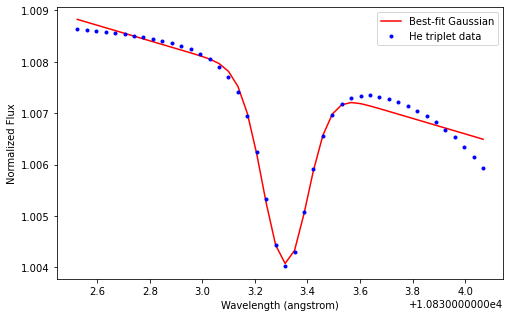

[ 9.99999999e-01  3.28536293e-03  1.31759766e+00  8.50108384e-02
 -1.40280249e-03  1.52041242e+01]


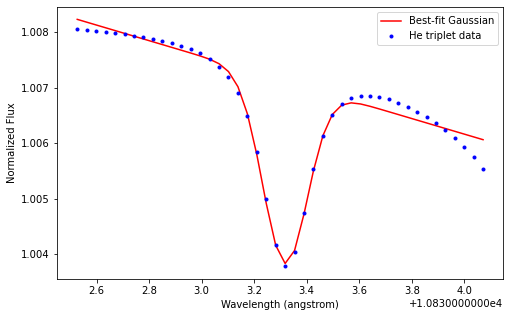

[ 1.00000000e+00  4.04817157e-03  1.31104008e+00  8.49107119e-02
 -1.71950915e-03  1.86365488e+01]


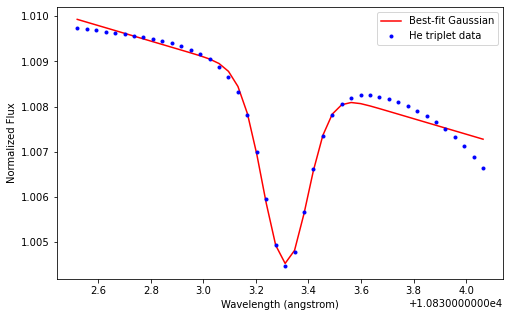

[ 1.00000000e+00  3.57386555e-03  1.31545126e+00  8.49793880e-02
 -1.52395243e-03  1.65171350e+01]


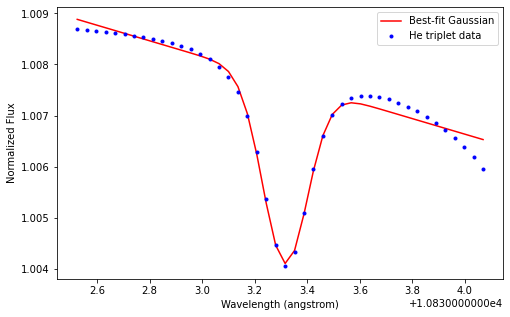

[ 1.00000000e+00  4.15617661e-03  1.30700831e+00  8.38755807e-02
 -1.87680774e-03  2.03409393e+01]


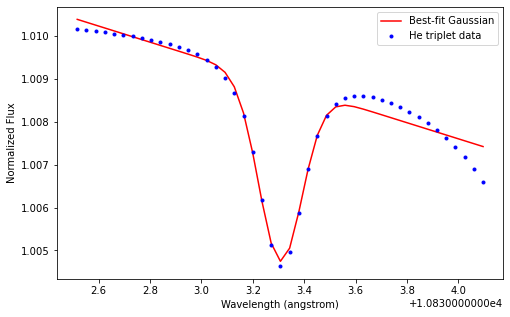

[ 9.99999802e-01  4.10197368e-03  1.31093223e+00  8.48889495e-02
 -1.74053955e-03  1.88644750e+01]


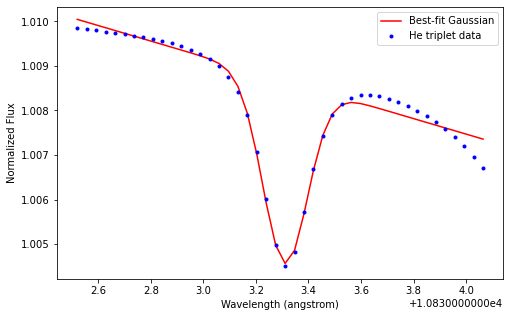

[ 1.00000000e+00  3.74472033e-03  1.31692646e+00  8.52513437e-02
 -1.62915830e-03  1.76572583e+01]


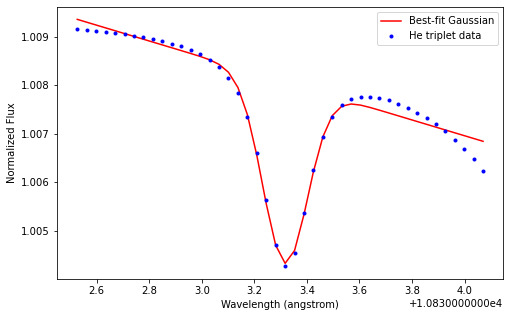

[ 9.99999956e-01  3.96665631e-03  1.30743404e+00  8.40061976e-02
 -1.74705573e-03  1.89347912e+01]


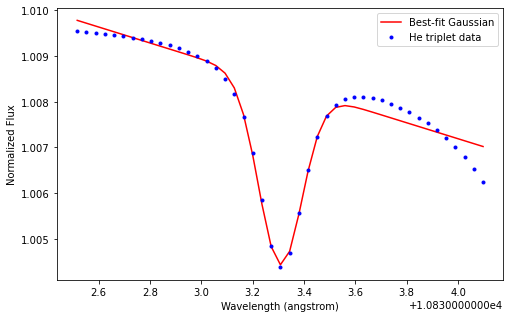

[ 1.00000000e+00  3.98802806e-03  1.31213959e+00  8.51855350e-02
 -1.72726557e-03  1.87205259e+01]


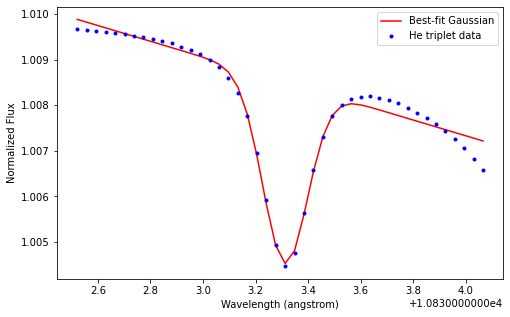

[ 1.00000000e+00  4.07798302e-03  1.31257878e+00  8.50042099e-02
 -1.74517800e-03  1.89147096e+01]


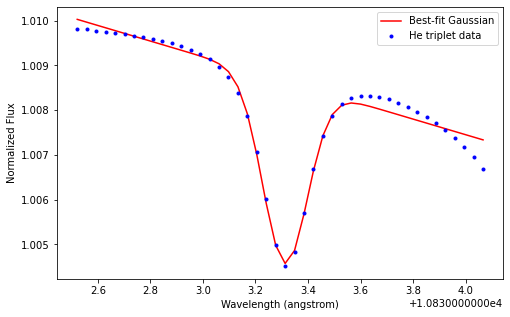

[ 9.99999577e-01  4.14473630e-03  1.31431261e+00  8.52160650e-02
 -1.80349641e-03  1.95466735e+01]


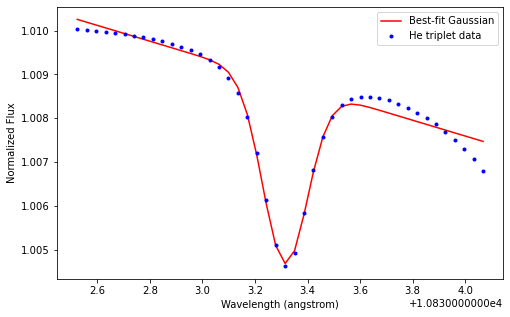

[ 1.00000000e+00  3.79665105e-03  1.31158489e+00  8.49465676e-02
 -1.61264230e-03  1.74783534e+01]


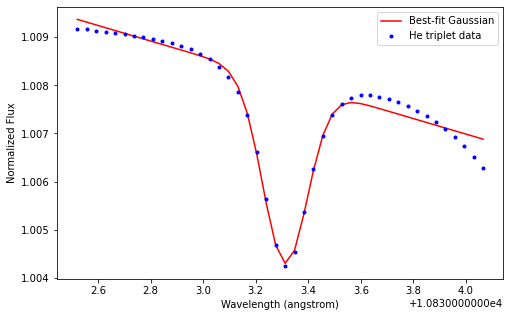

[ 9.99997604e-01  4.31646050e-03  1.31301689e+00  8.51346560e-02
 -1.86883704e-03  2.02548337e+01]


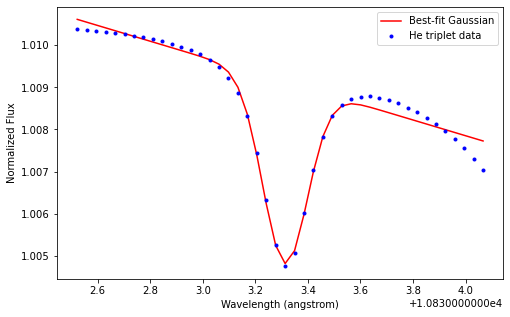

[ 1.00000000e+00  3.95852457e-03  1.31406490e+00  8.51848634e-02
 -1.71525665e-03  1.85903787e+01]


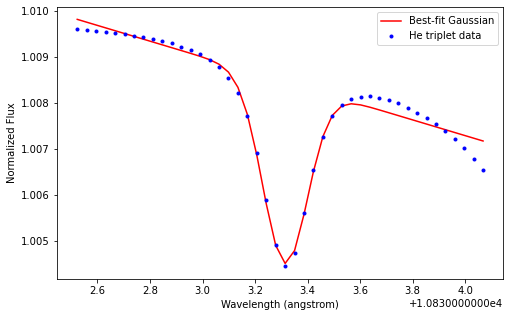

[ 9.99999441e-01  4.13532080e-03  1.31119201e+00  8.51538114e-02
 -1.78902851e-03  1.93898960e+01]


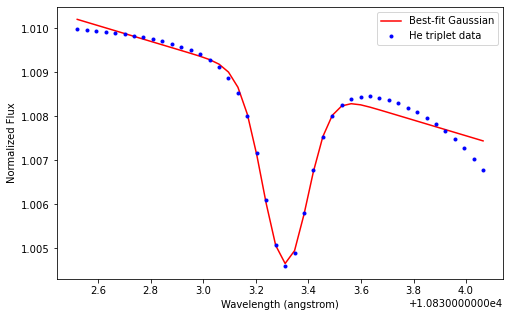

[ 9.99999314e-01  4.15855681e-03  1.31276985e+00  8.50964006e-02
 -1.79297954e-03  1.94327347e+01]


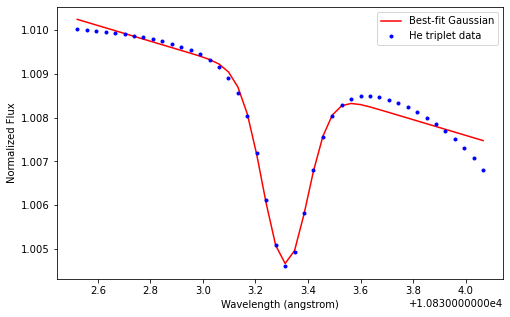

[ 1.00000000e+00  4.16229216e-03  1.30705482e+00  8.37354254e-02
 -1.86167513e-03  2.01769851e+01]


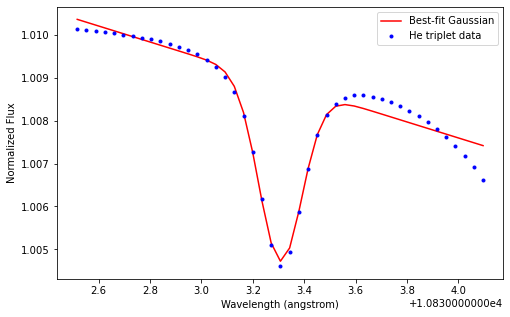

[ 1.00000000e+00  3.36237336e-03  1.31516404e+00  8.51033645e-02
 -1.44622894e-03  1.56747435e+01]


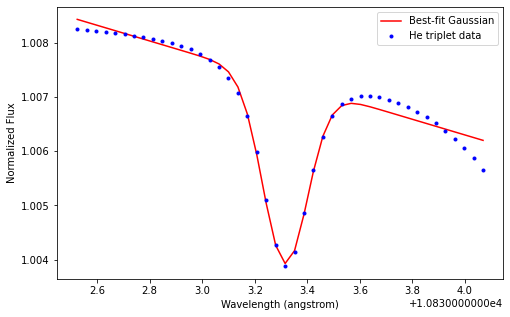

[ 1.00000000e+00  4.04943292e-03  1.30737068e+00  8.43983096e-02
 -1.83484008e-03  1.98861050e+01]


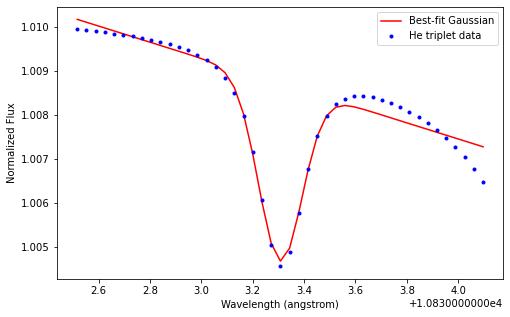

[ 1.00000000e+00  3.95535065e-03  1.31435118e+00  8.50950607e-02
 -1.70300530e-03  1.84576309e+01]


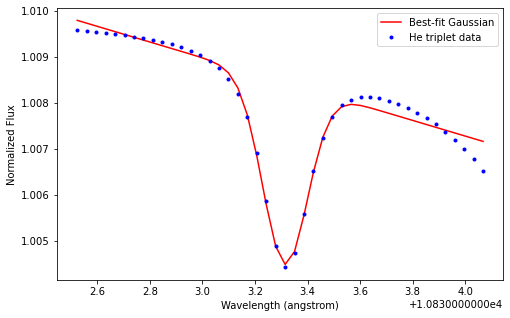

[ 9.99998801e-01  4.20339646e-03  1.31241670e+00  8.50203711e-02
 -1.80294709e-03  1.95407832e+01]


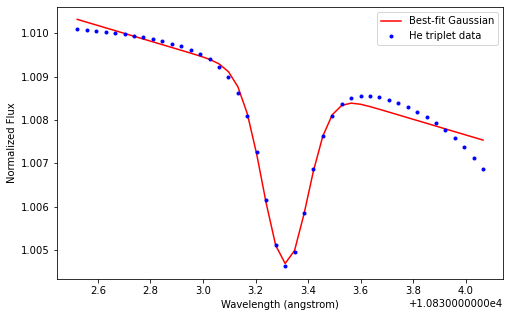

[ 9.99999595e-01  4.13226799e-03  1.31282900e+00  8.51190544e-02
 -1.78415662e-03  1.93371082e+01]


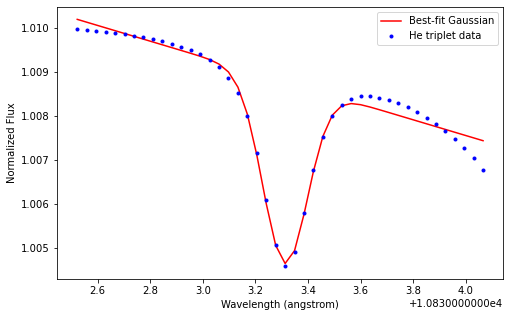

[ 1.00000000e+00  4.03610872e-03  1.31140514e+00  8.51496942e-02
 -1.74405735e-03  1.89025188e+01]


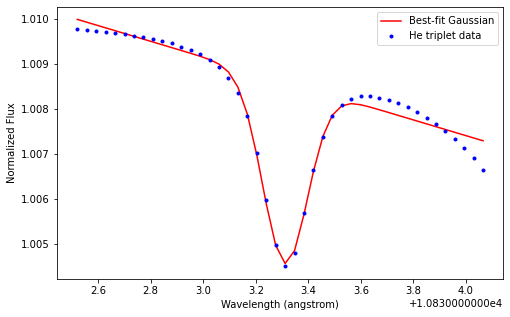

[ 1.00000000e+00  4.08534064e-03  1.31251542e+00  8.49644425e-02
 -1.74344230e-03  1.88959111e+01]


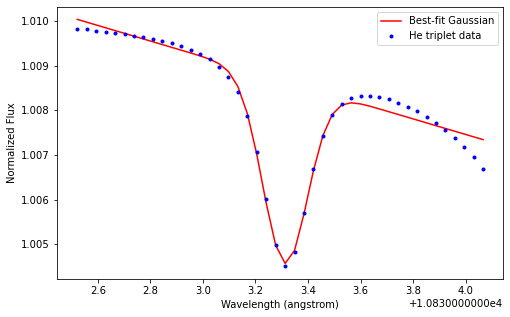

[ 1.00000000e+00  4.55001061e-03  1.30753277e+00  8.24928941e-02
 -2.08004740e-03  2.25434647e+01]


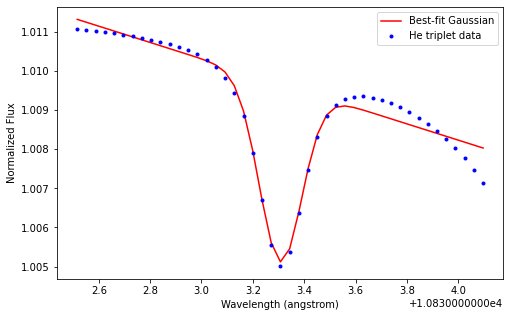

[ 1.00000000e+00  3.98278820e-03  1.31413432e+00  8.52472066e-02
 -1.73409264e-03  1.87944959e+01]


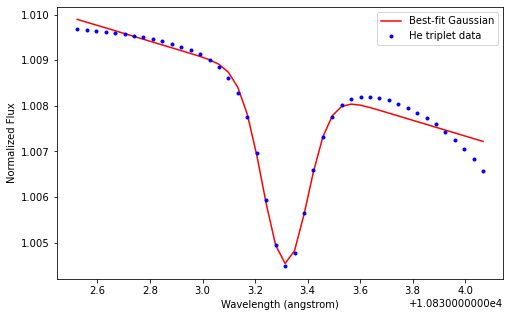

[ 1.00000000e+00  3.69394481e-03  1.31553783e+00  8.51405887e-02
 -1.59404074e-03  1.72766899e+01]


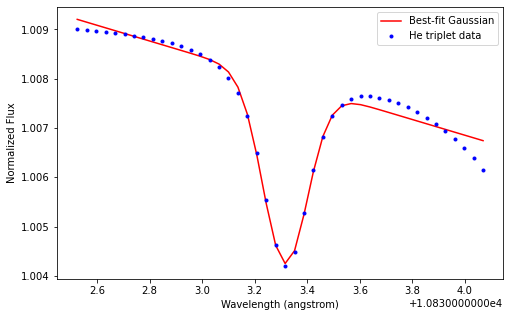

[ 1.00000000e+00  4.19798444e-03  1.30717069e+00  8.36498865e-02
 -1.88487822e-03  2.04284301e+01]


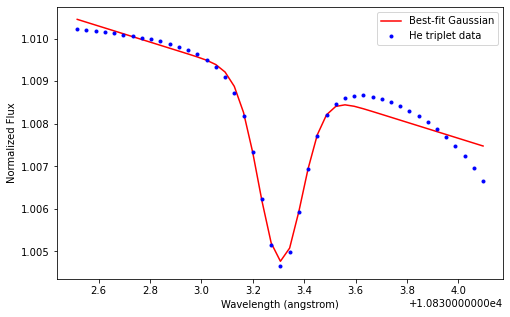

[ 1.00000000e+00  4.00606997e-03  1.31424028e+00  8.51531919e-02
 -1.73292878e-03  1.87819115e+01]


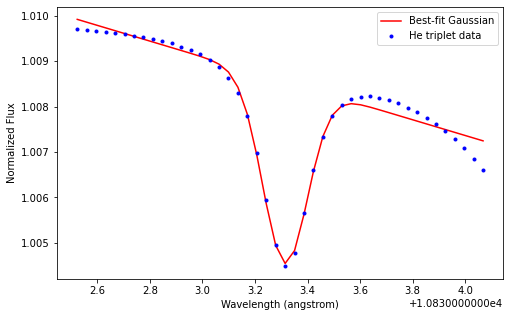

[ 9.99998090e-01  4.25391066e-03  1.31086018e+00  8.50547714e-02
 -1.82914885e-03  1.98247351e+01]


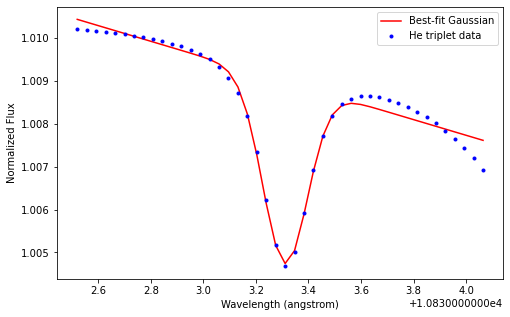

[ 9.99999998e-01  3.12613036e-03  1.31733878e+00  8.49376406e-02
 -1.32735812e-03  1.43864827e+01]


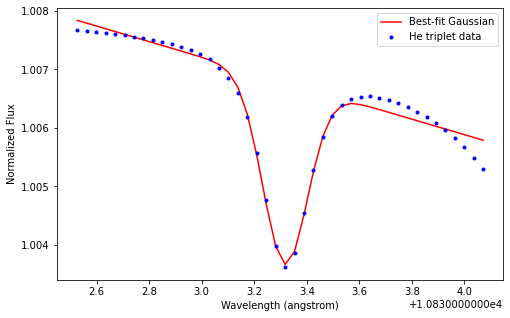

[ 1.00000000e+00  3.32588394e-03  1.31603248e+00  8.47762078e-02
 -1.39706834e-03  1.51420383e+01]


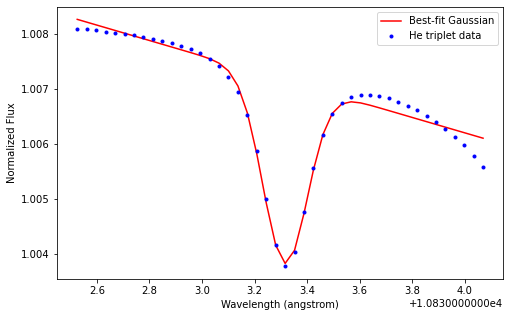

[ 9.99997428e-01  4.32489170e-03  1.31237484e+00  8.50685024e-02
 -1.86335541e-03  2.01954478e+01]


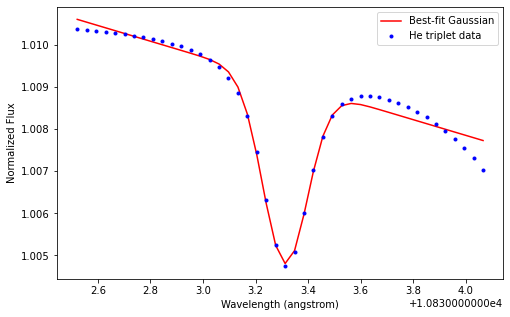

[ 1.00000000e+00  3.52710881e-03  1.31459470e+00  8.49514539e-02
 -1.50080810e-03  1.62663076e+01]


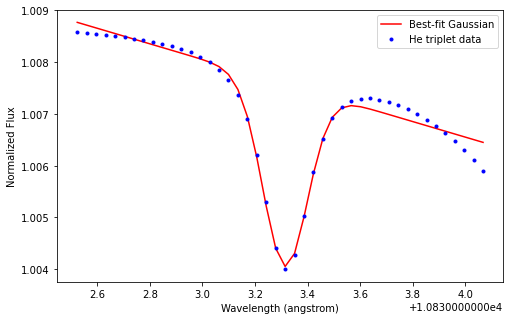

[ 1.00000000e+00  3.54361970e-03  1.31502423e+00  8.49822158e-02
 -1.51123687e-03  1.63793246e+01]


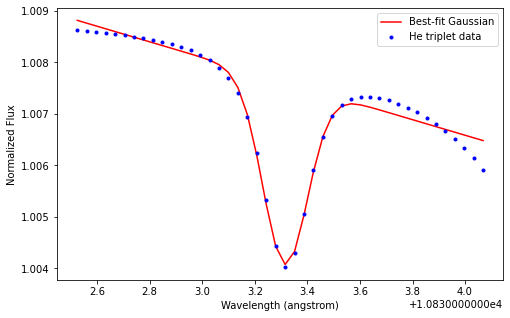

[ 1.00000000e+00  3.55415898e-03  1.31635168e+00  8.52893777e-02
 -1.54945919e-03  1.67934834e+01]


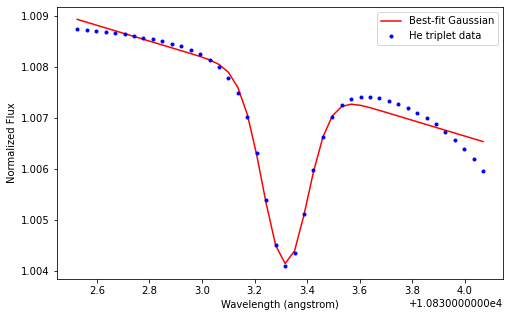

[ 9.99999719e-01  4.10751344e-03  1.31067049e+00  8.49598458e-02
 -1.75180427e-03  1.89865354e+01]


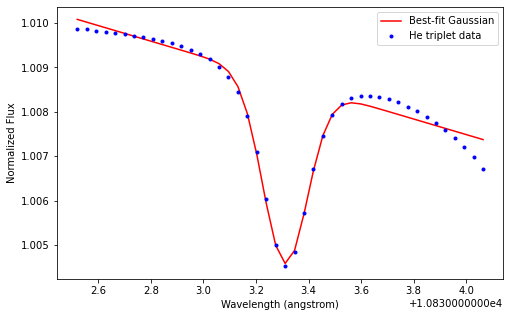

[ 9.99999540e-01  4.12736493e-03  1.31135107e+00  8.51089374e-02
 -1.77977508e-03  1.92896256e+01]


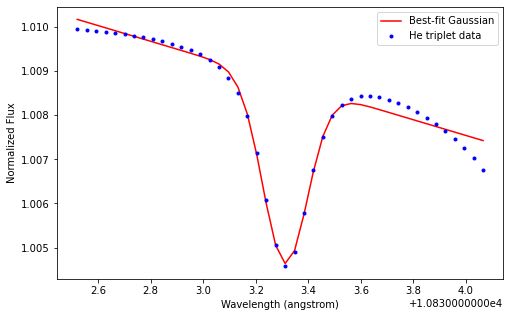

[ 9.99998037e-01  4.26780915e-03  1.31192649e+00  8.51392124e-02
 -1.84699369e-03  2.00181031e+01]


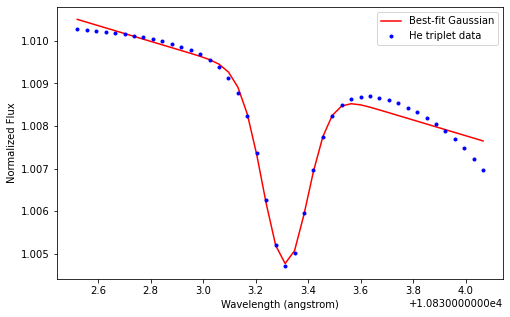

[ 1.00000000e+00  4.52058033e-03  1.30743287e+00  8.26217553e-02
 -2.06978451e-03  2.24322346e+01]


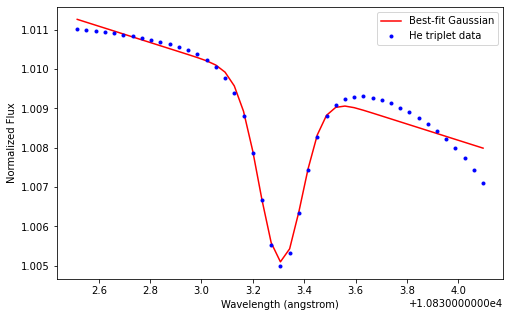

[ 1.00000000e+00  3.58944447e-03  1.32641692e+00  8.76628986e-02
 -1.32321813e-03  1.43424068e+01]


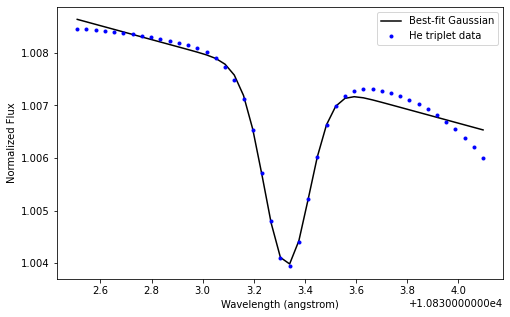

[ 1.00000000e+00  4.00466722e-03  1.32642420e+00  8.79310287e-02
 -1.52078043e-03  1.64835180e+01]


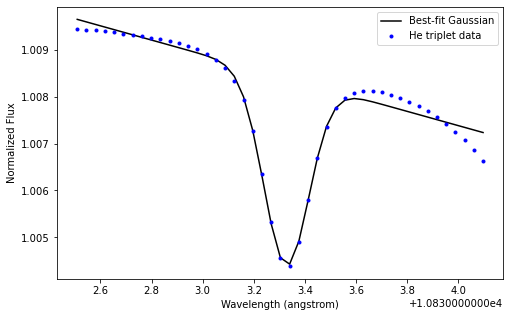

[ 1.00000000e+00  3.36212569e-03  1.32119242e+00  8.93587496e-02
 -1.40020077e-03  1.51762520e+01]


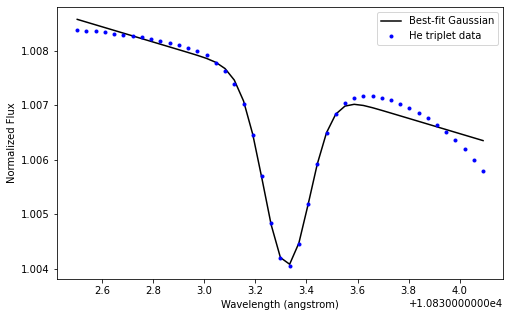

[ 1.00000000e+00  2.82399074e-03  1.31873069e+00  8.94626941e-02
 -1.17893291e-03  1.27781035e+01]


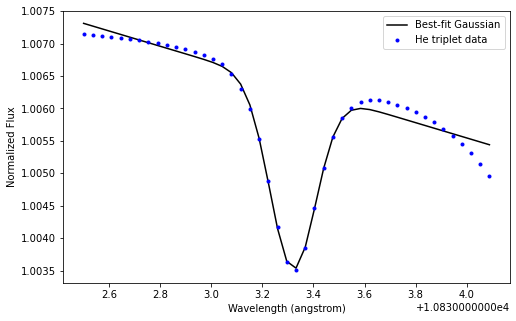

[ 1.00000000e+00  3.48151888e-03  1.32251760e+00  8.92212146e-02
 -1.44092668e-03  1.56176703e+01]


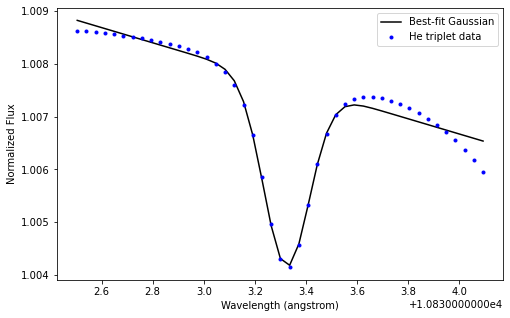

[ 1.00000000e+00  3.70695555e-03  1.32611643e+00  8.79141786e-02
 -1.39639789e-03  1.51354636e+01]


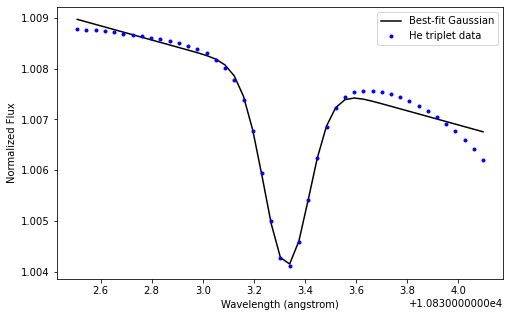

[ 1.00000000e+00  2.74661907e-03  1.32039188e+00  8.93781260e-02
 -1.14121092e-03  1.23692827e+01]


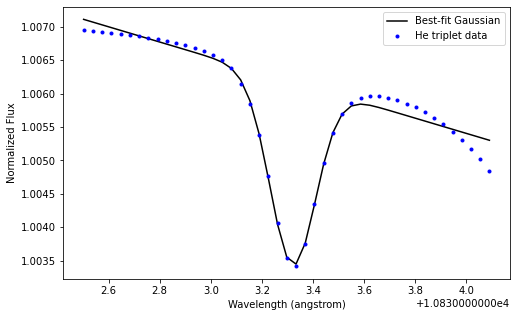

[ 1.00000000e+00  3.42178633e-03  1.32598617e+00  8.80287432e-02
 -1.29211180e-03  1.40051655e+01]


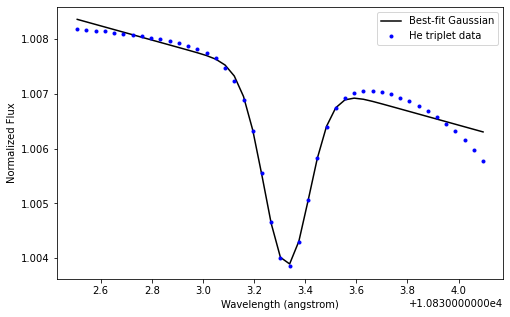

[ 1.00000000e+00  3.01297215e-03  1.32539413e+00  8.81787617e-02
 -1.14506987e-03  1.24114364e+01]


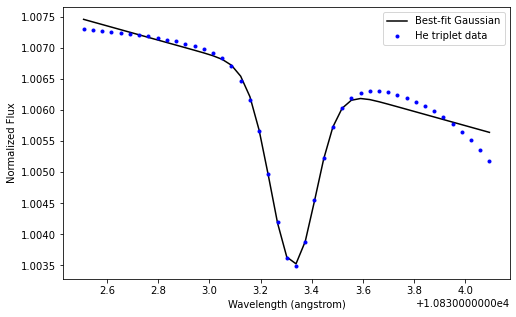

[ 1.00000000e+00  3.41414720e-03  1.32574432e+00  8.82592381e-02
 -1.31199396e-03  1.42205844e+01]


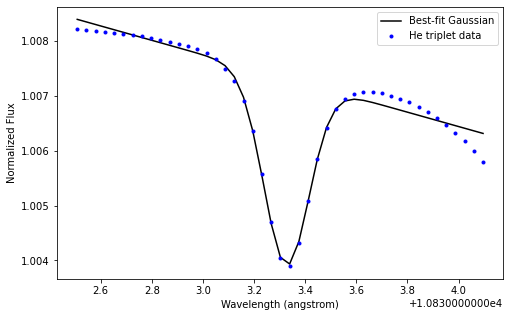

[ 1.00000000e+00  3.59208302e-03  1.32152759e+00  8.94691049e-02
 -1.51970252e-03  1.64713484e+01]


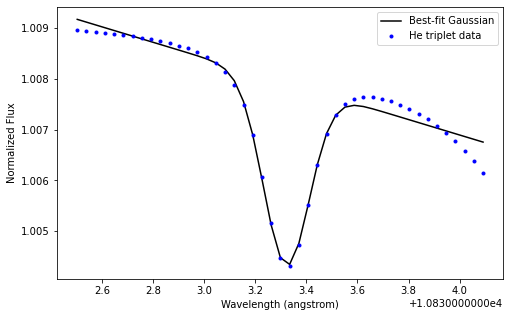

[ 1.00000000e+00  2.61023024e-03  1.32054300e+00  8.91271176e-02
 -1.07119610e-03  1.16104820e+01]


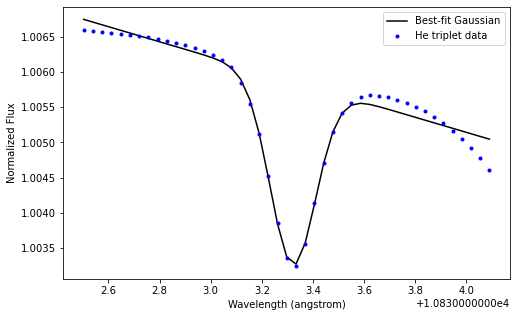

[ 1.00000000e+00  4.11344178e-03  1.32651981e+00  8.79193044e-02
 -1.56325186e-03  1.69438285e+01]


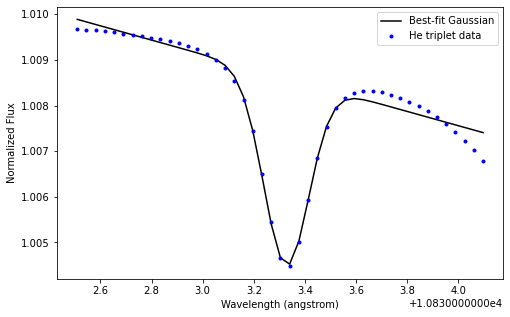

[ 1.00000000e+00  3.34690728e-03  1.32562223e+00  8.83221881e-02
 -1.29012254e-03  1.39835224e+01]


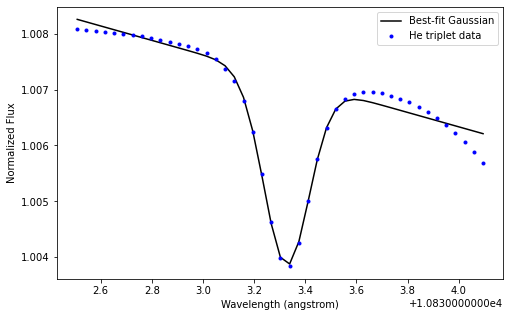

[ 1.00000000e+00  2.93461009e-03  1.32078769e+00  8.94053540e-02
 -1.21763329e-03  1.31975737e+01]


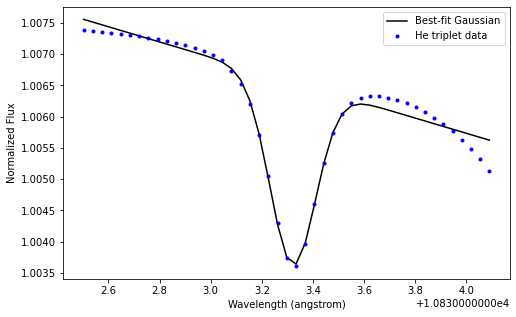

[ 1.00000000e+00  4.04970656e-03  1.32656079e+00  8.78715306e-02
 -1.53200101e-03  1.66051468e+01]


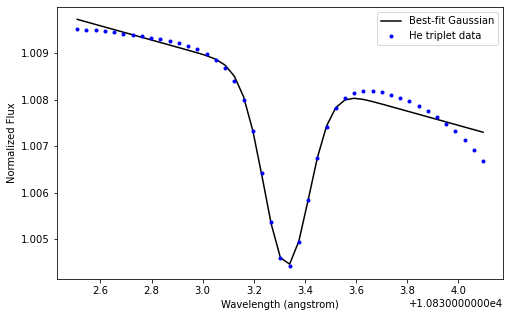

[ 1.00000000e+00  3.27119381e-03  1.32599833e+00  8.79307331e-02
 -1.22298510e-03  1.32559809e+01]


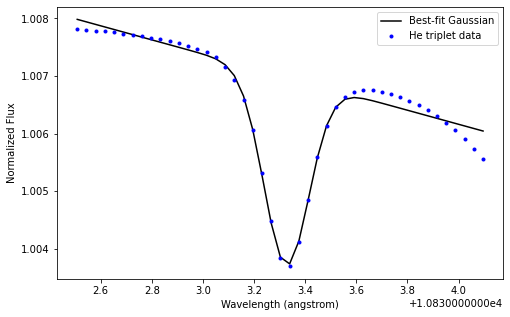

[ 1.00000000e+00  3.24879278e-03  1.32263648e+00  8.92579114e-02
 -1.34047881e-03  1.45290196e+01]


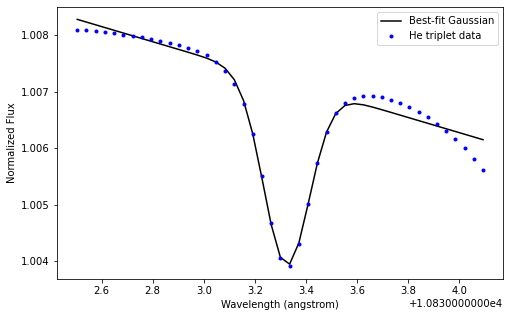

[ 1.00000000e+00  2.99501051e-03  1.32114119e+00  8.93700590e-02
 -1.23984145e-03  1.34382793e+01]


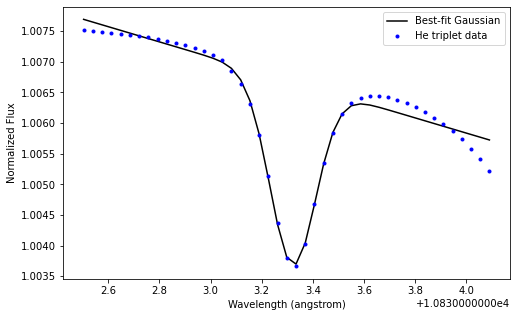

[ 1.00000000e+00  3.46348459e-03  1.32605897e+00  8.78603537e-02
 -1.29206579e-03  1.40047158e+01]


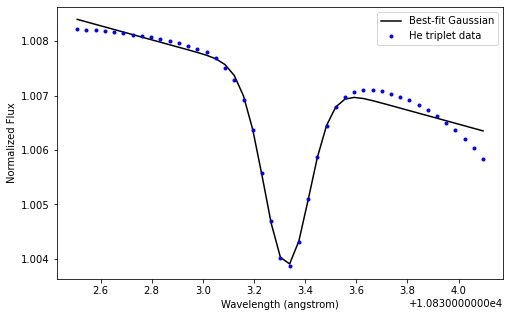

[ 1.00000000e+00  3.67967258e-03  1.32609741e+00  8.78913860e-02
 -1.38252671e-03  1.49851345e+01]


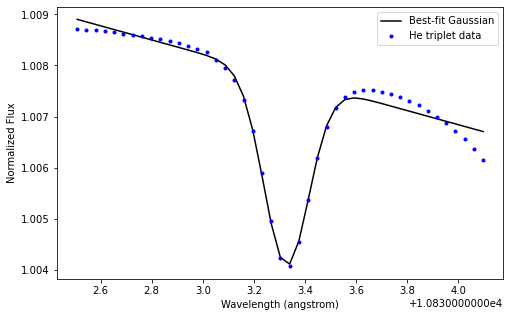

[ 1.00000000e+00  3.15448971e-03  1.32213076e+00  8.93465009e-02
 -1.30753883e-03  1.41719925e+01]


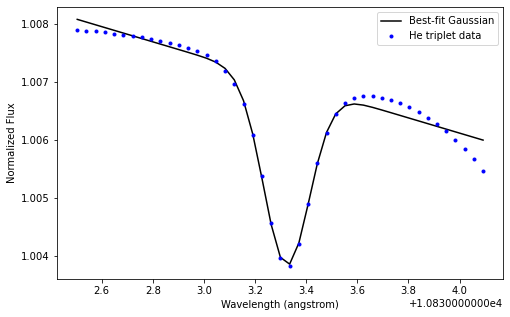

[ 1.00000000e+00  4.06802293e-03  1.32646541e+00  8.79608485e-02
 -1.55030949e-03  1.68035437e+01]


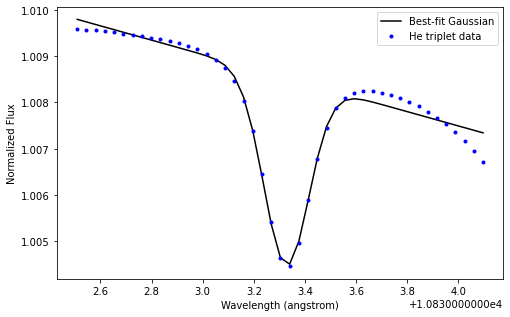

[ 1.00000000e+00  3.25122102e-03  1.32090144e+00  8.93846727e-02
 -1.35309670e-03  1.46657362e+01]


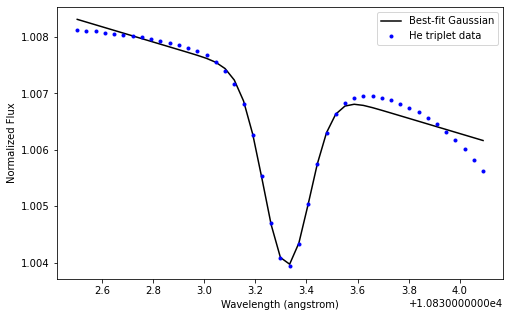

[ 1.00000000e+00  3.38044045e-03  1.32582732e+00  8.82872867e-02
 -1.30107317e-03  1.41022152e+01]


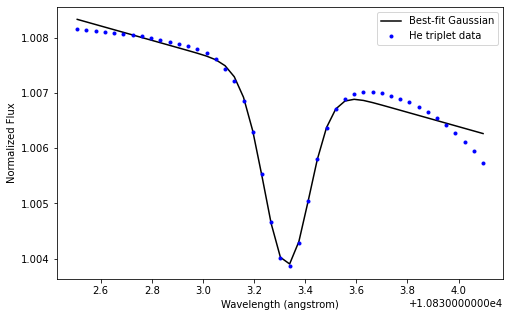

[ 1.00000000e+00  3.21557109e-03  1.32548990e+00  8.83452770e-02
 -1.23814528e-03  1.34201786e+01]


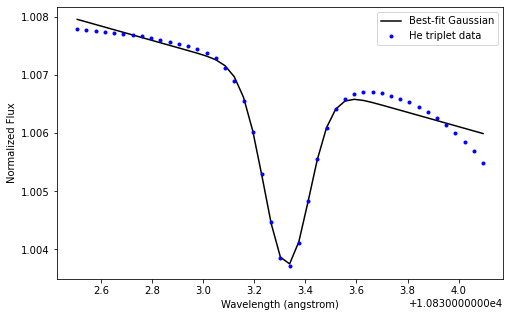

[ 1.00000000e+00  2.63147902e-03  1.31956892e+00  8.89308371e-02
 -1.06876124e-03  1.15841233e+01]


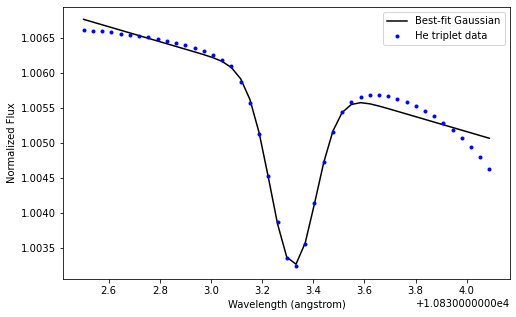

[ 1.00000000e+00  2.62978915e-03  1.31962590e+00  8.89148140e-02
 -1.06657086e-03  1.15603881e+01]


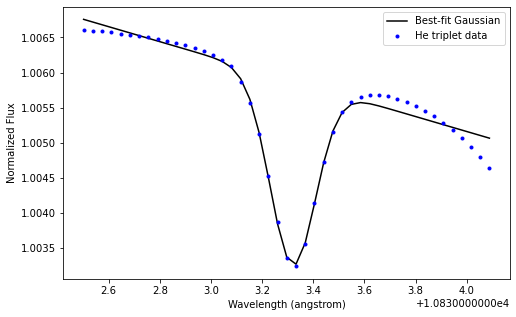

[ 1.00000000e+00  3.69264371e-03  1.32625904e+00  8.77873100e-02
 -1.37684888e-03  1.49236292e+01]


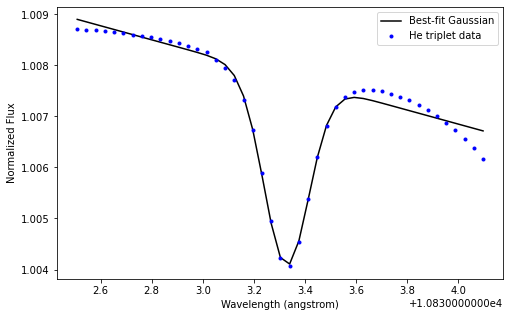

[ 1.00000000e+00  2.60970990e-03  1.32062653e+00  8.90413684e-02
 -1.06840134e-03  1.15801984e+01]


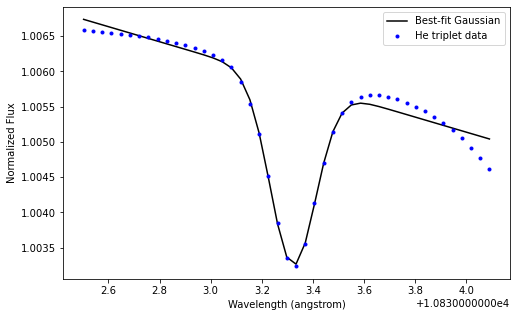

[ 1.00000000e+00  2.99833670e-03  1.32081358e+00  8.94303347e-02
 -1.24596066e-03  1.35045861e+01]


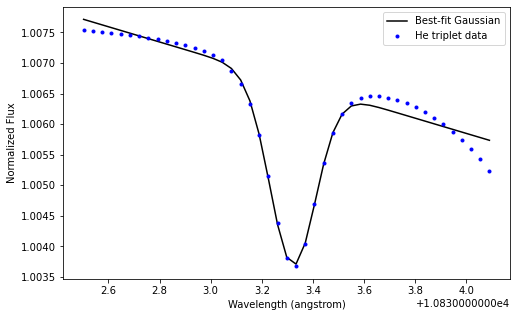

[ 1.00000000e+00  3.10636936e-03  1.32116267e+00  8.94272985e-02
 -1.29379478e-03  1.40230120e+01]


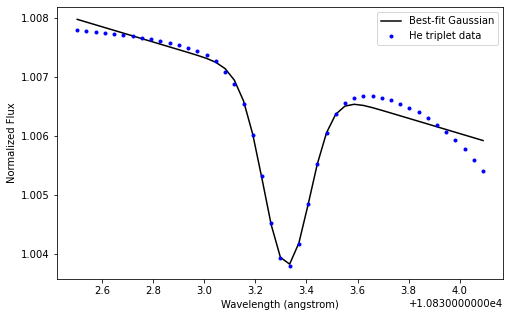

[ 1.00000000e+00  3.60726259e-03  1.32638458e+00  8.76717266e-02
 -1.33103642e-03  1.44271407e+01]


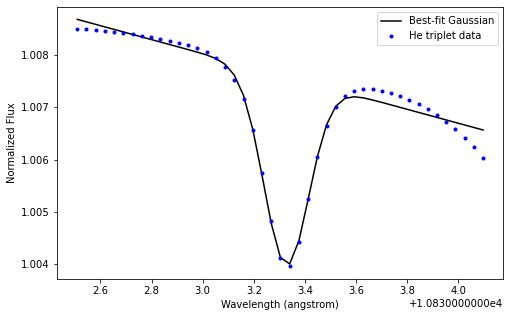

[ 1.00000000e+00  2.96344582e-03  1.32545277e+00  8.80282538e-02
 -1.11429196e-03  1.20778883e+01]


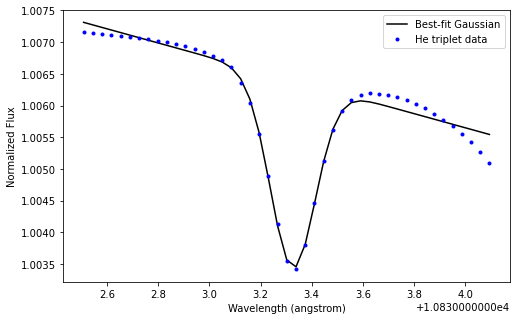

[ 1.00000000e+00  2.78848522e-03  1.31933528e+00  8.93689155e-02
 -1.15747368e-03  1.25455439e+01]


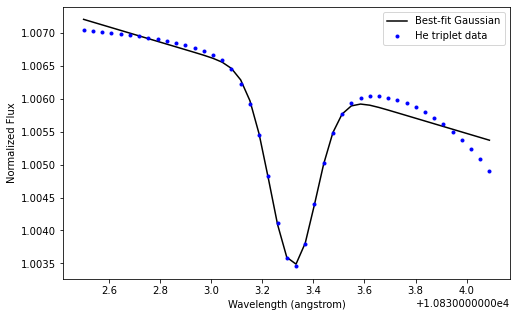

[ 1.00000000e+00  3.04450347e-03  1.32544356e+00  8.81911951e-02
 -1.15790605e-03  1.25505585e+01]


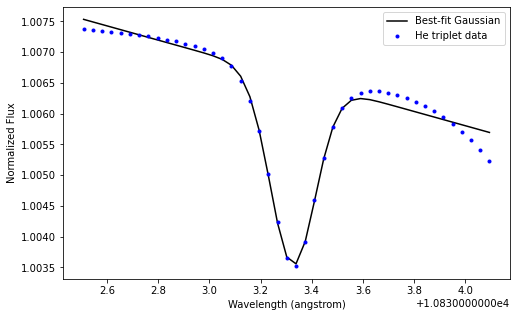

[ 1.00000000e+00  3.37840239e-03  1.32589289e+00  8.80772348e-02
 -1.27899474e-03  1.38629874e+01]


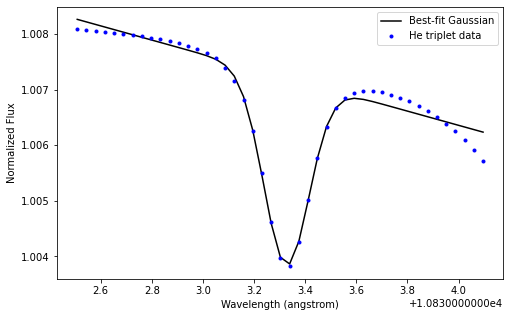

[ 1.00000000e+00  2.68595857e-03  1.31890392e+00  8.92264724e-02
 -1.10517406e-03  1.19787349e+01]


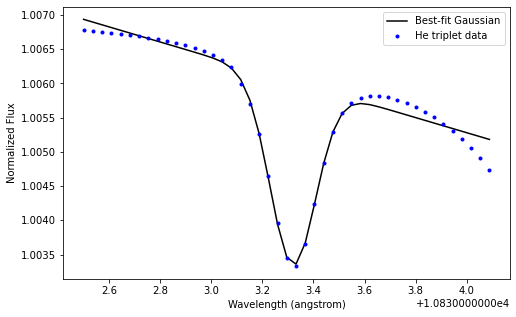

[ 1.00000000e+00  3.18288558e-03  1.32236553e+00  8.92768632e-02
 -1.31312642e-03  1.42325701e+01]


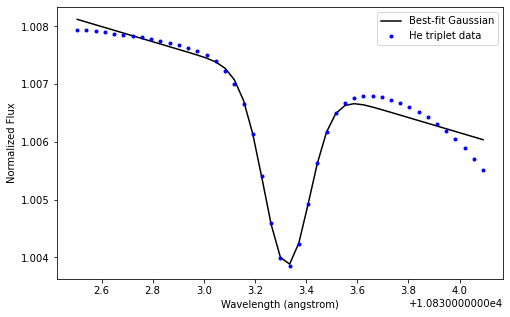

[ 1.00000000e+00  3.10721597e-03  1.32548323e+00  8.82915294e-02
 -1.19089776e-03  1.29081088e+01]


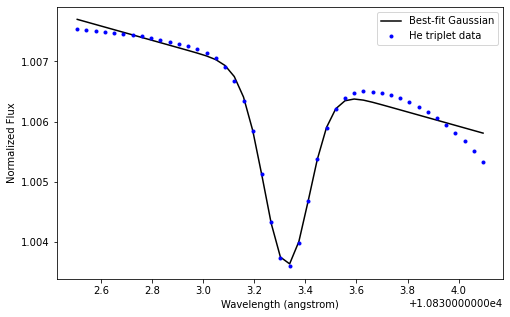

[ 1.00000000e+00  3.36562670e-03  1.32592406e+00  8.80311005e-02
 -1.26924942e-03  1.37573792e+01]


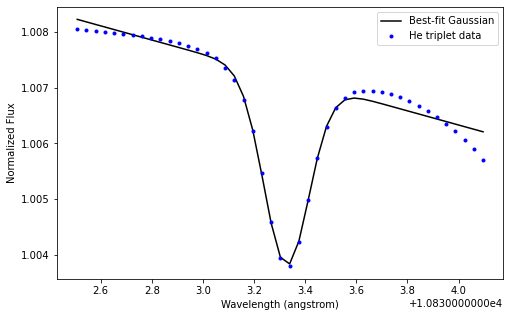

[ 1.00000000e+00  3.94278285e-03  1.32643355e+00  8.79532384e-02
 -1.49863086e-03  1.62434522e+01]


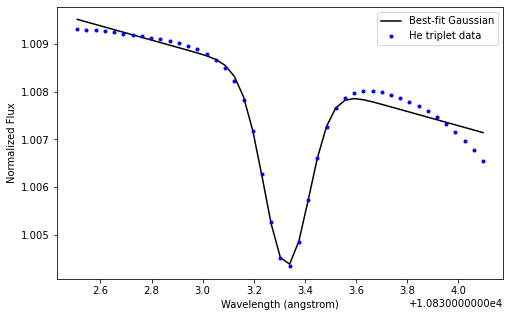

[ 1.00000000e+00  3.25850910e-03  1.32559642e+00  8.83163721e-02
 -1.25249503e-03  1.35757134e+01]


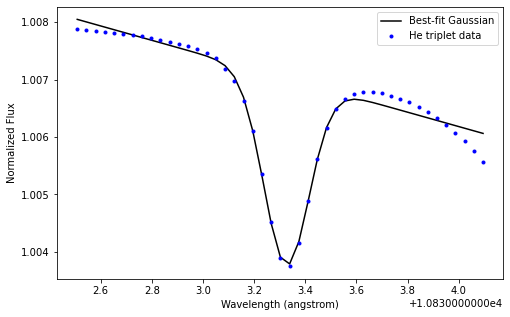

[ 1.00000000e+00  3.11725648e-03  1.32178334e+00  8.93516531e-02
 -1.29116383e-03  1.39945200e+01]


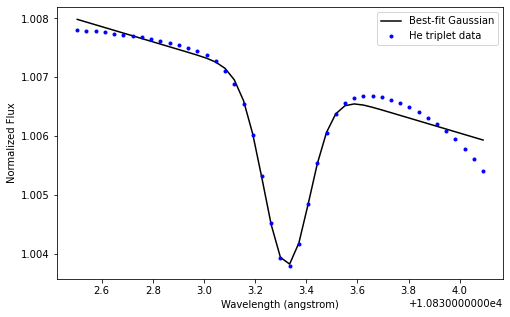

[ 1.00000000e+00  2.73023708e-03  1.31912596e+00  8.93799848e-02
 -1.13468179e-03  1.22985149e+01]


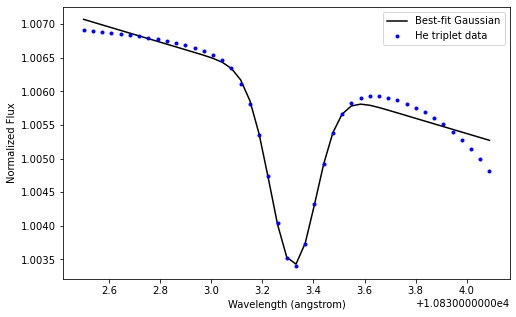

[ 1.00000000e+00  2.98437941e-03  1.32248075e+00  8.91793331e-02
 -1.21791310e-03  1.32006708e+01]


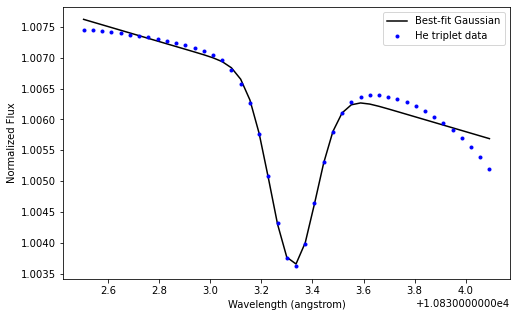

[ 1.00000000e+00  3.97884822e-03  1.32645302e+00  8.79021806e-02
 -1.50695823e-03  1.63337223e+01]


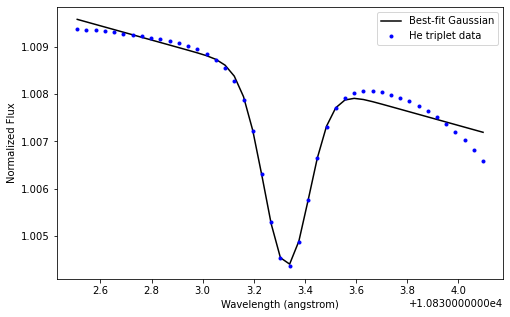

[ 1.00000000e+00  4.16822858e-03  1.32998677e+00  9.31094499e-02
 -1.68080474e-03  1.82178615e+01]


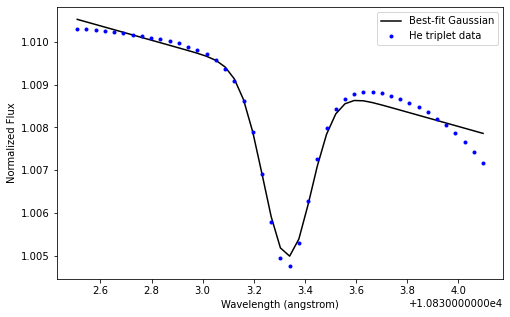

[ 1.00000000e+00  3.19552219e-03  1.32128758e+00  8.93460379e-02
 -1.32485168e-03  1.43596289e+01]


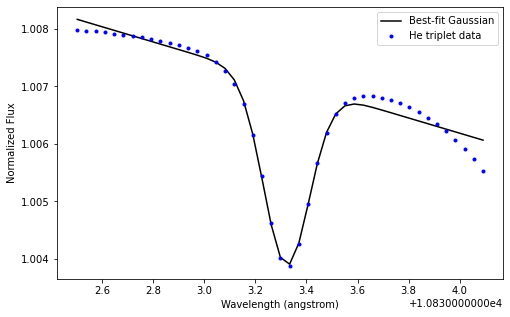

[ 1.00000000e+00  3.16704002e-03  1.31988774e+00  8.95012491e-02
 -1.32755140e-03  1.43888433e+01]


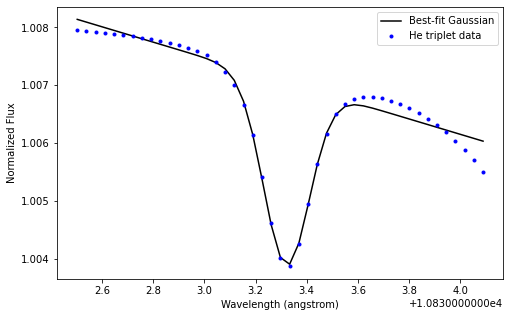

[ 1.00000000e+00  2.65408932e-03  1.32078491e+00  8.91800060e-02
 -1.09035645e-03  1.18181457e+01]


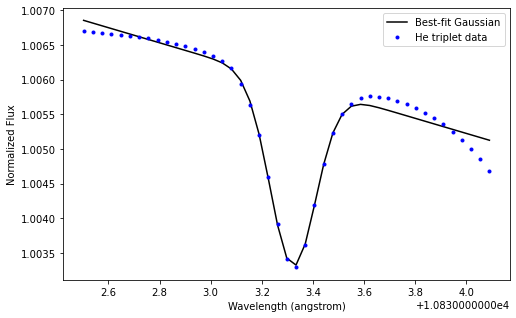

[ 1.00000000e+00  3.21419596e-03  1.32118366e+00  8.94011235e-02
 -1.33897719e-03  1.45127039e+01]


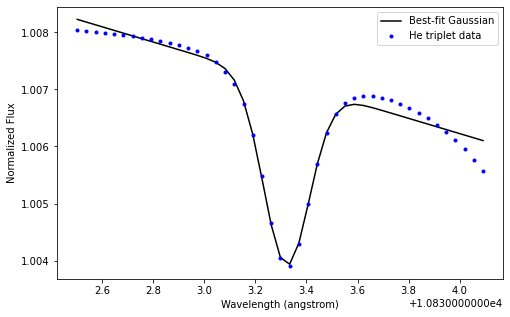

[ 1.00000000e+00  2.71790659e-03  1.31958804e+00  8.92288562e-02
 -1.11690873e-03  1.21059250e+01]


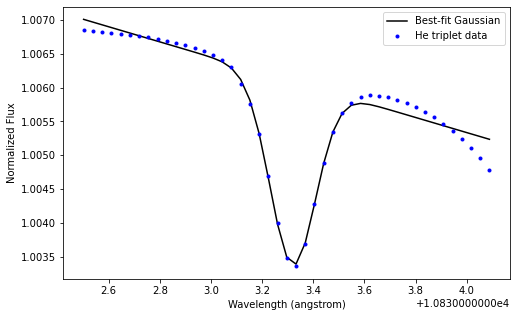

[ 1.00000000e+00  3.38011438e-03  1.32570279e+00  8.83071603e-02
 -1.30268785e-03  1.41197101e+01]


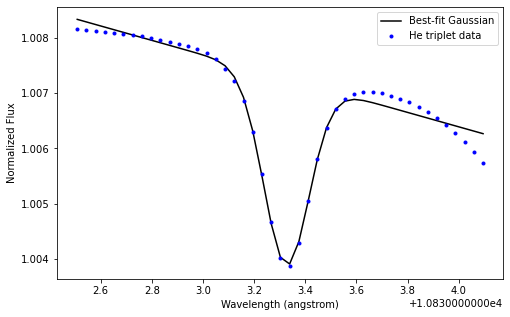

[ 1.00000000e+00  3.28742307e-03  1.32552118e+00  8.83590307e-02
 -1.26875612e-03  1.37519408e+01]


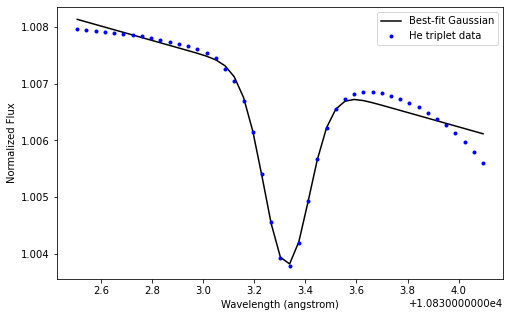

[ 1.00000000e+00  3.37601335e-03  1.32552914e+00  8.84726538e-02
 -1.31779562e-03  1.42834011e+01]


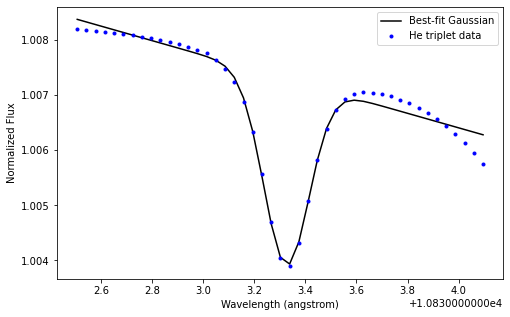

[ 1.00000000e+00  3.61351522e-03  1.32646492e+00  8.77553973e-02
 -1.34266507e-03  1.45531477e+01]


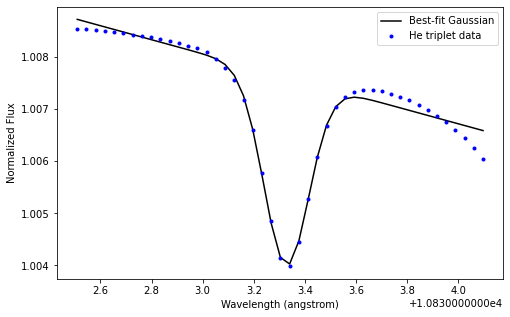

[ 1.00000000e+00  3.69097289e-03  1.32629206e+00  8.78354530e-02
 -1.38163768e-03  1.49755151e+01]


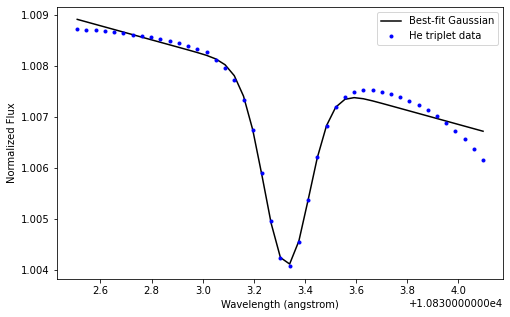

[ 1.00000000e+00  4.14614579e-03  1.32655469e+00  8.79829270e-02
 -1.58475602e-03  1.71768674e+01]


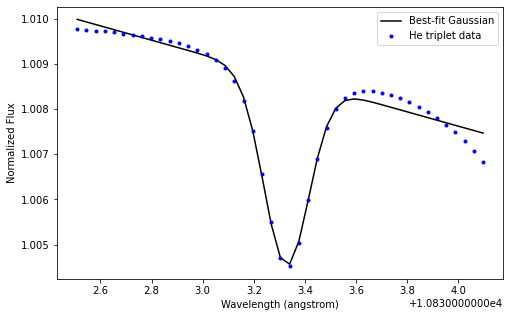

[ 1.00000000e+00  2.83150205e-03  1.32099382e+00  8.92305408e-02
 -1.16104649e-03  1.25843144e+01]


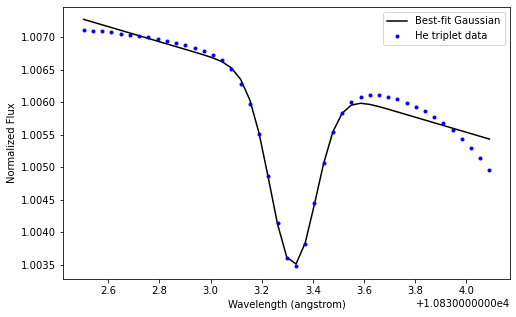

[ 1.00000000e+00  3.37834526e-03  1.32579412e+00  8.82717783e-02
 -1.29847001e-03  1.40740069e+01]


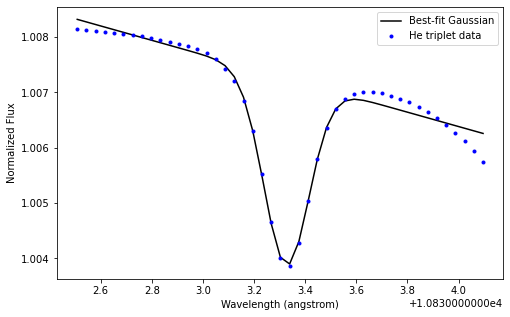

[ 1.00000000e+00  3.05947964e-03  1.32534643e+00  8.83827814e-02
 -1.18057873e-03  1.27962411e+01]


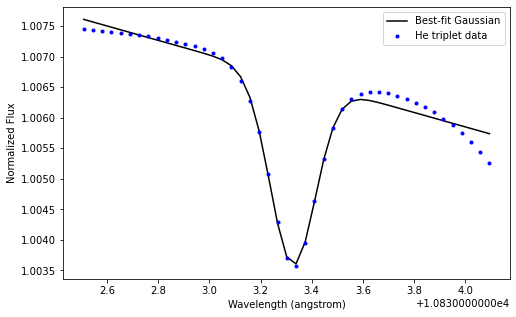

[ 1.00000000e+00  3.37676803e-03  1.32597766e+00  8.80322242e-02
 -1.27393238e-03  1.38081338e+01]


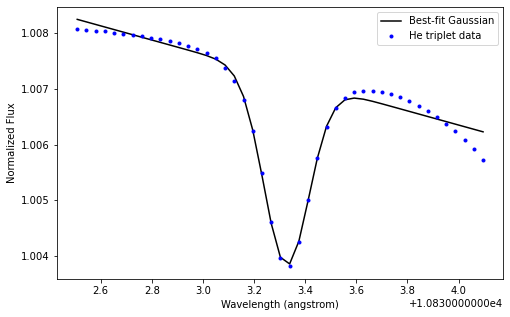

[ 1.00000000e+00  4.05278129e-03  1.32913038e+00  9.32385594e-02
 -1.62631699e-03  1.76273411e+01]


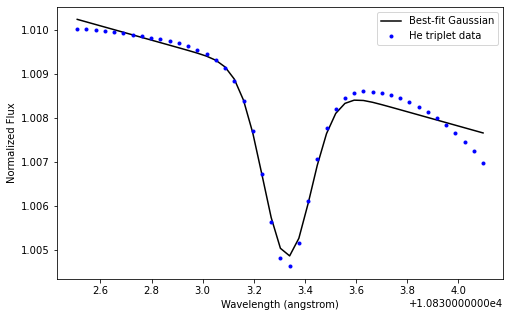

[ 1.00000000e+00  2.91264371e-03  1.31968576e+00  8.94682824e-02
 -1.21561160e-03  1.31756379e+01]


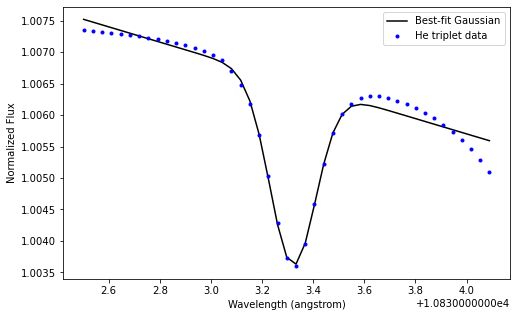

[ 1.00000000e+00  3.50000538e-03  1.32289161e+00  8.91923875e-02
 -1.44666325e-03  1.56798497e+01]


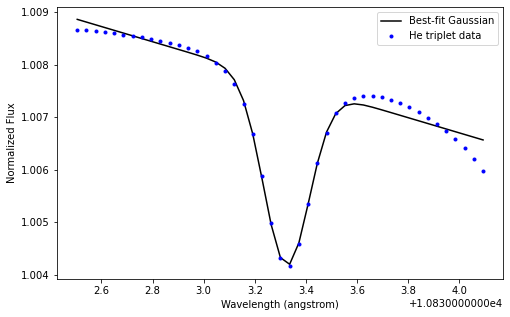

[ 1.00000000e+00  3.26773826e-03  1.32213440e+00  8.92508854e-02
 -1.34746392e-03  1.46047264e+01]


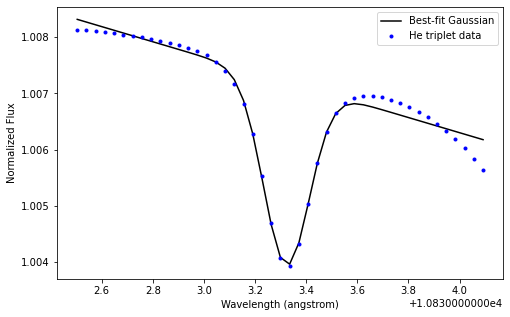

[ 1.00000000e+00  2.82667774e-03  1.31965167e+00  8.92918143e-02
 -1.16503672e-03  1.26275403e+01]


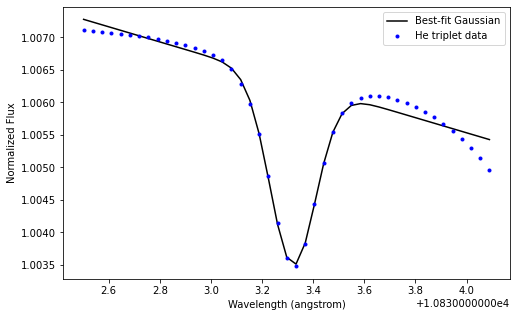

[ 1.00000000e+00  3.73600532e-03  1.32265655e+00  8.92790842e-02
 -1.56405667e-03  1.69521049e+01]


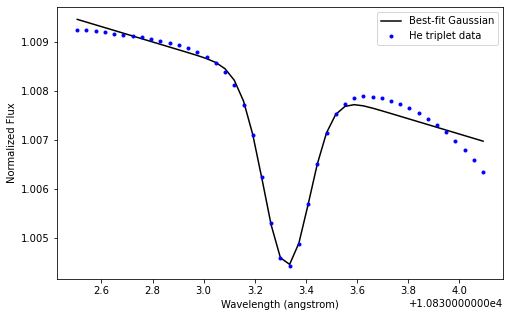

[ 1.00000000e+00  3.41614895e-03  1.32566341e+00  8.83799642e-02
 -1.32528963e-03  1.43646485e+01]


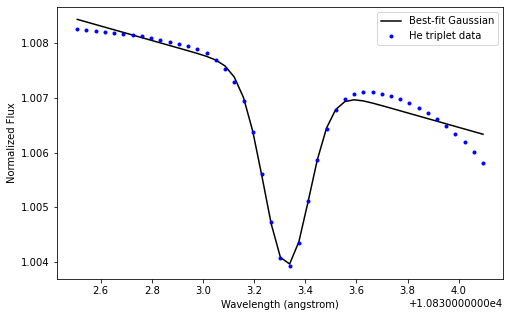

[ 1.00000000e+00  3.11228572e-03  1.32545030e+00  8.83205833e-02
 -1.19580999e-03  1.29613400e+01]


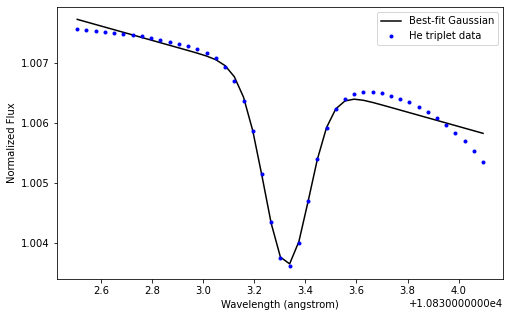

[ 1.00000000e+00  3.01634442e-03  1.31975918e+00  8.95339892e-02
 -1.26423728e-03  1.37026367e+01]


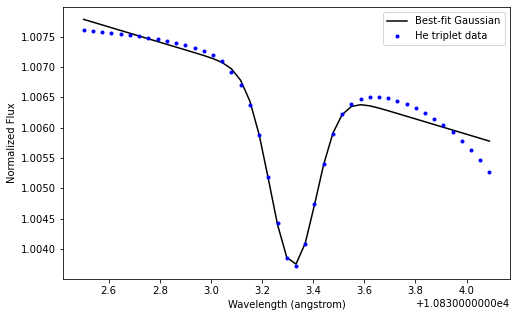

[ 1.00000000e+00  3.10502892e-03  1.31978561e+00  8.94589710e-02
 -1.29570272e-03  1.40436803e+01]


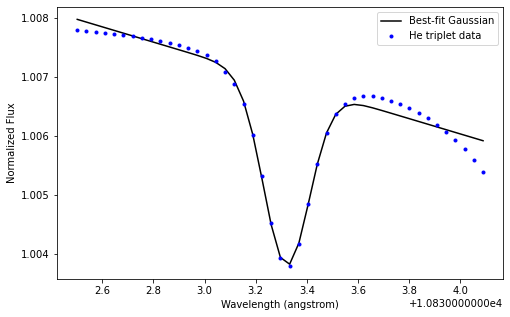

[ 1.00000000e+00  3.66164424e-03  1.32608047e+00  8.78974769e-02
 -1.37594229e-03  1.49137697e+01]


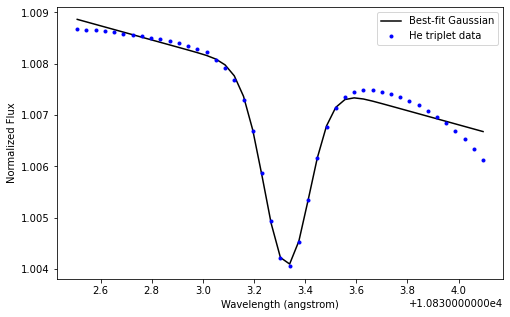

[ 1.00000000e+00  3.17414828e-03  1.32005702e+00  8.95128250e-02
 -1.33215823e-03  1.44387680e+01]


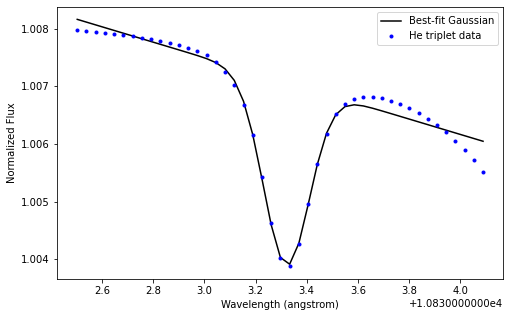

[ 1.00000000e+00  2.76343633e-03  1.32031270e+00  8.92470735e-02
 -1.13637385e-03  1.23168932e+01]


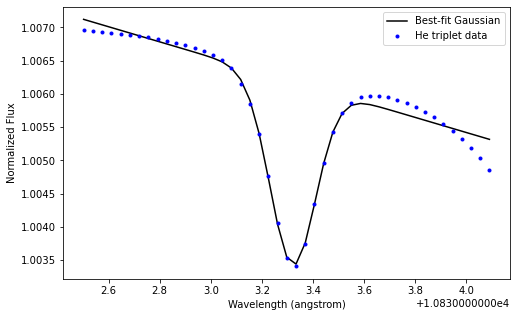

[ 1.00000000e+00  3.06251386e-03  1.32199775e+00  8.92837785e-02
 -1.26008269e-03  1.36576829e+01]


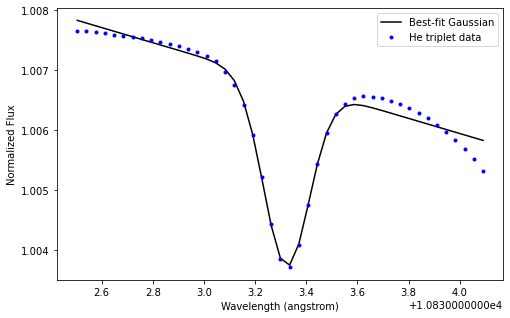

[ 1.00000000e+00  2.82371667e-03  1.32165319e+00  8.92083250e-02
 -1.15729365e-03  1.25436426e+01]


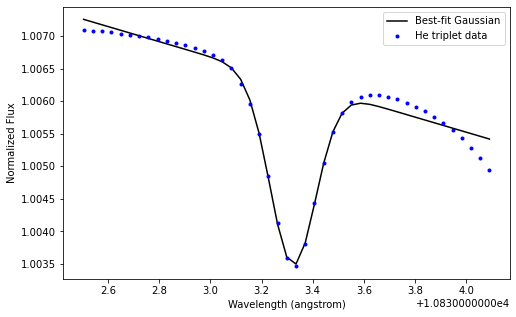

[ 1.00000000e+00  3.28262923e-03  1.32223572e+00  8.92973934e-02
 -1.35929695e-03  1.47329578e+01]


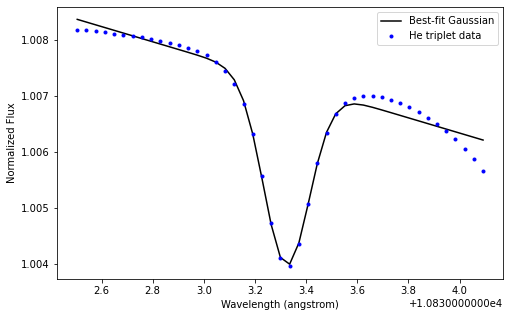

[ 1.00000000e+00  3.33209212e-03  1.32217457e+00  8.93263994e-02
 -1.38441675e-03  1.50051951e+01]


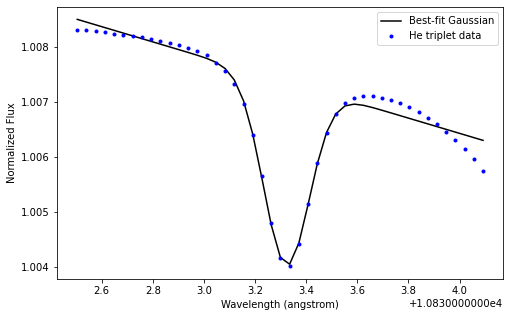

[ 9.99998193e-01  4.55133151e-03  1.32653866e+00  8.82444314e-02
 -1.77756110e-03  1.92664017e+01]


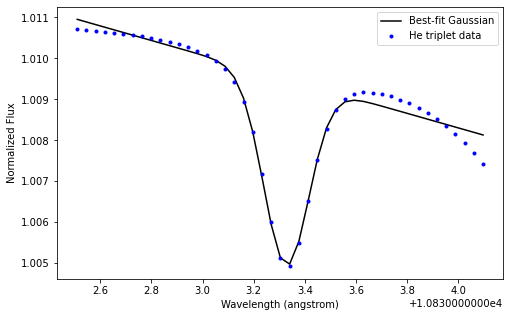

[ 1.00000000e+00  2.77445801e-03  1.31905343e+00  8.94302632e-02
 -1.15723691e-03  1.25429602e+01]


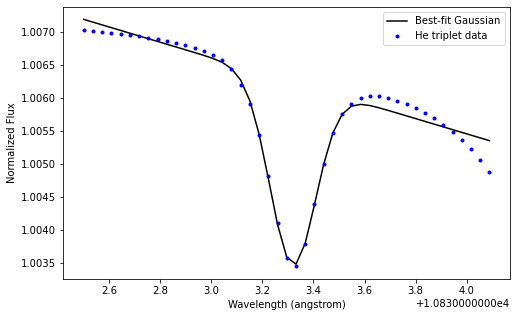

[ 1.00000000e+00  3.30469200e-03  1.32280535e+00  8.92044076e-02
 -1.35976567e-03  1.47380643e+01]


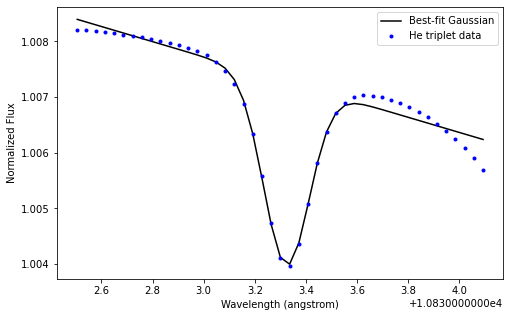

[ 1.00000000e+00  3.63844745e-03  1.32641543e+00  8.76631700e-02
 -1.34256588e-03  1.45521016e+01]


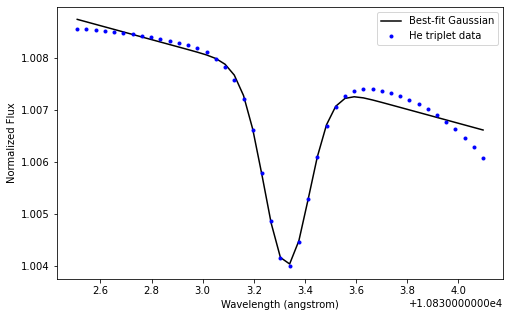

[ 1.00000000e+00  3.17535177e-03  1.32232420e+00  8.93398830e-02
 -1.31625525e-03  1.42664626e+01]


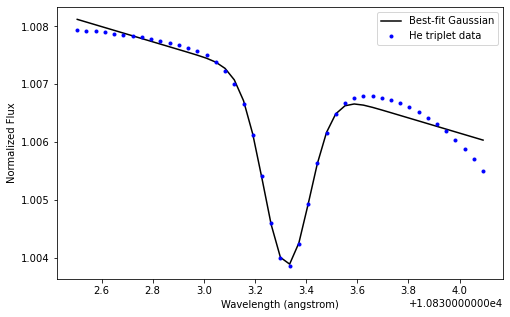

[ 1.00000000e+00  2.58058372e-03  1.31912758e+00  8.90487527e-02
 -1.05737692e-03  1.14607061e+01]


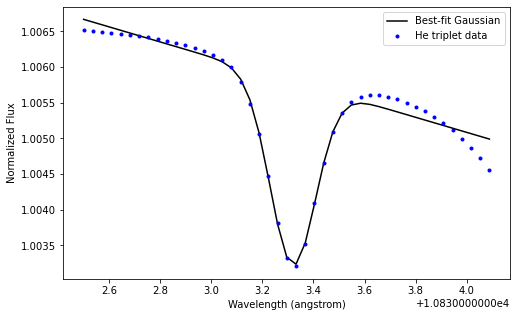

[ 1.00000000e+00  3.74722895e-03  1.32619542e+00  8.78604622e-02
 -1.40709753e-03  1.52514434e+01]


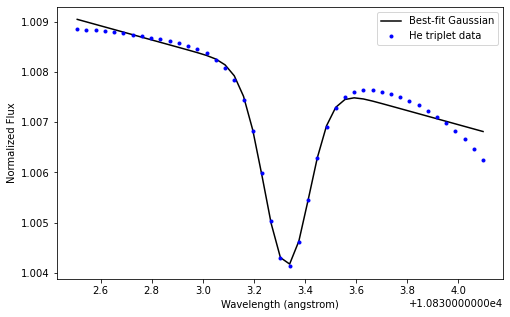

[ 1.00000000e+00  2.83545339e-03  1.31925097e+00  8.94201102e-02
 -1.17971170e-03  1.27865573e+01]


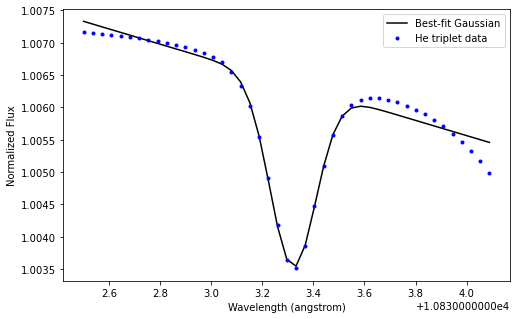

[ 1.00000000e+00  2.73037724e-03  1.32164842e+00  8.90972933e-02
 -1.11161302e-03  1.20485645e+01]


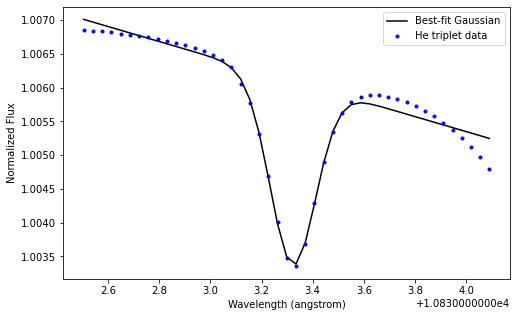

[ 1.00000000e+00  3.74315639e-03  1.32617888e+00  8.79085921e-02
 -1.41085306e-03  1.52921306e+01]


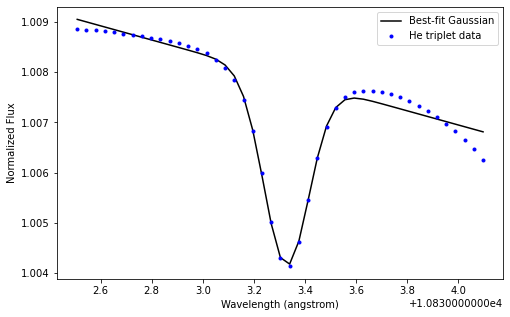

[ 1.00000000e+00  3.77414699e-03  1.32613547e+00  8.78842026e-02
 -1.42055722e-03  1.53973131e+01]


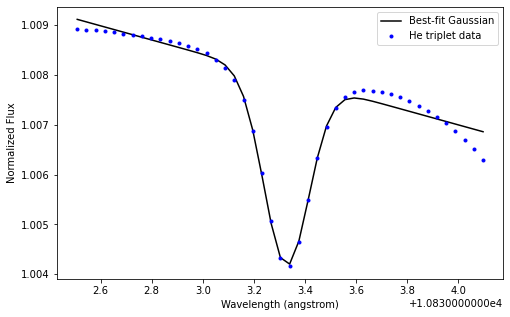

[ 1.00000000e+00  3.43875075e-03  1.32263424e+00  8.92801019e-02
 -1.42881787e-03  1.54864183e+01]


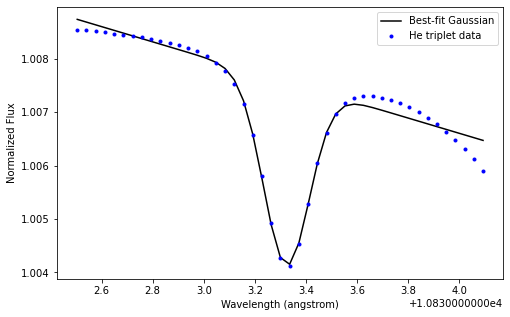

[ 1.00000000e+00  4.01207631e-03  1.32879148e+00  9.32499727e-02
 -1.60396582e-03  1.73851134e+01]


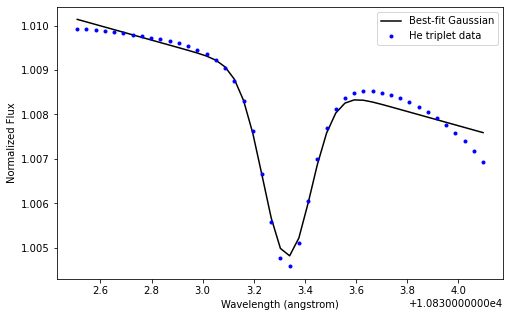

[ 1.00000000e+00  4.06796900e-03  1.32652234e+00  8.79337251e-02
 -1.54695647e-03  1.67672130e+01]


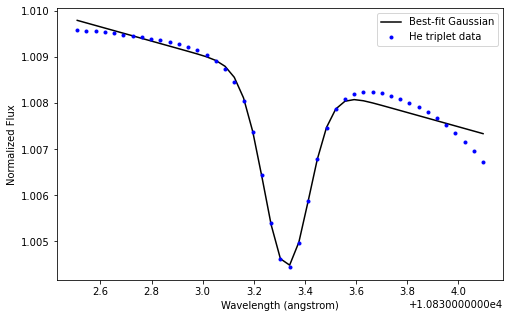

[ 1.00000000e+00  4.27661346e-03  1.33081274e+00  9.29318219e-02
 -1.72361712e-03  1.86818682e+01]


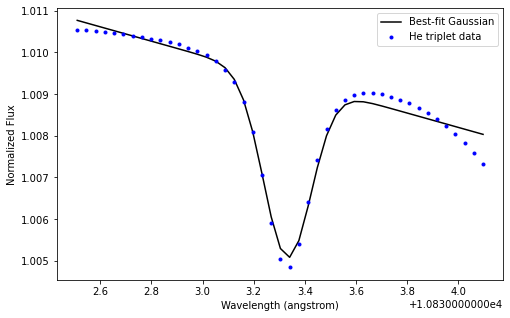

[ 1.00000000e+00  3.85427313e-03  1.32643503e+00  8.78485201e-02
 -1.45017164e-03  1.57182846e+01]


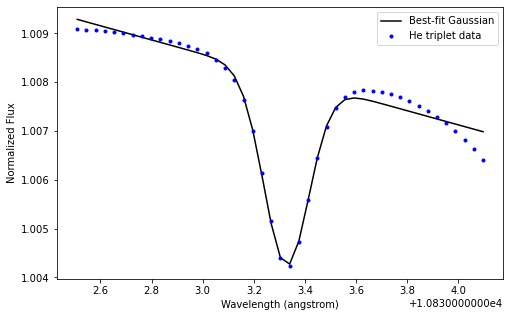

[ 1.00000000e+00  3.78631210e-03  1.32259639e+00  8.92780457e-02
 -1.58646252e-03  1.71949344e+01]


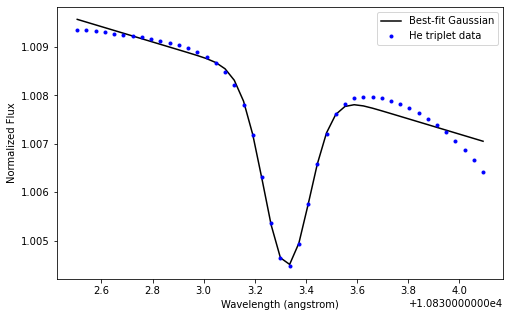

[ 1.00000000e+00  3.05518359e-03  1.32292705e+00  8.90655690e-02
 -1.23692647e-03  1.34067730e+01]


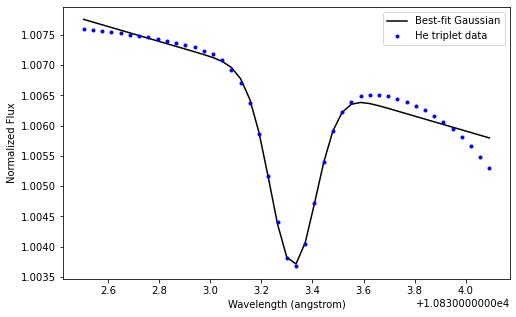

[ 1.00000000e+00  3.51046611e-03  1.32090897e+00  8.94371953e-02
 -1.47693405e-03  1.60078472e+01]


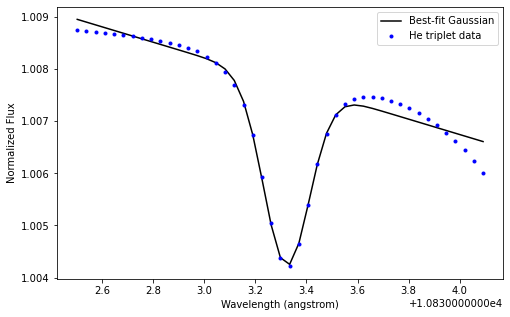

[ 1.00000000e+00  3.13698046e-03  1.32136617e+00  8.94142902e-02
 -1.30616645e-03  1.41570994e+01]


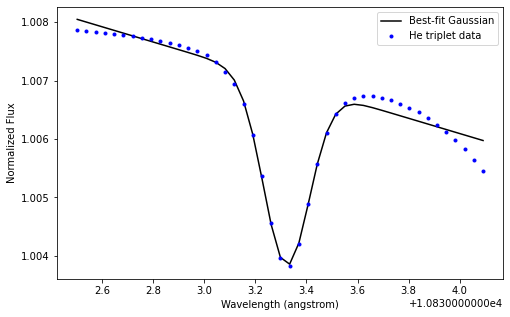

[ 1.00000000e+00  3.40016083e-03  1.32584476e+00  8.82510769e-02
 -1.30568084e-03  1.41521637e+01]


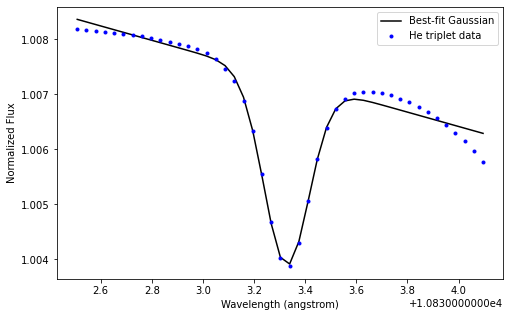

[ 1.00000000e+00  3.43404662e-03  1.32248564e+00  8.92547476e-02
 -1.42319377e-03  1.54254742e+01]


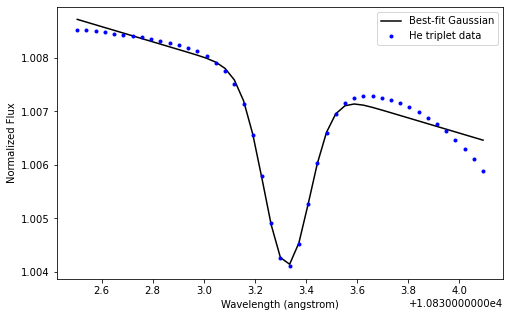

[ 1.00000000e+00  2.64777469e-03  1.32072804e+00  8.91618946e-02
 -1.08594784e-03  1.17703693e+01]


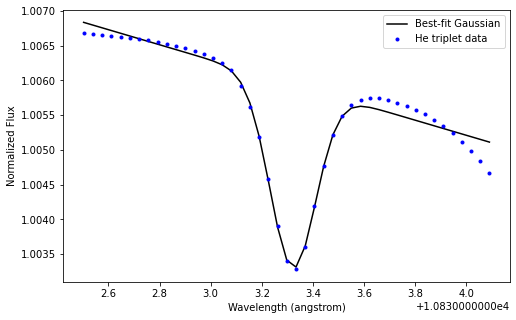

[ 1.00000000e+00  3.31058182e-03  1.32177857e+00  8.93551530e-02
 -1.37750958e-03  1.49303277e+01]


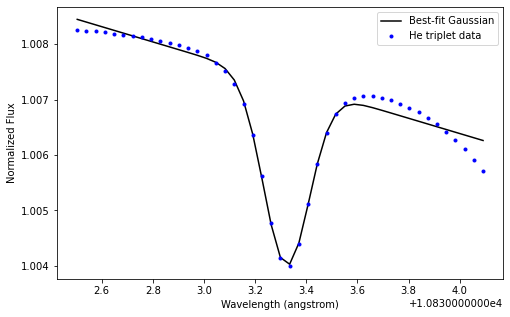

[ 1.00000000e+00  3.03524642e-03  1.31907863e+00  8.96473777e-02
 -1.28432939e-03  1.39203604e+01]


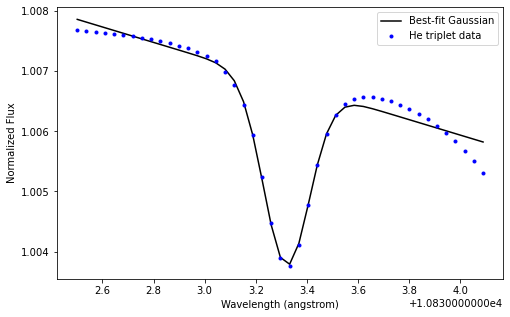

[ 1.00000000e+00  3.37994931e-03  1.32151464e+00  8.94281279e-02
 -1.41726296e-03  1.53611458e+01]


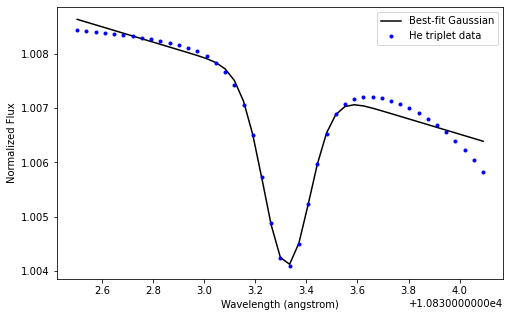

[ 1.00000000e+00  3.74984494e-03  1.32644495e+00  8.77572419e-02
 -1.39733855e-03  1.51457058e+01]


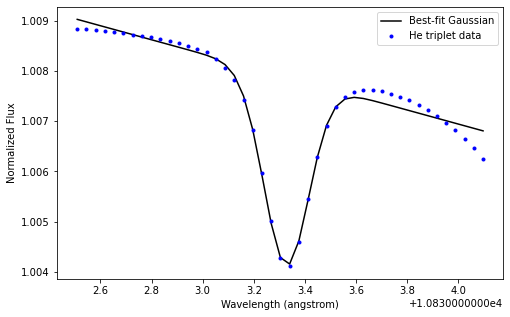

[ 1.00000000e+00  3.55513791e-03  1.32610447e+00  8.78999459e-02
 -1.33334266e-03  1.44520685e+01]


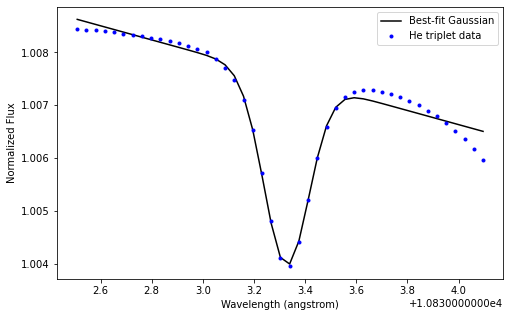

[ 1.00000000e+00  3.51694871e-03  1.32610008e+00  8.79334212e-02
 -1.32140775e-03  1.43227062e+01]


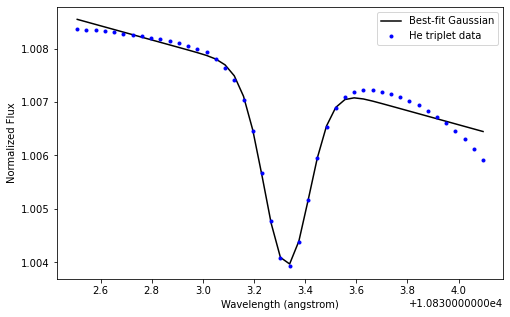

[ 1.00000000e+00  3.10657180e-03  1.31984993e+00  8.95286441e-02
 -1.30367341e-03  1.41300464e+01]


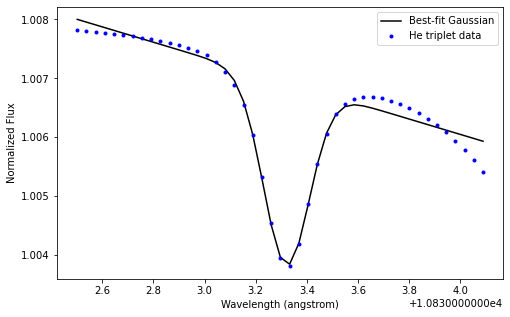

[ 1.00000000e+00  4.01637113e-03  1.32651367e+00  8.79881551e-02
 -1.53322070e-03  1.66183245e+01]


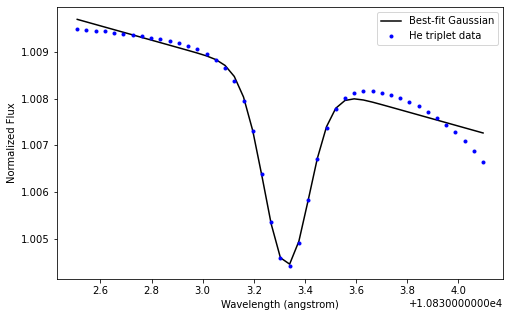

[ 1.00000000e+00  3.33854166e-03  1.32559731e+00  8.83540443e-02
 -1.28980729e-03  1.39800966e+01]


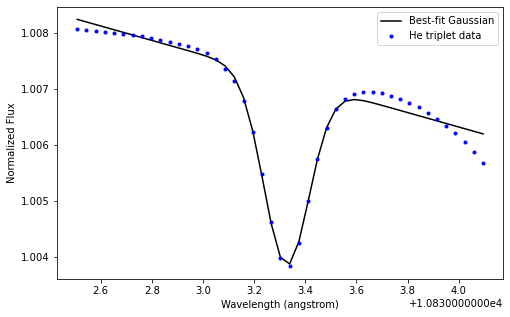

[ 1.00000000e+00  2.79555498e-03  1.31879764e+00  8.93210710e-02
 -1.15622469e-03  1.25320187e+01]


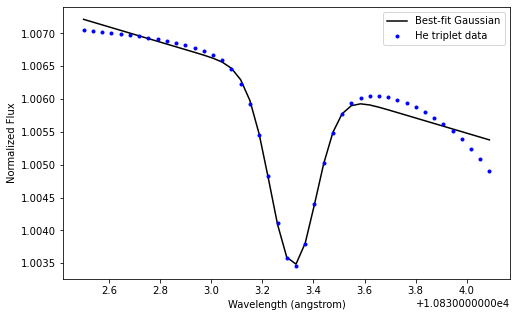

[ 1.00000000e+00  3.36489782e-03  1.32607223e+00  8.78168602e-02
 -1.24797722e-03  1.35268886e+01]


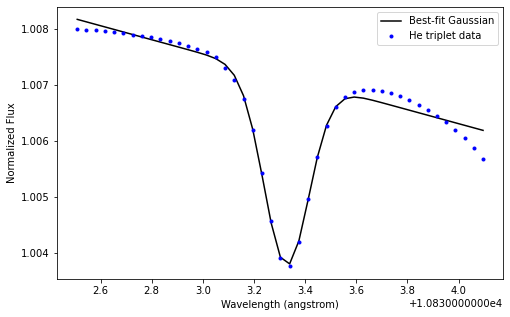

[ 1.00000000e+00  3.11690646e-03  1.32002546e+00  8.95962848e-02
 -1.31555800e-03  1.42588313e+01]


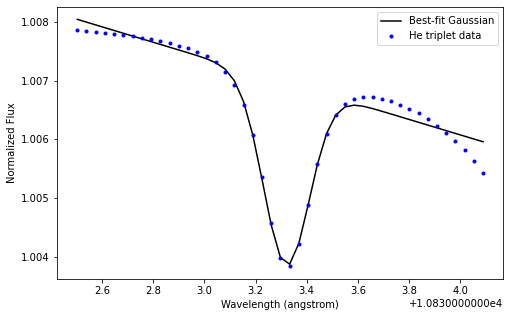

[ 1.00000000e+00  3.35181925e-03  1.32602219e+00  8.78353557e-02
 -1.24434014e-03  1.34874644e+01]


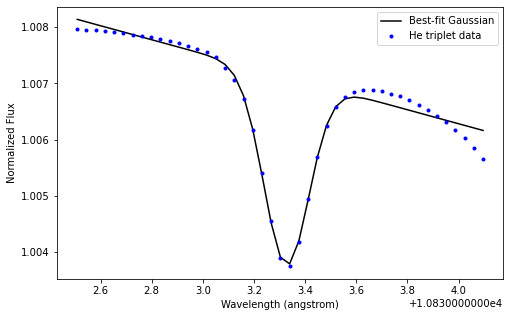

[ 1.00000000e+00  3.28356980e-03  1.32243477e+00  8.93010877e-02
 -1.36045315e-03  1.47454870e+01]


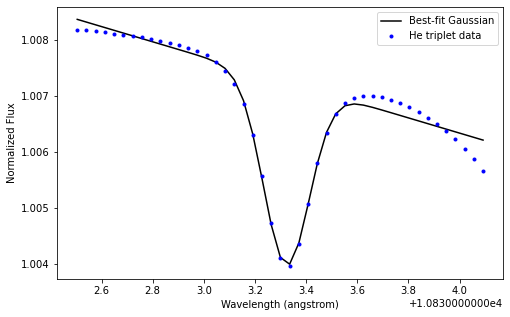

[ 1.00000000e+00  2.52901707e-03  1.31913278e+00  8.88505665e-02
 -1.02849027e-03  1.11476446e+01]


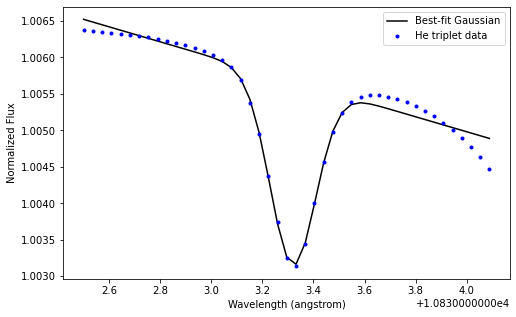

[ 1.00000000e+00  3.39861229e-03  1.32572491e+00  8.82885573e-02
 -1.30864182e-03  1.41842445e+01]


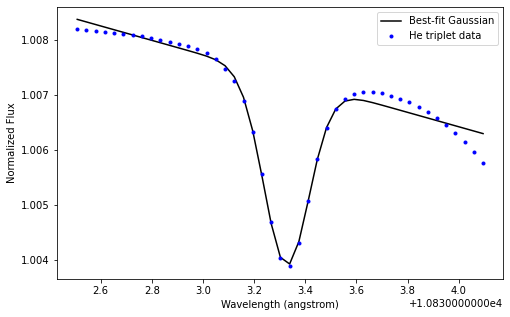

[ 1.00000000e+00  2.62731652e-03  1.32110928e+00  8.89348728e-02
 -1.06639345e-03  1.15584660e+01]


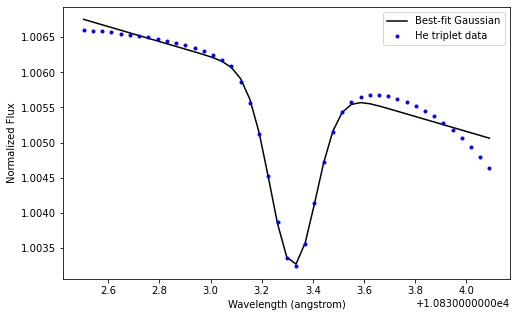

[ 1.00000000e+00  3.45911801e-03  1.32243419e+00  8.92777242e-02
 -1.43723436e-03  1.55776362e+01]


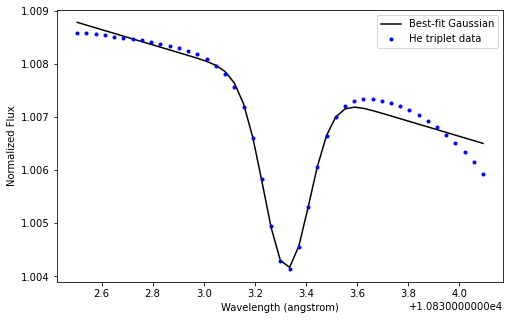

[ 1.00000000e+00  3.51063409e-03  1.32606526e+00  8.78720421e-02
 -1.31223547e-03  1.42233149e+01]


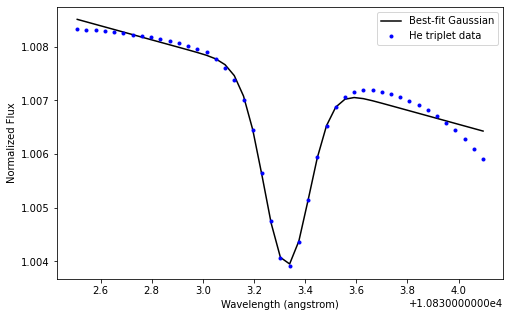

[ 1.00000000e+00  2.72425070e-03  1.32056096e+00  8.92499765e-02
 -1.12120837e-03  1.21525226e+01]


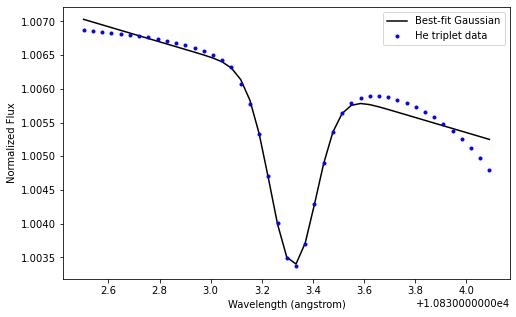

[ 1.00000000e+00  3.75953123e-03  1.32620797e+00  8.78124300e-02
 -1.40663707e-03  1.52464683e+01]


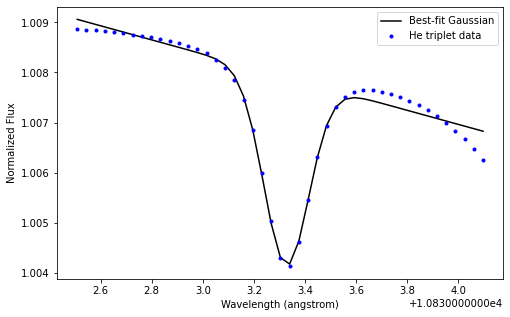

[ 1.00000000e+00  4.00438399e-03  1.32653165e+00  8.79393409e-02
 -1.52226325e-03  1.64995845e+01]


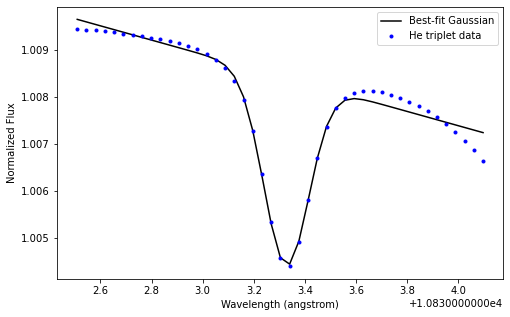

[ 1.00000000e+00  3.59911672e-03  1.32637805e+00  8.77647531e-02
 -1.33767294e-03  1.44990397e+01]


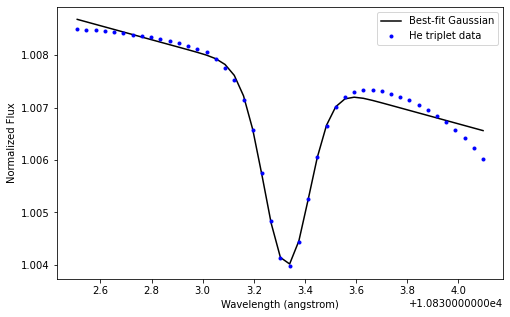

[ 1.00000000e+00  3.71112464e-03  1.32629815e+00  8.77732347e-02
 -1.38284899e-03  1.49886631e+01]


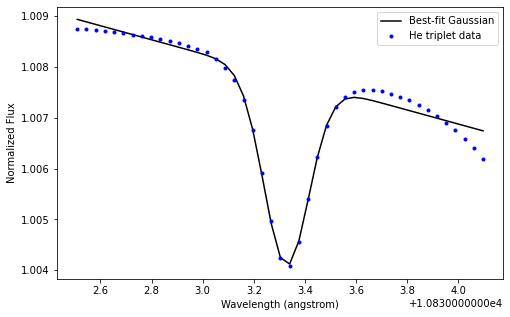

[ 1.00000000e+00  4.25208648e-03  1.33061649e+00  9.30300950e-02
 -1.72204688e-03  1.86648251e+01]


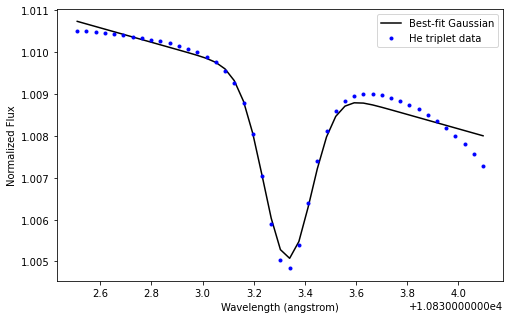

[ 1.00000000e+00  3.18083171e-03  1.32553862e+00  8.82250507e-02
 -1.21436445e-03  1.31624651e+01]


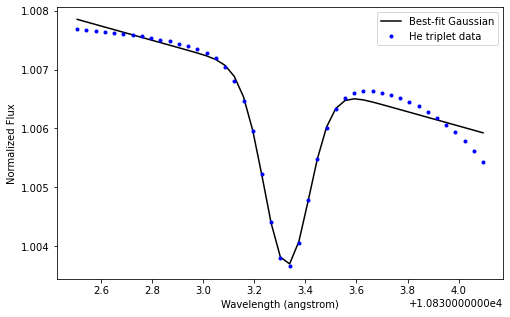

[ 1.00000000e+00  2.95367477e-03  1.32179515e+00  8.92736474e-02
 -1.21483085e-03  1.31672339e+01]


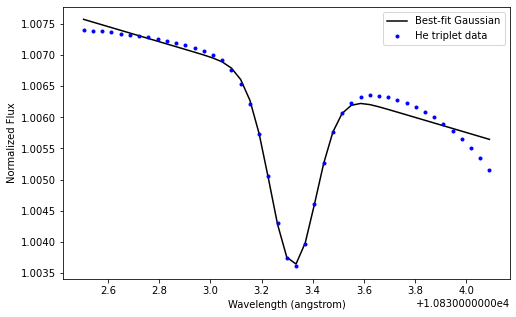

[ 1.00000000e+00  2.95147382e-03  1.31972062e+00  8.94992841e-02
 -1.23313432e-03  1.33655493e+01]


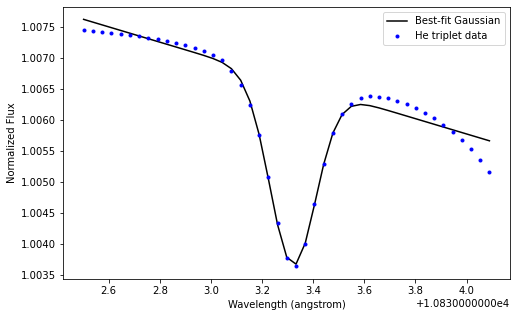

[ 1.00000000e+00  2.69852807e-03  1.31965925e+00  8.91949316e-02
 -1.10735693e-03  1.20024042e+01]


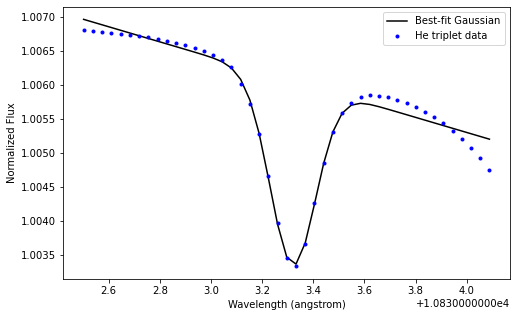

[ 1.00000000e+00  4.05861872e-03  1.32914790e+00  9.31651128e-02
 -1.62107489e-03  1.75705488e+01]


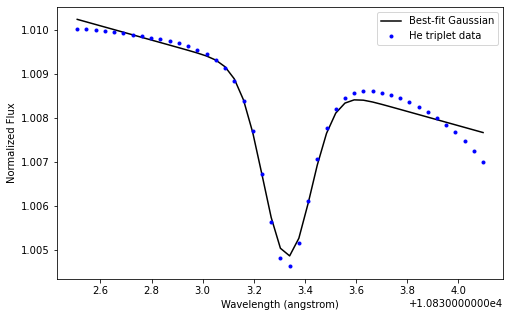

[ 1.00000000e+00  3.41112411e-03  1.32563606e+00  8.83901742e-02
 -1.32433807e-03  1.43543318e+01]


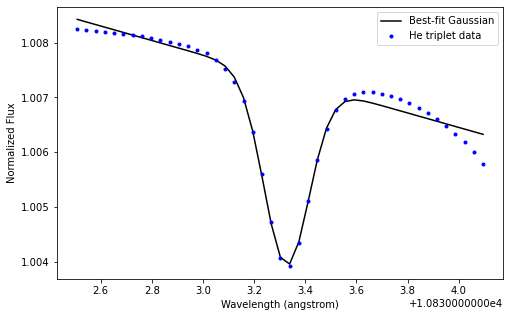

[ 1.00000000e+00  2.81104072e-03  1.32073457e+00  8.93148976e-02
 -1.16003953e-03  1.25733777e+01]


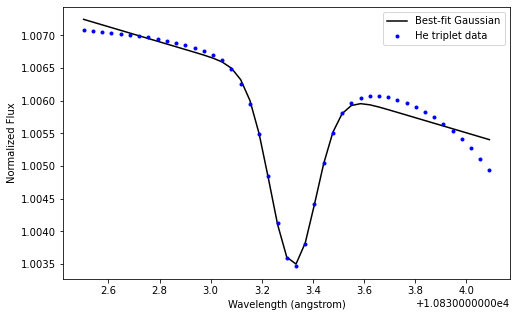

[ 1.00000000e+00  3.45884265e-03  1.32584848e+00  8.82557113e-02
 -1.33064459e-03  1.44227213e+01]


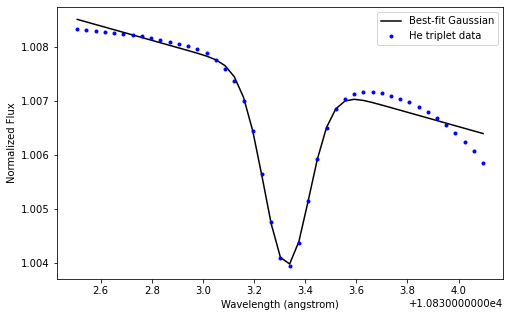

[ 1.00000000e+00  3.72785662e-03  1.32612806e+00  8.78779826e-02
 -1.40080601e-03  1.51832507e+01]


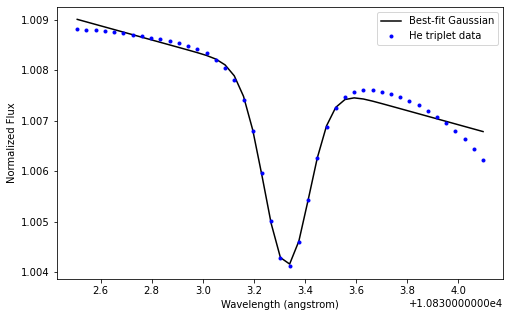

[ 1.00000000e+00  3.27704862e-03  1.32610092e+00  8.78378811e-02
 -1.21657882e-03  1.31865744e+01]


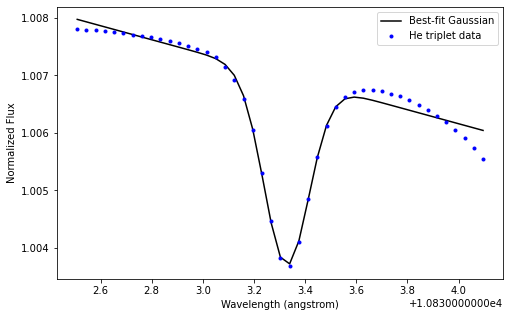

[ 1.00000000e+00  3.21626074e-03  1.32101380e+00  8.93405267e-02
 -1.33304499e-03  1.44484297e+01]


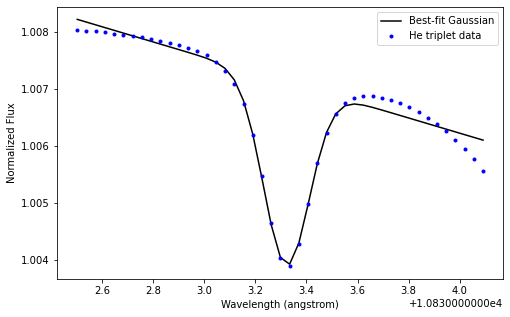

[ 1.00000000e+00  3.10529457e-03  1.31996135e+00  8.94997799e-02
 -1.30029158e-03  1.40934021e+01]


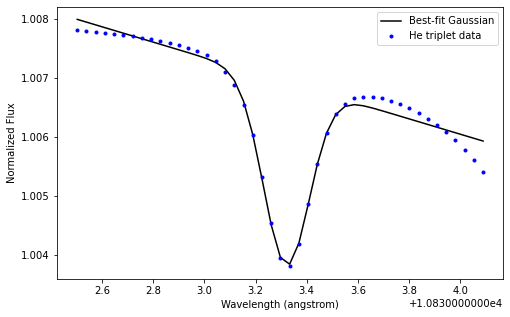

[ 1.00000000e+00  3.26391956e-03  1.32199931e+00  8.93731596e-02
 -1.35897994e-03  1.47294997e+01]


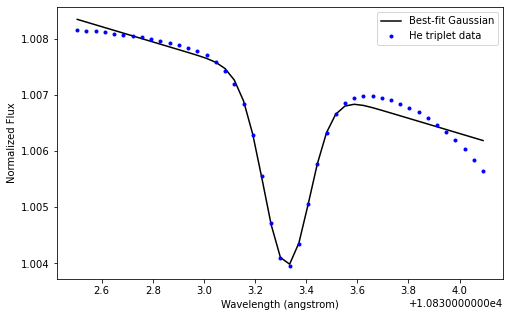

[ 1.00000000e+00  3.17879273e-03  1.32547089e+00  8.82951199e-02
 -1.21881370e-03  1.32106718e+01]


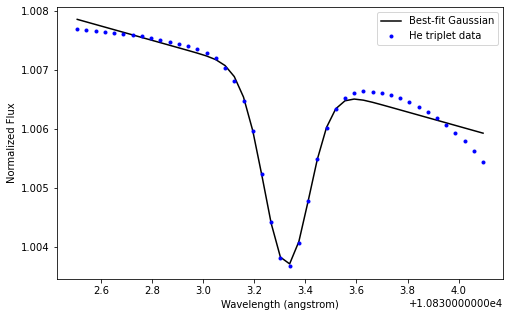

[ 1.00000000e+00  3.34719611e-03  1.32287911e+00  8.91484221e-02
 -1.37246752e-03  1.48757427e+01]


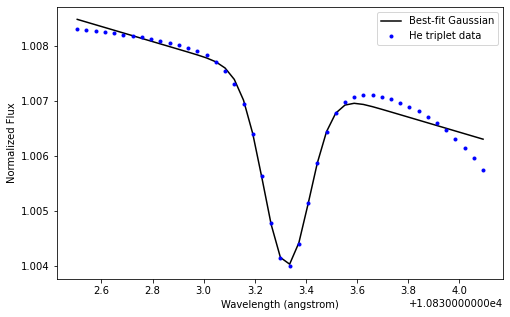

[ 1.00000000e+00  3.00330950e-03  1.32016144e+00  8.95351892e-02
 -1.25886151e-03  1.36443736e+01]


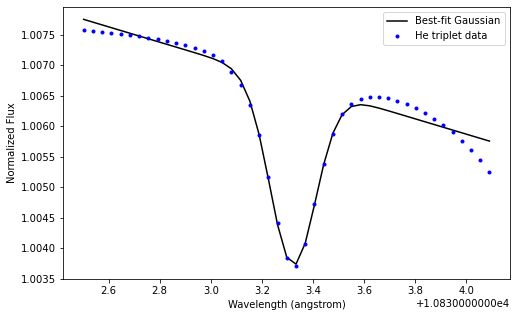

[ 1.00000000e+00  3.30970569e-03  1.32183081e+00  8.93557885e-02
 -1.37726862e-03  1.49277159e+01]


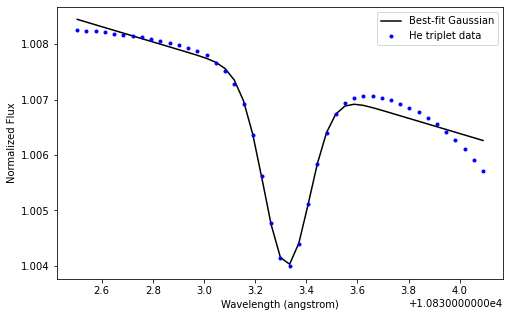

[ 1.00000000e+00  3.08246689e-03  1.31911932e+00  8.96080871e-02
 -1.30101925e-03  1.41012570e+01]


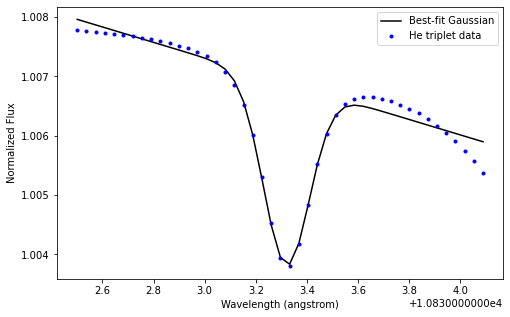

[ 1.00000000e+00  3.63840498e-03  1.32647518e+00  8.77539354e-02
 -1.35245293e-03  1.46592305e+01]


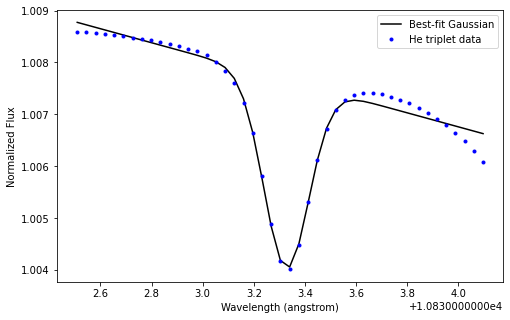

[ 1.00000000e+00  2.74593540e-03  1.31941547e+00  8.93746734e-02
 -1.14101993e-03  1.23672103e+01]


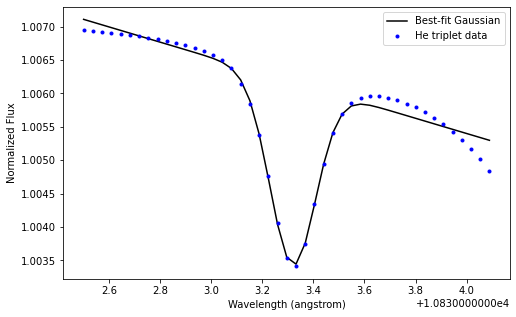

[ 1.00000000e+00  3.49911763e-03  1.32198819e+00  8.93481943e-02
 -1.46300553e-03  1.58569180e+01]


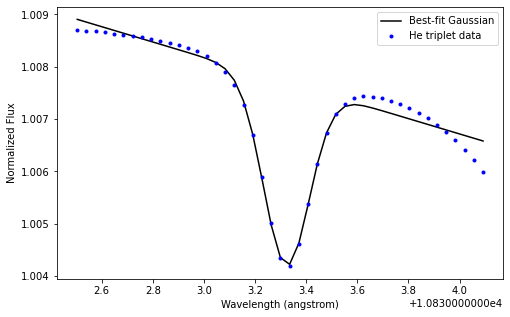

[ 1.00000000e+00  3.15085863e-03  1.32193118e+00  8.93721905e-02
 -1.30845152e-03  1.41818767e+01]


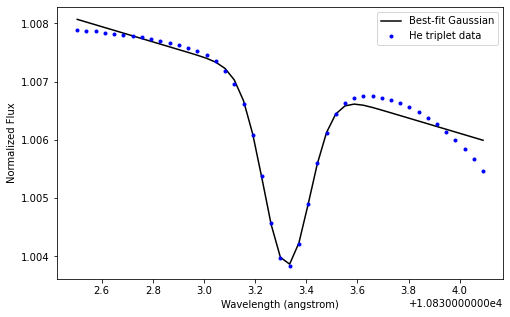

[ 1.00000000e+00  3.00404076e-03  1.32145423e+00  8.93249336e-02
 -1.23942773e-03  1.34338085e+01]


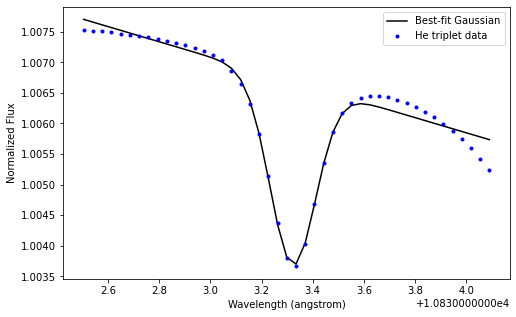

[ 1.00000000e+00  3.99651434e-03  1.32647286e+00  8.79411265e-02
 -1.51906486e-03  1.64649203e+01]


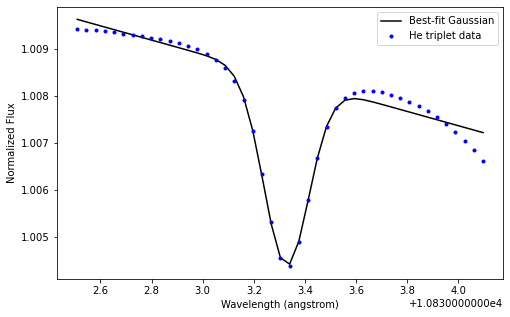

[ 1.00000000e+00  3.27894550e-03  1.32163815e+00  8.94052184e-02
 -1.36868346e-03  1.48346567e+01]


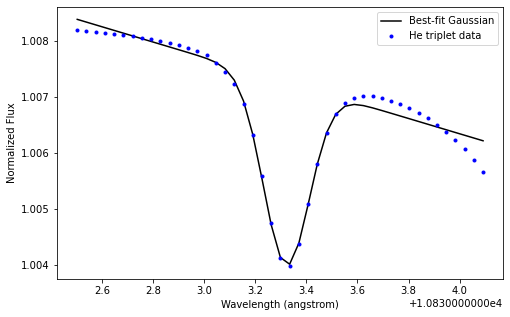

[ 1.00000000e+00  2.92557237e-03  1.32074123e+00  8.94500797e-02
 -1.21804773e-03  1.32020528e+01]


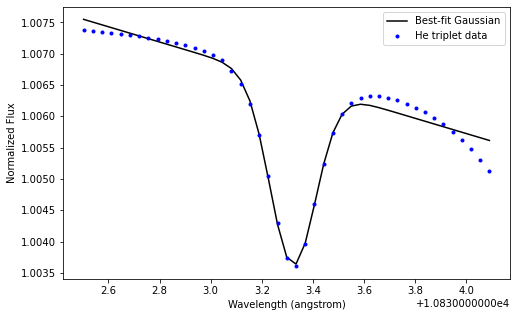

[ 1.00000000e+00  2.61412848e-03  1.32072472e+00  8.89570299e-02
 -1.06279520e-03  1.15194606e+01]


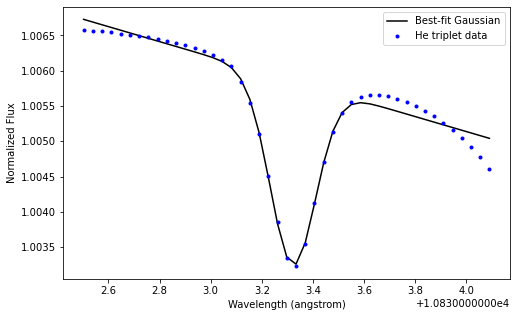

In [37]:
lower_lim = 10832.5
upper_lim = 10834.1
ref_lamda_T = 10832
guess_params = [1, 0.004, 1.3, 0.1, -0.005, 10]
bounds_param = ((-np.inf, -np.inf, -np.inf, -np.inf, -np.inf, -np.inf),(1, np.inf, np.inf, np.inf, np.inf, np.inf)) 

def gaussian_L(x, offset, A, mu, std, lin, ref):
    x_g, x_l = x
    return offset-(A * np.exp(-0.5*((x_g-mu)/std)**2)) + (lin*x_l+ref)
    
thetas_T_HA = np.ones((len(total_telluric_HA), 6))
thetas_T_HE = np.ones((len(total_telluric_HE), 6))

err_T_HA = np.ones((len(total_telluric_HA), 6))
err_T_HE = np.ones((len(total_telluric_HE), 6))

for i in range(len(total_telluric_HA)):
    
    temp_1 = total_lamda_HA[i][lower_lim<total_lamda_HA[i]]
    temp_2 = total_telluric_HA[i][lower_lim<total_lamda_HA[i]]
    focus_lamda = temp_1[temp_1 < upper_lim]
    focus_spctr = temp_2[temp_1 < upper_lim]
    
    params, cov = curve_fit(gaussian_L, (focus_lamda-ref_lamda_T, focus_lamda), focus_spctr/np.mean(total_telluric_HA[i]),
                            p0 = guess_params, bounds=bounds_param)
    thetas_T_HA[i] = params
    err_T_HA[i] = np.sqrt(np.diag(cov))
    model = gaussian_L((focus_lamda, focus_lamda), thetas_T_HA[i][0], thetas_T_HA[i][1], thetas_T_HA[i][2]+ref_lamda_T, thetas_T_HA[i][3], thetas_T_HA[i][4], thetas_T_HA[i][5])
    
    plt.figure(figsize=[8, 5])
    plt.errorbar(focus_lamda, focus_spctr/np.mean(total_telluric_HA[i]),  fmt='b.', label='He triplet data')
    plt.plot(focus_lamda, model, 'r', label='Best-fit Gaussian')
    plt.xlabel('Wavelength (angstrom)')
    plt.ylabel('Normalized Flux')
    plt.legend()
    print(thetas_T_HA[i])
    plt.show()
    
for i in range(len(total_telluric_HE)):

    temp_1 = total_lamda_HE[i][lower_lim < total_lamda_HE[i]]
    temp_2 = total_telluric_HE[i][lower_lim < total_lamda_HE[i]]
    focus_lamda = temp_1[temp_1 < upper_lim]
    focus_spctr = temp_2[temp_1 < upper_lim]
    
    params, cov = curve_fit(gaussian_L, (focus_lamda-ref_lamda_T, focus_lamda), focus_spctr/np.mean(total_telluric_HE[i]),
                             p0 = guess_params, bounds=bounds_param)
    thetas_T_HE[i] = params
    err_T_HE[i] = np.sqrt(np.diag(cov))
    model = gaussian_L((focus_lamda, focus_lamda), thetas_T_HE[i][0], thetas_T_HE[i][1], thetas_T_HE[i][2]+ref_lamda_T, thetas_T_HE[i][3], thetas_T_HE[i][4], thetas_T_HE[i][5])
    
    plt.figure(figsize=[8, 5])
    plt.errorbar(focus_lamda, focus_spctr/np.mean(total_telluric_HE[i]), fmt='b.', label='He triplet data')
    plt.plot(focus_lamda, model, 'k', label='Best-fit Gaussian')
    plt.xlabel('Wavelength (angstrom)')
    plt.ylabel('Normalized Flux')
    plt.legend()
    print(thetas_T_HE[i])
    plt.show()

## Plotting the time series of the position, width and depth of this line

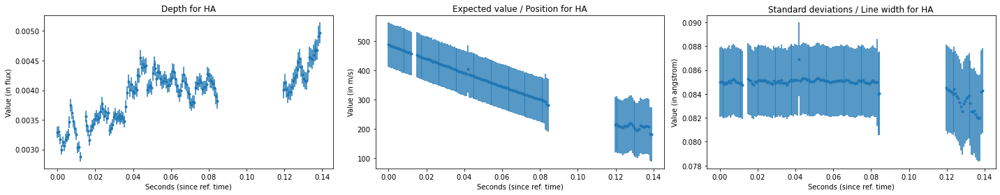

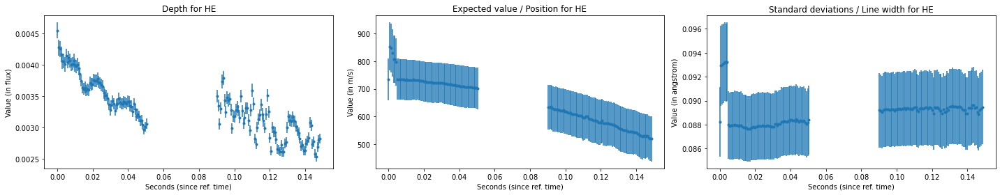

In [38]:
fig, (ax1, ax2, ax3) = plt.subplots (1, 3, figsize=[20, 4])

ax1.errorbar(date_HA-min(date_HA), thetas_T_HA[:, 1], yerr=err_T_HA[:, 1], fmt='.')
ax2.errorbar(date_HA-min(date_HA), (thetas_T_HA[:, 2]+ref_lamda_T-ref_He)*3e8/ref_He, yerr=err_T_HA[:, 2]*3e8/ref_He, fmt='.')
ax3.errorbar(date_HA-min(date_HA), np.abs(thetas_T_HA[:, 3]), yerr=err_T_HA[:, 3], fmt='.')
ax1.set_xlabel('Seconds (since ref. time)')
ax2.set_xlabel('Seconds (since ref. time)')
ax3.set_xlabel('Seconds (since ref. time)')
ax2.set_ylabel('Value (in m/s)')
ax3.set_ylabel('Value (in angstrom)')
ax1.set_ylabel('Value (in flux)')
ax1.set_title('Depth for HA')
ax2.set_title('Expected value / Position for HA')
ax3.set_title('Standard deviations / Line width for HA')

fig.tight_layout()

fig, (ax4, ax5, ax6) = plt.subplots (1, 3, figsize=[20, 4])

ax4.errorbar(date_HE-min(date_HE), thetas_T_HE[:, 1], yerr=err_T_HE[:, 1], fmt='.')
ax5.errorbar(date_HE-min(date_HE), (thetas_T_HE[:, 2]+ref_lamda_T-ref_He)*3e8/ref_He, yerr=err_T_HE[:, 2]*3e8/ref_He, fmt='.')
ax6.errorbar(date_HE-min(date_HE), np.abs(thetas_T_HE[:, 3]), yerr=err_T_HE[:, 3], fmt='.')
ax4.set_xlabel('Seconds (since ref. time)')
ax5.set_xlabel('Seconds (since ref. time)')
ax6.set_xlabel('Seconds (since ref. time)')
ax5.set_ylabel('Value (in m/s)')
ax6.set_ylabel('Value (in angstrom)')
ax4.set_ylabel('Value (in flux)')
ax4.set_title('Depth for HE')
ax5.set_title('Expected value / Position for HE')
ax6.set_title('Standard deviations / Line width for HE')

fig.tight_layout()

## Plotting the time series of the air mass and fitting a poynomial

           4             3         2
1.917e-09 x - 5.747e-05 x - 6.893 x - 2.066e+05 x + 2.478e+10
           4             3         2
5.654e-09 x - 0.0001695 x - 20.33 x - 6.096e+05 x + 7.311e+10


/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3444: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)
/opt/anaconda3/lib/python3.9/site-packages/IPython/core/interactiveshell.py:3444: RankWarning: Polyfit may be poorly conditioned
  exec(code_obj, self.user_global_ns, self.user_ns)


Text(0.5, 1.0, 'Time series of air mass for HE')

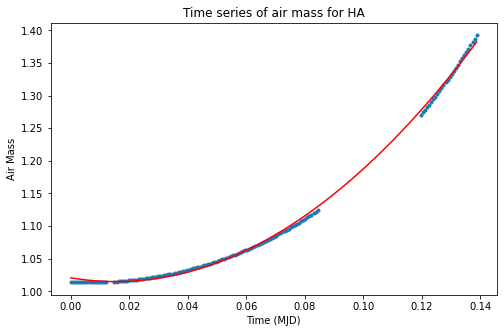

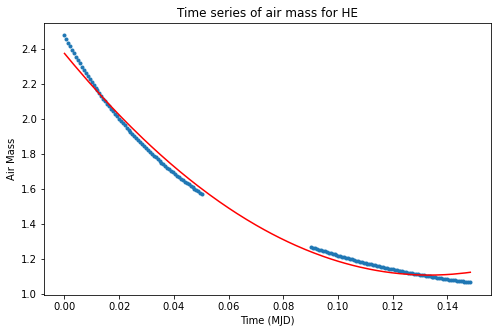

In [39]:
plt.figure(figsize=[8, 5])

model_AIRMA = np.poly1d(np.polyfit(date_HA, total_AIRM_HA, 4))
model_AIRMA_x = np.linspace(min(date_HA), max(date_HA), 1000)
print(model_AIRMA)

plt.plot(date_HA-min(date_HA), total_AIRM_HA, '.')
plt.plot(model_AIRMA_x-min(date_HA), model_AIRMA(model_AIRMA_x), 'r')
plt.xlabel('Time (MJD)')
plt.ylabel('Air Mass')
plt.title('Time series of air mass for HA')

plt.figure(figsize=[8, 5])

model_AIRME = np.poly1d(np.polyfit(date_HE, total_AIRM_HE, 4))
model_AIRME_x = np.linspace(min(date_HE), max(date_HE), 1000)
print(model_AIRME)

plt.plot(date_HE-min(date_HE), total_AIRM_HE, '.')
plt.plot(model_AIRME_x-min(date_HE), model_AIRME(model_AIRME_x), 'r')
plt.xlabel('Time (MJD)')
plt.ylabel('Air Mass')
plt.title('Time series of air mass for HE')

## Detrending the air mass from the CO2 IWV

[ 1.06170849e+07 -1.06566503e+05  1.39999973e-01]


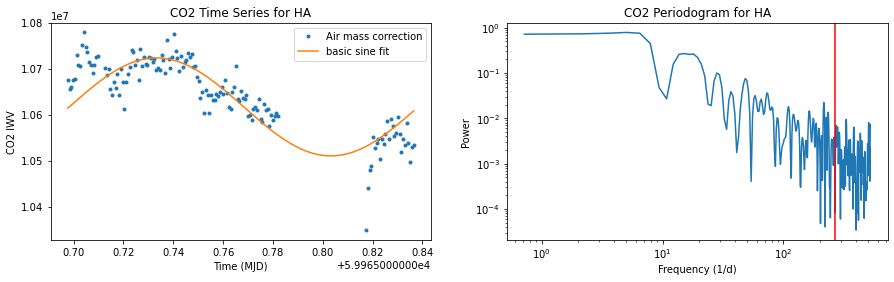

[ 1.05490453e+07 -1.36401162e+05  1.39999998e-01]


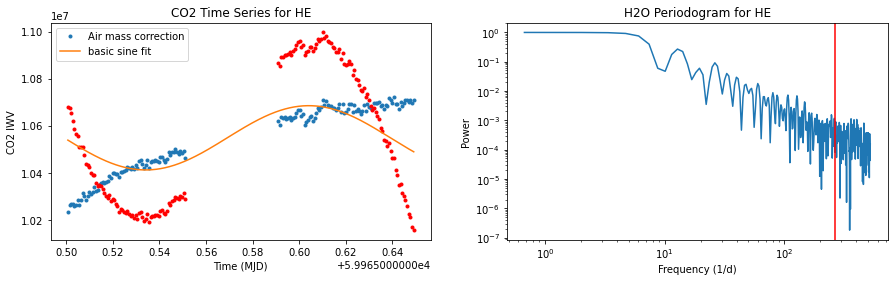

In [46]:
def trig(x, offset, A, P):
    return offset+A*np.sin(2*x*np.pi/P)

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

new_LS_CO2_HA = LombScargle(date_HA, total_CO2_HA/total_AIRM_HA).autopower(nyquist_factor=1)
new_LS_CO2_HE = LombScargle(date_HE, total_CO2_HE/total_AIRM_HE).autopower(nyquist_factor=1)

ax1.plot(date_HA, total_CO2_HA/total_AIRM_HA, '.', label='Air mass correction')
#ax1.plot(date_HA, total_CO2_HA, '.', label='No correction')

m_x_HA = np.linspace(min(date_HA), max(date_HA), 1000)

params_A, cov = curve_fit(trig, date_HA, total_CO2_HA/total_AIRM_HA, p0=[1.06e7, 0.02e7, 0.14])
print(params_A)
ax1.plot(m_x_HA, trig(m_x_HA, params_A[0], params_A[1], params_A[2]), label='basic sine fit')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('CO2 IWV')
ax1.set_title('CO2 Time Series for HA')
ax1.legend()

ax2.loglog(new_LS_CO2_HA[0], new_LS_CO2_HA[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('CO2 Periodogram for HA')

ax2.axvline(24*60/5.4, color='r')
plt.show()

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

ax1.plot(date_HE, total_CO2_HE/total_AIRM_HE, '.', label='Air mass correction')
ax1.plot(date_HE, total_CO2_HE/model_AIRME(date_HE), 'r.')
#ax1.plot(date_HE, total_CO2_HE, '.', label='No correction')

m_x_HE = np.linspace(min(date_HE), max(date_HE), 1000)

params_E, cov = curve_fit(trig, date_HE, total_CO2_HE/total_AIRM_HE, p0=[1.06e7, 0.04e7, 0.14])
print(params_E)
ax1.plot(m_x_HE, trig(m_x_HE, params_E[0], params_E[1], params_E[2]), label='basic sine fit')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('CO2 IWV')
ax1.set_title('CO2 Time Series for HE')
ax1.legend()

ax2.loglog(new_LS_CO2_HE[0], new_LS_CO2_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('H2O Periodogram for HE')

ax2.axvline(24*60/5.4, color='r')

## Detrending the air mass from the H2O IWV

[ 4.79215562 -0.47910021  0.14000002]


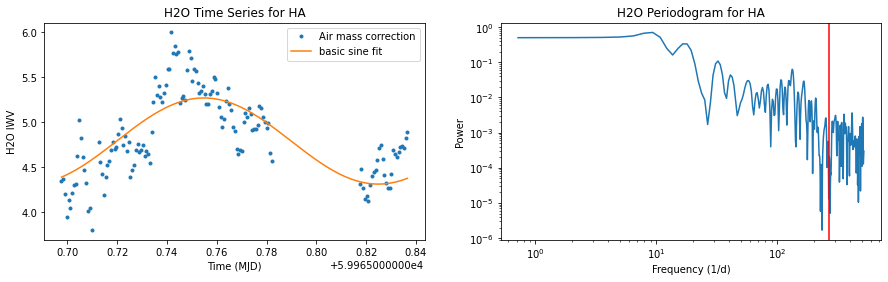

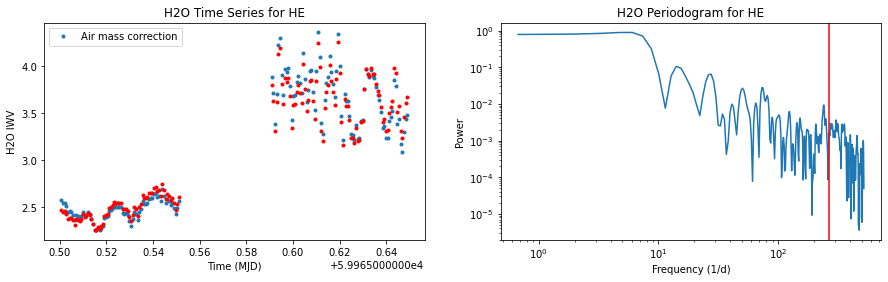

In [47]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

new_LS_H2O_HA = LombScargle(date_HA, total_H2O_HA/model_AIRMA(date_HA)).autopower(nyquist_factor=1)
new_LS_H2O_HE = LombScargle(date_HE, total_H2O_HE/model_AIRME(date_HE)).autopower(nyquist_factor=1)

ax1.plot(date_HA, total_H2O_HA/model_AIRMA(date_HA), '.', label='Air mass correction')
#ax1.plot(date_HA, total_H2O_HA, '.', label='No correction')

m_x_HA = np.linspace(min(date_HA), max(date_HA), 1000)

params_A, cov = curve_fit(trig, date_HA, total_H2O_HA/model_AIRMA(date_HA), p0=[5, 1, 0.14])
print(params_A)
ax1.plot(m_x_HA, trig(m_x_HA, params_A[0], params_A[1], params_A[2]), label='basic sine fit')

ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('H2O IWV')
ax1.set_title('H2O Time Series for HA')
ax1.legend()

ax2.loglog(new_LS_H2O_HA[0], new_LS_H2O_HA[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('H2O Periodogram for HA')

ax2.axvline(24*60/5.4, color='r')
plt.show()
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=[15, 4])

ax1.plot(date_HE, total_H2O_HE/model_AIRME(date_HE), '.', label='Air mass correction')
ax1.plot(date_HE, total_H2O_HE/total_AIRM_HE, 'r.')

#ax1.plot(date_HE, total_H2O_HE, '.', label='No correction')
ax1.set_xlabel('Time (MJD)')
ax1.set_ylabel('H2O IWV')
ax1.set_title('H2O Time Series for HE')
ax1.legend()

ax2.loglog(new_LS_H2O_HE[0], new_LS_H2O_HE[1])
ax2.set_xlabel('Frequency (1/d)')
ax2.set_ylabel('Power')
ax2.set_title('H2O Periodogram for HE')

ax2.axvline(24*60/5.4, color='r')
plt.show()

## Plotting the correlation between H2O IWV and the position, depth and width of the He triplet (not the one fit from the telluric spectra but the one fit from the spectra where TC was applied)

In [42]:
depth_A = thetas_HA[:,1][np.argsort(date_HA)]
pos_A = thetas_HA[:,2][np.argsort(date_HA)]
width_A = thetas_HA[:,3][np.argsort(date_HA)]

H2O_IWVA = total_H2O_HA/model_AIRMA(date_HA)
H2O_IWVA = H2O_IWVA[np.argsort(date_HA)]

depth_E = thetas_HE[:,1][np.argsort(date_HE)]
pos_E = thetas_HE[:,2][np.argsort(date_HE)]
width_E = thetas_HE[:,3][np.argsort(date_HE)]

H2O_IWVE = total_H2O_HE/model_AIRME(date_HE)
H2O_IWVE = H2O_IWVE[np.argsort(date_HE)]

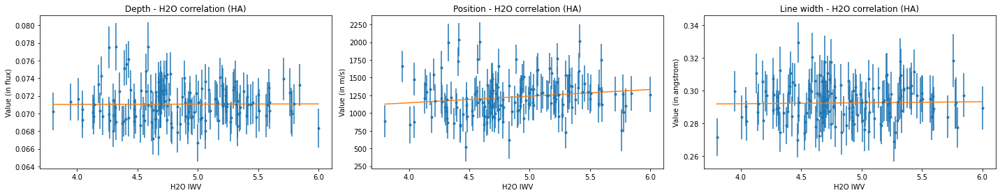

Depth polynomial:  
2.782e-05 x + 0.07092 
 Position polynomial:  
93.83 x + 769.7 
 Width polynomial:  
0.0006083 x + 0.2895


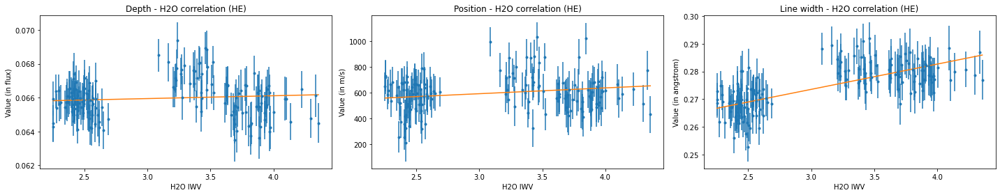

Depth polynomial:  
2.782e-05 x + 0.07092 
 Position polynomial:  
93.83 x + 769.7 
 Width polynomial:  
0.0006083 x + 0.2895
[[1.         0.14466614]
 [0.14466614 1.        ]]
[[1.        0.1303886]
 [0.1303886 1.       ]]


In [52]:
fig, (ax1, ax2, ax3) = plt.subplots (1, 3, figsize=[20, 4])

x_H2OA = np.linspace(min(H2O_IWVA), max(H2O_IWVA), 1000)

m_depthA = np.poly1d(np.polyfit(H2O_IWVA, depth_A, 1, w = 1/err_HA[:,1][np.argsort(date_HA)]))
m_posA = np.poly1d(np.polyfit(H2O_IWVA, (pos_A+ref_lamda-ref_He)*3e8/ref_He, 1, w = 1/(err_HA[:,2][np.argsort(date_HA)]*3e8/ref_He)))
m_widthA = np.poly1d(np.polyfit(H2O_IWVA, width_A, 1, w = 1/err_HA[:,3][np.argsort(date_HA)]))

ax1.errorbar(H2O_IWVA, depth_A, yerr = err_HA[:,1][np.argsort(date_HA)], fmt='.')
ax1.plot(x_H2OA, m_depthA(x_H2OA))
ax2.errorbar(H2O_IWVA, (pos_A+ref_lamda-ref_He)*3e8/ref_He, yerr = err_HA[:,2][np.argsort(date_HA)]*3e8/ref_He, fmt='.')
ax2.plot(x_H2OA, m_posA(x_H2OA))
ax3.errorbar(H2O_IWVA, np.abs(width_A), yerr = err_HA[:,3][np.argsort(date_HA)], fmt='.')
ax3.plot(x_H2OA, m_widthA(x_H2OA))
ax1.set_xlabel('H2O IWV')
ax2.set_xlabel('H2O IWV')
ax3.set_xlabel('H2O IWV')
ax2.set_ylabel('Value (in m/s)')
ax3.set_ylabel('Value (in angstrom)')
ax1.set_ylabel('Value (in flux)')
ax1.set_title('Depth - H2O correlation (HA)')
ax2.set_title('Position - H2O correlation (HA)')
ax3.set_title('Line width - H2O correlation (HA)')

fig.tight_layout()

plt.show()

print('Depth polynomial:',m_depthA,'\n','Position polynomial:',m_posA,'\n','Width polynomial:',m_widthA)

fig, (ax4, ax5, ax6) = plt.subplots (1, 3, figsize=[20, 4])

x_H2OE = np.linspace(min(H2O_IWVE), max(H2O_IWVE), 1000)

m_depthE = np.poly1d(np.polyfit(H2O_IWVE, depth_E, 1, w = 1/err_HE[:,1][np.argsort(date_HE)]))
m_posE = np.poly1d(np.polyfit(H2O_IWVE, (pos_E+ref_lamda-ref_He)*3e8/ref_He, 1, w = 1/(err_HE[:,2][np.argsort(date_HE)]*3e8/ref_He)))
m_widthE = np.poly1d(np.polyfit(H2O_IWVE, width_E, 1, w = 1/err_HE[:,3][np.argsort(date_HE)]))

ax4.errorbar(H2O_IWVE, depth_E, yerr=err_HE[:, 1][np.argsort(date_HE)], fmt='.')
ax4.plot(x_H2OE, m_depthE(x_H2OE))
ax5.errorbar(H2O_IWVE, (pos_E+ref_lamda_T-ref_He)*3e8/ref_He, yerr=err_HE[:, 2][np.argsort(date_HE)]*3e8/ref_He, fmt='.')
ax5.plot(x_H2OE, m_posE(x_H2OE))
ax6.errorbar(H2O_IWVE, np.abs(width_E), yerr=err_HE[:, 3][np.argsort(date_HE)], fmt='.')
ax6.plot(x_H2OE, m_widthE(x_H2OE))
ax4.set_xlabel('H2O IWV')
ax5.set_xlabel('H2O IWV')
ax6.set_xlabel('H2O IWV')
ax5.set_ylabel('Value (in m/s)')
ax6.set_ylabel('Value (in angstrom)')
ax4.set_ylabel('Value (in flux)')
ax4.set_title('Depth - H2O correlation (HE)')
ax5.set_title('Position - H2O correlation (HE)')
ax6.set_title('Line width - H2O correlation (HE)')

fig.tight_layout()

plt.show()

print('Depth polynomial:',m_depthA,'\n','Position polynomial:',m_posA,'\n','Width polynomial:',m_widthA)


print(np.corrcoef(H2O_IWVE, (pos_E+ref_lamda_T-ref_He)*3e8/ref_He))

print(np.corrcoef(H2O_IWVA, (pos_A+ref_lamda_T-ref_He)*3e8/ref_He))


